In [12]:
#hide
! [ -e /content ] && pip install -Uqq fastbook
import fastbook
fastbook.setup_book()

In [13]:
#hide
from fastai.vision.all import *
from fastbook import *

matplotlib.rc('image', cmap='Greys')

# Under the Hood: Training a Digit Classifier

Having seen what it looks like to actually train a variety of models in Chapter 2, let’s now look under the hood and see exactly what is going on. We’ll start by using computer vision to introduce fundamental tools and concepts for deep learning.

To be exact, we'll discuss the roles of arrays and tensors and of broadcasting, a powerful technique for using them expressively. We'll explain stochastic gradient descent (SGD), the mechanism for learning by updating weights automatically. We'll discuss the choice of a loss function for our basic classification task, and the role of mini-batches. We'll also describe the math that a basic neural network is actually doing. Finally, we'll put all these pieces together.
<@@
In future chapters we’ll do deep dives into other applications as well, and see how these concepts and tools generalize. But this chapter is about laying foundation stones. To be frank, that also makes this one of the hardest chapters, because of how these concepts all depend on each other. Like an arch, all the stones need to be in place for the structure to stay up. Also like an arch, once that happens, it's a powerful structure that can support other things. But it requires some patience to assemble.

Let's begin. The first step is to consider how images are represented in a computer.

## Pixels: The Foundations of Computer Vision

In order to understand what happens in a computer vision model, we first have to understand how computers handle images. We'll use one of the most famous datasets in computer vision, [MNIST](https://en.wikipedia.org/wiki/MNIST_database), for our experiments. MNIST contains images of handwritten digits, collected by the National Institute of Standards and Technology and collated into a machine learning dataset by Yann Lecun and his colleagues. Lecun used MNIST in 1998 in [Lenet-5](http://yann.lecun.com/exdb/lenet/), the first computer system to demonstrate practically useful recognition of handwritten digit sequences. This was one of the most important breakthroughs in the history of AI.

## Sidebar: Tenacity and Deep Learning

The story of deep learning is one of tenacity and grit by a handful of dedicated researchers. After early hopes (and hype!) neural networks went out of favor in the 1990's and 2000's, and just a handful of researchers kept trying to make them work well. Three of them, Yann Lecun, Yoshua Bengio, and Geoffrey Hinton, were awarded the highest honor in computer science, the Turing Award (generally considered the "Nobel Prize of computer science"), in 2018 after triumphing despite the deep skepticism and disinterest of the wider machine learning and statistics community.

Geoff Hinton has told of how even academic papers showing dramatically better results than anything previously published would be rejected by top journals and conferences, just because they used a neural network. Yann Lecun's work on convolutional neural networks, which we will study in the next section, showed that these models could read handwritten text—something that had never been achieved before. However, his breakthrough was ignored by most researchers, even as it was used commercially to read 10% of the checks in the US!

In addition to these three Turing Award winners, there are many other researchers who have battled to get us to where we are today. For instance, Jurgen Schmidhuber (who many believe should have shared in the Turing Award) pioneered many important ideas, including working with his student Sepp Hochreiter on the long short-term memory (LSTM) architecture (widely used for speech recognition and other text modeling tasks, and used in the IMDb example in <<chapter_intro>>). Perhaps most important of all, Paul Werbos in 1974 invented back-propagation for neural networks, the technique shown in this chapter and used universally for training neural networks ([Werbos 1994](https://books.google.com/books/about/The_Roots_of_Backpropagation.html?id=WdR3OOM2gBwC)). His development was almost entirely ignored for decades, but today it is considered the most important foundation of modern AI.

There is a lesson here for all of us! On your deep learning journey you will face many obstacles, both technical, and (even more difficult) posed by people around you who don't believe you'll be successful. There's one *guaranteed* way to fail, and that's to stop trying. We've seen that the only consistent trait amongst every fast.ai student that's gone on to be a world-class practitioner is that they are all very tenacious.

## End sidebar

For this initial tutorial we are just going to try to create a model that can classify any image as a 3 or a 7. So let's download a sample of MNIST that contains images of just these digits:

In [14]:
path = untar_data(URLs.MNIST_SAMPLE)

In [15]:
#hide
Path.BASE_PATH = path

We can see what's in this directory by using `ls`, a method added by fastai. This method returns an object of a special fastai class called `L`, which has all the same functionality of Python's built-in `list`, plus a lot more. One of its handy features is that, when printed, it displays the count of items, before listing the items themselves (if there are more than 10 items, it just shows the first few):

In [16]:
path.ls()

(#3) [Path('valid'),Path('labels.csv'),Path('train')]

The MNIST dataset follows a common layout for machine learning datasets: separate folders for the training set and the validation set (and/or test set). Let's see what's inside the training set:

In [17]:
(path/'train').ls()

(#2) [Path('train/7'),Path('train/3')]

There's a folder of 3s, and a folder of 7s. In machine learning parlance, we say that "3" and "7" are the *labels* (or targets) in this dataset. Let's take a look in one of these folders (using `sorted` to ensure we all get the same order of files):

In [18]:
threes = (path/'train'/'3').ls().sorted()
sevens = (path/'train'/'7').ls().sorted()
threes

(#6131) [Path('train/3/10.png'),Path('train/3/10000.png'),Path('train/3/10011.png'),Path('train/3/10031.png'),Path('train/3/10034.png'),Path('train/3/10042.png'),Path('train/3/10052.png'),Path('train/3/1007.png'),Path('train/3/10074.png'),Path('train/3/10091.png')...]

As we might expect, it's full of image files. Let’s take a look at one now. Here’s an image of a handwritten number 3, taken from the famous MNIST dataset of handwritten numbers:

In [19]:
im3_path = threes[1]
im3 = Image.open(im3_path)
im3

Here we are using the `Image` class from the *Python Imaging Library* (PIL), which is the most widely used Python package for opening, manipulating, and viewing images. Jupyter knows about PIL images, so it displays the image for us automatically.

In a computer, everything is represented as a number. To view the numbers that make up this image, we have to convert it to a *NumPy array* or a *PyTorch tensor*. For instance, here's what a section of the image looks like, converted to a NumPy array:

In [20]:
array(im3)[4:10,4:10]

array([[  0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,  29],
       [  0,   0,   0,  48, 166, 224],
       [  0,  93, 244, 249, 253, 187],
       [  0, 107, 253, 253, 230,  48],
       [  0,   3,  20,  20,  15,   0]], dtype=uint8)

The `4:10` indicates we requested the rows from index 4 (included) to 10 (not included) and the same for the columns. NumPy indexes from top to bottom and left to right, so this section is located in the top-left corner of the image. Here's the same thing as a PyTorch tensor:

In [21]:
tensor(im3)[4:10,4:10]

tensor([[  0,   0,   0,   0,   0,   0],
        [  0,   0,   0,   0,   0,  29],
        [  0,   0,   0,  48, 166, 224],
        [  0,  93, 244, 249, 253, 187],
        [  0, 107, 253, 253, 230,  48],
        [  0,   3,  20,  20,  15,   0]], dtype=torch.uint8)

We can slice the array to pick just the part with the top of the digit in it, and then use a Pandas DataFrame to color-code the values using a gradient, which shows us clearly how the image is created from the pixel values:

In [22]:
#hide_output
im3_t = tensor(im3)
df = pd.DataFrame(im3_t[4:15,4:22])
df.style.set_properties(**{'font-size':'6pt'}).background_gradient('Greys')

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,29,150,195,254,255,254,176,193,150,96,0,0,0
2,0,0,0,48,166,224,253,253,234,196,253,253,253,253,233,0,0,0
3,0,93,244,249,253,187,46,10,8,4,10,194,253,253,233,0,0,0
4,0,107,253,253,230,48,0,0,0,0,0,192,253,253,156,0,0,0
5,0,3,20,20,15,0,0,0,0,0,43,224,253,245,74,0,0,0
6,0,0,0,0,0,0,0,0,0,0,249,253,245,126,0,0,0,0
7,0,0,0,0,0,0,0,14,101,223,253,248,124,0,0,0,0,0
8,0,0,0,0,0,11,166,239,253,253,253,187,30,0,0,0,0,0
9,0,0,0,0,0,16,248,250,253,253,253,253,232,213,111,2,0,0


<img width="453" id="output_pd_pixels" src="images/att_00058.png">

You can see that the background white pixels are stored as the number 0, black is the number 255, and shades of gray are between the two. The entire image contains 28 pixels across and 28 pixels down, for a total of 784 pixels. (This is much smaller than an image that you would get from a phone camera, which has millions of pixels, but is a convenient size for our initial learning and experiments. We will build up to bigger, full-color images soon.)

So, now you've seen what an image looks like to a computer, let's recall our goal: create a model that can recognize 3s and 7s. How might you go about getting a computer to do that?

> Warning: Stop and Think!: Before you read on, take a moment to think about how a computer might be able to recognize these two different digits. What kinds of features might it be able to look at? How might it be able to identify these features? How could it combine them together? Learning works best when you try to solve problems yourself, rather than just reading somebody else's answers; so step away from this book for a few minutes, grab a piece of paper and pen, and jot some ideas down…

## First Try: Pixel Similarity

So, here is a first idea: how about we find the average pixel value for every pixel of the 3s, then do the same for the 7s. This will give us two group averages, defining what we might call the "ideal" 3 and 7. Then, to classify an image as one digit or the other, we see which of these two ideal digits the image is most similar to. This certainly seems like it should be better than nothing, so it will make a good baseline.

> jargon: Baseline: A simple model which you are confident should perform reasonably well. It should be very simple to implement, and very easy to test, so that you can then test each of your improved ideas, and make sure they are always better than your baseline. Without starting with a sensible baseline, it is very difficult to know whether your super-fancy models are actually any good. One good approach to creating a baseline is doing what we have done here: think of a simple, easy-to-implement model. Another good approach is to search around to find other people that have solved similar problems to yours, and download and run their code on your dataset. Ideally, try both of these!

Step one for our simple model is to get the average of pixel values for each of our two groups. In the process of doing this, we will learn a lot of neat Python numeric programming tricks!

Let's create a tensor containing all of our 3s stacked together. We already know how to create a tensor containing a single image. To create a tensor containing all the images in a directory, we will first use a Python list comprehension to create a plain list of the single image tensors.

We will use Jupyter to do some little checks of our work along the way—in this case, making sure that the number of returned items seems reasonable:

In [23]:
seven_tensors = [tensor(Image.open(o)) for o in sevens]
three_tensors = [tensor(Image.open(o)) for o in threes]
len(three_tensors),len(seven_tensors)

(6131, 6265)

> note: List Comprehensions: List and dictionary comprehensions are a wonderful feature of Python. Many Python programmers use them every day, including the authors of this book—they are part of "idiomatic Python." But programmers coming from other languages may have never seen them before. There are a lot of great tutorials just a web search away, so we won't spend a long time discussing them now. Here is a quick explanation and example to get you started. A list comprehension looks like this: `new_list = [f(o) for o in a_list if o>0]`. This will return every element of `a_list` that is greater than 0, after passing it to the function `f`. There are three parts here: the collection you are iterating over (`a_list`), an optional filter (`if o>0`), and something to do to each element (`f(o)`). It's not only shorter to write but way faster than the alternative ways of creating the same list with a loop.

We'll also check that one of the images looks okay. Since we now have tensors (which Jupyter by default will print as values), rather than PIL images (which Jupyter by default will display as images), we need to use fastai's `show_image` function to display it:

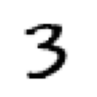

In [24]:
show_image(three_tensors[1]);

For every pixel position, we want to compute the average over all the images of the intensity of that pixel. To do this we first combine all the images in this list into a single three-dimensional tensor. The most common way to describe such a tensor is to call it a *rank-3 tensor*. We often need to stack up individual tensors in a collection into a single tensor. Unsurprisingly, PyTorch comes with a function called `stack` that we can use for this purpose.

Some operations in PyTorch, such as taking a mean, require us to *cast* our integer types to float types. Since we'll be needing this later, we'll also cast our stacked tensor to `float` now. Casting in PyTorch is as simple as typing the name of the type you wish to cast to, and treating it as a method.

Generally when images are floats, the pixel values are expected to be between 0 and 1, so we will also divide by 255 here:

In [25]:
stacked_sevens = torch.stack(seven_tensors).float()/255
stacked_threes = torch.stack(three_tensors).float()/255
stacked_threes.shape

torch.Size([6131, 28, 28])

Perhaps the most important attribute of a tensor is its *shape*. This tells you the length of each axis. In this case, we can see that we have 6,131 images, each of size 28×28 pixels. There is nothing specifically about this tensor that says that the first axis is the number of images, the second is the height, and the third is the width—the semantics of a tensor are entirely up to us, and how we construct it. As far as PyTorch is concerned, it is just a bunch of numbers in memory.

The *length* of a tensor's shape is its rank:

In [26]:
len(stacked_threes.shape)

3

It is really important for you to commit to memory and practice these bits of tensor jargon: _rank_ is the number of axes or dimensions in a tensor; _shape_ is the size of each axis of a tensor.

> A: Watch out because the term "dimension" is sometimes used in two ways. Consider that we live in "three-dimensonal space" where a physical position can be described by a 3-vector `v`. But according to PyTorch, the attribute `v.ndim` (which sure looks like the "number of dimensions" of `v`) equals one, not three! Why? Because `v` is a vector, which is a tensor of rank one, meaning that it has only one _axis_ (even if that axis has a length of three). In other words, sometimes dimension is used for the size of an axis ("space is three-dimensional"); other times, it is used for the rank, or the number of axes ("a matrix has two dimensions"). When confused, I find it helpful to translate all statements into terms of rank, axis, and length, which are unambiguous terms.

We can also get a tensor's rank directly with `ndim`:

In [27]:
stacked_threes.ndim

3

Finally, we can compute what the ideal 3 looks like. We calculate the mean of all the image tensors by taking the mean along dimension 0 of our stacked, rank-3 tensor. This is the dimension that indexes over all the images.

In other words, for every pixel position, this will compute the average of that pixel over all images. The result will be one value for every pixel position, or a single image. Here it is:

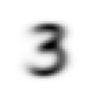

In [28]:
mean3 = stacked_threes.mean(0)
show_image(mean3);

According to this dataset, this is the ideal number 3! (You may not like it, but this is what peak number 3 performance looks like.) You can see how it's very dark where all the images agree it should be dark, but it becomes wispy and blurry where the images disagree. 

Let's do the same thing for the 7s, but put all the steps together at once to save some time:

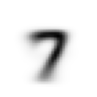

In [29]:
mean7 = stacked_sevens.mean(0)
show_image(mean7);

Let's now pick an arbitrary 3 and measure its *distance* from our "ideal digits."

> stop: Stop and Think!: How would you calculate how similar a particular image is to each of our ideal digits? Remember to step away from this book and jot down some ideas before you move on! Research shows that recall and understanding improves dramatically when you are engaged with the learning process by solving problems, experimenting, and trying new ideas yourself

Here's a sample 3:

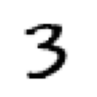

In [30]:
a_3 = stacked_threes[1]
show_image(a_3);

<AxesSubplot: >

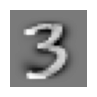

In [31]:
show_image(mean3 - a_3)

How can we determine its distance from our ideal 3? We can't just add up the differences between the pixels of this image and the ideal digit. Some differences will be positive while others will be negative, and these differences will cancel out, resulting in a situation where an image that is too dark in some places and too light in others might be shown as having zero total differences from the ideal. That would be misleading!

To avoid this, there are two main ways data scientists measure distance in this context:

- Take the mean of the *absolute value* of differences (absolute value is the function that replaces negative values with positive values). This is called the *mean absolute difference* or *L1 norm*
- Take the mean of the *square* of differences (which makes everything positive) and then take the *square root* (which undoes the squaring). This is called the *root mean squared error* (RMSE) or *L2 norm*.

> important: It's Okay to Have Forgotten Your Math: In this book we generally assume that you have completed high school math, and remember at least some of it... But everybody forgets some things! It all depends on what you happen to have had reason to practice in the meantime. Perhaps you have forgotten what a _square root_ is, or exactly how they work. No problem! Any time you come across a maths concept that is not explained fully in this book, don't just keep moving on; instead, stop and look it up. Make sure you understand the basic idea, how it works, and why we might be using it. One of the best places to refresh your understanding is Khan Academy. For instance, Khan Academy has a great [introduction to square roots](https://www.khanacademy.org/math/algebra/x2f8bb11595b61c86:rational-exponents-radicals/x2f8bb11595b61c86:radicals/v/understanding-square-roots).

Let's try both of these now:

In [32]:
dist_3_abs = (a_3 - mean3).abs().mean()
dist_3_sqr = ((a_3 - mean3)**2).mean().sqrt()
dist_3_abs,dist_3_sqr

(tensor(0.1114), tensor(0.2021))

In [33]:
dist_7_abs = (a_3 - mean7).abs().mean()
dist_7_sqr = ((a_3 - mean7)**2).mean().sqrt()
dist_7_abs,dist_7_sqr

(tensor(0.1586), tensor(0.3021))

In both cases, the distance between our 3 and the "ideal" 3 is less than the distance to the ideal 7. So our simple model will give the right prediction in this case.

PyTorch already provides both of these as *loss functions*. You'll find these inside `torch.nn.functional`, which the PyTorch team recommends importing as `F` (and is available by default under that name in fastai):

In [34]:
F.l1_loss(a_3.float(),mean7), F.mse_loss(a_3,mean7).sqrt()

(tensor(0.1586), tensor(0.3021))

Here `mse` stands for *mean squared error*, and `l1` refers to the standard mathematical jargon for *mean absolute value* (in math it's called the *L1 norm*).

> S: Intuitively, the difference between L1 norm and mean squared error (MSE) is that the latter will penalize bigger mistakes more heavily than the former (and be more lenient with small mistakes).

> J: When I first came across this "L1" thingie, I looked it up to see what on earth it meant. I found on Google that it is a _vector norm_ using _absolute value_, so looked up _vector norm_ and started reading: _Given a vector space V over a field F of the real or complex numbers, a norm on V is a nonnegative-valued any function p: V → \[0,+∞) with the following properties: For all a ∈ F and all u, v ∈ V, p(u + v) ≤ p(u) + p(v)..._ Then I stopped reading. "Ugh, I'll never understand math!" I thought, for the thousandth time. Since then I've learned that every time these complex mathy bits of jargon come up in practice, it turns out I can replace them with a tiny bit of code! Like, the _L1 loss_ is just equal to `(a-b).abs().mean()`, where `a` and `b` are tensors. I guess mathy folks just think differently than me... I'll make sure in this book that every time some mathy jargon comes up, I'll give you the little bit of code it's equal to as well, and explain in common-sense terms what's going on.

We just completed various mathematical operations on PyTorch tensors. If you've done some numeric programming in NumPy before, you may recognize these as being similar to NumPy arrays. Let's have a look at those two very important data structures.

### NumPy Arrays and PyTorch Tensors

[NumPy](https://numpy.org/) is the most widely used library for scientific and numeric programming in Python. It provides very similar functionality and a very similar API to that provided by PyTorch; however, it does not support using the GPU or calculating gradients, which are both critical for deep learning. Therefore, in this book we will generally use PyTorch tensors instead of NumPy arrays, where possible.

(Note that fastai adds some features to NumPy and PyTorch to make them a bit more similar to each other. If any code in this book doesn't work on your computer, it's possible that you forgot to include a line like this at the start of your notebook: `from fastai.vision.all import *`.)

But what are arrays and tensors, and why should you care?

Python is slow compared to many languages. Anything fast in Python, NumPy, or PyTorch is likely to be a wrapper for a compiled object written (and optimized) in another language—specifically C. In fact, **NumPy arrays and PyTorch tensors can finish computations many thousands of times faster than using pure Python.**

A NumPy array is a multidimensional table of data, with all items of the same type. Since that can be any type at all, they can even be arrays of arrays, with the innermost arrays potentially being different sizes—this is called a "jagged array." By "multidimensional table" we mean, for instance, a list (dimension of one), a table or matrix (dimension of two), a "table of tables" or "cube" (dimension of three), and so forth. If the items are all of some simple type such as integer or float, then NumPy will store them as a compact C data structure in memory. This is where NumPy shines. NumPy has a wide variety of operators and methods that can run computations on these compact structures at the same speed as optimized C, because they are written in optimized C.

A PyTorch tensor is nearly the same thing as a NumPy array, but with an additional restriction that unlocks some additional capabilities. It's the same in that it, too, is a multidimensional table of data, with all items of the same type. However, the restriction is that a tensor cannot use just any old type—it has to use a single basic numeric type for all components. For example, a PyTorch tensor cannot be jagged. It is always a regularly shaped multidimensional rectangular structure.

The vast majority of methods and operators supported by NumPy on these structures are also supported by PyTorch, but PyTorch tensors have additional capabilities. One major capability is that these structures can live on the GPU, in which case their computation will be optimized for the GPU and can run much faster (given lots of values to work on). In addition, PyTorch can automatically calculate derivatives of these operations, including combinations of operations. As you'll see, it would be impossible to do deep learning in practice without this capability.

> S: If you don't know what C is, don't worry as you won't need it at all. In a nutshell, it's a low-level  (low-level means more similar to the language that computers use internally) language that is very fast compared to Python. To take advantage of its speed while programming in Python, try to avoid as much as possible writing loops, and replace them by commands that work directly on arrays or tensors.

Perhaps the most important new coding skill for a Python programmer to learn is how to effectively use the array/tensor APIs. We will be showing lots more tricks later in this book, but here's a summary of the key things you need to know for now.

To create an array or tensor, pass a list (or list of lists, or list of lists of lists, etc.) to `array()` or `tensor()`:

In [35]:
data = [[1,2,3],[4,5,6]]
arr = array (data)
tns = tensor(data)

In [36]:
arr  # numpy

array([[1, 2, 3],
       [4, 5, 6]])

In [37]:
tns  # pytorch

tensor([[1, 2, 3],
        [4, 5, 6]])

All the operations that follow are shown on tensors, but the syntax and results for NumPy arrays is identical.

You can select a row (note that, like lists in Python, tensors are 0-indexed so 1 refers to the second row/column):

tns[0:3,0

In [38]:
tns[1]

tensor([4, 5, 6])

or a column, by using `:` to indicate *all of the first axis* (we sometimes refer to the dimensions of tensors/arrays as *axes*):

In [39]:
tns[:,1]

tensor([2, 5])

You can combine these with Python slice syntax (`[start:end]` with `end` being excluded) to select part of a row or column:

In [40]:
tns[1,1:3]

tensor([5, 6])

And you can use the standard operators such as `+`, `-`, `*`, `/`:

In [41]:
tns+1

tensor([[2, 3, 4],
        [5, 6, 7]])

Tensors have a type:

In [42]:
tns.type()

'torch.LongTensor'

And will automatically change type as needed, for example from `int` to `float`:

In [43]:
tns*1.5


tensor([[1.5000, 3.0000, 4.5000],
        [6.0000, 7.5000, 9.0000]])

So, is our baseline model any good? To quantify this, we must define a metric.

## Computing Metrics Using Broadcasting

Recall that a metric is a number that is calculated based on the predictions of our model, and the correct labels in our dataset, in order to tell us how good our model is. For instance, we could use either of the functions we saw in the previous section, mean squared error, or mean absolute error, and take the average of them over the whole dataset. However, neither of these are numbers that are very understandable to most people; in practice, we normally use *accuracy* as the metric for classification models.

As we've discussed, we want to calculate our metric over a *validation set*. This is so that we don't inadvertently overfit—that is, train a model to work well only on our training data. This is not really a risk with the pixel similarity model we're using here as a first try, since it has no trained components, but we'll use a validation set anyway to follow normal practices and to be ready for our second try later.

To get a validation set we need to remove some of the data from training entirely, so it is not seen by the model at all. As it turns out, the creators of the MNIST dataset have already done this for us. Do you remember how there was a whole separate directory called *valid*? That's what this directory is for!

So to start with, let's create tensors for our 3s and 7s from that directory. These are the tensors we will use to calculate a metric measuring the quality of our first-try model, which measures distance from an ideal image:

In [44]:
valid_3_tens = torch.stack([tensor(Image.open(o)) 
                            for o in (path/'valid'/'3').ls()])
valid_3_tens = valid_3_tens.float()/255
valid_7_tens = torch.stack([tensor(Image.open(o)) 
                            for o in (path/'valid'/'7').ls()])
valid_7_tens = valid_7_tens.float()/255
valid_7_tens.shape, valid_3_tens.shape

(torch.Size([1028, 28, 28]), torch.Size([1010, 28, 28]))

It's good to get in the habit of checking shapes as you go. Here we see two tensors, one representing the 3s validation set of 1,010 images of size 28×28, and one representing the 7s validation set of 1,028 images of size 28×28.

We ultimately want to write a function, `is_3`, that will decide if an arbitrary image is a 3 or a 7. It will do this by deciding which of our two "ideal digits" this arbitrary image is closer to. For that we need to define a notion of distance—that is, a function that calculates the distance between two images.

We can write a simple function that calculates the mean absolute error using an expression very similar to the one we wrote in the last section:

In [45]:
def mnist_distance(a,b): return (a-b).abs().mean((-1,-2))
mnist_distance(a_3, mean3)

tensor(0.1114)

This is the same value we previously calculated for the distance between these two images, the ideal 3 `mean3` and the arbitrary sample 3 `a_3`, which are both single-image tensors with a shape of `[28,28]`.

But in order to calculate a metric for overall accuracy, we will need to calculate the distance to the ideal 3 for _every_ image in the validation set. How do we do that calculation? We could write a loop over all of the single-image tensors that are stacked within our validation set tensor, `valid_3_tens`, which has a shape of `[1010,28,28]` representing 1,010 images. But there is a better way.

Something very interesting happens when we take this exact same distance function, designed for comparing two single images, but pass in as an argument `valid_3_tens`, the tensor that represents the 3s validation set:

In [46]:
valid_3_dist = mnist_distance(valid_3_tens, mean3)
valid_3_dist, valid_3_dist.shape

(tensor([0.1634, 0.1145, 0.1363,  ..., 0.1105, 0.1111, 0.1640]),
 torch.Size([1010]))

Instead of complaining about shapes not matching, it returned the distance for every single image as a vector (i.e., a rank-1 tensor) of length 1,010 (the number of 3s in our validation set). How did that happen?

Take another look at our function `mnist_distance`, and you'll see we have there the subtraction `(a-b)`. The magic trick is that PyTorch, when it tries to perform a simple subtraction operation between two tensors of different ranks, will use *broadcasting*. That is, it will automatically expand the tensor with the smaller rank to have the same size as the one with the larger rank. Broadcasting is an important capability that makes tensor code much easier to write.

After broadcasting so the two argument tensors have the same rank, PyTorch applies its usual logic for two tensors of the same rank: it performs the operation on each corresponding element of the two tensors, and returns the tensor result. For instance:

In [47]:
tensor([1,2,3]) + tensor(1)

tensor([2, 3, 4])

So in this case, PyTorch treats `mean3`, a rank-2 tensor representing a single image, as if it were 1,010 copies of the same image, and then subtracts each of those copies from each 3 in our validation set. What shape would you expect this tensor to have? Try to figure it out yourself before you look at the answer below:

In [48]:
(valid_3_tens-mean3).shape

torch.Size([1010, 28, 28])

We are calculating the difference between our "ideal 3" and each of the 1,010 3s in the validation set, for each of 28×28 images, resulting in the shape `[1010,28,28]`.

There are a couple of important points about how broadcasting is implemented, which make it valuable not just for expressivity but also for performance:

- PyTorch doesn't *actually* copy `mean3` 1,010 times. It *pretends* it were a tensor of that shape, but doesn't actually allocate any additional memory
- It does the whole calculation in C (or, if you're using a GPU, in CUDA, the equivalent of C on the GPU), tens of thousands of times faster than pure Python (up to millions of times faster on a GPU!).

This is true of all broadcasting and elementwise operations and functions done in PyTorch. *It's the most important technique for you to know to create efficient PyTorch code.*

Next in `mnist_distance` we see `abs`. You might be able to guess now what this does when applied to a tensor. It applies the method to each individual element in the tensor, and returns a tensor of the results (that is, it applies the method "elementwise"). So in this case, we'll get back 1,010 matrices of absolute values.

Finally, our function calls `mean((-1,-2))`. The tuple `(-1,-2)` represents a range of axes. In Python, `-1` refers to the last element, and `-2` refers to the second-to-last. So in this case, this tells PyTorch that we want to take the mean ranging over the values indexed by the last two axes of the tensor. The last two axes are the horizontal and vertical dimensions of an image. After taking the mean over the last two axes, we are left with just the first tensor axis, which indexes over our images, which is why our final size was `(1010)`. In other words, for every image, we averaged the intensity of all the pixels in that image.

We'll be learning lots more about broadcasting throughout this book, especially in <<chapter_foundations>>, and will be practicing it regularly too.

We can use `mnist_distance` to figure out whether an image is a 3 or not by using the following logic: if the distance between the digit in question and the ideal 3 is less than the distance to the ideal 7, then it's a 3. This function will automatically do broadcasting and be applied elementwise, just like all PyTorch functions and operators:

In [49]:
def is_3(x): return mnist_distance(x,mean3) < mnist_distance(x,mean7)

Let's test it on our example case:

In [50]:
is_3(a_3), is_3(a_3).float()


(tensor(True), tensor(1.))

Note that when we convert the Boolean response to a float, we get `1.0` for `True` and `0.0` for `False`. Thanks to broadcasting, we can also test it on the full validation set of 3s:

In [51]:
is_3(valid_3_tens)

tensor([True, True, True,  ..., True, True, True])

Now we can calculate the accuracy for each of the 3s and 7s by taking the average of that function for all 3s and its inverse for all 7s:

In [52]:
accuracy_3s =      is_3(valid_3_tens).float() .mean()
accuracy_7s = (1 - is_3(valid_7_tens).float()).mean()

accuracy_3s,accuracy_7s,(accuracy_3s+accuracy_7s)/2

(tensor(0.9168), tensor(0.9854), tensor(0.9511))

This looks like a pretty good start! We're getting over 90% accuracy on both 3s and 7s, and we've seen how to define a metric conveniently using broadcasting.

But let's be honest: 3s and 7s are very different-looking digits. And we're only classifying 2 out of the 10 possible digits so far. So we're going to need to do better!

To do better, perhaps it is time to try a system that does some real learning—that is, that can automatically modify itself to improve its performance. In other words, it's time to talk about the training process, and SGD.

## Stochastic Gradient Descent (SGD)

Do you remember the way that Arthur Samuel described machine learning, which we quoted in <<chapter_intro>>?

> : Suppose we arrange for some automatic means of testing the effectiveness of any current weight assignment in terms of actual performance and provide a mechanism for altering the weight assignment so as to maximize the performance. We need not go into the details of such a procedure to see that it could be made entirely automatic and to see that a machine so programmed would "learn" from its experience.

As we discussed, this is the key to allowing us to have a model that can get better and better—that can learn. But our pixel similarity approach does not really do this. We do not have any kind of weight assignment, or any way of improving based on testing the effectiveness of a weight assignment. In other words, we can't really improve our pixel similarity approach by modifying a set of parameters. In order to take advantage of the power of deep learning, we will first have to represent our task in the way that Arthur Samuel described it.

Instead of trying to find the similarity between an image and an "ideal image," we could instead look at each individual pixel and come up with a set of weights for each one, such that the highest weights are associated with those pixels most likely to be black for a particular category. For instance, pixels toward the bottom right are not very likely to be activated for a 7, so they should have a low weight for a 7, but they are likely to be activated for an 8, so they should have a high weight for an 8. This can be represented as a function and set of weight values for each possible category—for instance the probability of being the number 8:

```
def pr_eight(x,w): return (x*w).sum()
```

Here we are assuming that `x` is the image, represented as a vector—in other words, with all of the rows stacked up end to end into a single long line. And we are assuming that the weights are a vector `w`. If we have this function, then we just need some way to update the weights to make them a little bit better. With such an approach, we can repeat that step a number of times, making the weights better and better, until they are as good as we can make them.

We want to find the specific values for the vector `w` that causes the result of our function to be high for those images that are actually 8s, and low for those images that are not. Searching for the best vector `w` is a way to search for the best function for recognising 8s. (Because we are not yet using a deep neural network, we are limited by what our function can actually do—we are going to fix that constraint later in this chapter.) 

To be more specific, here are the steps that we are going to require, to turn this function into a machine learning classifier:

1. *Initialize* the weights.
1. For each image, use these weights to *predict* whether it appears to be a 3 or a 7.
1. Based on these predictions, calculate how good the model is (its *loss*).
1. Calculate the *gradient*, which measures for each weight, how changing that weight would change the loss
1. *Step* (that is, change) all the weights based on that calculation.
1. Go back to the step 2, and *repeat* the process.
1. Iterate until you decide to *stop* the training process (for instance, because the model is good enough or you don't want to wait any longer).

These seven steps, illustrated in <<gradient_descent>>, are the key to the training of all deep learning models. That deep learning turns out to rely entirely on these steps is extremely surprising and counterintuitive. It's amazing that this process can solve such complex problems. But, as you'll see, it really does!

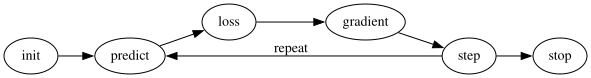

In [53]:
#id gradient_descent
#caption The gradient descent process
#alt Graph showing the steps for Gradient Descent
gv('''
init->predict->loss->gradient->step->stop
step->predict[label=repeat]
''')

There are many different ways to do each of these seven steps, and we will be learning about them throughout the rest of this book. These are the details that make a big difference for deep learning practitioners, but it turns out that the general approach to each one generally follows some basic principles. Here are a few guidelines:

- Initialize:: We initialize the parameters to random values. This may sound surprising. There are certainly other choices we could make, such as initializing them to the percentage of times that pixel is activated for that category—but since we already know that we have a routine to improve these weights, it turns out that just starting with random weights works perfectly well.
- Loss:: This is what Samuel referred to when he spoke of *testing the effectiveness of any current weight assignment in terms of actual performance*. We need some function that will return a number that is small if the performance of the model is good (the standard approach is to treat a small loss as good, and a large loss as bad, although this is just a convention).
- Step:: A simple way to figure out whether a weight should be increased a bit, or decreased a bit, would be just to try it: increase the weight by a small amount, and see if the loss goes up or down. Once you find the correct direction, you could then change that amount by a bit more, and a bit less, until you find an amount that works well. However, this is slow! As we will see, the magic of calculus allows us to directly figure out in which direction, and by roughly how much, to change each weight, without having to try all these small changes. The way to do this is by calculating *gradients*. This is just a performance optimization, we would get exactly the same results by using the slower manual process as well.
- Stop:: Once we've decided how many epochs to train the model for (a few suggestions for this were given in the earlier list), we apply that decision. This is where that decision is applied. For our digit classifier, we would keep training until the accuracy of the model started getting worse, or we ran out of time.

Before applying these steps to our image classification problem, let's illustrate what they look like in a simpler case. First we will define a very simple function, the quadratic—let's pretend that this is our loss function, and `x` is a weight parameter of the function:

In [54]:
def f(x): return x**2

Here is a graph of that function:

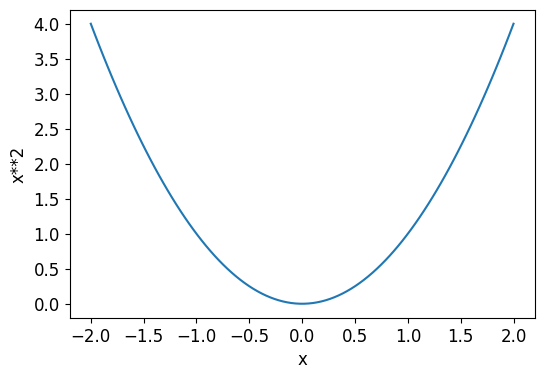

In [55]:
plot_function(f, 'x', 'x**2')

The sequence of steps we described earlier starts by picking some random value for a parameter, and calculating the value of the loss:

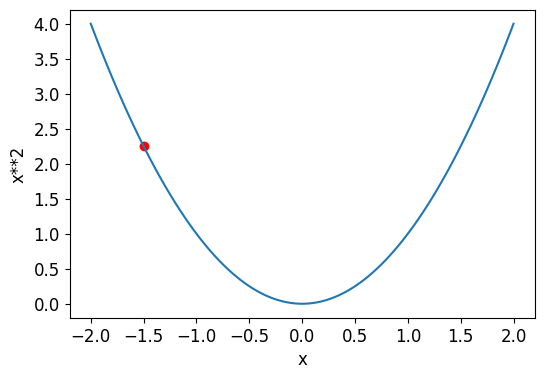

In [56]:
plot_function(f, 'x', 'x**2')
plt.scatter(-1.5, f(-1.5), color='red');

Now we look to see what would happen if we increased or decreased our parameter by a little bit—the *adjustment*. This is simply the slope at a particular point:

<img alt="A graph showing the squared function with the slope at one point" width="400" src="images/grad_illustration.svg"/>

We can change our weight by a little in the direction of the slope, calculate our loss and adjustment again, and repeat this a few times. Eventually, we will get to the lowest point on our curve:

<img alt="An illustration of gradient descent" width="400" src="images/chapter2_perfect.svg"/>

This basic idea goes all the way back to Isaac Newton, who pointed out that we can optimize arbitrary functions in this way. Regardless of how complicated our functions become, this basic approach of gradient descent will not significantly change. The only minor changes we will see later in this book are some handy ways we can make it faster, by finding better steps.

### Calculating Gradients

The one magic step is the bit where we calculate the gradients. As we mentioned, we use calculus as a performance optimization; it allows us to more quickly calculate whether our loss will go up or down when we adjust our parameters up or down. In other words, the gradients will tell us how much we have to change each weight to make our model better.

You may remember from your high school calculus class that the *derivative* of a function tells you how much a change in its parameters will change its result. If not, don't worry, lots of us forget calculus once high school is behind us! But you will have to have some intuitive understanding of what a derivative is before you continue, so if this is all very fuzzy in your head, head over to Khan Academy and complete the [lessons on basic derivatives](https://www.khanacademy.org/math/differential-calculus/dc-diff-intro). You won't have to know how to calculate them yourselves, you just have to know what a derivative is.

The key point about a derivative is this: for any function, such as the quadratic function we saw in the previous section, we can calculate its derivative. The derivative is another function. It calculates the change, rather than the value. For instance, the derivative of the quadratic function at the value 3 tells us how rapidly the function changes at the value 3. More specifically, you may recall that gradient is defined as *rise/run*, that is, the change in the value of the function, divided by the change in the value of the parameter. When we know how our function will change, then we know what we need to do to make it smaller. This is the key to machine learning: having a way to change the parameters of a function to make it smaller. Calculus provides us with a computational shortcut, the derivative, which lets us directly calculate the gradients of our functions.

One important thing to be aware of is that our function has lots of weights that we need to adjust, so when we calculate the derivative we won't get back one number, but lots of them—a gradient for every weight. But there is nothing mathematically tricky here; you can calculate the derivative with respect to one weight, and treat all the other ones as constant, then repeat that for each other weight. This is how all of the gradients are calculated, for every weight.

We mentioned just now that you won't have to calculate any gradients yourself. How can that be? Amazingly enough, PyTorch is able to automatically compute the derivative of nearly any function! What's more, it does it very fast. Most of the time, it will be at least as fast as any derivative function that you can create by hand. Let's see an example.

First, let's pick a tensor value which we want gradients at:

In [57]:
xt = tensor(3.).requires_grad_()

Notice the special method `requires_grad_`? That's the magical incantation we use to tell PyTorch that we want to calculate gradients with respect to that variable at that value. It is essentially tagging the variable, so PyTorch will remember to keep track of how to compute gradients of the other, direct calculations on it that you will ask for.

> a: This API might throw you off if you're coming from math or physics. In those contexts the "gradient" of a function is just another function (i.e., its derivative), so you might expect gradient-related APIs to give you a new function. But in deep learning, "gradients" usually means the _value_ of a function's derivative at a particular argument value. The PyTorch API also puts the focus on the argument, not the function you're actually computing the gradients of. It may feel backwards at first, but it's just a different perspective.

Now we calculate our function with that value. Notice how PyTorch prints not just the value calculated, but also a note that it has a gradient function it'll be using to calculate our gradients when needed:

In [58]:
yt = f(xt)
yt

tensor(9., grad_fn=<PowBackward0>)

Finally, we tell PyTorch to calculate the gradients for us:

In [59]:
yt.backward()

The "backward" here refers to *backpropagation*, which is the name given to the process of calculating the derivative of each layer. We'll see how this is done exactly in chapter <<chapter_foundations>>, when we calculate the gradients of a deep neural net from scratch. This is called the "backward pass" of the network, as opposed to the "forward pass," which is where the activations are calculated. Life would probably be easier if `backward` was just called `calculate_grad`, but deep learning folks really do like to add jargon everywhere they can!

We can now view the gradients by checking the `grad` attribute of our tensor:

In [60]:
xt.grad

tensor(6.)

If you remember your high school calculus rules, the derivative of `x**2` is `2*x`, and we have `x=3`, so the gradients should be `2*3=6`, which is what PyTorch calculated for us!

Now we'll repeat the preceding steps, but with a vector argument for our function:

In [61]:
xt = tensor([3.,4.,10.]).requires_grad_()
xt

tensor([ 3.,  4., 10.], requires_grad=True)

And we'll add `sum` to our function so it can take a vector (i.e., a rank-1 tensor), and return a scalar (i.e., a rank-0 tensor):

In [62]:
def f(x): return (x**2).sum()

yt = f(xt)
yt

tensor(125., grad_fn=<SumBackward0>)

Our gradients are `2*xt`, as we'd expect!

In [63]:
yt.backward()
xt.grad

tensor([ 6.,  8., 20.])

The gradients only tell us the slope of our function, they don't actually tell us exactly how far to adjust the parameters. But it gives us some idea of how far; if the slope is very large, then that may suggest that we have more adjustments to do, whereas if the slope is very small, that may suggest that we are close to the optimal value.

### Stepping With a Learning Rate

Deciding how to change our parameters based on the values of the gradients is an important part of the deep learning process. Nearly all approaches start with the basic idea of multiplying the gradient by some small number, called the *learning rate* (LR). The learning rate is often a number between 0.001 and 0.1, although it could be anything. Often, people select a learning rate just by trying a few, and finding which results in the best model after training (we'll show you a better approach later in this book, called the *learning rate finder*). Once you've picked a learning rate, you can adjust your parameters using this simple function:

```
w -= gradient(w) * lr
```

This is known as *stepping* your parameters, using an *optimizer step*. Notice how we _subtract_ the `gradient * lr` from the parameter to update it.  This allows us to adjust the parameter in the direction of the slope by increasing the parameter when the slope is negative and decreasing the parameter when the slope is positive.  We want to adjust our parameters in the direction of the slope because our goal in deep learning is to _minimize_ the loss.

If you pick a learning rate that's too low, it can mean having to do a lot of steps. <<descent_small>> illustrates that.

<img alt="An illustration of gradient descent with a LR too low" width="400" caption="Gradient descent with low LR" src="images/chapter2_small.svg" id="descent_small"/>

But picking a learning rate that's too high is even worse—it can actually result in the loss getting *worse*, as we see in <<descent_div>>!

<img alt="An illustration of gradient descent with a LR too high" width="400" caption="Gradient descent with high LR" src="images/chapter2_div.svg" id="descent_div"/>

If the learning rate is too high, it may also "bounce" around, rather than actually diverging; <<descent_bouncy>> shows how this has the result of taking many steps to train successfully.

<img alt="An illustation of gradient descent with a bouncy LR" width="400" caption="Gradient descent with bouncy LR" src="images/chapter2_bouncy.svg" id="descent_bouncy"/>

Now let's apply all of this in an end-to-end example.

### An End-to-End SGD Example

We've seen how to use gradients to find a minimum. Now it's time to look at an SGD example and see how finding a minimum can be used to train a model to fit data better.

Let's start with a simple, synthetic, example model. Imagine you were measuring the speed of a roller coaster as it went over the top of a hump. It would start fast, and then get slower as it went up the hill; it would be slowest at the top, and it would then speed up again as it went downhill. You want to build a model of how the speed changes over time. If you were measuring the speed manually every second for 20 seconds, it might look something like this:

In [64]:
time = torch.arange(0,20).float(); time

tensor([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12., 13., 14., 15., 16., 17., 18., 19.])

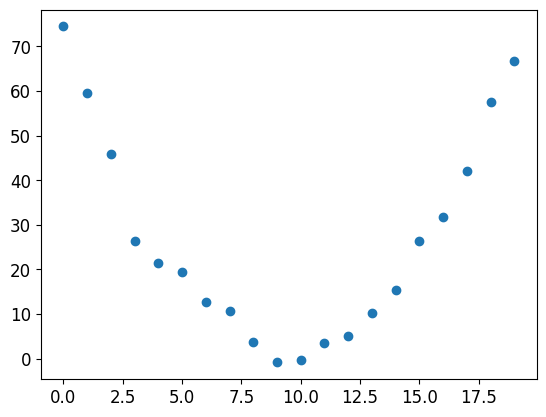

In [65]:
speed = torch.randn(20)*3 + 0.75*(time-9.5)**2 + 1
plt.scatter(time,speed);

We've added a bit of random noise, since measuring things manually isn't precise. This means it's not that easy to answer the question: what was the roller coaster's speed? Using SGD we can try to find a function that matches our observations. We can't consider every possible function, so let's use a guess that it will be quadratic; i.e., a function of the form `a*(time**2)+(b*time)+c`.

We want to distinguish clearly between the function's input (the time when we are measuring the coaster's speed) and its parameters (the values that define *which* quadratic we're trying). So, let's collect the parameters in one argument and thus separate the input, `t`, and the parameters, `params`, in the function's signature: 

In [66]:
def f(t, params):
    a,b,c = params
    return a*(t**2) + (b*t) + c

In other words, we've restricted the problem of finding the best imaginable function that fits the data, to finding the best *quadratic* function. This greatly simplifies the problem, since every quadratic function is fully defined by the three parameters `a`, `b`, and `c`. Thus, to find the best quadratic function, we only need to find the best values for `a`, `b`, and `c`.

If we can solve this problem for the three parameters of a quadratic function, we'll be able to apply the same approach for other, more complex functions with more parameters—such as a neural net. Let's find the parameters for `f` first, and then we'll come back and do the same thing for the MNIST dataset with a neural net.

We need to define first what we mean by "best." We define this precisely by choosing a *loss function*, which will return a value based on a prediction and a target, where lower values of the function correspond to "better" predictions. It is important for loss functions to return _lower_ values when predictions are more accurate, as the SGD procedure we defined earlier will try to _minimize_ this loss. For continuous data, it's common to use *mean squared error*:

In [67]:
def mse(preds, targets): return ((preds-targets)**2).mean()

Now, let's work through our 7 step process.

#### Step 1: Initialize the parameters

First, we initialize the parameters to random values, and tell PyTorch that we want to track their gradients, using `requires_grad_`:

In [68]:
params = torch.randn(3).requires_grad_()

In [69]:
#TEST DE MOI

params = torch.randn(3).requires_grad_()
preds = f(time, params)


In [70]:
def mse(preds, targets):
    return ((preds-targets)**2).mean()

In [71]:
loss = mse(preds, speed)
loss

tensor(8631.7373, grad_fn=<MeanBackward0>)

In [72]:
loss.backward()
params.grad

tensor([29901.0918,  1916.4382,   111.7121])

In [73]:
#Iterate once 
lr = 1e-5
params.data -= params.grad.data * lr
params.grad = None

In [74]:
params

tensor([ 0.3873, -0.3469,  0.7939], requires_grad=True)

In [76]:
preds = f(time, params)


In [77]:
#hide
orig_params = params.clone()

#### Step 2: Calculate the predictions

Next, we calculate the predictions:

In [78]:
preds = f(time, params)

Let's create a little function to see how close our predictions are to our targets, and take a look:

In [79]:
def show_preds(preds, ax=None):
    if ax is None: ax=plt.subplots()[1]
    ax.scatter(time, speed)
    ax.scatter(time, to_np(preds), color='red')
    ax.set_ylim(-300,100)

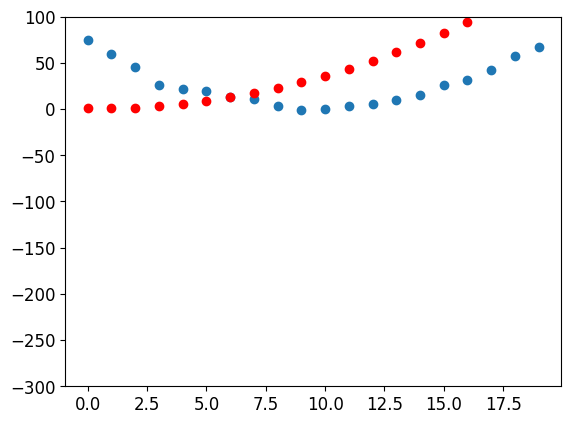

In [80]:
show_preds(preds)

This doesn't look very close—our random parameters suggest that the roller coaster will end up going backwards, since we have negative speeds!

#### Step 3: Calculate the loss

We calculate the loss as follows:

In [81]:
loss = mse(preds, speed)
loss

tensor(2190.2759, grad_fn=<MeanBackward0>)

Our goal is now to improve this. To do that, we'll need to know the gradients.

#### Step 4: Calculate the gradients

The next step is to calculate the gradients. In other words, calculate an approximation of how the parameters need to change:

In [82]:
loss.backward()
params.grad

tensor([13007.3086,   832.2540,    37.4900])

In [83]:
params.grad * 1e-5

tensor([0.1301, 0.0083, 0.0004])

We can use these gradients to improve our parameters. We'll need to pick a learning rate (we'll discuss how to do that in practice in the next chapter; for now we'll just use 1e-5, or 0.00001):

In [84]:
params

tensor([ 0.3873, -0.3469,  0.7939], requires_grad=True)

#### Step 5: Step the weights. 

Now we need to update the parameters based on the gradients we just calculated:

In [85]:
lr = 1e-5
params.data -= lr * params.grad.data
params.grad = None

> a: Understanding this bit depends on remembering recent history. To calculate the gradients we call `backward` on the `loss`. But this `loss` was itself calculated by `mse`, which in turn took `preds` as an input, which was calculated using `f` taking as an input `params`, which was the object on which we originally called `requires_grad_`—which is the original call that now allows us to call `backward` on `loss`. This chain of function calls represents the mathematical composition of functions, which enables PyTorch to use calculus's chain rule under the hood to calculate these gradients.

Let's see if the loss has improved:

In [86]:
preds = f(time,params)
mse(preds, speed)

tensor(971.3509, grad_fn=<MeanBackward0>)

And take a look at the plot:

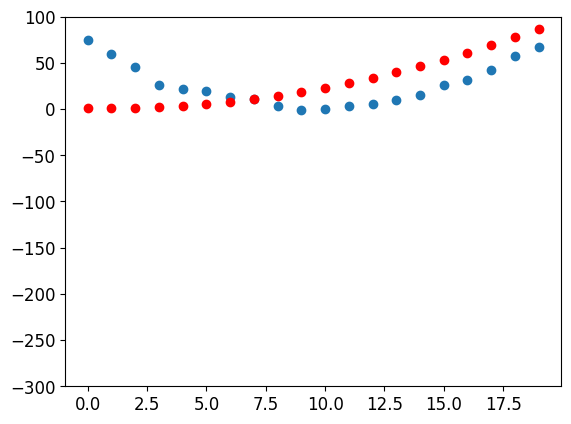

In [87]:
show_preds(preds)

We need to repeat this a few times, so we'll create a function to apply one step:

In [88]:
def apply_step(params, prn=True):
    preds = f(time, params)
    loss = mse(preds, speed)
    loss.backward()
    params.data -= lr * params.grad.data
    params.grad = None
    if prn: print(loss.item())
    return preds

#### Step 6: Repeat the process 

Now we iterate. By looping and performing many improvements, we hope to reach a good result:

In [89]:
for i in range(1000000): apply_step(params)

971.3508911132812
740.6900634765625
697.038818359375
688.775390625
687.2086181640625
686.9088134765625
686.8489990234375
686.8345947265625
686.8284912109375
686.8243408203125
686.8201904296875
686.8163452148438
686.8123168945312
686.8084716796875
686.8045043945312
686.8006591796875
686.7967529296875
686.7928466796875
686.788818359375
686.7850341796875
686.7811279296875
686.7770385742188
686.7730712890625
686.7692260742188
686.7652587890625
686.7614135742188
686.7574462890625
686.7535400390625
686.7496337890625
686.7457275390625
686.7417602539062
686.7378540039062
686.7339477539062
686.72998046875
686.7261962890625
686.72216796875
686.71826171875
686.7142944335938
686.7103881835938
686.7064819335938
686.7025146484375
686.6986083984375
686.6947021484375
686.6907958984375
686.6869506835938
686.6829833984375
686.6790161132812
686.675048828125
686.6712036132812
686.667236328125
686.6633911132812
686.659423828125
686.655517578125
686.651611328125
686.6477661132812
686.6438598632812
686.63977

675.9638061523438
675.9600830078125
675.9564208984375
675.952880859375
675.94921875
675.9456787109375
675.9420776367188
675.9383544921875
675.9347534179688
675.9312133789062
675.9276123046875
675.9238891601562
675.9202880859375
675.916748046875
675.9130249023438
675.9094848632812
675.9058837890625
675.9021606445312
675.8985595703125
675.8950805664062
675.8912963867188
675.8876953125
675.8841552734375
675.8804321289062
675.8768920898438
675.8732299804688
675.8696899414062
675.865966796875
675.8624267578125
675.8587646484375
675.8551025390625
675.8514404296875
675.847900390625
675.8442993164062
675.8406982421875
675.8370361328125
675.8334350585938
675.8297729492188
675.8262939453125
675.8225708007812
675.8189086914062
675.8153076171875
675.811767578125
675.8080444335938
675.8045043945312
675.8009033203125
675.7972412109375
675.7935791015625
675.7899780273438
675.786376953125
675.7828369140625
675.7791748046875
675.7755126953125
675.7718505859375
675.7682495117188
675.7646484375
675.76110

664.7849731445312
664.7815551757812
664.7781372070312
664.7747192382812
664.771240234375
664.7677612304688
664.764404296875
664.7608032226562
664.7573852539062
664.7539672851562
664.7503662109375
664.7469482421875
664.7435302734375
664.7401123046875
664.736572265625
664.7330932617188
664.7296752929688
664.7261962890625
664.7227783203125
664.71923828125
664.7158203125
664.7124633789062
664.7089233398438
664.7054443359375
664.7020263671875
664.6986083984375
664.6950073242188
664.691650390625
664.6881103515625
664.6846313476562
664.6812744140625
664.6778564453125
664.67431640625
664.6708374023438
664.6674194335938
664.6640014648438
664.6605224609375
664.6570434570312
664.6536865234375
664.6502075195312
664.6466064453125
664.6431884765625
664.6397705078125
664.6363525390625
664.6328735351562
664.6293334960938
664.6258544921875
664.6224975585938
664.6190185546875
664.615478515625
664.6121215820312
664.6087036132812
664.6051025390625
664.6016845703125
664.5982666015625
664.5947265625
664.591

653.9718017578125
653.96826171875
653.9649658203125
653.9615478515625
653.9583129882812
653.9548950195312
653.9515380859375
653.9480590820312
653.9447021484375
653.9412841796875
653.9380493164062
653.9346313476562
653.9313354492188
653.9278564453125
653.9246215820312
653.921142578125
653.9177856445312
653.9144287109375
653.9111328125
653.90771484375
653.904296875
653.90087890625
653.8976440429688
653.8942260742188
653.8909301757812
653.8875732421875
653.8841552734375
653.8807373046875
653.87744140625
653.8739624023438
653.8707275390625
653.8673095703125
653.8639526367188
653.8606567382812
653.8572998046875
653.8539428710938
653.8505859375
653.8472290039062
653.8438110351562
653.8404541015625
653.8370361328125
653.833740234375
653.830322265625
653.8270263671875
653.8236694335938
653.8202514648438
653.8168334960938
653.8134155273438
653.8101806640625
653.8067626953125
653.8034057617188
653.8001098632812
653.7967529296875
653.7933349609375
653.7899780273438
653.78662109375
653.78332519531

643.3527221679688
643.3494873046875
643.3460693359375
643.3428344726562
643.3395385742188
643.3363037109375
643.3329467773438
643.3296508789062
643.3263549804688
643.322998046875
643.3197021484375
643.3165283203125
643.3131103515625
643.3098754882812
643.3065185546875
643.3032836914062
643.2999267578125
643.2966918945312
643.2933349609375
643.2901000976562
643.2868041992188
643.283447265625
643.2801513671875
643.2769165039062
643.2735595703125
643.2703247070312
643.2670288085938
643.2637329101562
643.2603149414062
643.2571411132812
643.25390625
643.2505493164062
643.2472534179688
643.2439575195312
643.2406005859375
643.2374267578125
643.2340087890625
643.2307739257812
643.2274169921875
643.2241821289062
643.2208251953125
643.217529296875
643.2142333984375
643.2110595703125
643.2076416015625
643.2044067382812
643.2010498046875
643.1978149414062
643.1944580078125
643.1912231445312
643.1878662109375
643.1845703125
643.1812744140625
643.1780395507812
643.1746826171875
643.1715087890625
643

632.8018188476562
632.7985229492188
632.7953491210938
632.7921142578125
632.7889404296875
632.7855834960938
632.7823486328125
632.779052734375
632.77587890625
632.772705078125
632.7694091796875
632.7661743164062
632.7628784179688
632.7596435546875
632.7565307617188
632.7532348632812
632.7499389648438
632.7467651367188
632.7435302734375
632.7402954101562
632.737060546875
632.73388671875
632.7305908203125
632.7272338867188
632.7239990234375
632.7208862304688
632.7175903320312
632.7142944335938
632.7110595703125
632.7078857421875
632.7046508789062
632.701416015625
632.6981811523438
632.6949462890625
632.6917114257812
632.6885375976562
632.6852416992188
632.6820068359375
632.6787109375
632.6754150390625
632.6723022460938
632.6691284179688
632.6657104492188
632.6624755859375
632.6593017578125
632.6561279296875
632.65283203125
632.6495361328125
632.6463623046875
632.6431884765625
632.639892578125
632.6366577148438
632.6334228515625
632.6301879882812
632.626953125
632.6236572265625
632.620483

622.616455078125
622.6133422851562
622.6101684570312
622.6070556640625
622.6038208007812
622.6005859375
622.597412109375
622.59423828125
622.5910034179688
622.5878295898438
622.5845947265625
622.5814208984375
622.5782470703125
622.5750122070312
622.5718994140625
622.5687255859375
622.5655517578125
622.5623779296875
622.5592041015625
622.555908203125
622.552734375
622.549560546875
622.54638671875
622.543212890625
622.5400390625
622.5369262695312
622.5337524414062
622.5303955078125
622.5272827148438
622.5240478515625
622.5209350585938
622.5177612304688
622.5145263671875
622.5113525390625
622.5081787109375
622.5050048828125
622.5018310546875
622.4985961914062
622.4954223632812
622.4922485351562
622.4891357421875
622.48583984375
622.482666015625
622.4794311523438
622.4762573242188
622.4730834960938
622.4698486328125
622.4667358398438
622.4635009765625
622.4603271484375
622.4571533203125
622.4539794921875
622.4508056640625
622.4476318359375
622.4444580078125
622.4412841796875
622.4379882812

612.4949951171875
612.4918212890625
612.4888305664062
612.4856567382812
612.4825439453125
612.4794311523438
612.4761962890625
612.4730834960938
612.4699096679688
612.466796875
612.4637451171875
612.4605712890625
612.4573974609375
612.4542236328125
612.451171875
612.4481201171875
612.4449462890625
612.4418334960938
612.4386596679688
612.4354858398438
612.432373046875
612.4293212890625
612.4261474609375
612.4229736328125
612.4198608398438
612.4166870117188
612.4136962890625
612.4105224609375
612.4073486328125
612.4042358398438
612.4010620117188
612.39794921875
612.3948974609375
612.3917846679688
612.3886108398438
612.3853759765625
612.3822631835938
612.3792114257812
612.3760986328125
612.3729858398438
612.3697509765625
612.36669921875
612.3635864257812
612.3604125976562
612.3572998046875
612.3541259765625
612.3509521484375
612.3477783203125
612.3447875976562
612.3416748046875
612.3385620117188
612.3353271484375
612.3321533203125
612.3290405273438
612.3259887695312
612.3228759765625
612.3

602.4942626953125
602.4910888671875
602.4879760742188
602.4849853515625
602.48193359375
602.4788818359375
602.4757080078125
602.4725952148438
602.4696044921875
602.4664916992188
602.4635009765625
602.4602661132812
602.4571533203125
602.4541015625
602.4510498046875
602.447998046875
602.4448852539062
602.4418334960938
602.4388427734375
602.4356689453125
602.4324951171875
602.4295654296875
602.4263916015625
602.4234008789062
602.4202880859375
602.417236328125
602.4141235351562
602.4110107421875
602.4078979492188
602.4049072265625
602.4017944335938
602.3988037109375
602.3956298828125
602.3925170898438
602.389404296875
602.3863525390625
602.3832397460938
602.3802490234375
602.3770751953125
602.3740234375
602.3709716796875
602.3678588867188
602.3648681640625
602.3616943359375
602.358642578125
602.3555908203125
602.3524780273438
602.3494262695312
602.3463745117188
602.3432006835938
602.3402099609375
602.3370361328125
602.333984375
602.3309326171875
602.3278198242188
602.3247680664062
602.3216

592.7256469726562
592.7224731445312
592.7193603515625
592.716552734375
592.7135009765625
592.71044921875
592.7074584960938
592.7042846679688
592.7012939453125
592.6981811523438
592.6952514648438
592.6922607421875
592.689208984375
592.6862182617188
592.68310546875
592.6800537109375
592.677001953125
592.6740112304688
592.6710205078125
592.6680297851562
592.6649780273438
592.6619262695312
592.6588745117188
592.65576171875
592.65283203125
592.6497802734375
592.6467895507812
592.643798828125
592.6406860351562
592.6376342773438
592.6345825195312
592.631591796875
592.6286010742188
592.6255493164062
592.62255859375
592.6195068359375
592.616455078125
592.6134033203125
592.6102905273438
592.607421875
592.6043701171875
592.6011962890625
592.5982055664062
592.5951538085938
592.5921630859375
592.589111328125
592.586181640625
592.5831298828125
592.5801391601562
592.5770263671875
592.573974609375
592.5709838867188
592.5679931640625
592.5650024414062
592.5619506835938
592.5588989257812
592.55590820312

583.0972900390625
583.0943603515625
583.0914306640625
583.0884399414062
583.08544921875
583.0824584960938
583.0795288085938
583.0764770507812
583.0735473632812
583.0706787109375
583.0675659179688
583.0645751953125
583.0616455078125
583.0587158203125
583.0557250976562
583.052734375
583.0498046875
583.0467529296875
583.0438232421875
583.0408325195312
583.037841796875
583.034912109375
583.0319213867188
583.0289306640625
583.0259399414062
583.0230102539062
583.02001953125
583.01708984375
583.0140380859375
583.0111083984375
583.0081176757812
583.0051879882812
583.0022583007812
582.9992065429688
582.9962158203125
582.9932861328125
582.990234375
582.9872436523438
582.9843139648438
582.9813232421875
582.9783935546875
582.9754638671875
582.9723510742188
582.969482421875
582.9664306640625
582.9634399414062
582.9605712890625
582.9576416015625
582.9545288085938
582.9515380859375
582.94873046875
582.9456787109375
582.9425659179688
582.939697265625
582.936767578125
582.9337158203125
582.930786132812

573.6566162109375
573.6536254882812
573.6506958007812
573.6476440429688
573.6448364257812
573.6419677734375
573.6389770507812
573.635986328125
573.6331787109375
573.6301879882812
573.627197265625
573.6243896484375
573.6213989257812
573.6184692382812
573.6155395507812
573.6126098632812
573.6096801757812
573.6067504882812
573.6038208007812
573.6009521484375
573.5980224609375
573.5950927734375
573.5921020507812
573.5892944335938
573.5863037109375
573.5833129882812
573.580322265625
573.5775146484375
573.5745849609375
573.5715942382812
573.5687255859375
573.5657958984375
573.5628662109375
573.5599975585938
573.5570068359375
573.5540771484375
573.5511474609375
573.5482788085938
573.5453491210938
573.5424194335938
573.5394287109375
573.5364990234375
573.5336303710938
573.5307006835938
573.5277099609375
573.5248413085938
573.52197265625
573.5189819335938
573.5159912109375
573.5131225585938
573.5103149414062
573.50732421875
573.5043334960938
573.5014038085938
573.4985961914062
573.49560546875
5

564.353271484375
564.3504028320312
564.3474731445312
564.3446044921875
564.341796875
564.3389282226562
564.3359375
564.3330688476562
564.3302612304688
564.3273315429688
564.3245239257812
564.3215942382812
564.3187255859375
564.3157958984375
564.3128662109375
564.3099975585938
564.3071899414062
564.3042602539062
564.3013916015625
564.298583984375
564.295654296875
564.292724609375
564.2898559570312
564.2869873046875
564.2841186523438
564.28125
564.2782592773438
564.2754516601562
564.2725830078125
564.2696533203125
564.2667236328125
564.263916015625
564.2609252929688
564.2581176757812
564.2552490234375
564.2523803710938
564.24951171875
564.2465209960938
564.2437133789062
564.2407836914062
564.2379150390625
564.2350463867188
564.2322387695312
564.2293090820312
564.226318359375
564.2235107421875
564.2205810546875
564.2176513671875
564.21484375
564.2120361328125
564.2091064453125
564.2061767578125
564.2032470703125
564.200439453125
564.197509765625
564.1947021484375
564.1917724609375
564.188

555.2003784179688
555.197509765625
555.1947631835938
555.1918334960938
555.1890258789062
555.1862182617188
555.183349609375
555.1805419921875
555.177734375
555.1748657226562
555.1719970703125
555.1691284179688
555.1663818359375
555.16357421875
555.16064453125
555.1578979492188
555.155029296875
555.152099609375
555.1493530273438
555.146484375
555.1436767578125
555.1408081054688
555.1380004882812
555.1351928710938
555.13232421875
555.12939453125
555.126708984375
555.123779296875
555.1209106445312
555.1181640625
555.115234375
555.1124267578125
555.109619140625
555.1067504882812
555.10400390625
555.10107421875
555.0982666015625
555.0955200195312
555.0926513671875
555.0897827148438
555.0870361328125
555.0841064453125
555.0811767578125
555.0784301757812
555.0755615234375
555.0728149414062
555.0698852539062
555.0670776367188
555.0643310546875
555.0614013671875
555.0585327148438
555.0557861328125
555.0529174804688
555.0501098632812
555.0472412109375
555.0443725585938
555.04150390625
555.038696

546.1732788085938
546.1705322265625
546.1677856445312
546.1649780273438
546.1621704101562
546.1593017578125
546.1566162109375
546.15380859375
546.1510620117188
546.148193359375
546.1454467773438
546.1427001953125
546.139892578125
546.1370849609375
546.1343383789062
546.131591796875
546.1287841796875
546.1259765625
546.1232299804688
546.1204833984375
546.11767578125
546.1148071289062
546.1121826171875
546.1092529296875
546.1065063476562
546.1038208007812
546.1009521484375
546.0982055664062
546.0953979492188
546.0926513671875
546.08984375
546.0870361328125
546.0843505859375
546.0814819335938
546.0787353515625
546.0759887695312
546.0731201171875
546.0703735351562
546.067626953125
546.0647583007812
546.06201171875
546.0592041015625
546.0565185546875
546.0535888671875
546.0509643554688
546.048095703125
546.0452880859375
546.0425415039062
546.039794921875
546.0369873046875
546.0341796875
546.0315551757812
546.0286254882812
546.0259399414062
546.0231323242188
546.0203857421875
546.01751708984

537.313232421875
537.3104248046875
537.3077392578125
537.304931640625
537.3021850585938
537.2994995117188
537.2967529296875
537.2940673828125
537.2913208007812
537.2885131835938
537.2857055664062
537.2830200195312
537.2803344726562
537.2776489257812
537.2747802734375
537.2720947265625
537.2693481445312
537.2666015625
537.2638549804688
537.2611083984375
537.2583618164062
537.2555541992188
537.2528686523438
537.2501220703125
537.2473754882812
537.2446899414062
537.241943359375
537.2390747070312
537.2364501953125
537.2337036132812
537.2308959960938
537.2282104492188
537.2254638671875
537.2227783203125
537.219970703125
537.2172241210938
537.2144775390625
537.2117309570312
537.208984375
537.206298828125
537.2034912109375
537.2008056640625
537.1981201171875
537.1953125
537.192626953125
537.1898193359375
537.1870727539062
537.184326171875
537.181640625
537.1788330078125
537.1760864257812
537.1734008789062
537.170654296875
537.1678466796875
537.1651000976562
537.1624145507812
537.15966796875
5

528.6279907226562
528.6253662109375
528.6226806640625
528.619873046875
528.6172485351562
528.6144409179688
528.61181640625
528.6090698242188
528.6064453125
528.6036376953125
528.6009521484375
528.5982666015625
528.5955810546875
528.5928955078125
528.5902099609375
528.5875244140625
528.5847778320312
528.58203125
528.579345703125
528.5765991210938
528.573974609375
528.5713500976562
528.5685424804688
528.5657958984375
528.5631713867188
528.5604858398438
528.5577392578125
528.5549926757812
528.5523681640625
528.5496826171875
528.5469970703125
528.5442504882812
528.5415649414062
528.5387573242188
528.5361328125
528.5335083007812
528.5306396484375
528.5280151367188
528.5252075195312
528.5225830078125
528.5198974609375
528.5172119140625
528.5144653320312
528.5118408203125
528.5090942382812
528.50634765625
528.503662109375
528.5009155273438
528.498291015625
528.4955444335938
528.4928588867188
528.4901123046875
528.4874267578125
528.4848022460938
528.4819946289062
528.4793090820312
528.47668457

520.0380249023438
520.0355224609375
520.0327758789062
520.0300903320312
520.0274658203125
520.0249633789062
520.022216796875
520.01953125
520.0169677734375
520.01416015625
520.0115966796875
520.0089111328125
520.0062866210938
520.0036010742188
520.0010986328125
519.9983520507812
519.9956665039062
519.9930419921875
519.9903564453125
519.9876708984375
519.9851684570312
519.9824829101562
519.9797973632812
519.9771728515625
519.9744873046875
519.9718017578125
519.9691162109375
519.966552734375
519.9638671875
519.9612426757812
519.9586181640625
519.9559326171875
519.9533081054688
519.9506225585938
519.947998046875
519.9453735351562
519.9427490234375
519.9400634765625
519.9373779296875
519.934814453125
519.93212890625
519.9295043945312
519.9268188476562
519.9241943359375
519.9215087890625
519.9188842773438
519.9161376953125
519.91357421875
519.910888671875
519.908203125
519.9056396484375
519.9029541015625
519.900390625
519.897705078125
519.89501953125
519.892333984375
519.8897705078125
519.8

511.5814514160156
511.578857421875
511.576171875
511.5735778808594
511.57098388671875
511.56842041015625
511.5658264160156
511.5631408691406
511.560546875
511.5579528808594
511.55535888671875
511.552734375
511.5501403808594
511.54742431640625
511.544921875
511.542236328125
511.5396423339844
511.53704833984375
511.53448486328125
511.5318908691406
511.5292053222656
511.526611328125
511.5240173339844
511.5213317871094
511.51885986328125
511.51617431640625
511.5135192871094
511.51092529296875
511.50836181640625
511.5057678222656
511.50311279296875
511.50042724609375
511.4978942871094
511.4952697753906
511.49267578125
511.4900817871094
511.4874572753906
511.4847717285156
511.4822692871094
511.4795837402344
511.4769592285156
511.474365234375
511.4718322753906
511.4691467285156
511.466552734375
511.46392822265625
511.4613342285156
511.458740234375
511.4561462402344
511.45343017578125
511.450927734375
511.4483337402344
511.4456481933594
511.4430236816406
511.44049072265625
511.4378356933594
51

503.2216796875
503.2191467285156
503.21661376953125
503.2140197753906
503.2115173339844
503.20892333984375
503.2063903808594
503.20391845703125
503.201171875
503.19866943359375
503.1961364746094
503.19354248046875
503.1910095214844
503.1884765625
503.1858825683594
503.18341064453125
503.1807556152344
503.17822265625
503.1756286621094
503.173095703125
503.1705627441406
503.16796875
503.16546630859375
503.162841796875
503.1603088378906
503.15777587890625
503.1551208496094
503.1526794433594
503.1500549316406
503.14739990234375
503.14495849609375
503.1424255371094
503.13983154296875
503.1372985839844
503.13470458984375
503.1322326660156
503.12957763671875
503.1271057128906
503.12445068359375
503.1219177246094
503.11932373046875
503.1168518066406
503.11419677734375
503.1116638183594
503.10919189453125
503.1065368652344
503.10406494140625
503.1014709472656
503.09893798828125
503.09625244140625
503.09375
503.0911560058594
503.08868408203125
503.0860900878906
503.08349609375
503.0809631347656


495.0027770996094
495.000244140625
494.9977111816406
494.99517822265625
494.9927673339844
494.9900817871094
494.98760986328125
494.9851989746094
494.9825134277344
494.9801330566406
494.9775390625
494.9750061035156
494.97247314453125
494.97003173828125
494.9674377441406
494.9649963378906
494.96246337890625
494.95989990234375
494.9573669433594
494.954833984375
494.95233154296875
494.94976806640625
494.947265625
494.94482421875
494.9422912597656
494.939697265625
494.9371643066406
494.93463134765625
494.93212890625
494.9295959472656
494.9270935058594
494.92462158203125
494.92205810546875
494.9195251464844
494.91705322265625
494.9143981933594
494.9119567871094
494.90948486328125
494.9068908691406
494.9043884277344
494.90191650390625
494.8993225097656
494.8968200683594
494.89434814453125
494.89178466796875
494.8893127441406
494.88671875
494.88421630859375
494.8817443847656
494.87921142578125
494.8766174316406
494.8741149902344
494.87164306640625
494.86907958984375
494.8666076660156
494.86407

486.9998474121094
486.99737548828125
486.99481201171875
486.99237060546875
486.9898376464844
486.9873962402344
486.98492431640625
486.982421875
486.97991943359375
486.9773864746094
486.9749450683594
486.9725036621094
486.96990966796875
486.96746826171875
486.9649963378906
486.9625549316406
486.96002197265625
486.9576110839844
486.955078125
486.95257568359375
486.95013427734375
486.9476013183594
486.945068359375
486.942626953125
486.940185546875
486.9376525878906
486.9351501464844
486.9327087402344
486.93023681640625
486.92779541015625
486.92529296875
486.92279052734375
486.9202575683594
486.91778564453125
486.915283203125
486.91278076171875
486.9102478027344
486.9078674316406
486.9053649902344
486.90289306640625
486.900390625
486.89794921875
486.8953552246094
486.8929138183594
486.89044189453125
486.88800048828125
486.885498046875
486.8829650878906
486.8805236816406
486.8780212402344
486.87554931640625
486.87310791015625
486.8705139160156
486.8680725097656
486.86553955078125
486.863098

479.02703857421875
479.02459716796875
479.0220642089844
479.01971435546875
479.0172424316406
479.014892578125
479.0122985839844
479.0099182128906
479.007568359375
479.00506591796875
479.00262451171875
479.00018310546875
478.99774169921875
478.995361328125
478.99298095703125
478.990478515625
478.98809814453125
478.98565673828125
478.983154296875
478.980712890625
478.978271484375
478.97589111328125
478.973388671875
478.97100830078125
478.96856689453125
478.96612548828125
478.9637145996094
478.9612731933594
478.95880126953125
478.9563903808594
478.9540100097656
478.9515075683594
478.9490661621094
478.9466247558594
478.94427490234375
478.9417419433594
478.9393615722656
478.93695068359375
478.9344787597656
478.9320373535156
478.9295959472656
478.9270935058594
478.92474365234375
478.9222106933594
478.91986083984375
478.91741943359375
478.91497802734375
478.91253662109375
478.91009521484375
478.90771484375
478.9052734375
478.9027404785156
478.900390625
478.8978576660156
478.8955078125
478.893

471.1940002441406
471.1914978027344
471.18914794921875
471.186767578125
471.184326171875
471.18194580078125
471.17950439453125
471.1770935058594
471.1747131347656
471.17230224609375
471.169921875
471.1675720214844
471.1651916503906
471.16278076171875
471.16033935546875
471.157958984375
471.15557861328125
471.15313720703125
471.1507263183594
471.14825439453125
471.1459045410156
471.1435546875
471.1412048339844
471.1387634277344
471.1363220214844
471.134033203125
471.13153076171875
471.12921142578125
471.12677001953125
471.12432861328125
471.1219787597656
471.1194763183594
471.1171875
471.11480712890625
471.1123046875
471.1099548339844
471.1075134277344
471.105224609375
471.102783203125
471.10028076171875
471.09796142578125
471.0955505371094
471.0931091308594
471.0907287597656
471.08837890625
471.08599853515625
471.0835876464844
471.08111572265625
471.0787048339844
471.07635498046875
471.073974609375
471.071533203125
471.0691833496094
471.0667419433594
471.0643615722656
471.0619506835937

463.5628967285156
463.560546875
463.55816650390625
463.5558166503906
463.55340576171875
463.55108642578125
463.5486755371094
463.54632568359375
463.5439453125
463.5415954589844
463.539306640625
463.53692626953125
463.53448486328125
463.5322265625
463.52972412109375
463.5274963378906
463.5249938964844
463.522705078125
463.52032470703125
463.5179748535156
463.515625
463.5132751464844
463.5108337402344
463.508544921875
463.5061950683594
463.5038146972656
463.50146484375
463.4990234375
463.4966735839844
463.4942932128906
463.491943359375
463.4895935058594
463.48724365234375
463.48492431640625
463.4825134277344
463.48016357421875
463.47772216796875
463.4754333496094
463.4730529785156
463.470703125
463.4683532714844
463.4659118652344
463.46356201171875
463.4613342285156
463.4588317871094
463.4564514160156
463.45416259765625
463.4518127441406
463.44940185546875
463.44708251953125
463.4446716308594
463.44232177734375
463.43988037109375
463.4375915527344
463.43524169921875
463.432861328125
463.

455.98382568359375
455.9815979003906
455.97918701171875
455.9768981933594
455.97467041015625
455.9723205566406
455.969970703125
455.9676818847656
455.96527099609375
455.9630432128906
455.960693359375
455.9584045410156
455.9560546875
455.9537658691406
455.95147705078125
455.94915771484375
455.9468688964844
455.944580078125
455.942138671875
455.93994140625
455.93756103515625
455.9352111816406
455.93292236328125
455.9305725097656
455.9283142089844
455.92596435546875
455.92364501953125
455.92138671875
455.9190979003906
455.91680908203125
455.914306640625
455.912109375
455.9097595214844
455.907470703125
455.9051208496094
455.90283203125
455.9004821777344
455.898193359375
455.8959045410156
455.8935546875
455.8912658691406
455.8890075683594
455.8865661621094
455.88433837890625
455.8819274902344
455.87957763671875
455.8773498535156
455.87506103515625
455.8727111816406
455.87042236328125
455.86810302734375
455.8658142089844
455.8634338378906
455.8611755371094
455.8587951660156
455.8565368652344

448.55682373046875
448.55450439453125
448.55224609375
448.5499572753906
448.54766845703125
448.5453186035156
448.5430603027344
448.54083251953125
448.5384826660156
448.5362854003906
448.53399658203125
448.5316467285156
448.5293884277344
448.527099609375
448.52484130859375
448.5225524902344
448.520263671875
448.5179748535156
448.515625
448.51348876953125
448.5111389160156
448.5088806152344
448.506591796875
448.5043029785156
448.50201416015625
448.49969482421875
448.49749755859375
448.4951171875
448.49285888671875
448.4905700683594
448.48828125
448.48602294921875
448.4837341308594
448.4815368652344
448.47918701171875
448.47686767578125
448.474609375
448.4723205566406
448.4701232910156
448.46783447265625
448.4654846191406
448.4632263183594
448.4609375
448.4586486816406
448.4563903808594
448.45416259765625
448.4518127441406
448.4495544433594
448.447265625
448.44500732421875
448.4427185058594
448.4404296875
448.43817138671875
448.43585205078125
448.43359375
448.4313049316406
448.42895507812

441.23394775390625
441.2315979003906
441.22943115234375
441.2271423339844
441.2249450683594
441.22265625
441.22039794921875
441.21820068359375
441.2159729003906
441.2137145996094
441.21142578125
441.209228515625
441.2069396972656
441.2046813964844
441.20245361328125
441.2001953125
441.19793701171875
441.19573974609375
441.19342041015625
441.1912536621094
441.18902587890625
441.18670654296875
441.1844787597656
441.1822204589844
441.17999267578125
441.17767333984375
441.17547607421875
441.1731872558594
441.17095947265625
441.168701171875
441.16650390625
441.16424560546875
441.1620178222656
441.1597595214844
441.15753173828125
441.15521240234375
441.15301513671875
441.1507873535156
441.14849853515625
441.146240234375
441.14398193359375
441.14178466796875
441.1394958496094
441.1372985839844
441.13507080078125
441.13275146484375
441.1305236816406
441.1282653808594
441.1260681152344
441.123779296875
441.12152099609375
441.119384765625
441.1170349121094
441.11480712890625
441.11260986328125
4

434.0430603027344
434.04083251953125
434.03863525390625
434.0364685058594
434.03424072265625
434.031982421875
434.02978515625
434.02752685546875
434.02532958984375
434.0231018066406
434.02099609375
434.01873779296875
434.0164489746094
434.0143127441406
434.0121154785156
434.0098571777344
434.0077209472656
434.00555419921875
434.0033264160156
434.0010681152344
433.9988708496094
433.9967346191406
433.9945373535156
433.9922790527344
433.9901428222656
433.9879455566406
433.9857482910156
433.9834899902344
433.9813537597656
433.9790954589844
433.9769592285156
433.9747009277344
433.9725036621094
433.9703674316406
433.96807861328125
433.9659118652344
433.9637145996094
433.9615783691406
433.9593200683594
433.9571228027344
433.9549865722656
433.9527893066406
433.9505310058594
433.9483337402344
433.9461975097656
433.94390869140625
433.94171142578125
433.9395446777344
433.93731689453125
433.9351501464844
433.93292236328125
433.93072509765625
433.92852783203125
433.9263610839844
433.92413330078125


426.99945068359375
426.99737548828125
426.99517822265625
426.9930114746094
426.99078369140625
426.9886779785156
426.9864196777344
426.98431396484375
426.9820861816406
426.9798889160156
426.977783203125
426.97552490234375
426.97332763671875
426.97113037109375
426.968994140625
426.966796875
426.9646911621094
426.96246337890625
426.96026611328125
426.9580993652344
426.9559020996094
426.9537048339844
426.9515075683594
426.94940185546875
426.9471740722656
426.9449768066406
426.94281005859375
426.94061279296875
426.93841552734375
426.936279296875
426.93414306640625
426.93194580078125
426.92974853515625
426.92755126953125
426.92535400390625
426.9232482910156
426.9209899902344
426.9188537597656
426.91656494140625
426.91448974609375
426.91229248046875
426.91009521484375
426.90789794921875
426.90576171875
426.903564453125
426.90142822265625
426.89923095703125
426.89703369140625
426.8948669433594
426.8926696777344
426.8905334472656
426.8882751464844
426.88604736328125
426.88397216796875
426.88174

420.01568603515625
420.0135192871094
420.0113830566406
420.00927734375
420.00714111328125
420.00494384765625
420.0028381347656
420.00067138671875
419.99853515625
419.9964294433594
419.9942321777344
419.99212646484375
419.99005126953125
419.9878845214844
419.9857482910156
419.983642578125
419.9815368652344
419.97930908203125
419.9772033691406
419.97509765625
419.97296142578125
419.97076416015625
419.9686584472656
419.96649169921875
419.96441650390625
419.9622497558594
419.9600524902344
419.9580078125
419.955810546875
419.9537048339844
419.9515686035156
419.949462890625
419.9473571777344
419.9452209472656
419.9430236816406
419.94091796875
419.93878173828125
419.9366760253906
419.9344787597656
419.932373046875
419.9302673339844
419.9280700683594
419.92596435546875
419.923828125
419.9217224121094
419.9195251464844
419.91741943359375
419.915283203125
419.91314697265625
419.9110412597656
419.9088439941406
419.90673828125
419.90460205078125
419.9024963378906
419.9002990722656
419.898254394531

413.15203857421875
413.14990234375
413.1477966308594
413.145751953125
413.1437072753906
413.14154052734375
413.13946533203125
413.13739013671875
413.13531494140625
413.1332092285156
413.13116455078125
413.1290588378906
413.126953125
413.1249084472656
413.122802734375
413.12066650390625
413.1185607910156
413.116455078125
413.1144104003906
413.11236572265625
413.1101989746094
413.10809326171875
413.1060485839844
413.10394287109375
413.1018981933594
413.09979248046875
413.09771728515625
413.0956115722656
413.09356689453125
413.0914611816406
413.08929443359375
413.08721923828125
413.0851135253906
413.08306884765625
413.08099365234375
413.07891845703125
413.0768127441406
413.07470703125
413.0726013183594
413.07061767578125
413.0684509277344
413.06634521484375
413.0643005371094
413.0621643066406
413.06011962890625
413.0579528808594
413.05584716796875
413.0538024902344
413.05169677734375
413.0496520996094
413.0475158691406
413.04547119140625
413.0433654785156
413.041259765625
413.039215087890

406.782470703125
406.7803955078125
406.77825927734375
406.7762451171875
406.7741394042969
406.7720947265625
406.77001953125
406.7679138183594
406.7658996582031
406.7637634277344
406.76171875
406.7596435546875
406.757568359375
406.7554931640625
406.75341796875
406.7513732910156
406.749267578125
406.74725341796875
406.74517822265625
406.7430725097656
406.7409973144531
406.7389221191406
406.73687744140625
406.73480224609375
406.73272705078125
406.73065185546875
406.7285461425781
406.7264709472656
406.72442626953125
406.7223205566406
406.72027587890625
406.71820068359375
406.7161560058594
406.7140808105469
406.7120056152344
406.70989990234375
406.70782470703125
406.7057800292969
406.7037353515625
406.7016296386719
406.69952392578125
406.6974792480469
406.69537353515625
406.693359375
406.6912536621094
406.6892395019531
406.6871643066406
406.68499755859375
406.6829833984375
406.6809387207031
406.6788635253906
406.67681884765625
406.6747131347656
406.672607421875
406.6705627441406
406.6685180

400.5591125488281
400.5570373535156
400.55499267578125
400.5530090332031
400.5509948730469
400.5489196777344
400.5469055175781
400.54486083984375
400.5428466796875
400.540771484375
400.5387878417969
400.5367126464844
400.5347595214844
400.53271484375
400.5306701660156
400.5285949707031
400.5266418457031
400.52459716796875
400.5225524902344
400.5205078125
400.51849365234375
400.5164794921875
400.51446533203125
400.51239013671875
400.5103454589844
400.50836181640625
400.5063171386719
400.5042724609375
400.5022888183594
400.500244140625
400.4981994628906
400.49615478515625
400.494140625
400.49212646484375
400.4901123046875
400.488037109375
400.4860534667969
400.48406982421875
400.4819641113281
400.47991943359375
400.4779357910156
400.47589111328125
400.473876953125
400.4718322753906
400.46978759765625
400.4677734375
400.46575927734375
400.46368408203125
400.4617004394531
400.45965576171875
400.4576721191406
400.45562744140625
400.4535827636719
400.4515686035156
400.4494934082031
400.44747

394.3945617675781
394.3925476074219
394.3905944824219
394.3885498046875
394.3865051269531
394.3844909667969
394.38250732421875
394.3804626464844
394.3784484863281
394.37646484375
394.37445068359375
394.3724060058594
394.37042236328125
394.368408203125
394.3664245605469
394.3643493652344
394.36236572265625
394.3603515625
394.3583679199219
394.35638427734375
394.35430908203125
394.3523254394531
394.3503112792969
394.3482971191406
394.3462219238281
394.34429931640625
394.3422546386719
394.3402404785156
394.3382263183594
394.3362121582031
394.3341979980469
394.3321838378906
394.3302001953125
394.328125
394.326171875
394.32415771484375
394.32208251953125
394.3200988769531
394.318115234375
394.31610107421875
394.3140563964844
394.31207275390625
394.3100280761719
394.30804443359375
394.30596923828125
394.30401611328125
394.30206298828125
394.29998779296875
394.2979736328125
394.2959899902344
394.2939453125
394.29193115234375
394.2899475097656
394.2879638671875
394.28594970703125
394.283935546

388.38916015625
388.38714599609375
388.38519287109375
388.38323974609375
388.3813171386719
388.3793029785156
388.3773498535156
388.3753967285156
388.37335205078125
388.37139892578125
388.36944580078125
388.36749267578125
388.36553955078125
388.36358642578125
388.361572265625
388.3595886230469
388.35760498046875
388.35565185546875
388.3537292480469
388.35174560546875
388.3497619628906
388.3477478027344
388.34576416015625
388.3438415527344
388.34185791015625
388.33990478515625
388.33795166015625
388.33599853515625
388.333984375
388.3320007324219
388.3300476074219
388.3280944824219
388.32611083984375
388.32415771484375
388.3222351074219
388.3202209472656
388.3182678222656
388.3162841796875
388.31427001953125
388.3123474121094
388.31036376953125
388.30841064453125
388.3064270019531
388.304443359375
388.30255126953125
388.3005065917969
388.2984924316406
388.29656982421875
388.29461669921875
388.29266357421875
388.2906494140625
388.28875732421875
388.2867431640625
388.28472900390625
388.2827

382.42529296875
382.42333984375
382.42138671875
382.41949462890625
382.41754150390625
382.4156188964844
382.41363525390625
382.4117431640625
382.40985107421875
382.40789794921875
382.40594482421875
382.4040832519531
382.40216064453125
382.40020751953125
382.3982238769531
382.3963623046875
382.39447021484375
382.39251708984375
382.39056396484375
382.38861083984375
382.38671875
382.3847961425781
382.3828430175781
382.38092041015625
382.3789978027344
382.3770446777344
382.3751525878906
382.37322998046875
382.371337890625
382.3693542480469
382.3674011230469
382.36553955078125
382.3636169433594
382.36163330078125
382.3597106933594
382.3577880859375
382.3559265136719
382.3539733886719
382.3520202636719
382.3500671386719
382.34814453125
382.34625244140625
382.34429931640625
382.3423767089844
382.3404846191406
382.3385009765625
382.33660888671875
382.33465576171875
382.3327331542969
382.3307800292969
382.328857421875
382.3269348144531
382.3250427246094
382.3230895996094
382.3211669921875
382.3

376.5415954589844
376.53961181640625
376.53778076171875
376.535888671875
376.5339660644531
376.53204345703125
376.53009033203125
376.5282287597656
376.5262756347656
376.5243835449219
376.5224609375
376.52056884765625
376.51861572265625
376.5167541503906
376.51483154296875
376.512939453125
376.5109558105469
376.5090637207031
376.5072021484375
376.5052795410156
376.50335693359375
376.50140380859375
376.4995422363281
376.49761962890625
376.49566650390625
376.4937438964844
376.49188232421875
376.4899597167969
376.48809814453125
376.4861145019531
376.4842224121094
376.4823303222656
376.48040771484375
376.47845458984375
376.4765625
376.4747009277344
376.4727478027344
376.4708557128906
376.46893310546875
376.46697998046875
376.4650573730469
376.46319580078125
376.4612731933594
376.4593811035156
376.4574890136719
376.4555358886719
376.4536437988281
376.4517517089844
376.44976806640625
376.4478759765625
376.4460144042969
376.444091796875
376.44219970703125
376.4402160644531
376.4383850097656
37

370.50433349609375
370.50250244140625
370.5005798339844
370.498779296875
370.49688720703125
370.49505615234375
370.4931640625
370.49127197265625
370.4893798828125
370.4875793457031
370.48565673828125
370.48382568359375
370.48193359375
370.4800720214844
370.4781799316406
370.476318359375
370.47442626953125
370.47259521484375
370.4706726074219
370.4688415527344
370.46697998046875
370.4650573730469
370.46319580078125
370.46136474609375
370.45947265625
370.4576110839844
370.4556579589844
370.4538879394531
370.45196533203125
370.4501647949219
370.4482727050781
370.4464111328125
370.44451904296875
370.44268798828125
370.4407653808594
370.43896484375
370.43707275390625
370.4351806640625
370.4333190917969
370.43145751953125
370.4295654296875
370.427734375
370.4258117675781
370.4239807128906
370.42205810546875
370.42022705078125
370.4183349609375
370.4164733886719
370.4145812988281
370.41278076171875
370.4108581542969
370.4090576171875
370.4070739746094
370.4052429199219
370.40338134765625
370.

364.49481201171875
364.49298095703125
364.4911193847656
364.4892578125
364.48736572265625
364.4855651855469
364.48370361328125
364.48187255859375
364.4799499511719
364.4781188964844
364.47625732421875
364.47442626953125
364.4725341796875
364.4707336425781
364.4688415527344
364.4670104980469
364.46514892578125
364.4632873535156
364.46142578125
364.4596252441406
364.4577331542969
364.4559020996094
364.45404052734375
364.45220947265625
364.4503173828125
364.448486328125
364.4466247558594
364.44482421875
364.44293212890625
364.4410705566406
364.4392395019531
364.4373474121094
364.4355163574219
364.4336853027344
364.4317626953125
364.4299621582031
364.4280700683594
364.42626953125
364.42437744140625
364.42254638671875
364.4206237792969
364.4188232421875
364.41693115234375
364.4150695800781
364.4132080078125
364.41143798828125
364.4095153808594
364.40771484375
364.40582275390625
364.404052734375
364.40216064453125
364.40032958984375
364.3984680175781
364.3965759277344
364.39471435546875
364.

358.58038330078125
358.5785827636719
358.5768127441406
358.5749816894531
358.5731506347656
358.5713195800781
358.56951904296875
358.56768798828125
358.56585693359375
358.5640869140625
358.562255859375
358.5604553222656
358.55865478515625
358.55682373046875
358.5550231933594
358.5531921386719
358.5513916015625
358.54962158203125
358.54779052734375
358.5459289550781
358.54412841796875
358.5423278808594
358.5404968261719
358.5386962890625
358.5368957519531
358.5350646972656
358.53326416015625
358.53143310546875
358.5296325683594
358.52777099609375
358.5260314941406
358.52423095703125
358.52239990234375
358.52056884765625
358.51873779296875
358.5169372558594
358.51513671875
358.51336669921875
358.51153564453125
358.50970458984375
358.50787353515625
358.5060729980469
358.5042724609375
358.5024719238281
358.5006408691406
358.4988098144531
358.49700927734375
358.49517822265625
358.49334716796875
358.4915466308594
358.48974609375
358.4879455566406
358.4861145019531
358.48431396484375
358.48254

352.7383117675781
352.73651123046875
352.73468017578125
352.7328796386719
352.73114013671875
352.7293395996094
352.7275085449219
352.7257385253906
352.7239685058594
352.7221984863281
352.7203369140625
352.71856689453125
352.7167663574219
352.7149353027344
352.7131652832031
352.71136474609375
352.7095947265625
352.707763671875
352.7059631347656
352.7041931152344
352.7024230957031
352.70062255859375
352.69879150390625
352.697021484375
352.6952209472656
352.69342041015625
352.69158935546875
352.6898193359375
352.68804931640625
352.68621826171875
352.68438720703125
352.6825866699219
352.68084716796875
352.6790771484375
352.67718505859375
352.6754455566406
352.67364501953125
352.671875
352.6700744628906
352.66827392578125
352.66650390625
352.6646728515625
352.6628723144531
352.66107177734375
352.6593017578125
352.657470703125
352.6556701660156
352.6539001464844
352.6521301269531
352.65032958984375
352.64849853515625
352.6466979980469
352.6449279785156
352.6430969238281
352.64129638671875
35

347.0459899902344
347.0443115234375
347.0425720214844
347.040771484375
347.03900146484375
347.0372314453125
347.0354919433594
347.0337219238281
347.031982421875
347.03021240234375
347.0284423828125
347.02667236328125
347.02496337890625
347.023193359375
347.0214538574219
347.0196533203125
347.0179443359375
347.01617431640625
347.0143737792969
347.0126647949219
347.01092529296875
347.0091552734375
347.0074157714844
347.0056457519531
347.00390625
347.0020751953125
347.0003662109375
346.9986267089844
346.9968566894531
346.9950866699219
346.99334716796875
346.9915466308594
346.98980712890625
346.98809814453125
346.986328125
346.98455810546875
346.9827880859375
346.9810485839844
346.9792785644531
346.9775085449219
346.9757080078125
346.9740295410156
346.9722595214844
346.97052001953125
346.96868896484375
346.9669494628906
346.9652099609375
346.96343994140625
346.9617004394531
346.9599609375
346.95819091796875
346.9564208984375
346.9546813964844
346.95294189453125
346.951171875
346.9494628906

341.4441223144531
341.4423522949219
341.44061279296875
341.43890380859375
341.43719482421875
341.43548583984375
341.43377685546875
341.43206787109375
341.4303894042969
341.4286193847656
341.4268798828125
341.4252014160156
341.42352294921875
341.4217529296875
341.4200134277344
341.4183044433594
341.4166259765625
341.4148864746094
341.4132080078125
341.41143798828125
341.4097900390625
341.40802001953125
341.4062805175781
341.40460205078125
341.40289306640625
341.4012145996094
341.3994445800781
341.39776611328125
341.39605712890625
341.3943176269531
341.3926086425781
341.3908996582031
341.38916015625
341.38751220703125
341.3857116699219
341.384033203125
341.3822937011719
341.38055419921875
341.37884521484375
341.37713623046875
341.37542724609375
341.37371826171875
341.37200927734375
341.37030029296875
341.3685607910156
341.36688232421875
341.3651123046875
341.3634033203125
341.3616943359375
341.3599853515625
341.3582763671875
341.3565368652344
341.3548583984375
341.3531188964844
341.35137

335.92132568359375
335.91961669921875
335.9178771972656
335.91619873046875
335.91448974609375
335.91278076171875
335.9111328125
335.909423828125
335.9077453613281
335.90606689453125
335.9043273925781
335.902587890625
335.90087890625
335.899169921875
335.8974914550781
335.8957824707031
335.89410400390625
335.89239501953125
335.89068603515625
335.88897705078125
335.88726806640625
335.88555908203125
335.88385009765625
335.8821716308594
335.8804626464844
335.8787841796875
335.8770751953125
335.8753356933594
335.8736572265625
335.8719787597656
335.87030029296875
335.8685302734375
335.8668518066406
335.86517333984375
335.8634033203125
335.8616943359375
335.86004638671875
335.85833740234375
335.85662841796875
335.85491943359375
335.8532409667969
335.8515625
335.8498229980469
335.84808349609375
335.8464050292969
335.8446960449219
335.8430480957031
335.84130859375
335.8396301269531
335.83795166015625
335.83624267578125
335.8345031738281
335.83282470703125
335.83111572265625
335.8294372558594
33

330.44647216796875
330.44482421875
330.44317626953125
330.44146728515625
330.4398193359375
330.4382019042969
330.4364929199219
330.43487548828125
330.4332275390625
330.4315185546875
330.4298400878906
330.4281921386719
330.42657470703125
330.4248962402344
330.4232482910156
330.42156982421875
330.4198913574219
330.4182434082031
330.4165954589844
330.41485595703125
330.4132385253906
330.41156005859375
330.409912109375
330.40826416015625
330.4065856933594
330.4049072265625
330.4032897949219
330.4016418457031
330.3999328613281
330.39825439453125
330.3966064453125
330.3949279785156
330.39324951171875
330.3916320800781
330.38995361328125
330.3882751464844
330.38665771484375
330.3849792480469
330.3833312988281
330.3816223144531
330.3799743652344
330.37835693359375
330.37664794921875
330.375
330.3733215332031
330.3716735839844
330.37005615234375
330.36834716796875
330.36669921875
330.36505126953125
330.36334228515625
330.3617248535156
330.36004638671875
330.3583679199219
330.35675048828125
330.

325.0789794921875
325.07733154296875
325.07568359375
325.07403564453125
325.0723876953125
325.0707702636719
325.06915283203125
325.0674743652344
325.06585693359375
325.0641784667969
325.0625305175781
325.06085205078125
325.0591735839844
325.05755615234375
325.055908203125
325.05426025390625
325.0526428222656
325.0509948730469
325.04931640625
325.04766845703125
325.0460510253906
325.04437255859375
325.0426940917969
325.04107666015625
325.0394287109375
325.0377197265625
325.03607177734375
325.03448486328125
325.03289794921875
325.03118896484375
325.029541015625
325.02789306640625
325.0262756347656
325.02459716796875
325.02294921875
325.02130126953125
325.0196228027344
325.01800537109375
325.01629638671875
325.01470947265625
325.01300048828125
325.0114440917969
325.0097961425781
325.00811767578125
325.00640869140625
325.00482177734375
325.003173828125
325.0014953613281
324.99981689453125
324.99822998046875
324.9965515136719
324.99493408203125
324.9932556152344
324.99163818359375
324.98999

319.8186950683594
319.81707763671875
319.8154602050781
319.8138732910156
319.81219482421875
319.8106384277344
319.80902099609375
319.8074035644531
319.8057861328125
319.80413818359375
319.80255126953125
319.8009948730469
319.79937744140625
319.79779052734375
319.796142578125
319.7945556640625
319.79290771484375
319.7912902832031
319.78973388671875
319.7880554199219
319.7864990234375
319.78485107421875
319.78326416015625
319.7816467285156
319.7800598144531
319.77838134765625
319.77679443359375
319.7751770019531
319.7735595703125
319.7720031738281
319.7703857421875
319.768798828125
319.7671813964844
319.7655334472656
319.7639465332031
319.7623596191406
319.7607421875
319.75909423828125
319.75750732421875
319.75592041015625
319.7542724609375
319.7526550292969
319.75103759765625
319.74945068359375
319.74786376953125
319.7462463378906
319.74462890625
319.7430725097656
319.74139404296875
319.73980712890625
319.7381896972656
319.736572265625
319.73492431640625
319.73333740234375
319.731750488

314.6415710449219
314.6399841308594
314.638427734375
314.6368103027344
314.63519287109375
314.6336364746094
314.63201904296875
314.6304626464844
314.6288146972656
314.6272277832031
314.6256408691406
314.6240539550781
314.6224670410156
314.620849609375
314.6192932128906
314.61761474609375
314.6160583496094
314.61444091796875
314.6128845214844
314.611328125
314.60968017578125
314.60809326171875
314.6064758300781
314.6048889160156
314.603271484375
314.6017150878906
314.6001281738281
314.5984802246094
314.5968933105469
314.5953063964844
314.5937194824219
314.5921325683594
314.59051513671875
314.58892822265625
314.58734130859375
314.5857238769531
314.5841064453125
314.5825500488281
314.58099365234375
314.5793762207031
314.5777282714844
314.576171875
314.5745544433594
314.5729675292969
314.57135009765625
314.56976318359375
314.56817626953125
314.5665588378906
314.5649719238281
314.56341552734375
314.5617980957031
314.5602111816406
314.55853271484375
314.5570068359375
314.5553894042969
314.55

309.5923767089844
309.5907897949219
309.58929443359375
309.58770751953125
309.5861511230469
309.5845642089844
309.5830383300781
309.58148193359375
309.5799255371094
309.5783386230469
309.5767822265625
309.5751953125
309.57366943359375
309.5721130371094
309.570556640625
309.5690002441406
309.56744384765625
309.56585693359375
309.5643005371094
309.562744140625
309.56121826171875
309.55963134765625
309.5580749511719
309.5565185546875
309.5549621582031
309.55340576171875
309.5518798828125
309.55029296875
309.54876708984375
309.54718017578125
309.545654296875
309.5440673828125
309.54254150390625
309.54095458984375
309.53936767578125
309.537841796875
309.5362243652344
309.53472900390625
309.5331726074219
309.5315856933594
309.530029296875
309.5284729003906
309.52691650390625
309.525390625
309.52386474609375
309.5222473144531
309.5206604003906
309.5191345214844
309.51763916015625
309.5160217285156
309.51446533203125
309.51287841796875
309.51129150390625
309.509765625
309.50823974609375
309.50

304.5874938964844
304.5859680175781
304.58441162109375
304.5828552246094
304.581298828125
304.57977294921875
304.57818603515625
304.57666015625
304.5750732421875
304.57354736328125
304.572021484375
304.57049560546875
304.5689697265625
304.5673828125
304.56585693359375
304.5643005371094
304.562744140625
304.56121826171875
304.55963134765625
304.5581359863281
304.55657958984375
304.5550842285156
304.5534973144531
304.5519104003906
304.55035400390625
304.5487976074219
304.5472717285156
304.5457763671875
304.544189453125
304.54266357421875
304.5411071777344
304.5395812988281
304.53802490234375
304.5364990234375
304.534912109375
304.53338623046875
304.5318298339844
304.53033447265625
304.52874755859375
304.5271911621094
304.5256042480469
304.5240783691406
304.5225524902344
304.52105712890625
304.51947021484375
304.5179443359375
304.516357421875
304.51483154296875
304.5133056640625
304.5117492675781
304.51019287109375
304.50860595703125
304.507080078125
304.50555419921875
304.5039978027344
3

299.68719482421875
299.6856994628906
299.6842041015625
299.6827087402344
299.6811828613281
299.67962646484375
299.6781311035156
299.6766052246094
299.6751403808594
299.6736145019531
299.6720886230469
299.67059326171875
299.6690979003906
299.66754150390625
299.6660461425781
299.66461181640625
299.6630554199219
299.66156005859375
299.6600341796875
299.65850830078125
299.6570129394531
299.65545654296875
299.65399169921875
299.6524963378906
299.6509704589844
299.6494445800781
299.6479797363281
299.6464538574219
299.6449279785156
299.6434020996094
299.64190673828125
299.64044189453125
299.6388854980469
299.63739013671875
299.63592529296875
299.6343688964844
299.63287353515625
299.63128662109375
299.62982177734375
299.6283264160156
299.62677001953125
299.6252746582031
299.623779296875
299.622314453125
299.6207580566406
299.6192626953125
299.6177673339844
299.61627197265625
299.61474609375
299.61322021484375
299.61175537109375
299.6101989746094
299.60870361328125
299.607177734375
299.60565185

294.85076904296875
294.8492736816406
294.84771728515625
294.84625244140625
294.84478759765625
294.8432922363281
294.8418273925781
294.84027099609375
294.8387756347656
294.83734130859375
294.8358154296875
294.8342590332031
294.832763671875
294.8313293457031
294.8298034667969
294.82830810546875
294.8267822265625
294.8252868652344
294.8238220214844
294.82232666015625
294.82086181640625
294.8193359375
294.8178405761719
294.81634521484375
294.8148498535156
294.8133544921875
294.81182861328125
294.81036376953125
294.808837890625
294.807373046875
294.80584716796875
294.80438232421875
294.80291748046875
294.8013610839844
294.79986572265625
294.79840087890625
294.79693603515625
294.7953796386719
294.79388427734375
294.7923583984375
294.7908935546875
294.7894287109375
294.78790283203125
294.786376953125
294.784912109375
294.783447265625
294.7819519042969
294.7803955078125
294.7789001464844
294.77740478515625
294.77593994140625
294.7744445800781
294.77294921875
294.7714538574219
294.7699584960937

290.08880615234375
290.08740234375
290.0859069824219
290.08441162109375
290.08294677734375
290.08148193359375
290.08001708984375
290.07855224609375
290.0771179199219
290.0756530761719
290.0741882324219
290.0727233886719
290.0712890625
290.06982421875
290.068359375
290.06689453125
290.0654296875
290.06396484375
290.0624694824219
290.06109619140625
290.0595703125
290.0580749511719
290.0566711425781
290.0552062988281
290.0537414550781
290.0522766113281
290.05084228515625
290.0493469238281
290.04791259765625
290.0464172363281
290.04498291015625
290.04351806640625
290.04205322265625
290.0405578613281
290.03912353515625
290.03765869140625
290.03619384765625
290.03472900390625
290.0332946777344
290.03179931640625
290.03033447265625
290.0289001464844
290.0274353027344
290.0260009765625
290.0245056152344
290.0230407714844
290.0216064453125
290.0201110839844
290.0187072753906
290.0171813964844
290.0157165527344
290.0142822265625
290.0128173828125
290.0113220214844
290.0098876953125
290.008422851

285.3709716796875
285.3695373535156
285.36810302734375
285.36663818359375
285.3652038574219
285.3637390136719
285.3623046875
285.3608703613281
285.35943603515625
285.3579406738281
285.35650634765625
285.3550720214844
285.35357666015625
285.3522033691406
285.3506774902344
285.3492736816406
285.34783935546875
285.3464050292969
285.34490966796875
285.3434753417969
285.342041015625
285.3406066894531
285.339111328125
285.3376770019531
285.33624267578125
285.33477783203125
285.33331298828125
285.3318786621094
285.3304443359375
285.3290100097656
285.32757568359375
285.32611083984375
285.32464599609375
285.3232116699219
285.32171630859375
285.3203125
285.31884765625
285.31744384765625
285.31597900390625
285.31451416015625
285.3130798339844
285.3116149902344
285.3102111816406
285.3087463378906
285.3072509765625
285.30584716796875
285.30438232421875
285.30291748046875
285.301513671875
285.3000183105469
285.2986145019531
285.2971496582031
285.29571533203125
285.29425048828125
285.2928161621094
28

280.75091552734375
280.74945068359375
280.7480773925781
280.74664306640625
280.7452697753906
280.74383544921875
280.7424011230469
280.7409973144531
280.7395935058594
280.7381896972656
280.73675537109375
280.7353515625
280.73394775390625
280.7325134277344
280.73114013671875
280.729736328125
280.7282409667969
280.72686767578125
280.72540283203125
280.7240295410156
280.72265625
280.72119140625
280.71978759765625
280.7183837890625
280.71697998046875
280.7156066894531
280.71417236328125
280.7127380371094
280.7113037109375
280.70989990234375
280.7085266113281
280.7071228027344
280.7056884765625
280.7042541503906
280.7028503417969
280.701416015625
280.70001220703125
280.6985778808594
280.69720458984375
280.6957702636719
280.69439697265625
280.69293212890625
280.6914978027344
280.6901550292969
280.6887512207031
280.68731689453125
280.6859130859375
280.6844482421875
280.68304443359375
280.681640625
280.6802062988281
280.67877197265625
280.6774597167969
280.67596435546875
280.6745910644531
280.6

276.25
276.24859619140625
276.2471618652344
276.24578857421875
276.24432373046875
276.2429504394531
276.2415771484375
276.2402038574219
276.23876953125
276.23736572265625
276.2359924316406
276.2345886230469
276.2331237792969
276.2318115234375
276.23040771484375
276.22894287109375
276.2275695800781
276.2261657714844
276.2247619628906
276.22332763671875
276.22198486328125
276.2205505371094
276.2191467285156
276.2177734375
276.21636962890625
276.21490478515625
276.2135314941406
276.2121887207031
276.21075439453125
276.2093200683594
276.20794677734375
276.2065734863281
276.20513916015625
276.2037048339844
276.20233154296875
276.200927734375
276.19952392578125
276.1980895996094
276.19671630859375
276.1953430175781
276.1939697265625
276.1925048828125
276.19110107421875
276.1897277832031
276.1883544921875
276.1869201660156
276.1855163574219
276.18414306640625
276.1827087402344
276.1812438964844
276.1799011230469
276.17852783203125
276.1771240234375
276.17572021484375
276.1742858886719
276.172

271.8115539550781
271.8101501464844
271.80877685546875
271.80743408203125
271.80609130859375
271.8046875
271.8033447265625
271.8019714355469
271.80059814453125
271.79925537109375
271.7978820800781
271.7965087890625
271.79510498046875
271.79376220703125
271.79241943359375
271.7909851074219
271.7896423339844
271.7882995605469
271.7868957519531
271.78558349609375
271.7842102050781
271.7828674316406
271.7814636230469
271.78009033203125
271.77874755859375
271.7773742675781
271.7759704589844
271.774658203125
271.77325439453125
271.77191162109375
271.7704772949219
271.76910400390625
271.76776123046875
271.76641845703125
271.7649841308594
271.7637023925781
271.7623291015625
271.76092529296875
271.75958251953125
271.7582092285156
271.7568359375
271.7554626464844
271.75408935546875
271.75274658203125
271.7513732910156
271.75
271.7486267089844
271.74725341796875
271.7458801269531
271.74456787109375
271.7431335449219
271.74176025390625
271.7404479980469
271.73907470703125
271.73773193359375
271.73

267.399658203125
267.3983154296875
267.39691162109375
267.39556884765625
267.39422607421875
267.39288330078125
267.3915100097656
267.3901672363281
267.3887939453125
267.38739013671875
267.3860778808594
267.38470458984375
267.38336181640625
267.38201904296875
267.38067626953125
267.37933349609375
267.3779602050781
267.3765563964844
267.375244140625
267.37384033203125
267.37249755859375
267.37115478515625
267.36981201171875
267.36846923828125
267.3670959472656
267.3657531738281
267.3643493652344
267.363037109375
267.3616943359375
267.3603210449219
267.35894775390625
267.35760498046875
267.35626220703125
267.3548889160156
267.35357666015625
267.3522033691406
267.350830078125
267.3494567871094
267.34808349609375
267.34674072265625
267.34539794921875
267.34405517578125
267.3426818847656
267.3413391113281
267.3399658203125
267.338623046875
267.3372802734375
267.3359375
267.3345642089844
267.3332214355469
267.33184814453125
267.33050537109375
267.32916259765625
267.3277893066406
267.326477050

263.11968994140625
263.11834716796875
263.1170959472656
263.1157531738281
263.1143798828125
263.1130676269531
263.11175537109375
263.1104736328125
263.1091613769531
263.1077880859375
263.1064758300781
263.1051330566406
263.1037902832031
263.1025085449219
263.1011962890625
263.0998840332031
263.0985412597656
263.09722900390625
263.09588623046875
263.0946044921875
263.09320068359375
263.0918884277344
263.09063720703125
263.08929443359375
263.0879821777344
263.086669921875
263.0852966308594
263.0839538574219
263.0826721191406
263.0813903808594
263.0800476074219
263.07867431640625
263.077392578125
263.0760803222656
263.07476806640625
263.07342529296875
263.07208251953125
263.0707702636719
263.0694580078125
263.068115234375
263.0667724609375
263.0655212402344
263.06414794921875
263.06280517578125
263.06146240234375
263.0602111816406
263.05889892578125
263.0575256347656
263.05621337890625
263.0549011230469
263.0536193847656
263.0522766113281
263.05096435546875
263.04962158203125
263.04827880

258.85906982421875
258.85772705078125
258.8564453125
258.8551330566406
258.85382080078125
258.8525085449219
258.8511962890625
258.8498840332031
258.84857177734375
258.8472595214844
258.845947265625
258.8446350097656
258.84326171875
258.8420104980469
258.8406982421875
258.83941650390625
258.8380126953125
258.83673095703125
258.83544921875
258.83416748046875
258.83282470703125
258.8315124511719
258.83026123046875
258.82891845703125
258.8276062011719
258.8262939453125
258.82501220703125
258.8236389160156
258.822265625
258.8210144042969
258.81976318359375
258.81842041015625
258.8170471191406
258.8157653808594
258.8144836425781
258.81317138671875
258.8118591308594
258.810546875
258.8092346191406
258.80792236328125
258.80657958984375
258.8053283691406
258.80401611328125
258.80267333984375
258.8013610839844
258.800048828125
258.7987976074219
258.79742431640625
258.79608154296875
258.7947998046875
258.79351806640625
258.79217529296875
258.7908630371094
258.7895812988281
258.7882385253906
258.7

254.74832153320312
254.74703979492188
254.7457733154297
254.7444610595703
254.74319458007812
254.74191284179688
254.7406463623047
254.7393798828125
254.73806762695312
254.73678588867188
254.7355499267578
254.73422241210938
254.7329559326172
254.731689453125
254.73037719726562
254.72909545898438
254.7278594970703
254.72659301757812
254.7252960205078
254.7239990234375
254.7227325439453
254.72146606445312
254.72021484375
254.71890258789062
254.7176055908203
254.7163848876953
254.7150421142578
254.7137908935547
254.71249389648438
254.7112579345703
254.70993041992188
254.7086639404297
254.70742797851562
254.7061004638672
254.704833984375
254.70358276367188
254.7022705078125
254.70101928710938
254.6997528076172
254.69845581054688
254.69717407226562
254.6959228515625
254.6946563720703
254.6933135986328
254.69204711914062
254.69076538085938
254.6894989013672
254.68820190429688
254.6869659423828
254.6856689453125
254.68441772460938
254.68313598632812
254.68185424804688
254.6805419921875
254.679

250.67776489257812
250.6764678955078
250.6751708984375
250.67391967773438
250.6726531982422
250.67141723632812
250.670166015625
250.6688995361328
250.66757202148438
250.66635131835938
250.6650848388672
250.66378784179688
250.66250610351562
250.6612091064453
250.6599884033203
250.65872192382812
250.65744018554688
250.6561737060547
250.6549072265625
250.6536865234375
250.6523895263672
250.65109252929688
250.6498565673828
250.6486053466797
250.6472930908203
250.6460723876953
250.64480590820312
250.6435089111328
250.64224243164062
250.64096069335938
250.6396942138672
250.638427734375
250.6371612548828
250.63589477539062
250.63467407226562
250.6333770751953
250.632080078125
250.63082885742188
250.6295928955078
250.62832641601562
250.62704467773438
250.6257781982422
250.62451171875
250.62326049804688
250.62197875976562
250.6206817626953
250.619384765625
250.6181640625
250.6168670654297
250.6156463623047
250.6143341064453
250.61306762695312
250.61181640625
250.61056518554688
250.6092834472656

246.6846923828125
246.68344116210938
246.6822052001953
246.6809539794922
246.6796875
246.6785430908203
246.67727661132812
246.676025390625
246.6748046875
246.6735076904297
246.67233276367188
246.6710662841797
246.6698455810547
246.6685791015625
246.66738891601562
246.66610717773438
246.6648712158203
246.66366577148438
246.66244506835938
246.6612091064453
246.65994262695312
246.65872192382812
246.657470703125
246.65625
246.65499877929688
246.6537628173828
246.65255737304688
246.6512908935547
246.6500701904297
246.6488494873047
246.6475830078125
246.64633178710938
246.64511108398438
246.64389038085938
246.64266967773438
246.6414337158203
246.64013671875
246.63894653320312
246.6376953125
246.636474609375
246.6351776123047
246.6339874267578
246.6327667236328
246.63150024414062
246.63027954101562
246.6290283203125
246.6278076171875
246.62655639648438
246.62533569335938
246.6240692138672
246.6228790283203
246.6216583251953
246.620361328125
246.61917114257812
246.617919921875
246.616729736328

242.71435546875
242.71316528320312
242.7119140625
242.71066284179688
242.70944213867188
242.708251953125
242.70700073242188
242.705810546875
242.7045135498047
242.7033233642578
242.70211791992188
242.7008819580078
242.6996612548828
242.6984405517578
242.6971893310547
242.6959686279297
242.6947784423828
242.6934814453125
242.6922607421875
242.69107055664062
242.68984985351562
242.6885986328125
242.6874237060547
242.68618774414062
242.68496704101562
242.6837158203125
242.68252563476562
242.68130493164062
242.6800537109375
242.6788330078125
242.6776123046875
242.67642211914062
242.67514038085938
242.6739044189453
242.6726837158203
242.67147827148438
242.6702423095703
242.66903686523438
242.66781616210938
242.66659545898438
242.6653289794922
242.66409301757812
242.6629180908203
242.6616668701172
242.6604766845703
242.6592254638672
242.6580047607422
242.65676879882812
242.65554809570312
242.654296875
242.653076171875
242.6519317626953
242.65066528320312
242.64944458007812
242.6482391357422


238.86257934570312
238.8614044189453
238.8601837158203
238.8590087890625
238.85781860351562
238.8566131591797
238.85543823242188
238.8541717529297
238.85302734375
238.8518524169922
238.85061645507812
238.84945678710938
238.8482666015625
238.8470458984375
238.8458709716797
238.8446807861328
238.84347534179688
238.84228515625
238.84109497070312
238.8398895263672
238.83871459960938
238.8374786376953
238.83633422851562
238.83511352539062
238.8338623046875
238.8327178955078
238.83151245117188
238.830322265625
238.82913208007812
238.8279266357422
238.8267364501953
238.8255615234375
238.8243865966797
238.8231658935547
238.8219451904297
238.82080078125
238.81954956054688
238.818359375
238.8172149658203
238.8159942626953
238.81478881835938
238.8135986328125
238.8124237060547
238.81124877929688
238.81002807617188
238.80880737304688
238.8076629638672
238.80642700195312
238.8052215576172
238.8040771484375
238.8028564453125
238.80166625976562
238.80044555664062
238.79922485351562
238.798095703125
2

235.03524780273438
235.0340576171875
235.03286743164062
235.0316619873047
235.03048706054688
235.029296875
235.0281524658203
235.02694702148438
235.02572631835938
235.02456665039062
235.02340698242188
235.022216796875
235.02102661132812
235.0198211669922
235.0186767578125
235.01748657226562
235.0162811279297
235.01516723632812
235.0139617919922
235.01272583007812
235.01156616210938
235.01040649414062
235.0092315673828
235.0079803466797
235.0067901611328
235.0056610107422
235.0044708251953
235.00326538085938
235.00210571289062
235.0009002685547
234.9997100830078
234.99856567382812
234.99740600585938
234.9961700439453
234.99502563476562
234.99380493164062
234.9926300048828
234.99142456054688
234.99026489257812
234.9890594482422
234.98788452148438
234.9866943359375
234.9855194091797
234.9843292236328
234.98312377929688
234.9819793701172
234.9807891845703
234.9796142578125
234.9784393310547
234.9772491455078
234.97607421875
234.974853515625
234.9737091064453
234.97250366210938
234.97131347

231.28030395507812
231.2791748046875
231.2779541015625
231.27682495117188
231.2756805419922
231.2745361328125
231.2733917236328
231.2722625732422
231.2710418701172
231.26992797851562
231.2687530517578
231.267578125
231.2664337158203
231.2653045654297
231.2641143798828
231.2629852294922
231.26181030273438
231.2606964111328
231.259521484375
231.2583465576172
231.2572021484375
231.2560272216797
231.25491333007812
231.2537078857422
231.2525634765625
231.25149536132812
231.2502899169922
231.2490997314453
231.2479705810547
231.24685668945312
231.2456817626953
231.24453735351562
231.24337768554688
231.2422332763672
231.24105834960938
231.2398681640625
231.23876953125
231.23764038085938
231.23648071289062
231.2352752685547
231.23410034179688
231.2329864501953
231.2318115234375
231.230712890625
231.22952270507812
231.22836303710938
231.2272491455078
231.22604370117188
231.2249298095703
231.22378540039062
231.2225799560547
231.2214813232422
231.22030639648438
231.2191162109375
231.218017578125
2

227.57077026367188
227.569580078125
227.56845092773438
227.5673065185547
227.56619262695312
227.56503295898438
227.5638427734375
227.56271362304688
227.5615997314453
227.5603790283203
227.5592803955078
227.5581512451172
227.5570068359375
227.5558624267578
227.55471801757812
227.5535888671875
227.5524139404297
227.55130004882812
227.5501708984375
227.5490264892578
227.54788208007812
227.5467071533203
227.5455780029297
227.54443359375
227.5432891845703
227.54214477539062
227.541015625
227.5398712158203
227.53872680664062
227.5375518798828
227.5364227294922
227.53530883789062
227.5341339111328
227.5330047607422
227.5318603515625
227.5307159423828
227.5295867919922
227.52841186523438
227.5272216796875
227.5260772705078
227.52499389648438
227.52383422851562
227.52267456054688
227.5215606689453
227.5203857421875
227.51925659179688
227.51809692382812
227.51693725585938
227.51583862304688
227.51467895507812
227.51351928710938
227.5123748779297
227.51126098632812
227.5101318359375
227.508956909

223.9084014892578
223.9073028564453
223.9061737060547
223.9051055908203
223.90396118164062
223.90286254882812
223.90176391601562
223.900634765625
223.8995361328125
223.89840698242188
223.8972625732422
223.8961639404297
223.89505004882812
223.8939666748047
223.89285278320312
223.89169311523438
223.890625
223.8894805908203
223.8883819580078
223.8872528076172
223.88613891601562
223.88504028320312
223.88388061523438
223.88278198242188
223.88168334960938
223.88052368164062
223.8794708251953
223.8783721923828
223.8772430419922
223.87612915039062
223.87503051757812
223.8739013671875
223.87277221679688
223.87167358398438
223.8705596923828
223.8694305419922
223.8683319091797
223.86721801757812
223.86611938476562
223.86495971679688
223.8638916015625
223.86276245117188
223.8616485595703
223.8605499267578
223.85940551757812
223.8583526611328
223.85720825195312
223.85604858398438
223.85494995117188
223.8538360595703
223.8527069091797
223.8516082763672
223.8505401611328
223.84939575195312
223.848297

220.3361358642578
220.3350067138672
220.3339080810547
220.33279418945312
220.33169555664062
220.33056640625
220.32949829101562
220.328369140625
220.3272705078125
220.326171875
220.3250732421875
220.323974609375
220.3228759765625
220.32174682617188
220.32064819335938
220.3195037841797
220.31845092773438
220.31735229492188
220.31625366210938
220.3151092529297
220.3140106201172
220.3129425048828
220.3118133544922
220.3107452392578
220.30960083007812
220.3085174560547
220.3074188232422
220.30630493164062
220.30520629882812
220.3040771484375
220.30300903320312
220.3019256591797
220.30081176757812
220.2996826171875
220.29855346679688
220.2974395751953
220.2963409423828
220.29525756835938
220.29415893554688
220.2930450439453
220.2919464111328
220.2908172607422
220.28970336914062
220.2886505126953
220.2875213623047
220.2864227294922
220.28530883789062
220.28421020507812
220.28311157226562
220.28201293945312
220.28091430664062
220.27978515625
220.2786865234375
220.277587890625
220.2765197753906

216.7989959716797
216.79788208007812
216.79678344726562
216.79568481445312
216.7946014404297
216.7935028076172
216.7924346923828
216.7913055419922
216.7902069091797
216.7891387939453
216.7880401611328
216.7869415283203
216.78585815429688
216.7847442626953
216.78369140625
216.7825927734375
216.78146362304688
216.78036499023438
216.77926635742188
216.77816772460938
216.77706909179688
216.77597045898438
216.77493286132812
216.7738037109375
216.772705078125
216.7716064453125
216.7705078125
216.7694549560547
216.76834106445312
216.76724243164062
216.76614379882812
216.76504516601562
216.76394653320312
216.7628631591797
216.7617645263672
216.7606658935547
216.75955200195312
216.75845336914062
216.75735473632812
216.7562713623047
216.7551727294922
216.7541046142578
216.7530059814453
216.7519073486328
216.7507781982422
216.7496795654297
216.7486114501953
216.74755859375
216.74642944335938
216.74533081054688
216.74423217773438
216.74313354492188
216.74203491210938
216.74093627929688
216.7398681

213.30020141601562
213.29916381835938
213.2981414794922
213.29708862304688
213.29605102539062
213.2949981689453
213.29391479492188
213.2929229736328
213.29183959960938
213.29080200195312
213.28976440429688
213.28872680664062
213.28768920898438
213.28662109375
213.2855682373047
213.28451538085938
213.28347778320312
213.28244018554688
213.2813720703125
213.2803497314453
213.279296875
213.2782440185547
213.27719116210938
213.27615356445312
213.2751007080078
213.27407836914062
213.2730255126953
213.27194213867188
213.2709197998047
213.2698974609375
213.26882934570312
213.26779174804688
213.26675415039062
213.2657012939453
213.2646484375
213.2635955810547
213.2625274658203
213.2615203857422
213.2604522705078
213.25942993164062
213.2583770751953
213.2573699951172
213.2562713623047
213.25521850585938
213.25418090820312
213.25314331054688
213.2520751953125
213.2510223388672
213.24996948242188
213.24893188476562
213.2478790283203
213.24685668945312
213.24575805664062
213.2447509765625
213.24369

209.9431915283203
209.94216918945312
209.9411163330078
209.94009399414062
209.9390411376953
209.93798828125
209.9369659423828
209.9359130859375
209.9348907470703
209.93380737304688
209.93283081054688
209.9317626953125
209.9307403564453
209.9296875
209.92868041992188
209.9276123046875
209.92660522460938
209.925537109375
209.9244842529297
209.9234619140625
209.9224395751953
209.92141723632812
209.9203643798828
209.9193115234375
209.9182891845703
209.917236328125
209.9162139892578
209.9151611328125
209.9141082763672
209.91311645507812
209.91207885742188
209.9110107421875
209.9099578857422
209.908935546875
209.9079132080078
209.9068603515625
209.9058380126953
209.90478515625
209.9037628173828
209.9027099609375
209.90170288085938
209.900634765625
209.8995819091797
209.8985595703125
209.8975372314453
209.89651489257812
209.8954315185547
209.89443969726562
209.8933563232422
209.892333984375
209.8912811279297
209.8902587890625
209.8892364501953
209.88821411132812
209.8871612548828
209.88610839

206.61984252929688
206.61880493164062
206.6177978515625
206.6167755126953
206.61572265625
206.61471557617188
206.61367797851562
206.61264038085938
206.61160278320312
206.61056518554688
206.6095428466797
206.6085205078125
206.6074981689453
206.60647583007812
206.60543823242188
206.60440063476562
206.6033935546875
206.6023406982422
206.60134887695312
206.6002960205078
206.59927368164062
206.5982208251953
206.5972442626953
206.59616088867188
206.5951690673828
206.5941162109375
206.59310913085938
206.5920867919922
206.591064453125
206.5900115966797
206.5889892578125
206.5879669189453
206.58694458007812
206.58590698242188
206.5848846435547
206.5838623046875
206.5828094482422
206.58175659179688
206.5807647705078
206.5797119140625
206.5786895751953
206.5776824951172
206.57662963867188
206.5756072998047
206.57455444335938
206.57357788085938
206.57254028320312
206.5714874267578
206.5704803466797
206.56942749023438
206.5684356689453
206.5673828125
206.56637573242188
206.56533813476562
206.564331

203.31495666503906
203.31394958496094
203.31292724609375
203.31190490722656
203.31088256835938
203.30987548828125
203.3088836669922
203.30783081054688
203.30682373046875
203.30581665039062
203.30477905273438
203.3037567138672
203.302734375
203.3017120361328
203.30068969726562
203.29966735839844
203.29864501953125
203.29762268066406
203.29664611816406
203.29559326171875
203.29457092285156
203.29356384277344
203.29254150390625
203.29151916503906
203.29049682617188
203.2895050048828
203.2884521484375
203.28744506835938
203.28639221191406
203.285400390625
203.28439331054688
203.28335571289062
203.28231811523438
203.28131103515625
203.28030395507812
203.27926635742188
203.27825927734375
203.27725219726562
203.2762451171875
203.2751922607422
203.274169921875
203.27317810058594
203.2721405029297
203.2711181640625
203.27011108398438
203.26907348632812
203.26806640625
203.2670440673828
203.26602172851562
203.26498413085938
203.26400756835938
203.26296997070312
203.26193237304688
203.26094055175

200.04180908203125
200.04075622558594
200.03976440429688
200.0387420654297
200.03775024414062
200.03671264648438
200.0357208251953
200.03469848632812
200.03369140625
200.03268432617188
200.0316619873047
200.03067016601562
200.02963256835938
200.0286102294922
200.02760314941406
200.02662658691406
200.02560424804688
200.0245819091797
200.02357482910156
200.0225372314453
200.02154541015625
200.02053833007812
200.01953125
200.0185089111328
200.01748657226562
200.01651000976562
200.01548767089844
200.0144805908203
200.0135040283203
200.01246643066406
200.01144409179688
200.0104217529297
200.00942993164062
200.00840759277344
200.00741577148438
200.00637817382812
200.00538635253906
200.00436401367188
200.00335693359375
200.00233459472656
200.0013427734375
200.0003204345703
199.9993133544922
199.99832153320312
199.99729919433594
199.99627685546875
199.99526977539062
199.9942626953125
199.99322509765625
199.9922332763672
199.9912109375
199.99020385742188
199.9892120361328
199.98818969726562
199

196.85025024414062
196.84930419921875
196.84832763671875
196.8473663330078
196.8463897705078
196.84542846679688
196.84449768066406
196.843505859375
196.84254455566406
196.84153747558594
196.84060668945312
196.8396453857422
196.8386688232422
196.83770751953125
196.8367462158203
196.8357391357422
196.83477783203125
196.83384704589844
196.83290100097656
196.83192443847656
196.83094787597656
196.8300018310547
196.8290252685547
196.82806396484375
196.8270721435547
196.8261260986328
196.82516479492188
196.8241729736328
196.82322692871094
196.82228088378906
196.82130432128906
196.82034301757812
196.81936645507812
196.81842041015625
196.81747436523438
196.8164825439453
196.81552124023438
196.81454467773438
196.81356811523438
196.8126220703125
196.81167602539062
196.81069946289062
196.80972290039062
196.80877685546875
196.8078155517578
196.80682373046875
196.80587768554688
196.80490112304688
196.80393981933594
196.80299377441406
196.80203247070312
196.80104064941406
196.8000946044922
196.799118

193.75106811523438
193.75009155273438
193.7491455078125
193.74818420410156
193.7472381591797
193.74627685546875
193.74533081054688
193.74435424804688
193.743408203125
193.74246215820312
193.74151611328125
193.74053955078125
193.73959350585938
193.73861694335938
193.7376708984375
193.7366943359375
193.73574829101562
193.7347869873047
193.73385620117188
193.73287963867188
193.73190307617188
193.73098754882812
193.72998046875
193.72903442382812
193.7281036376953
193.72714233398438
193.72618103027344
193.7252197265625
193.72430419921875
193.72329711914062
193.72235107421875
193.721435546875
193.72042846679688
193.719482421875
193.71852111816406
193.7175750732422
193.71658325195312
193.71566772460938
193.71469116210938
193.71376037597656
193.71279907226562
193.71182250976562
193.71084594726562
193.70993041992188
193.70895385742188
193.70802307128906
193.70703125
193.70608520507812
193.7051544189453
193.70419311523438
193.70321655273438
193.70225524902344
193.70130920410156
193.7003479003906

190.67861938476562
190.6776580810547
190.6767120361328
190.67576599121094
190.67483520507812
190.67388916015625
190.6729278564453
190.67196655273438
190.67103576660156
190.6700897216797
190.66912841796875
190.66819763183594
190.66720581054688
190.66627502441406
190.66537475585938
190.66439819335938
190.66342163085938
190.66250610351562
190.66152954101562
190.66058349609375
190.65966796875
190.65872192382812
190.65774536132812
190.6568145751953
190.65585327148438
190.65489196777344
190.65396118164062
190.6530303955078
190.6520538330078
190.65110778808594
190.65017700195312
190.64920043945312
190.64828491210938
190.64730834960938
190.64637756347656
190.64541625976562
190.64450073242188
190.64352416992188
190.64260864257812
190.64161682128906
190.6407012939453
190.63973999023438
190.63877868652344
190.63784790039062
190.6368865966797
190.63595581054688
190.63497924804688
190.63406372070312
190.6331024169922
190.63217163085938
190.63121032714844
190.6302490234375
190.6293182373047
190.6283

187.65895080566406
187.65798950195312
187.65704345703125
187.65611267089844
187.65513610839844
187.65423583984375
187.65330505371094
187.65235900878906
187.65139770507812
187.65045166015625
187.64950561523438
187.6486053466797
187.64761352539062
187.64669799804688
187.64576721191406
187.64483642578125
187.64389038085938
187.64297485351562
187.64202880859375
187.64108276367188
187.64012145996094
187.63919067382812
187.6382598876953
187.63729858398438
187.63636779785156
187.6354522705078
187.63449096679688
187.63356018066406
187.63259887695312
187.6316680908203
187.6307373046875
187.62979125976562
187.6288299560547
187.62791442871094
187.62696838378906
187.62600708007812
187.6250762939453
187.62417602539062
187.62319946289062
187.62225341796875
187.62130737304688
187.62039184570312
187.6194610595703
187.61849975585938
187.6175537109375
187.6166229248047
187.6156768798828
187.61473083496094
187.6138153076172
187.6128692626953
187.61192321777344
187.61097717285156
187.6100616455078
187.609

184.63265991210938
184.63172912597656
184.63076782226562
184.6298370361328
184.62889099121094
184.62796020507812
184.62704467773438
184.62611389160156
184.6251983642578
184.62425231933594
184.62332153320312
184.62237548828125
184.6214599609375
184.62051391601562
184.61959838867188
184.61866760253906
184.6177215576172
184.61679077148438
184.61587524414062
184.61492919921875
184.61398315429688
184.61305236816406
184.6121368408203
184.61117553710938
184.61024475097656
184.6093292236328
184.60841369628906
184.6074676513672
184.60653686523438
184.60560607910156
184.6046600341797
184.60372924804688
184.60281372070312
184.6018829345703
184.60092163085938
184.60000610351562
184.5990753173828
184.59815979003906
184.59719848632812
184.59628295898438
184.59536743164062
184.59439086914062
184.5934600830078
184.59255981445312
184.59161376953125
184.5906982421875
184.58978271484375
184.5887908935547
184.58790588378906
184.58694458007812
184.58602905273438
184.58506774902344
184.5841522216797
184.583

181.70632934570312
181.70545959472656
181.70455932617188
181.70367431640625
181.70277404785156
181.70188903808594
181.7010040283203
181.7001190185547
181.69921875
181.6983184814453
181.6974639892578
181.69654846191406
181.69569396972656
181.6947784423828
181.6938934326172
181.69302368164062
181.69212341308594
181.69125366210938
181.69033813476562
181.68943786621094
181.68853759765625
181.6876678466797
181.686767578125
181.6858673095703
181.6850128173828
181.68409729003906
181.68319702148438
181.6823272705078
181.6814422607422
181.6805419921875
181.67967224121094
181.67877197265625
181.67788696289062
181.67701721191406
181.6760711669922
181.67523193359375
181.67433166503906
181.67343139648438
181.67254638671875
181.67166137695312
181.67074584960938
181.66989135742188
181.66900634765625
181.66812133789062
181.667236328125
181.6663360595703
181.66543579101562
181.66455078125
181.66366577148438
181.6627960205078
181.66189575195312
181.66098022460938
181.6600799560547
181.65921020507812
181

178.8405303955078
178.8396453857422
178.83877563476562
178.83786010742188
178.8369903564453
178.83615112304688
178.83523559570312
178.8343505859375
178.83346557617188
178.8325958251953
178.83169555664062
178.8308563232422
178.82994079589844
178.82908630371094
178.8282012939453
178.8273162841797
178.826416015625
178.8255615234375
178.82467651367188
178.8238067626953
178.82289123535156
178.82205200195312
178.82115173339844
178.8202667236328
178.81936645507812
178.81851196289062
178.81764221191406
178.81674194335938
178.81582641601562
178.81500244140625
178.81410217285156
178.81320190429688
178.81234741210938
178.8114471435547
178.81056213378906
178.8096923828125
178.80880737304688
178.8079071044922
178.8070526123047
178.80616760253906
178.80528259277344
178.80441284179688
178.80352783203125
178.80264282226562
178.80178833007812
178.80088806152344
178.80001831054688
178.7991180419922
178.79823303222656
178.79736328125
178.79647827148438
178.7955780029297
178.79470825195312
178.79385375976

176.04006958007812
176.03919982910156
176.03831481933594
176.03744506835938
176.03656005859375
176.03567504882812
176.03482055664062
176.033935546875
176.03306579589844
176.03219604492188
176.03134155273438
176.0304718017578
176.02955627441406
176.02871704101562
176.02783203125
176.02696228027344
176.0260772705078
176.02520751953125
176.0243377685547
176.02346801757812
176.02255249023438
176.02169799804688
176.0208282470703
176.01998901367188
176.01907348632812
176.01821899414062
176.017333984375
176.01646423339844
176.01559448242188
176.01473999023438
176.0138397216797
176.01296997070312
176.01211547851562
176.01123046875
176.01034545898438
176.00949096679688
176.00860595703125
176.0077362060547
176.00686645507812
176.00596618652344
176.00511169433594
176.00424194335938
176.0033416748047
176.0024871826172
176.00160217285156
176.00076293945312
175.99986267089844
175.99900817871094
175.9981231689453
175.9972686767578
175.9963836669922
175.99549865722656
175.99464416503906
175.9937591552

173.2262725830078
173.22537231445312
173.2245330810547
173.22366333007812
173.22279357910156
173.22193908691406
173.22103881835938
173.22019958496094
173.21929931640625
173.21841430664062
173.21755981445312
173.21670532226562
173.21583557128906
173.21499633789062
173.21409606933594
173.21324157714844
173.21237182617188
173.21151733398438
173.2106170654297
173.20977783203125
173.2089385986328
173.20803833007812
173.20718383789062
173.20632934570312
173.2054443359375
173.20457458496094
173.20370483398438
173.2028350830078
173.20199584960938
173.2010955810547
173.2002410888672
173.19940185546875
173.1985321044922
173.19766235351562
173.19679260253906
173.19593811035156
173.19505310058594
173.19418334960938
173.19332885742188
173.19247436523438
173.19158935546875
173.1907196044922
173.18984985351562
173.18899536132812
173.18812561035156
173.18727111816406
173.18641662597656
173.185546875
173.18466186523438
173.18380737304688
173.18292236328125
173.18206787109375
173.18121337890625
173.1803

170.45840454101562
170.45755004882812
170.4567108154297
170.45584106445312
170.45498657226562
170.4541015625
170.4532470703125
170.452392578125
170.45152282714844
170.45068359375
170.44981384277344
170.448974609375
170.44810485839844
170.447265625
170.4464111328125
170.44554138183594
170.44464111328125
170.44381713867188
170.44296264648438
170.44210815429688
170.44125366210938
170.4403839111328
170.4395294189453
170.43865966796875
170.43780517578125
170.43692016601562
170.4360809326172
170.43519592285156
170.43435668945312
170.43350219726562
170.43263244628906
170.43179321289062
170.43093872070312
170.43008422851562
170.42922973632812
170.42835998535156
170.427490234375
170.42665100097656
170.42578125
170.42494201660156
170.42405700683594
170.42318725585938
170.42233276367188
170.42147827148438
170.42062377929688
170.41976928710938
170.4188995361328
170.41806030273438
170.41720581054688
170.4163360595703
170.41551208496094
170.41464233398438
170.41375732421875
170.41290283203125
170.41

167.8059844970703
167.80516052246094
167.80435180664062
167.80352783203125
167.80270385742188
167.80189514160156
167.8010711669922
167.80026245117188
167.7994384765625
167.79864501953125
167.7978057861328
167.7969970703125
167.79617309570312
167.7953643798828
167.79454040527344
167.79371643066406
167.79290771484375
167.79209899902344
167.79127502441406
167.79043579101562
167.78964233398438
167.78883361816406
167.78799438476562
167.7871856689453
167.78634643554688
167.78553771972656
167.78472900390625
167.78392028808594
167.78311157226562
167.7823028564453
167.78146362304688
167.78065490722656
167.77981567382812
167.77903747558594
167.7781982421875
167.77737426757812
167.77658081054688
167.77574157714844
167.77493286132812
167.7741241455078
167.7733154296875
167.77247619628906
167.77166748046875
167.77084350585938
167.77001953125
167.7692108154297
167.76840209960938
167.76756286621094
167.76675415039062
167.76596069335938
167.76512145996094
167.76431274414062
167.7634735107422
167.76264

165.18637084960938
165.18556213378906
165.1847686767578
165.18394470214844
165.18312072753906
165.18231201171875
165.1815185546875
165.18069458007812
165.17990112304688
165.1790771484375
165.1782684326172
165.17745971679688
165.17666625976562
165.17584228515625
165.17501831054688
165.1742401123047
165.1734161376953
165.17262268066406
165.17181396484375
165.17098999023438
165.17015075683594
165.1693572998047
165.16854858398438
165.16773986816406
165.16693115234375
165.16612243652344
165.16531372070312
165.16452026367188
165.16371154785156
165.1628875732422
165.16207885742188
165.16127014160156
165.1604461669922
165.15965270996094
165.15884399414062
165.15805053710938
165.1572265625
165.15640258789062
165.15560913085938
165.15478515625
165.1539764404297
165.15316772460938
165.15237426757812
165.1515655517578
165.15072631835938
165.14993286132812
165.14913940429688
165.14833068847656
165.1475067138672
165.14669799804688
165.14588928222656
165.14508056640625
165.14425659179688
165.14346313

162.60531616210938
162.60452270507812
162.60372924804688
162.60289001464844
162.6020965576172
162.60130310058594
162.60049438476562
162.59970092773438
162.598876953125
162.59808349609375
162.59727478027344
162.5964813232422
162.59567260742188
162.59487915039062
162.59408569335938
162.59326171875
162.59243774414062
162.59165954589844
162.59085083007812
162.59005737304688
162.58924865722656
162.5884246826172
162.58763122558594
162.58685302734375
162.58602905273438
162.58522033691406
162.58444213867188
162.58360290527344
162.58282470703125
162.58201599121094
162.5812225341797
162.58041381835938
162.57962036132812
162.5788116455078
162.5780029296875
162.5771942138672
162.57643127441406
162.57559204101562
162.57479858398438
162.5740203857422
162.57318115234375
162.57237243652344
162.5715789794922
162.57077026367188
162.56997680664062
162.56918334960938
162.56838989257812
162.5675506591797
162.56675720214844
162.5659637451172
162.56517028808594
162.56434631347656
162.56356811523438
162.56274

160.08615112304688
160.08535766601562
160.0845489501953
160.08375549316406
160.0829620361328
160.08213806152344
160.08135986328125
160.08058166503906
160.0797576904297
160.07896423339844
160.07815551757812
160.077392578125
160.07656860351562
160.07577514648438
160.0749969482422
160.07420349121094
160.07339477539062
160.07260131835938
160.07180786132812
160.0709991455078
160.07020568847656
160.0694122314453
160.06863403320312
160.0678253173828
160.0670166015625
160.06622314453125
160.0654296875
160.06463623046875
160.06382751464844
160.06301879882812
160.062255859375
160.0614776611328
160.06065368652344
160.05984497070312
160.05905151367188
160.05825805664062
160.05746459960938
160.05665588378906
160.05587768554688
160.05508422851562
160.05429077148438
160.05349731445312
160.05270385742188
160.05186462402344
160.0511016845703
160.05030822753906
160.0494842529297
160.0487060546875
160.04791259765625
160.04710388183594
160.04632568359375
160.04551696777344
160.04470825195312
160.043930053

157.5283203125
157.52755737304688
157.52674865722656
157.5259552001953
157.52517700195312
157.52438354492188
157.52357482910156
157.52281188964844
157.5220184326172
157.52120971679688
157.52041625976562
157.51966857910156
157.5188446044922
157.51805114746094
157.51727294921875
157.5164794921875
157.51571655273438
157.514892578125
157.5141143798828
157.51333618164062
157.51254272460938
157.51174926757812
157.5109405517578
157.51016235351562
157.50938415527344
157.5085906982422
157.50779724121094
157.50701904296875
157.50621032714844
157.5054473876953
157.504638671875
157.50384521484375
157.50308227539062
157.5022735595703
157.50146484375
157.50067138671875
157.49990844726562
157.49911499023438
157.49832153320312
157.49752807617188
157.4967498779297
157.49594116210938
157.4951629638672
157.49436950683594
157.49359130859375
157.49278259277344
157.49200439453125
157.4912109375
157.4904327392578
157.48963928222656
157.4888458251953
157.48805236816406
157.48727416992188
157.4864501953125
157

155.06765747070312
155.06690979003906
155.06617736816406
155.06539916992188
155.06466674804688
155.06390380859375
155.06317138671875
155.06240844726562
155.0616455078125
155.06092834472656
155.06015014648438
155.05941772460938
155.05865478515625
155.05792236328125
155.05714416503906
155.05641174316406
155.0556640625
155.05490112304688
155.0541534423828
155.05337524414062
155.0526580810547
155.05191040039062
155.05116271972656
155.05039978027344
155.04965209960938
155.04888916015625
155.04815673828125
155.04739379882812
155.04664611816406
155.04591369628906
155.04515075683594
155.0443878173828
155.0436553955078
155.04287719726562
155.04214477539062
155.0413818359375
155.04063415527344
155.03988647460938
155.03915405273438
155.03839111328125
155.0376434326172
155.03689575195312
155.03611755371094
155.03536987304688
155.03463745117188
155.03390502929688
155.03314208984375
155.03237915039062
155.0316619873047
155.03086853027344
155.03013610839844
155.0293731689453
155.0286407470703
155.027

152.6868133544922
152.6861114501953
152.6853485107422
152.68460083007812
152.68385314941406
152.68313598632812
152.68238830566406
152.68162536621094
152.68089294433594
152.68014526367188
152.67942810058594
152.67868041992188
152.6779022216797
152.67718505859375
152.67642211914062
152.6757049560547
152.67494201660156
152.67420959472656
152.6734619140625
152.67271423339844
152.67198181152344
152.67123413085938
152.67047119140625
152.66973876953125
152.66897583007812
152.66824340820312
152.66751098632812
152.66677856445312
152.666015625
152.66526794433594
152.66453552246094
152.66378784179688
152.66302490234375
152.66232299804688
152.6615447998047
152.66079711914062
152.66006469726562
152.65933227539062
152.6585693359375
152.65785217285156
152.65707397460938
152.65635681152344
152.65560913085938
152.65487670898438
152.6541290283203
152.6533660888672
152.65261840820312
152.6519012451172
152.65115356445312
152.65037536621094
152.649658203125
152.64892578125
152.64816284179688
152.6474304199

150.32479858398438
150.32408142089844
150.32333374023438
150.32260131835938
150.32186889648438
150.32113647460938
150.32040405273438
150.31967163085938
150.3189239501953
150.3181610107422
150.31744384765625
150.3166961669922
150.31597900390625
150.31521606445312
150.31448364257812
150.31375122070312
150.31301879882812
150.31228637695312
150.31155395507812
150.31080627441406
150.31008911132812
150.30934143066406
150.30859375
150.30783081054688
150.30711364746094
150.30638122558594
150.30563354492188
150.30490112304688
150.30416870117188
150.3034210205078
150.30270385742188
150.3019561767578
150.3012237548828
150.3004608154297
150.2997283935547
150.29898071289062
150.2982635498047
150.29751586914062
150.29678344726562
150.29603576660156
150.29530334472656
150.29457092285156
150.2938232421875
150.29306030273438
150.2923583984375
150.2916259765625
150.29087829589844
150.29013061523438
150.2894287109375
150.28866577148438
150.28794860839844
150.28721618652344
150.28646850585938
150.28572082

147.97377014160156
147.97303771972656
147.9723358154297
147.9716033935547
147.97085571289062
147.97012329101562
147.96939086914062
147.96865844726562
147.96792602539062
147.9672088623047
147.96646118164062
147.9657745361328
147.9650115966797
147.9642791748047
147.96353149414062
147.9628143310547
147.9620819091797
147.9613494873047
147.96060180664062
147.9598846435547
147.95916748046875
147.95843505859375
147.9576873779297
147.95697021484375
147.95623779296875
147.95553588867188
147.9547882080078
147.95407104492188
147.9533233642578
147.95257568359375
147.9518585205078
147.95114135742188
147.9503936767578
147.94967651367188
147.9489288330078
147.94821166992188
147.94747924804688
147.9467315673828
147.94601440429688
147.94528198242188
147.94454956054688
147.94383239746094
147.94308471679688
147.94235229492188
147.94161987304688
147.94088745117188
147.94017028808594
147.939453125
147.93869018554688
147.93798828125
147.93722534179688
147.93649291992188
147.93577575683594
147.93504333496094

145.64590454101562
145.64517211914062
145.6444854736328
145.64370727539062
145.64303588867188
145.6422882080078
145.64154052734375
145.6408233642578
145.64012145996094
145.63937377929688
145.638671875
145.63790893554688
145.63722229003906
145.63648986816406
145.6357421875
145.63504028320312
145.63429260253906
145.63357543945312
145.63287353515625
145.6321258544922
145.6314239501953
145.63070678710938
145.6299591064453
145.62924194335938
145.6284942626953
145.62779235839844
145.6270751953125
145.62632751464844
145.6256103515625
145.6248779296875
145.62417602539062
145.6234588623047
145.6227264404297
145.6219940185547
145.6212921142578
145.62051391601562
145.6197967529297
145.61907958984375
145.6183624267578
145.61764526367188
145.61691284179688
145.61618041992188
145.61546325683594
145.61474609375
145.61404418945312
145.61331176757812
145.61257934570312
145.61184692382812
145.61111450195312
145.61038208007812
145.6096649169922
145.60894775390625
145.60824584960938
145.60748291015625
145

143.34609985351562
143.34536743164062
143.34466552734375
143.34393310546875
143.3432159423828
143.34249877929688
143.34178161621094
143.34104919433594
143.34034729003906
143.33963012695312
143.33889770507812
143.3381805419922
143.3374786376953
143.33676147460938
143.33602905273438
143.33531188964844
143.33457946777344
143.33387756347656
143.33316040039062
143.33242797851562
143.33169555664062
143.3310089111328
143.33029174804688
143.32957458496094
143.32882690429688
143.32814025878906
143.32742309570312
143.32669067382812
143.32595825195312
143.32525634765625
143.32455444335938
143.32382202148438
143.32308959960938
143.32240295410156
143.3216552734375
143.32093811035156
143.32022094726562
143.31951904296875
143.3188018798828
143.3180694580078
143.31732177734375
143.31661987304688
143.31591796875
143.31520080566406
143.31448364257812
143.31375122070312
143.3130340576172
143.31234741210938
143.3115997314453
143.31088256835938
143.31015014648438
143.30943298339844
143.30873107910156
143.3

141.1425018310547
141.14183044433594
141.14114379882812
141.1404571533203
141.13975524902344
141.13906860351562
141.13841247558594
141.13772583007812
141.1370391845703
141.13633728027344
141.13568115234375
141.135009765625
141.1343231201172
141.13363647460938
141.13296508789062
141.13226318359375
141.131591796875
141.1309051513672
141.13023376464844
141.12954711914062
141.1288604736328
141.12820434570312
141.1274871826172
141.12681579589844
141.1261444091797
141.12545776367188
141.1248016357422
141.12408447265625
141.1234130859375
141.1227569580078
141.12205505371094
141.12136840820312
141.12069702148438
141.11997985839844
141.1193084716797
141.11865234375
141.11795043945312
141.11727905273438
141.11660766601562
141.1158905029297
141.11524963378906
141.1145477294922
141.11386108398438
141.11318969726562
141.1125030517578
141.11184692382812
141.11114501953125
141.11044311523438
141.10977172851562
141.10910034179688
141.10841369628906
141.10772705078125
141.10707092285156
141.10636901855

138.9774169921875
138.97674560546875
138.97605895996094
138.97537231445312
138.97470092773438
138.97401428222656
138.97335815429688
138.97267150878906
138.97201538085938
138.97132873535156
138.9706573486328
138.96998596191406
138.9692840576172
138.9686279296875
138.96795654296875
138.96725463867188
138.96658325195312
138.9658966064453
138.96524047851562
138.96456909179688
138.96389770507812
138.9632110595703
138.96255493164062
138.9618377685547
138.96119689941406
138.96051025390625
138.95982360839844
138.95913696289062
138.95846557617188
138.95779418945312
138.95712280273438
138.95645141601562
138.95578002929688
138.95510864257812
138.95443725585938
138.95376586914062
138.9530487060547
138.95237731933594
138.95172119140625
138.95101928710938
138.95037841796875
138.94967651367188
138.94900512695312
138.94833374023438
138.94766235351562
138.94696044921875
138.94631958007812
138.9456329345703
138.94497680664062
138.94430541992188
138.943603515625
138.94293212890625
138.94224548339844
138.

136.82431030273438
136.82363891601562
136.82296752929688
136.82229614257812
136.82162475585938
136.82095336914062
136.82028198242188
136.81961059570312
136.81893920898438
136.8182830810547
136.81759643554688
136.81692504882812
136.81625366210938
136.8155975341797
136.81491088867188
136.81422424316406
136.81356811523438
136.8129119873047
136.81224060058594
136.81158447265625
136.81089782714844
136.81024169921875
136.8095703125
136.8089141845703
136.80821228027344
136.8075408935547
136.80690002441406
136.8062286376953
136.80552673339844
136.8048858642578
136.80419921875
136.80352783203125
136.80287170410156
136.8022003173828
136.8015594482422
136.80087280273438
136.80018615722656
136.79953002929688
136.79885864257812
136.79818725585938
136.79751586914062
136.79685974121094
136.79617309570312
136.79550170898438
136.7948455810547
136.79415893554688
136.79348754882812
136.79283142089844
136.7921600341797
136.79150390625
136.79083251953125
136.7901611328125
136.7895050048828
136.788818359375

134.6972198486328
134.69656372070312
134.69589233398438
134.6952362060547
134.69456481933594
134.6938934326172
134.6932373046875
134.6925506591797
134.69190979003906
134.69125366210938
134.69058227539062
134.68992614746094
134.68923950195312
134.6885986328125
134.6879425048828
134.68727111816406
134.6865997314453
134.68592834472656
134.68527221679688
134.68460083007812
134.68392944335938
134.68325805664062
134.68260192871094
134.6819610595703
134.68128967285156
134.6806182861328
134.67996215820312
134.67930603027344
134.6786346435547
134.67796325683594
134.6772918701172
134.6766357421875
134.67599487304688
134.67532348632812
134.67465209960938
134.67398071289062
134.67332458496094
134.67266845703125
134.67198181152344
134.67135620117188
134.67068481445312
134.67001342773438
134.6693115234375
134.66867065429688
134.66799926757812
134.6673583984375
134.6667022705078
134.666015625
134.6653594970703
134.66470336914062
134.6640167236328
134.6633758544922
134.66270446777344
134.6620788574218

132.5983123779297
132.59764099121094
132.5970001220703
132.59634399414062
132.59567260742188
132.59503173828125
132.5943603515625
132.59368896484375
132.593017578125
132.59237670898438
132.59170532226562
132.59104919433594
132.5904083251953
132.58975219726562
132.58908081054688
132.5884246826172
132.5877685546875
132.5871124267578
132.58645629882812
132.58580017089844
132.58514404296875
132.58450317382812
132.58380126953125
132.58316040039062
132.58248901367188
132.58184814453125
132.58119201660156
132.58053588867188
132.5798797607422
132.5792236328125
132.57855224609375
132.577880859375
132.57725524902344
132.5765838623047
132.575927734375
132.57528686523438
132.57461547851562
132.57394409179688
132.5732879638672
132.57264709472656
132.5719757080078
132.57131958007812
132.57064819335938
132.57003784179688
132.56932067871094
132.5686798095703
132.56802368164062
132.56735229492188
132.5667266845703
132.56605529785156
132.5653839111328
132.56472778320312
132.56405639648438
132.5634307861

130.51797485351562
130.51736450195312
130.5167236328125
130.51611328125
130.51548767089844
130.5148468017578
130.51426696777344
130.5136260986328
130.51296997070312
130.51235961914062
130.5117645263672
130.5111083984375
130.51052856445312
130.50990295410156
130.50927734375
130.50863647460938
130.50802612304688
130.50741577148438
130.5067596435547
130.50616455078125
130.50552368164062
130.50489807128906
130.50430297851562
130.50367736816406
130.50302124023438
130.50241088867188
130.5017547607422
130.50115966796875
130.5005645751953
130.4999237060547
130.49928283691406
130.49868774414062
130.498046875
130.49740600585938
130.49679565429688
130.49618530273438
130.49554443359375
130.49493408203125
130.49432373046875
130.49371337890625
130.49307250976562
130.49244689941406
130.49183654785156
130.4912109375
130.49058532714844
130.48995971679688
130.48934936523438
130.48873901367188
130.4880828857422
130.48745727539062
130.48684692382812
130.48623657226562
130.48562622070312
130.48497009277344

128.51727294921875
128.51669311523438
128.51605224609375
128.5154571533203
128.5148162841797
128.5142059326172
128.5135955810547
128.51296997070312
128.51234436035156
128.51173400878906
128.51112365722656
128.51048278808594
128.50990295410156
128.50926208496094
128.50863647460938
128.50799560546875
128.5074005126953
128.50677490234375
128.50619506835938
128.50555419921875
128.5049285888672
128.50430297851562
128.5037078857422
128.50308227539062
128.50245666503906
128.50186157226562
128.50123596191406
128.50059509277344
128.50001525878906
128.49937438964844
128.49874877929688
128.49813842773438
128.49752807617188
128.4969024658203
128.49627685546875
128.49569702148438
128.4950714111328
128.49444580078125
128.49380493164062
128.49319458007812
128.49258422851562
128.4919891357422
128.49134826660156
128.49073791503906
128.4901123046875
128.48948669433594
128.48887634277344
128.48825073242188
128.48765563964844
128.48703002929688
128.48641967773438
128.4857940673828
128.48519897460938
128.4

126.56117248535156
126.5605697631836
126.5599594116211
126.55934143066406
126.5587158203125
126.55812072753906
126.5574951171875
126.556884765625
126.5562744140625
126.5556411743164
126.55503845214844
126.55442810058594
126.5538101196289
126.5531997680664
126.5525894165039
126.55196380615234
126.55137634277344
126.5507583618164
126.5501480102539
126.5495376586914
126.54891204833984
126.54832458496094
126.54769134521484
126.54708099365234
126.54647064208984
126.54585266113281
126.54522705078125
126.54460144042969
126.54402160644531
126.54341125488281
126.54278564453125
126.54216003417969
126.54158020019531
126.54096984863281
126.54032897949219
126.53971862792969
126.53912353515625
126.53851318359375
126.53790283203125
126.53727722167969
126.53665924072266
126.53605651855469
126.53543853759766
126.5348129272461
126.53422546386719
126.53358459472656
126.53300476074219
126.5323715209961
126.5317611694336
126.53116607666016
126.53056335449219
126.5299072265625
126.5293197631836
126.52872467

124.6313247680664
124.63072204589844
124.6301040649414
124.6294937133789
124.6288833618164
124.62825775146484
124.62767028808594
124.62703704833984
124.6264419555664
124.62583923339844
124.62522888183594
124.62461853027344
124.6240005493164
124.6233901977539
124.62278747558594
124.62217712402344
124.62156677246094
124.62098693847656
124.62037658691406
124.61976623535156
124.619140625
124.6185531616211
124.61795806884766
124.6173324584961
124.61671447753906
124.6161117553711
124.6155014038086
124.6148910522461
124.61429595947266
124.6136703491211
124.61305236816406
124.61247253417969
124.61189270019531
124.61128997802734
124.61064147949219
124.61006164550781
124.60943603515625
124.60884857177734
124.60823059082031
124.60762023925781
124.60700988769531
124.60639953613281
124.60578918457031
124.60517883300781
124.60456848144531
124.60395812988281
124.60335540771484
124.60274505615234
124.60215759277344
124.60152435302734
124.60093688964844
124.60032653808594
124.5997085571289
124.59910583

122.68473052978516
122.68412780761719
122.68353271484375
122.68292236328125
122.68232727050781
122.68172454833984
122.68110656738281
122.68052673339844
122.6799087524414
122.67930603027344
122.6787109375
122.67811584472656
122.6775131225586
122.6769027709961
122.6762924194336
122.67570495605469
122.67508697509766
122.67449951171875
122.67388916015625
122.67327880859375
122.67268371582031
122.67208099365234
122.67149353027344
122.6708755493164
122.67027282714844
122.6697006225586
122.66905212402344
122.6684799194336
122.6678695678711
122.66729736328125
122.66666412353516
122.66607666015625
122.66548156738281
122.66487121582031
122.6642837524414
122.66365814208984
122.6630630493164
122.6624526977539
122.661865234375
122.66123962402344
122.66065979003906
122.6600570678711
122.65946960449219
122.65885162353516
122.65824127197266
122.65763854980469
122.65702819824219
122.65644836425781
122.65583801269531
122.65523529052734
122.65462493896484
122.65403747558594
122.65342712402344
122.6528320

120.77396392822266
120.77335357666016
120.77278137207031
120.77217102050781
120.7715835571289
120.77099609375
120.7703857421875
120.76982116699219
120.76921081542969
120.76861572265625
120.76802825927734
120.76741027832031
120.76680755615234
120.7662353515625
120.765625
120.76502990722656
120.7644271850586
120.7638168334961
120.76324462890625
120.76263427734375
120.76203918457031
120.7614517211914
120.7608413696289
120.76026916503906
120.75962829589844
120.7590560913086
120.75846862792969
120.75785827636719
120.75726318359375
120.75666809082031
120.75605773925781
120.7554702758789
120.75486755371094
120.75428771972656
120.75370025634766
120.75308990478516
120.75250244140625
120.75191497802734
120.75130462646484
120.75071716308594
120.75010681152344
120.74951171875
120.74891662597656
120.7483139038086
120.74771881103516
120.74711608886719
120.74652099609375
120.74593353271484
120.74532318115234
120.7447509765625
120.744140625
120.7435531616211
120.7429428100586
120.7423324584961
120.741

118.89420318603516
118.89363098144531
118.89306640625
118.89250183105469
118.89195251464844
118.8913803100586
118.89083099365234
118.8902587890625
118.88969421386719
118.88914489746094
118.88856506347656
118.88800048828125
118.88743591308594
118.88687896728516
118.8863296508789
118.88575744628906
118.88519287109375
118.8846206665039
118.8840560913086
118.88350677490234
118.8829574584961
118.88236999511719
118.88182067871094
118.8812484741211
118.88069915771484
118.8801498413086
118.87956237792969
118.8790054321289
118.87843322753906
118.87788391113281
118.87730407714844
118.8767318725586
118.8761978149414
118.8756332397461
118.87506103515625
118.8744888305664
118.87396240234375
118.87337493896484
118.87281799316406
118.87226867675781
118.87165832519531
118.87113189697266
118.87055969238281
118.87001037597656
118.86943054199219
118.8688735961914
118.86830139160156
118.86773681640625
118.86717224121094
118.86663818359375
118.8660659790039
118.8655014038086
118.86492919921875
118.86436462

117.1112289428711
117.11067962646484
117.11012268066406
117.10958099365234
117.1090087890625
117.10845947265625
117.1078872680664
117.10736083984375
117.1067886352539
117.10621643066406
117.10567474365234
117.1051025390625
117.10456848144531
117.10398864746094
117.10343170166016
117.10286712646484
117.102294921875
117.10174560546875
117.1011962890625
117.1006088256836
117.10008239746094
117.09952545166016
117.0989761352539
117.09842681884766
117.09786224365234
117.0972900390625
117.09674072265625
117.09617614746094
117.09561920166016
117.0950698852539
117.09449768066406
117.09395599365234
117.0933837890625
117.09281921386719
117.0922622680664
117.0916976928711
117.09114837646484
117.09059143066406
117.09002685546875
117.0894546508789
117.08891296386719
117.08836364746094
117.08780670166016
117.08724212646484
117.0866928100586
117.08612060546875
117.08555603027344
117.08502197265625
117.0844497680664
117.08390808105469
117.08333587646484
117.0827865600586
117.08222961425781
117.08166503

115.3426513671875
115.34208679199219
115.341552734375
115.34098815917969
115.34041595458984
115.33992004394531
115.33935546875
115.33880615234375
115.33824157714844
115.33768463134766
115.3371353149414
115.33656311035156
115.33599853515625
115.33544921875
115.33491516113281
115.33436584472656
115.33381652832031
115.33323669433594
115.33268737792969
115.3321304321289
115.33158111572266
115.33101654052734
115.33049011230469
115.3299331665039
115.3293685913086
115.3288345336914
115.32828521728516
115.3277359008789
115.3271713256836
115.32661437988281
115.32603454589844
115.32550048828125
115.3249282836914
115.32437896728516
115.32383728027344
115.32328033447266
115.32271575927734
115.32218170166016
115.32160949707031
115.32106018066406
115.32049560546875
115.3199462890625
115.31941223144531
115.3188705444336
115.31832122802734
115.31773376464844
115.31719970703125
115.3166275024414
115.31608581542969
115.3155517578125
115.31495666503906
115.3144302368164
115.31388092041016
115.31330871582

113.56318664550781
113.56263732910156
113.56207275390625
113.5615234375
113.56095886230469
113.5604248046875
113.55989074707031
113.559326171875
113.55877685546875
113.5582275390625
113.55769348144531
113.55714416503906
113.55657958984375
113.55604553222656
113.55549621582031
113.55494689941406
113.55436706542969
113.5538330078125
113.55328369140625
113.552734375
113.55218505859375
113.5516357421875
113.55108642578125
113.55052185058594
113.55000305175781
113.5494384765625
113.54890441894531
113.54835510253906
113.54777526855469
113.54725646972656
113.54670715332031
113.5461654663086
113.54560852050781
113.5450439453125
113.54449462890625
113.5439453125
113.54339599609375
113.5428466796875
113.54228210449219
113.54176330566406
113.54121398925781
113.5406494140625
113.54010009765625
113.53955078125
113.53901672363281
113.53846740722656
113.53791809082031
113.5373764038086
113.53682708740234
113.5362777709961
113.53572082519531
113.53515625
113.53462219238281
113.53407287597656
113.53354

111.80064392089844
111.80010986328125
111.799560546875
111.79899597167969
111.7984619140625
111.79792785644531
111.79737854003906
111.79682922363281
111.79627990722656
111.7957534790039
111.7951889038086
111.79466247558594
111.79411315917969
111.79356384277344
111.79302978515625
111.79246520996094
111.79193115234375
111.7913818359375
111.79085540771484
111.7903060913086
111.78974914550781
111.7892074584961
111.7886734008789
111.78810119628906
111.7875747680664
111.78702545166016
111.78648376464844
111.78596496582031
111.785400390625
111.78486633300781
111.7843017578125
111.78376770019531
111.7832260131836
111.78267669677734
111.78214263916016
111.78160095214844
111.7810287475586
111.7804946899414
111.77994537353516
111.7793960571289
111.77886962890625
111.7783203125
111.77777099609375
111.7772216796875
111.77668762207031
111.77616119384766
111.77559661865234
111.77506256103516
111.77452087402344
111.77396392822266
111.77339935302734
111.77288818359375
111.7723388671875
111.771789550781

110.07135009765625
110.0707778930664
110.07023620605469
110.06968688964844
110.06915283203125
110.0686264038086
110.06807708740234
110.06754302978516
110.06703186035156
110.06646728515625
110.06591796875
110.0654067993164
110.06485748291016
110.0643081665039
110.06376647949219
110.06321716308594
110.06268310546875
110.06214904785156
110.06160736083984
110.06107330322266
110.06053161621094
110.05999755859375
110.05946350097656
110.05889892578125
110.05838775634766
110.0578384399414
110.05731201171875
110.0567626953125
110.05622863769531
110.05567932128906
110.05513763427734
110.0545883178711
110.0540542602539
110.05352783203125
110.05296325683594
110.05242919921875
110.05191802978516
110.05137634277344
110.05084228515625
110.05029296875
110.04974365234375
110.04923248291016
110.04866790771484
110.04814147949219
110.04759216308594
110.04703521728516
110.0465316772461
110.04595947265625
110.0454330444336
110.04490661621094
110.04435729980469
110.04380798339844
110.04327392578125
110.04273

108.35504150390625
108.3544921875
108.35395812988281
108.35343170166016
108.3529052734375
108.35237121582031
108.3518295288086
108.35130310058594
108.35076904296875
108.35023498535156
108.34968566894531
108.34915924072266
108.34861755371094
108.34806823730469
108.3475341796875
108.3470230102539
108.34648132324219
108.345947265625
108.34541320800781
108.3448715209961
108.3443603515625
108.34381103515625
108.34327697753906
108.34272766113281
108.34220123291016
108.34165954589844
108.34112548828125
108.34059143066406
108.34004211425781
108.33952331542969
108.33900451660156
108.33843994140625
108.3379135131836
108.33741760253906
108.33685302734375
108.3363265991211
108.33577728271484
108.33524322509766
108.334716796875
108.33416748046875
108.33363342285156
108.3331069946289
108.33256530761719
108.33203125
108.33150482177734
108.33097076416016
108.3304214477539
108.32989501953125
108.32936096191406
108.3288345336914
108.32828521728516
108.3277587890625
108.32722473144531
108.32667541503906


106.72013854980469
106.7196273803711
106.71913146972656
106.71861267089844
106.7181167602539
106.71760559082031
106.71710205078125
106.71661376953125
106.71610260009766
106.71559143066406
106.71510314941406
106.7145767211914
106.7140884399414
106.71358489990234
106.71307373046875
106.71257019042969
106.71207427978516
106.7115707397461
106.7110595703125
106.7105712890625
106.71006774902344
106.7095718383789
106.70906829833984
106.70857238769531
106.70806884765625
106.70756530761719
106.70704650878906
106.70652770996094
106.7060317993164
106.70555114746094
106.70503997802734
106.70451354980469
106.70402526855469
106.70352935791016
106.7030258178711
106.70252990722656
106.70201110839844
106.70149993896484
106.70101165771484
106.70051574707031
106.70001220703125
106.6994857788086
106.69898986816406
106.698486328125
106.69798278808594
106.6974868774414
106.69697570800781
106.69647216796875
106.69598388671875
106.69549560546875
106.6949691772461
106.69449615478516
106.6939697265625
106.69345

105.12752532958984
105.12703704833984
105.12654876708984
105.12603759765625
105.12554931640625
105.12503814697266
105.12455749511719
105.12403869628906
105.1235580444336
105.123046875
105.1225357055664
105.12205505371094
105.12154388427734
105.12105560302734
105.12054443359375
105.12005615234375
105.11954498291016
105.11905670166016
105.1185531616211
105.11805725097656
105.1175537109375
105.11705017089844
105.11656188964844
105.1160659790039
105.1155776977539
105.11506652832031
105.11457824707031
105.11405944824219
105.11357116699219
105.11308288574219
105.1125717163086
105.11207580566406
105.111572265625
105.11106872558594
105.11058044433594
105.11006927490234
105.10958099365234
105.10906982421875
105.10858154296875
105.10807800292969
105.10758209228516
105.10707092285156
105.1065673828125
105.10609436035156
105.1055908203125
105.10508728027344
105.10457611083984
105.10408782958984
105.10359191894531
105.10308837890625
105.10260009765625
105.10209655761719
105.10160827636719
105.10111

103.53446197509766
103.5339584350586
103.53348541259766
103.532958984375
103.532470703125
103.53196716308594
103.5314712524414
103.5309829711914
103.53047943115234
103.5300064086914
103.5295181274414
103.52900695800781
103.52851867675781
103.52801513671875
103.52751159667969
103.52702331542969
103.52652740478516
103.52603912353516
103.5255355834961
103.52506256103516
103.5245590209961
103.52406311035156
103.5235824584961
103.52308654785156
103.5225830078125
103.5220947265625
103.5215835571289
103.52110290527344
103.52059173583984
103.52009582519531
103.51961517333984
103.51911926269531
103.51861572265625
103.51810455322266
103.51762390136719
103.51712799072266
103.5166244506836
103.5161361694336
103.51564025878906
103.5151596069336
103.5146484375
103.51416015625
103.51365661621094
103.51316833496094
103.51268005371094
103.51219177246094
103.5116958618164
103.51119232177734
103.51070404052734
103.51019287109375
103.50970458984375
103.50923156738281
103.50871276855469
103.50823974609375


101.94904327392578
101.94855499267578
101.94805145263672
101.94757843017578
101.94707489013672
101.94658660888672
101.94609069824219
101.94561004638672
101.94512176513672
101.94461822509766
101.94413757324219
101.94364929199219
101.94315338134766
101.94265747070312
101.94217681884766
101.94169616699219
101.94119262695312
101.94071960449219
101.94020080566406
101.93971252441406
101.93923950195312
101.93873596191406
101.9382553100586
101.93775939941406
101.9372787475586
101.93677520751953
101.93628692626953
101.93578338623047
101.93531799316406
101.93482208251953
101.93433380126953
101.93382263183594
101.93334197998047
101.93284606933594
101.93235778808594
101.93186950683594
101.93138122558594
101.93089294433594
101.93040466308594
101.9299087524414
101.9294204711914
101.92891693115234
101.92842864990234
101.92794799804688
101.92745971679688
101.92695617675781
101.92646789550781
101.92597961425781
101.92549896240234
101.92500305175781
101.92448425292969
101.92402648925781
101.923530578613

100.39384460449219
100.39335632324219
100.39286804199219
100.39237976074219
100.39189147949219
100.39140319824219
100.39093017578125
100.39044952392578
100.38995361328125
100.38945770263672
100.38898468017578
100.38849639892578
100.38798522949219
100.38750457763672
100.38703155517578
100.38655090332031
100.38606262207031
100.38556671142578
100.38508605957031
100.38459777832031
100.38410949707031
100.38362121582031
100.38313293457031
100.38263702392578
100.38215637207031
100.38166809082031
100.3812026977539
100.38069915771484
100.38021087646484
100.37973022460938
100.37923431396484
100.37875366210938
100.37825775146484
100.37777709960938
100.37730407714844
100.3768081665039
100.3763198852539
100.37582397460938
100.37535095214844
100.37486267089844
100.37438201904297
100.37388610839844
100.37340545654297
100.37290954589844
100.37242889404297
100.3719482421875
100.37146759033203
100.37096405029297
100.3704833984375
100.36998748779297
100.3695068359375
100.3690185546875
100.3685302734375
1

98.85489654541016
98.85441589355469
98.85392761230469
98.85346984863281
98.85297393798828
98.85248565673828
98.85200500488281
98.85153198242188
98.85102844238281
98.85055541992188
98.85006713867188
98.8495864868164
98.84910583496094
98.84861755371094
98.84815216064453
98.84767150878906
98.84717559814453
98.84669494628906
98.84620666503906
98.84574127197266
98.84524536132812
98.84476470947266
98.84428405761719
98.84380340576172
98.84333801269531
98.84284210205078
98.84235382080078
98.84187316894531
98.84139251708984
98.84090423583984
98.84040832519531
98.83992767333984
98.83946228027344
98.83898162841797
98.83848571777344
98.83802032470703
98.83751678466797
98.83704376220703
98.8365478515625
98.83607482910156
98.83560180664062
98.83509826660156
98.83464050292969
98.83415222167969
98.83365631103516
98.83318328857422
98.83271026611328
98.83221435546875
98.83174133300781
98.83125305175781
98.83077239990234
98.83028411865234
98.82980346679688
98.82931518554688
98.82884216308594
98.828353881

97.33216094970703
97.33167266845703
97.33116149902344
97.33070373535156
97.33021545410156
97.32975006103516
97.32926177978516
97.32879638671875
97.32830810546875
97.32783508300781
97.32734680175781
97.32688903808594
97.32640075683594
97.32591247558594
97.32542419433594
97.32496643066406
97.3244857788086
97.32400512695312
97.32351684570312
97.32305145263672
97.32257080078125
97.32209777832031
97.32160186767578
97.3211441040039
97.3206558227539
97.32015228271484
97.31970977783203
97.31920623779297
97.31874084472656
97.3182601928711
97.31777954101562
97.31730651855469
97.31681823730469
97.31635284423828
97.31587219238281
97.31539154052734
97.31489562988281
97.3144302368164
97.31396484375
97.31348419189453
97.31299591064453
97.31250762939453
97.31204223632812
97.31156158447266
97.31108093261719
97.31059265136719
97.31010437011719
97.30963897705078
97.30916595458984
97.30867004394531
97.30821990966797
97.30772399902344
97.30723571777344
97.30677032470703
97.3062973022461
97.3058090209961
97

95.87741088867188
95.8769760131836
95.87652587890625
95.87606048583984
95.87562561035156
95.87517547607422
95.87474060058594
95.87428283691406
95.87382507324219
95.8733901977539
95.87293243408203
95.87248229980469
95.87203979492188
95.87158966064453
95.87113952636719
95.87068939208984
95.87024688720703
95.86980438232422
95.86933898925781
95.86891174316406
95.86845397949219
95.86799621582031
95.86756134033203
95.86710357666016
95.86665344238281
95.86622619628906
95.86576843261719
95.86532592773438
95.86488342285156
95.86441802978516
95.86397552490234
95.863525390625
95.86306762695312
95.86262512207031
95.86219024658203
95.86174011230469
95.86128234863281
95.86084747314453
95.86038970947266
95.85994720458984
95.85948944091797
95.85904693603516
95.85859680175781
95.85814666748047
95.85769653320312
95.85725402832031
95.85679626464844
95.85635375976562
95.85591125488281
95.85546875
95.8550033569336
95.85456085205078
95.85411071777344
95.85367584228516
95.85322570800781
95.85276794433594
95.

94.44416809082031
94.44374084472656
94.44328308105469
94.4428482055664
94.44239044189453
94.44194793701172
94.44151306152344
94.44105529785156
94.44061279296875
94.44017791748047
94.43972778320312
94.43930053710938
94.43885040283203
94.43840026855469
94.43795776367188
94.4375
94.43704986572266
94.4366226196289
94.43617248535156
94.43572235107422
94.4352798461914
94.43482208251953
94.43440246582031
94.43394470214844
94.43352508544922
94.43305969238281
94.43262481689453
94.43217468261719
94.43173217773438
94.4312744140625
94.43085479736328
94.43040466308594
94.42993927001953
94.42948913574219
94.42906188964844
94.42861938476562
94.42817687988281
94.427734375
94.42728424072266
94.42682647705078
94.42638397216797
94.42594909667969
94.42552185058594
94.42506408691406
94.42462158203125
94.42417907714844
94.4237289428711
94.42327880859375
94.42284393310547
94.4223861694336
94.42195129394531
94.42151641845703
94.42105865478516
94.42062377929688
94.42018127441406
94.41971588134766
94.4192810058

93.01248931884766
93.01205444335938
93.01161193847656
93.01117706298828
93.0107192993164
93.01028442382812
93.00984191894531
93.00941467285156
93.00895690917969
93.0085220336914
93.00808715820312
93.00763702392578
93.0072021484375
93.00675964355469
93.00631713867188
93.00587463378906
93.00543212890625
93.00498962402344
93.00456237792969
93.00410461425781
93.00367736816406
93.00321960449219
93.00279235839844
93.0023422241211
93.00190734863281
93.00148010253906
93.00102996826172
93.00057220458984
93.0001449584961
92.99969482421875
92.999267578125
92.99882507324219
92.99838256835938
92.99794006347656
92.99748229980469
92.99705505371094
92.99661254882812
92.99617004394531
92.99573516845703
92.99529266357422
92.99485778808594
92.99441528320312
92.99397277832031
92.99352264404297
92.99309539794922
92.99266052246094
92.99220275878906
92.99177551269531
92.99131774902344
92.99088287353516
92.99044036865234
92.98999786376953
92.98956298828125
92.98912048339844
92.98868560791016
92.98823547363281

91.58916473388672
91.58871459960938
91.58830261230469
91.58786010742188
91.5874252319336
91.58699035644531
91.5865478515625
91.58610534667969
91.5856704711914
91.58522033691406
91.58479309082031
91.58435821533203
91.58390808105469
91.58348083496094
91.58305358886719
91.58260345458984
91.5821762084961
91.58171844482422
91.58128356933594
91.58086395263672
91.58042907714844
91.57998657226562
91.57955169677734
91.57910919189453
91.57866668701172
91.57823181152344
91.57778930664062
91.5773696899414
91.5769271850586
91.57648468017578
91.5760498046875
91.57563018798828
91.57518005371094
91.5747299194336
91.57429504394531
91.57386779785156
91.57341003417969
91.57299041748047
91.57255554199219
91.57211303710938
91.57167053222656
91.57122802734375
91.57081604003906
91.57037353515625
91.56993103027344
91.56948852539062
91.56905364990234
91.56861114501953
91.56816864013672
91.5677261352539
91.56730651855469
91.5668716430664
91.56643676757812
91.56600189208984
91.5655517578125
91.56511688232422
91.

90.17777252197266
90.17733764648438
90.17691040039062
90.17646789550781
90.17601776123047
90.17560577392578
90.17515563964844
90.17472839355469
90.17430114746094
90.17387390136719
90.17341613769531
90.1729965209961
90.17254638671875
90.1721420288086
90.17169952392578
90.17124938964844
90.17082214355469
90.17039489746094
90.16996765136719
90.16952514648438
90.16910552978516
90.1686782836914
90.16822814941406
90.16778564453125
90.1673583984375
90.16693878173828
90.16648864746094
90.16606903076172
90.16561889648438
90.16519165039062
90.16475677490234
90.16433715820312
90.16387939453125
90.16345977783203
90.16302490234375
90.16258239746094
90.16216278076172
90.16172790527344
90.16129302978516
90.16085052490234
90.16043090820312
90.15998840332031
90.15955352783203
90.15912628173828
90.15867614746094
90.15827178955078
90.15782928466797
90.15739440917969
90.15695190429688
90.15652465820312
90.15608215332031
90.15567016601562
90.15522766113281
90.15480041503906
90.15435028076172
90.15390014648

88.78386688232422
88.78343963623047
88.78300476074219
88.7825927734375
88.78215026855469
88.78172302246094
88.78129577636719
88.78087615966797
88.78044128417969
88.7800064086914
88.7795639038086
88.77913665771484
88.7787094116211
88.77827453613281
88.77784729003906
88.77740478515625
88.77699279785156
88.77656555175781
88.77613830566406
88.77571105957031
88.77528381347656
88.77485656738281
88.77442169189453
88.77399444580078
88.77357482910156
88.77313232421875
88.7726821899414
88.77226257324219
88.77183532714844
88.77140808105469
88.77098083496094
88.7705307006836
88.7701187133789
88.76968383789062
88.76925659179688
88.76883697509766
88.76840209960938
88.76795959472656
88.7675552368164
88.76710510253906
88.76667785644531
88.76624298095703
88.76580810546875
88.76539611816406
88.76496124267578
88.76453399658203
88.76409149169922
88.763671875
88.76324462890625
88.7628173828125
88.76239013671875
88.76195526123047
88.76152801513672
88.7610855102539
88.76066589355469
88.76020812988281
88.7598

87.42728424072266
87.42687225341797
87.42648315429688
87.42607879638672
87.42566680908203
87.42527770996094
87.42486572265625
87.4244613647461
87.424072265625
87.42366027832031
87.42326354980469
87.42286682128906
87.42244720458984
87.42205047607422
87.42164611816406
87.42125701904297
87.42083740234375
87.42045593261719
87.4200439453125
87.41963958740234
87.41921997070312
87.41883850097656
87.4184341430664
87.41803741455078
87.4176254272461
87.41722869873047
87.41683197021484
87.41641998291016
87.416015625
87.41561889648438
87.41520690917969
87.41480255126953
87.41441345214844
87.41400909423828
87.41361999511719
87.41320037841797
87.41279602050781
87.41239929199219
87.41199493408203
87.41160583496094
87.41120147705078
87.4107894897461
87.41040802001953
87.40998840332031
87.40957641601562
87.40919494628906
87.40879821777344
87.40837860107422
87.40797424316406
87.40757751464844
87.40717315673828
87.40677642822266
87.40635681152344
87.40596771240234
87.40556335449219
87.40515899658203
87.4

86.13052368164062
86.13011169433594
86.12973022460938
86.12932586669922
86.12891387939453
86.12853240966797
86.12812805175781
86.12771606445312
86.1273422241211
86.12692260742188
86.12653350830078
86.12613677978516
86.12572479248047
86.1253433227539
86.12494659423828
86.12452697753906
86.12413024902344
86.12373352050781
86.12335205078125
86.12294006347656
86.1225357055664
86.12215423583984
86.12174224853516
86.121337890625
86.12095642089844
86.12052917480469
86.12015533447266
86.11974334716797
86.11934661865234
86.11895751953125
86.1185531616211
86.11815643310547
86.11776733398438
86.11735534667969
86.1169662475586
86.11656188964844
86.11614990234375
86.11576843261719
86.1153564453125
86.11495208740234
86.11457061767578
86.1141586303711
86.11376953125
86.11336517333984
86.11296081542969
86.11256408691406
86.11216735839844
86.11177062988281
86.11138153076172
86.11097717285156
86.11058044433594
86.11017608642578
86.10977935791016
86.10938262939453
86.1089859008789
86.10856628417969
86.10

84.87413024902344
84.87371826171875
84.87332916259766
84.87293243408203
84.87252807617188
84.87214660644531
84.87174987792969
84.87135314941406
84.87096405029297
84.87055969238281
84.87017059326172
84.8697738647461
84.869384765625
84.86898803710938
84.86860656738281
84.86820220947266
84.8677978515625
84.8674087524414
84.86701202392578
84.86662292480469
84.8662109375
84.86583709716797
84.86543273925781
84.86504364013672
84.8646469116211
84.86425018310547
84.86386108398438
84.86346435546875
84.8630599975586
84.86266326904297
84.86227416992188
84.86187744140625
84.86149597167969
84.86109924316406
84.86070251464844
84.86030578613281
84.85990142822266
84.85951232910156
84.859130859375
84.85871887207031
84.85832977294922
84.85794830322266
84.85753631591797
84.85713958740234
84.85676574707031
84.85636901855469
84.85596466064453
84.85557556152344
84.85517883300781
84.85478210449219
84.85438537597656
84.85399627685547
84.85359954833984
84.85319519042969
84.85281372070312
84.8524169921875
84.852

83.60340881347656
83.60301208496094
83.60263061523438
83.60224914550781
83.60183715820312
83.60144805908203
83.60105895996094
83.60066986083984
83.60026550292969
83.59988403320312
83.59949493408203
83.59910583496094
83.59872436523438
83.59833526611328
83.59793090820312
83.59754180908203
83.59715270996094
83.59675598144531
83.59635925292969
83.59596252441406
83.59558868408203
83.5951919555664
83.59480285644531
83.59440612792969
83.59402465820312
83.5936279296875
83.59323120117188
83.59284210205078
83.59245300292969
83.5920639038086
83.59166717529297
83.59127044677734
83.59088897705078
83.59049224853516
83.59010314941406
83.58970642089844
83.5893325805664
83.58893585205078
83.58854675292969
83.588134765625
83.58776092529297
83.58736419677734
83.58696746826172
83.58658599853516
83.586181640625
83.58580017089844
83.58541107177734
83.58501434326172
83.58462524414062
83.58421325683594
83.58384704589844
83.58345031738281
83.58306884765625
83.58267211914062
83.58229064941406
83.5818862915039
8

82.35758209228516
82.35719299316406
82.3567886352539
82.35640716552734
82.35600280761719
82.35562896728516
82.35523986816406
82.35485076904297
82.35444641113281
82.35408020019531
82.35368347167969
82.35330200195312
82.35291290283203
82.35253143310547
82.35214233398438
82.35173797607422
82.35135650634766
82.35096740722656
82.35059356689453
82.3501968383789
82.34980773925781
82.34942626953125
82.34901428222656
82.34864807128906
82.34825897216797
82.34785461425781
82.34748077392578
82.34709167480469
82.34668731689453
82.34632873535156
82.34591674804688
82.34553527832031
82.34513854980469
82.34476470947266
82.34437561035156
82.34397888183594
82.34358215332031
82.34319305419922
82.34281921386719
82.3424301147461
82.342041015625
82.34165954589844
82.34126281738281
82.34087371826172
82.34049224853516
82.34010314941406
82.33970642089844
82.33931732177734
82.33894348144531
82.33853912353516
82.3381576538086
82.33777618408203
82.3373794555664
82.33699035644531
82.33660125732422
82.3362045288086


81.11006164550781
81.10967254638672
81.10929107666016
81.10890197753906
81.10851287841797
81.1081314086914
81.10775756835938
81.10734558105469
81.10698699951172
81.10658264160156
81.10620880126953
81.10581970214844
81.1054458618164
81.10504913330078
81.10466766357422
81.10429382324219
81.10389709472656
81.10350799560547
81.10313415527344
81.10273742675781
81.10235595703125
81.10196685791016
81.1015853881836
81.1011962890625
81.10082244873047
81.10041809082031
81.10004425048828
81.09966278076172
81.09928894042969
81.09889221191406
81.09851837158203
81.09812927246094
81.09774017333984
81.09734344482422
81.09696960449219
81.0965805053711
81.09620666503906
81.0958251953125
81.0954360961914
81.09504699707031
81.09465789794922
81.0942611694336
81.0938949584961
81.09349060058594
81.09310150146484
81.09272766113281
81.09235382080078
81.09196472167969
81.09159088134766
81.0911865234375
81.09081268310547
81.09041595458984
81.09004211425781
81.08965301513672
81.0892562866211
81.08888244628906
81.

79.88675689697266
79.88636779785156
79.885986328125
79.8855972290039
79.88520812988281
79.88484191894531
79.88446044921875
79.88406372070312
79.8836898803711
79.88331604003906
79.88294219970703
79.8825454711914
79.88215637207031
79.88178253173828
79.88140106201172
79.88102722167969
79.8806381225586
79.8802719116211
79.8798599243164
79.8794937133789
79.87911987304688
79.87873840332031
79.87834167480469
79.87797546386719
79.87757873535156
79.87721252441406
79.87682342529297
79.8764419555664
79.87606811523438
79.87567901611328
79.87530517578125
79.87491607666016
79.8745346069336
79.8741455078125
79.87376403808594
79.87336730957031
79.87301635742188
79.87261199951172
79.87224578857422
79.87187194824219
79.87146759033203
79.87110900878906
79.87071990966797
79.8703384399414
79.86995697021484
79.86957550048828
79.86918640136719
79.86881256103516
79.86841583251953
79.86802673339844
79.86766815185547
79.86726379394531
79.8669204711914
79.86653137207031
79.86613464355469
79.8657455444336
79.8653

78.67631530761719
78.67594909667969
78.6755599975586
78.6751708984375
78.67481231689453
78.67442321777344
78.67405700683594
78.67366790771484
78.67330169677734
78.67290496826172
78.67253875732422
78.67216491699219
78.6717758178711
78.67137908935547
78.67102813720703
78.67064666748047
78.6702651977539
78.66989135742188
78.66950225830078
78.66912841796875
78.66874694824219
78.66838073730469
78.66798400878906
78.66763305664062
78.66722869873047
78.66685485839844
78.6664810180664
78.66609191894531
78.66572570800781
78.66532897949219
78.66497039794922
78.66458129882812
78.66421508789062
78.66383361816406
78.6634521484375
78.66307067871094
78.66268920898438
78.66231536865234
78.66194152832031
78.66155242919922
78.66117858886719
78.66078186035156
78.66041564941406
78.66004180908203
78.65966033935547
78.65928649902344
78.6589126586914
78.65853118896484
78.65814971923828
78.65777587890625
78.65738677978516
78.65702056884766
78.65662384033203
78.65626525878906
78.65589141845703
78.65550231933594

77.50904083251953
77.50870513916016
77.50833892822266
77.50798797607422
77.50763702392578
77.50727844238281
77.5069351196289
77.50657653808594
77.5062255859375
77.505859375
77.5055160522461
77.5051498413086
77.50482940673828
77.50446319580078
77.50410461425781
77.5037612915039
77.50341033935547
77.50304412841797
77.50270080566406
77.50233459472656
77.50198364257812
77.50163269042969
77.50127410888672
77.50093078613281
77.50057220458984
77.5002212524414
77.4998779296875
77.49951171875
77.49915313720703
77.4988021850586
77.49845123291016
77.49811553955078
77.49777221679688
77.49739074707031
77.4970474243164
77.4967041015625
77.496337890625
77.49598693847656
77.49563598632812
77.49528503417969
77.49491882324219
77.49456787109375
77.4942398071289
77.4938735961914
77.4935302734375
77.4931640625
77.49281311035156
77.49244689941406
77.49211120605469
77.49176025390625
77.49140930175781
77.49105072021484
77.4906997680664
77.49034881591797
77.48998260498047
77.48963165283203
77.48928833007812
77

76.38203430175781
76.38169860839844
76.38133239746094
76.38101196289062
76.38066101074219
76.38030242919922
76.37995147705078
76.37959289550781
76.37925720214844
76.37891387939453
76.3785629272461
76.37820434570312
76.37785339355469
76.37751007080078
76.37715148925781
76.37680053710938
76.37645721435547
76.37611389160156
76.37574768066406
76.37539672851562
76.37503814697266
76.37468719482422
76.37435150146484
76.37399291992188
76.37364959716797
76.37330627441406
76.37295532226562
76.37260437011719
76.37223815917969
76.37191009521484
76.3715591430664
76.37120056152344
76.37084197998047
76.3705062866211
76.37015533447266
76.36981201171875
76.36944580078125
76.36909484863281
76.3687515258789
76.36839294433594
76.36805725097656
76.36770629882812
76.36735534667969
76.36701202392578
76.36665344238281
76.36629486083984
76.36593627929688
76.36560821533203
76.36524963378906
76.36490631103516
76.36454010009766
76.36420440673828
76.36384582519531
76.3635025024414
76.36314392089844
76.36279296875


75.2586441040039
75.25830078125
75.25796508789062
75.25761413574219
75.25727081298828
75.25691223144531
75.25657653808594
75.25621032714844
75.25587463378906
75.2555160522461
75.25517272949219
75.25483703613281
75.25450134277344
75.25414276123047
75.25379943847656
75.25346374511719
75.25308990478516
75.25276184082031
75.2524185180664
75.25205993652344
75.25172424316406
75.2513656616211
75.25102233886719
75.25067901611328
75.25032043457031
75.24996948242188
75.24961853027344
75.24927520751953
75.24895477294922
75.24858093261719
75.24823760986328
75.24790954589844
75.24754333496094
75.24720001220703
75.24685668945312
75.24650573730469
75.24615478515625
75.24581909179688
75.24546813964844
75.24510955810547
75.24476623535156
75.24442291259766
75.24408721923828
75.24372863769531
75.24339294433594
75.24303436279297
75.2426986694336
75.24234771728516
75.24198913574219
75.24166107177734
75.24130249023438
75.24095153808594
75.24061584472656
75.2402572631836
75.23991394042969
75.23955535888672
7

74.16163635253906
74.16129302978516
74.16094970703125
74.16061401367188
74.16026306152344
74.15991973876953
74.1595687866211
74.15922546386719
74.15888977050781
74.1585464477539
74.15818786621094
74.15785217285156
74.15750885009766
74.15718078613281
74.15682983398438
74.15647888183594
74.15614318847656
74.15579223632812
74.15546417236328
74.15510559082031
74.15476989746094
74.15442657470703
74.15406799316406
74.15373229980469
74.15338897705078
74.15304565429688
74.15270233154297
74.15235137939453
74.15202331542969
74.15167236328125
74.15132904052734
74.15098571777344
74.150634765625
74.15029907226562
74.14994812011719
74.14961242675781
74.1492691040039
74.14891815185547
74.14857482910156
74.14823913574219
74.14789581298828
74.14754486083984
74.14720153808594
74.14685821533203
74.14653015136719
74.14616394042969
74.14582824707031
74.1454849243164
74.14514923095703
74.14479064941406
74.14445495605469
74.14412689208984
74.14378356933594
74.14342498779297
74.1430892944336
74.14273834228516

73.07138061523438
73.071044921875
73.0706787109375
73.07034301757812
73.07002258300781
73.0696792602539
73.06934356689453
73.06900024414062
73.06865692138672
73.06831359863281
73.0679702758789
73.06763458251953
73.06729888916016
73.06694030761719
73.06661224365234
73.0662612915039
73.06591033935547
73.06558227539062
73.06523132324219
73.06489562988281
73.06456756591797
73.06422424316406
73.06388854980469
73.06355285644531
73.06319427490234
73.06285095214844
73.0625228881836
73.06217193603516
73.06184387207031
73.06148529052734
73.06116485595703
73.0608139038086
73.06046295166016
73.06013488769531
73.05978393554688
73.05946350097656
73.05911254882812
73.05877685546875
73.05842590332031
73.05809020996094
73.0577392578125
73.05740356445312
73.05706024169922
73.05671691894531
73.05638122558594
73.05604553222656
73.05570983886719
73.05536651611328
73.0550308227539
73.05467987060547
73.05435180664062
73.05400085449219
73.05366516113281
73.05332946777344
73.05298614501953
73.05262756347656
73

72.00157165527344
72.00123596191406
72.00090026855469
72.00054931640625
72.00022888183594
71.99988555908203
71.99954223632812
71.99920654296875
71.9988784790039
71.99854278564453
71.9981918334961
71.99786376953125
71.99752807617188
71.9971923828125
71.9968490600586
71.99651336669922
71.99617004394531
71.9958267211914
71.99549102783203
71.99516296386719
71.99482727050781
71.99449157714844
71.994140625
71.99378967285156
71.99346923828125
71.99311828613281
71.99278259277344
71.99244689941406
71.99210357666016
71.99177551269531
71.99142456054688
71.99109649658203
71.99076843261719
71.99042510986328
71.9900894165039
71.98973846435547
71.98941040039062
71.98907470703125
71.98873138427734
71.98838806152344
71.98805236816406
71.98771667480469
71.98738098144531
71.98704528808594
71.98670959472656
71.98637390136719
71.98602294921875
71.9856948852539
71.98535919189453
71.98501586914062
71.98468017578125
71.98432922363281
71.98399353027344
71.98367309570312
71.98332977294922
71.98298645019531
71.9

70.93553161621094
70.93518829345703
70.93486022949219
70.93453216552734
70.93417358398438
70.93384552001953
70.93352508544922
70.93317413330078
70.9328384399414
70.93250274658203
70.93217468261719
70.93183135986328
70.9314956665039
70.93115997314453
70.93083190917969
70.93048858642578
70.93016815185547
70.92984008789062
70.92948913574219
70.92916107177734
70.92882537841797
70.9284896850586
70.92815399169922
70.92781829833984
70.92749786376953
70.92713928222656
70.92682647705078
70.92648315429688
70.9261474609375
70.92581176757812
70.92546844482422
70.92514038085938
70.9248046875
70.9244613647461
70.92412567138672
70.92379760742188
70.9234619140625
70.92311096191406
70.92279815673828
70.92243957519531
70.92210388183594
70.92179870605469
70.92144775390625
70.92112731933594
70.92076873779297
70.92044067382812
70.92011260986328
70.9197769165039
70.91944885253906
70.91909790039062
70.91875457763672
70.9184341430664
70.91810607910156
70.91777038574219
70.91742706298828
70.91709899902344
70.9

69.86769104003906
69.86737060546875
69.86705017089844
69.86669158935547
69.86637878417969
69.86603546142578
69.8656997680664
69.86538696289062
69.86503601074219
69.86470794677734
69.86438751220703
69.86405944824219
69.86372375488281
69.86337280273438
69.86305236816406
69.86271667480469
69.86238098144531
69.86206817626953
69.86174011230469
69.86138153076172
69.8610610961914
69.86073303222656
69.86038208007812
69.86006164550781
69.85972595214844
69.85939025878906
69.85905456542969
69.85872650146484
69.8583984375
69.85806274414062
69.85774230957031
69.85739135742188
69.85707092285156
69.85673522949219
69.85639953613281
69.85607147216797
69.85572814941406
69.85542297363281
69.8550796508789
69.85474395751953
69.85441589355469
69.85408020019531
69.85375213623047
69.85342407226562
69.85308837890625
69.85273742675781
69.85242462158203
69.85210418701172
69.85176849365234
69.8514175415039
69.8510971069336
69.85075378417969
69.85043334960938
69.85009002685547
69.84976959228516
69.84941864013672
6

68.84697723388672
68.84666442871094
68.84635925292969
68.84603881835938
68.8457260131836
68.84542083740234
68.8451156616211
68.84481811523438
68.8445053100586
68.84420013427734
68.84387969970703
68.84359741210938
68.84327697753906
68.84294891357422
68.8426513671875
68.84234619140625
68.84203338623047
68.84172821044922
68.84141540527344
68.84111785888672
68.84080505371094
68.8404769897461
68.84019470214844
68.83988952636719
68.8395767211914
68.83926391601562
68.83895111083984
68.8386459350586
68.83834075927734
68.8380355834961
68.83772277832031
68.83741760253906
68.83711242675781
68.83679962158203
68.83649444580078
68.83618927001953
68.83586120605469
68.83556365966797
68.83525848388672
68.83495330810547
68.83464050292969
68.83433532714844
68.83402252197266
68.8337173461914
68.83341217041016
68.83309173583984
68.83280181884766
68.83247375488281
68.83218383789062
68.83186340332031
68.83155822753906
68.83125305175781
68.83094024658203
68.83064270019531
68.830322265625
68.83003234863281
68.

67.86871337890625
67.86840057373047
67.86810302734375
67.86778259277344
67.86750030517578
67.86719512939453
67.86688995361328
67.86656951904297
67.86627960205078
67.86597442626953
67.86565399169922
67.8653564453125
67.86505126953125
67.86473846435547
67.86444091796875
67.86412811279297
67.86381530761719
67.863525390625
67.86322021484375
67.86289978027344
67.86259460449219
67.86229705810547
67.86200714111328
67.86167907714844
67.86137390136719
67.86107635498047
67.86077880859375
67.86045837402344
67.86015319824219
67.85984802246094
67.85955810546875
67.85923767089844
67.85893249511719
67.85862731933594
67.85832214355469
67.85801696777344
67.85770416259766
67.85740661621094
67.85710144042969
67.8567886352539
67.85648345947266
67.8561782836914
67.85587310791016
67.8555679321289
67.85526275634766
67.85496520996094
67.85466003417969
67.85433959960938
67.85404968261719
67.85375213623047
67.8534164428711
67.85313415527344
67.85282135009766
67.85252380371094
67.85220336914062
67.85188293457031

66.89466094970703
66.89436340332031
66.89407348632812
66.89376068115234
66.89346313476562
66.89315795898438
66.89286041259766
66.8925552368164
66.89225769042969
66.89195251464844
66.89164733886719
66.89134216308594
66.89103698730469
66.89073181152344
66.89043426513672
66.89013671875
66.88983154296875
66.8895263671875
66.88922119140625
66.88890075683594
66.88860321044922
66.88832092285156
66.88800048828125
66.88771057128906
66.88739776611328
66.88710021972656
66.88679504394531
66.886474609375
66.88619232177734
66.88587951660156
66.88558959960938
66.8852767944336
66.88496398925781
66.8846664428711
66.8843765258789
66.88406372070312
66.88375091552734
66.88345336914062
66.88316345214844
66.88285827636719
66.8825454711914
66.88224792480469
66.88195037841797
66.88162994384766
66.88133239746094
66.88102722167969
66.8807373046875
66.88043975830078
66.880126953125
66.87982177734375
66.87950897216797
66.87921142578125
66.87890625
66.87860107421875
66.87831115722656
66.87800598144531
66.877693176

65.92283630371094
65.92253112792969
65.92222595214844
65.92192840576172
65.921630859375
65.92134094238281
65.92103576660156
65.92073059082031
65.92042541503906
65.92012023925781
65.91983795166016
65.9195327758789
65.91923522949219
65.91893005371094
65.91863250732422
65.9183349609375
65.91802978515625
65.91770935058594
65.91742706298828
65.91712951660156
65.91683197021484
65.91651916503906
65.91621398925781
65.9159164428711
65.91561889648438
65.91529846191406
65.91500854492188
65.91471099853516
65.91441345214844
65.91411590576172
65.91381072998047
65.91351318359375
65.91321563720703
65.91289520263672
65.91259765625
65.91231536865234
65.9120101928711
65.91171264648438
65.9113998413086
65.9111099243164
65.91080474853516
65.9104995727539
65.91020202636719
65.90990447998047
65.90961456298828
65.90930938720703
65.90901184082031
65.90869903564453
65.90839385986328
65.90809631347656
65.90779113769531
65.9074935913086
65.9072036743164
65.90691375732422
65.90658569335938
65.90628814697266
65.905

64.97981262207031
64.97950744628906
64.97920989990234
64.97892761230469
64.97862243652344
64.97831726074219
64.97802734375
64.97772979736328
64.97742462158203
64.97712707519531
64.97682189941406
64.9765396118164
64.97624206542969
64.97593688964844
64.97563934326172
64.97535705566406
64.97505187988281
64.97474670410156
64.9744644165039
64.97415924072266
64.973876953125
64.97356414794922
64.97325134277344
64.97296905517578
64.97264862060547
64.97236633300781
64.97206115722656
64.9717788696289
64.97148895263672
64.97117614746094
64.97087097167969
64.9705810546875
64.97029113769531
64.96998596191406
64.96968841552734
64.96939849853516
64.9690933227539
64.96879577636719
64.96849060058594
64.96819305419922
64.96790313720703
64.96760559082031
64.96731567382812
64.96701049804688
64.96671295166016
64.96641540527344
64.96611022949219
64.96583557128906
64.96551513671875
64.96521759033203
64.96493530273438
64.96461486816406
64.9643325805664
64.96405029296875
64.96372985839844
64.96344757080078
64.

64.03233337402344
64.03205108642578
64.03175354003906
64.03146362304688
64.03115844726562
64.03086853027344
64.03055572509766
64.03025817871094
64.02998352050781
64.02967834472656
64.02938842773438
64.02909851074219
64.02879333496094
64.02851104736328
64.02820587158203
64.02790832519531
64.02760314941406
64.0273208618164
64.02702331542969
64.02671813964844
64.02643585205078
64.0261459350586
64.02584075927734
64.02556610107422
64.02525329589844
64.02496337890625
64.02466583251953
64.02436828613281
64.02409362792969
64.02378845214844
64.02349090576172
64.02318572998047
64.02290344238281
64.02259826660156
64.02230834960938
64.02201843261719
64.02171325683594
64.02143096923828
64.02111053466797
64.02082061767578
64.0205307006836
64.02023315429688
64.01994323730469
64.01963806152344
64.01934051513672
64.01905059814453
64.01875305175781
64.0184555053711
64.01817321777344
64.01786804199219
64.017578125
64.01727294921875
64.0169906616211
64.0167007446289
64.01639556884766
64.01609802246094
64.

63.09535598754883
63.09507369995117
63.094764709472656
63.09449005126953
63.09418487548828
63.0938835144043
63.09360885620117
63.09331130981445
63.093017578125
63.09273147583008
63.09242630004883
63.09214401245117
63.09183883666992
63.091552734375
63.09125900268555
63.090965270996094
63.090675354003906
63.09037399291992
63.09009552001953
63.08980178833008
63.08949661254883
63.089202880859375
63.08891677856445
63.088623046875
63.088340759277344
63.08803176879883
63.087738037109375
63.08745193481445
63.08715057373047
63.08684539794922
63.086570739746094
63.086280822753906
63.08599090576172
63.085693359375
63.08539962768555
63.085113525390625
63.0848274230957
63.08452606201172
63.08424758911133
63.08393096923828
63.083656311035156
63.08335494995117
63.08306121826172
63.082763671875
63.082481384277344
63.082176208496094
63.0818977355957
63.08159255981445
63.081298828125
63.08100128173828
63.080718994140625
63.0804328918457
63.08013916015625
63.0798454284668
63.07954025268555
63.07924652099

62.165626525878906
62.165313720703125
62.1650390625
62.16473388671875
62.16444778442383
62.164161682128906
62.163856506347656
62.1635627746582
62.16328048706055
62.162994384765625
62.16270065307617
62.16242218017578
62.16211700439453
62.161842346191406
62.16155242919922
62.1612548828125
62.160972595214844
62.160667419433594
62.1603889465332
62.16009521484375
62.15980911254883
62.159507751464844
62.159217834472656
62.158935546875
62.15863800048828
62.158363342285156
62.158058166503906
62.15776824951172
62.1574821472168
62.157188415527344
62.156890869140625
62.15659713745117
62.15632247924805
62.15602493286133
62.155731201171875
62.15543746948242
62.1551399230957
62.15485763549805
62.154579162597656
62.1542854309082
62.15399169921875
62.1536979675293
62.153404235839844
62.15311813354492
62.15282440185547
62.15253448486328
62.152252197265625
62.1519660949707
62.15166091918945
62.15137481689453
62.15110397338867
62.15081024169922
62.15050506591797
62.15021514892578
62.14990997314453
62.149

61.2364616394043
61.236175537109375
61.23589324951172
61.2356071472168
61.235321044921875
61.23503494262695
61.23474884033203
61.234466552734375
61.234169006347656
61.23386764526367
61.23360061645508
61.2332878112793
61.23302459716797
61.23272705078125
61.2324333190918
61.23215866088867
61.23186111450195
61.2315673828125
61.231285095214844
61.23099899291992
61.23070526123047
61.23042678833008
61.230133056640625
61.2298583984375
61.22956466674805
61.229278564453125
61.22898483276367
61.22868728637695
61.22840118408203
61.228126525878906
61.22782516479492
61.2275390625
61.227264404296875
61.226966857910156
61.22669219970703
61.22639846801758
61.226097106933594
61.22581100463867
61.22554397583008
61.225257873535156
61.22495651245117
61.22465896606445
61.22438430786133
61.224082946777344
61.223785400390625
61.2235107421875
61.22321701049805
61.22294235229492
61.22263717651367
61.22236251831055
61.222068786621094
61.2217903137207
61.22149658203125
61.221214294433594
61.220924377441406
61.22

60.36176681518555
60.36151123046875
60.36124801635742
60.36096954345703
60.3607063293457
60.360450744628906
60.36018753051758
60.35990524291992
60.359657287597656
60.3593864440918
60.35912322998047
60.358863830566406
60.35860061645508
60.35831832885742
60.35805130004883
60.35778045654297
60.357513427734375
60.357269287109375
60.35700225830078
60.356727600097656
60.356475830078125
60.356201171875
60.35593795776367
60.35565948486328
60.35538864135742
60.355133056640625
60.3548698425293
60.3546028137207
60.354347229003906
60.35406494140625
60.353797912597656
60.353553771972656
60.353271484375
60.3530158996582
60.35273361206055
60.35247039794922
60.35221481323242
60.3519401550293
60.3516845703125
60.351409912109375
60.35114288330078
60.35087966918945
60.350616455078125
60.35036087036133
60.3500862121582
60.349815368652344
60.34955596923828
60.34929275512695
60.349029541015625
60.3487663269043
60.3484992980957
60.348228454589844
60.34795379638672
60.34769821166992
60.34741973876953
60.34716

59.523284912109375
59.52302169799805
59.52277374267578
59.522491455078125
59.522247314453125
59.52197265625
59.52170944213867
59.521453857421875
59.52117919921875
59.52092361450195
59.520652770996094
59.52039337158203
59.5201301574707
59.519859313964844
59.519615173339844
59.51935577392578
59.519081115722656
59.51881790161133
59.51856231689453
59.518287658691406
59.51802444458008
59.51776885986328
59.51749801635742
59.517242431640625
59.5169677734375
59.5167121887207
59.51643753051758
59.51617431640625
59.515907287597656
59.515663146972656
59.5153923034668
59.51513671875
59.514869689941406
59.51459884643555
59.51434326171875
59.514068603515625
59.51381301879883
59.5135498046875
59.513282775878906
59.51301956176758
59.51275634765625
59.51250076293945
59.51222610473633
59.5119514465332
59.5117073059082
59.51143264770508
59.51117706298828
59.51091766357422
59.510658264160156
59.51038360595703
59.51012420654297
59.5098762512207
59.509605407714844
59.50933074951172
59.509063720703125
59.508

58.69148635864258
58.69124221801758
58.69096755981445
58.69071578979492
58.69044876098633
58.6901969909668
58.6899299621582
58.689666748046875
58.68940353393555
58.68913650512695
58.688880920410156
58.6886100769043
58.68836212158203
58.6881103515625
58.687835693359375
58.68756866455078
58.68731689453125
58.68705368041992
58.686790466308594
58.6865348815918
58.6862678527832
58.68601608276367
58.68574905395508
58.68547821044922
58.685218811035156
58.684959411621094
58.6847038269043
58.6844482421875
58.684181213378906
58.683929443359375
58.68365478515625
58.68339157104492
58.683128356933594
58.68286895751953
58.6826171875
58.682334899902344
58.682090759277344
58.68182373046875
58.681556701660156
58.681312561035156
58.6810302734375
58.6807746887207
58.68052291870117
58.680267333984375
58.68000030517578
58.67974853515625
58.67946243286133
58.6792106628418
58.67896270751953
58.678688049316406
58.678443908691406
58.67816162109375
58.677894592285156
58.677642822265625
58.6773796081543
58.67712

57.86482620239258
57.86455535888672
57.86431121826172
57.86403274536133
57.863792419433594
57.86354446411133
57.86327362060547
57.863014221191406
57.86274337768555
57.86249542236328
57.86223602294922
57.86198043823242
57.86171340942383
57.86145782470703
57.86119842529297
57.86094284057617
57.86067581176758
57.86041259765625
57.86014938354492
57.859901428222656
57.859649658203125
57.8593864440918
57.859130859375
57.858856201171875
57.858612060546875
57.85832977294922
57.85809326171875
57.85783004760742
57.857566833496094
57.8573112487793
57.85704803466797
57.856788635253906
57.85652542114258
57.85627365112305
57.85600662231445
57.855735778808594
57.855499267578125
57.8552360534668
57.85497283935547
57.854713439941406
57.854469299316406
57.85418701171875
57.85394287109375
57.85367965698242
57.85341262817383
57.85315704345703
57.8528938293457
57.8526496887207
57.852378845214844
57.85212326049805
57.85186004638672
57.85161590576172
57.851348876953125
57.85109329223633
57.850830078125
57.85

57.05000686645508
57.04974365234375
57.04948806762695
57.049232482910156
57.048973083496094
57.0487174987793
57.04846954345703
57.04821014404297
57.047935485839844
57.047691345214844
57.04742431640625
57.04718017578125
57.04692459106445
57.046661376953125
57.0463981628418
57.046142578125
57.04589080810547
57.045631408691406
57.045387268066406
57.045127868652344
57.04486083984375
57.04460906982422
57.04435348510742
57.044090270996094
57.04383087158203
57.0435791015625
57.04331588745117
57.043052673339844
57.04280471801758
57.04253387451172
57.04228973388672
57.04204177856445
57.041786193847656
57.041542053222656
57.0412712097168
57.04100799560547
57.04075241088867
57.040489196777344
57.04023361206055
57.03997802734375
57.03972625732422
57.03947830200195
57.039207458496094
57.03895950317383
57.03868865966797
57.03843307495117
57.038185119628906
57.03792190551758
57.03767013549805
57.03742218017578
57.03715133666992
57.036895751953125
57.03664016723633
57.036376953125
57.03611373901367
57

56.231605529785156
56.2313346862793
56.23109817504883
56.23085403442383
56.2305793762207
56.23033905029297
56.230072021484375
56.229820251464844
56.22957229614258
56.22930908203125
56.22906494140625
56.228797912597656
56.228538513183594
56.22829055786133
56.22803497314453
56.22777557373047
56.2275276184082
56.227264404296875
56.227012634277344
56.22675704956055
56.22649383544922
56.22625732421875
56.22599411010742
56.225738525390625
56.225494384765625
56.22522735595703
56.2249755859375
56.22471237182617
56.22446823120117
56.224220275878906
56.22394943237305
56.22370529174805
56.22343826293945
56.22319793701172
56.222938537597656
56.222694396972656
56.22243118286133
56.22217559814453
56.2219123840332
56.22166061401367
56.221405029296875
56.221160888671875
56.22089767456055
56.22064208984375
56.22038650512695
56.22014617919922
56.219871520996094
56.219627380371094
56.21936798095703
56.2191047668457
56.2188606262207
56.218597412109375
56.218353271484375
56.218101501464844
56.2178421020507

55.42882537841797
55.42856979370117
55.428314208984375
55.42805862426758
55.42781448364258
55.42757034301758
55.42731475830078
55.42704391479492
55.42680740356445
55.42655563354492
55.426300048828125
55.426048278808594
55.4257926940918
55.42555618286133
55.42529296875
55.4250373840332
55.424781799316406
55.424522399902344
55.424285888671875
55.42401885986328
55.42376708984375
55.42352294921875
55.42327117919922
55.42301559448242
55.422752380371094
55.422515869140625
55.42226028442383
55.42200469970703
55.4217529296875
55.42150115966797
55.42124557495117
55.42100143432617
55.420738220214844
55.42049026489258
55.42023468017578
55.41999053955078
55.41972732543945
55.41947555541992
55.41923141479492
55.4189567565918
55.4187126159668
55.4184684753418
55.418212890625
55.41796875
55.41771697998047
55.417449951171875
55.417205810546875
55.41694259643555
55.41669464111328
55.41645431518555
55.41619110107422
55.415931701660156
55.415679931640625
55.415435791015625
55.41518020629883
55.4149360656

54.62372970581055
54.623451232910156
54.62322235107422
54.62297821044922
54.62272262573242
54.622474670410156
54.622230529785156
54.62196731567383
54.6217155456543
54.6214714050293
54.6212158203125
54.62096405029297
54.6207275390625
54.620460510253906
54.620208740234375
54.619972229003906
54.619712829589844
54.619468688964844
54.61922073364258
54.61896514892578
54.61872100830078
54.61846160888672
54.61822509765625
54.61796188354492
54.617713928222656
54.617462158203125
54.61720657348633
54.616973876953125
54.61670684814453
54.61644744873047
54.6162109375
54.61595916748047
54.6157112121582
54.6154670715332
54.61521530151367
54.614959716796875
54.614707946777344
54.61445236206055
54.61420440673828
54.61396026611328
54.61370086669922
54.61345291137695
54.61320114135742
54.612953186035156
54.612709045410156
54.612464904785156
54.61220169067383
54.61195755004883
54.61171340942383
54.61145782470703
54.6111946105957
54.61095428466797
54.61069869995117
54.610450744628906
54.610198974609375
54.

53.817466735839844
53.817222595214844
53.81696701049805
53.816734313964844
53.81647872924805
53.81623458862305
53.81598663330078
53.81573486328125
53.81549072265625
53.81523895263672
53.81500244140625
53.81473922729492
53.81450271606445
53.81425094604492
53.813995361328125
53.813751220703125
53.81349563598633
53.81325149536133
53.8129997253418
53.8127555847168
53.8125114440918
53.81224822998047
53.81201171875
53.81175994873047
53.8115119934082
53.8112678527832
53.811012268066406
53.8107795715332
53.810508728027344
53.810264587402344
53.810020446777344
53.80977249145508
53.809532165527344
53.80928421020508
53.80903244018555
53.80876922607422
53.80853271484375
53.80828094482422
53.80803680419922
53.80778884887695
53.80754852294922
53.807289123535156
53.80704879760742
53.806800842285156
53.806541442871094
53.806304931640625
53.80604934692383
53.8057975769043
53.80554962158203
53.80531692504883
53.80506134033203
53.80480194091797
53.8045654296875
53.8043098449707
53.80406951904297
53.80382

53.042030334472656
53.04179763793945
53.04156494140625
53.041343688964844
53.04113006591797
53.0408935546875
53.040679931640625
53.040435791015625
53.04020309448242
53.03998565673828
53.03975296020508
53.03953170776367
53.039306640625
53.03908157348633
53.038848876953125
53.038597106933594
53.03839111328125
53.03816604614258
53.037933349609375
53.03771209716797
53.0374870300293
53.037261962890625
53.03703689575195
53.03678512573242
53.03656768798828
53.036338806152344
53.03611373901367
53.03588104248047
53.0356559753418
53.035430908203125
53.03520965576172
53.03498077392578
53.03474807739258
53.034523010253906
53.0342903137207
53.03407669067383
53.033843994140625
53.03361129760742
53.03339385986328
53.03316116333008
53.032936096191406
53.03269577026367
53.032470703125
53.032249450683594
53.032012939453125
53.03179168701172
53.03157424926758
53.031333923339844
53.031105041503906
53.0308723449707
53.0306510925293
53.030426025390625
53.03021240234375
53.02997589111328
53.02974319458008
53

52.31822967529297
52.3180046081543
52.317771911621094
52.31754684448242
52.31732177734375
52.31708908081055
52.31687545776367
52.316650390625
52.31642532348633
52.316200256347656
52.31597137451172
52.31574630737305
52.315513610839844
52.3152961730957
52.3150634765625
52.31483840942383
52.31461715698242
52.31439971923828
52.314170837402344
52.313941955566406
52.31370162963867
52.31349563598633
52.31325149536133
52.31304168701172
52.31281661987305
52.312583923339844
52.31235885620117
52.3121337890625
52.311912536621094
52.311683654785156
52.31146240234375
52.31123733520508
52.31099319458008
52.3107795715332
52.3105583190918
52.310325622558594
52.31010818481445
52.30986785888672
52.30964279174805
52.30942916870117
52.30919647216797
52.30897903442383
52.30875778198242
52.30853271484375
52.30829620361328
52.308074951171875
52.30784225463867
52.30762481689453
52.307395935058594
52.30717849731445
52.30693817138672
52.30672073364258
52.306488037109375
52.30626678466797
52.3060302734375
52.3058

51.5945930480957
51.59437942504883
51.594154357910156
51.59393310546875
51.59369659423828
51.59348678588867
51.59326171875
51.5930290222168
51.592811584472656
51.59258270263672
51.59235763549805
51.592124938964844
51.5919189453125
51.59169387817383
51.591461181640625
51.59124755859375
51.59101486206055
51.590789794921875
51.5905647277832
51.5903434753418
51.590126037597656
51.58989715576172
51.58967971801758
51.58945846557617
51.58922576904297
51.58899688720703
51.588775634765625
51.58856201171875
51.588340759277344
51.588111877441406
51.587890625
51.587669372558594
51.587432861328125
51.58721160888672
51.58699417114258
51.586769104003906
51.58655548095703
51.586326599121094
51.586090087890625
51.58586883544922
51.58564376831055
51.58543014526367
51.585205078125
51.5849723815918
51.584754943847656
51.58452606201172
51.58430099487305
51.584083557128906
51.58385467529297
51.58363723754883
51.583404541015625
51.58318328857422
51.58296585083008
51.582733154296875
51.58251190185547
51.58229

50.87662124633789
50.876399993896484
50.87617492675781
50.875946044921875
50.875728607177734
50.87549591064453
50.875282287597656
50.87506866455078
50.87483215332031
50.874610900878906
50.87439727783203
50.874176025390625
50.87394714355469
50.87371826171875
50.87350082397461
50.873287200927734
50.873069763183594
50.87284469604492
50.87262725830078
50.872398376464844
50.872169494628906
50.87195587158203
50.871726989746094
50.87150573730469
50.87129592895508
50.871063232421875
50.87084197998047
50.87062454223633
50.870399475097656
50.87017059326172
50.869956970214844
50.86973190307617
50.86951446533203
50.86928939819336
50.86907196044922
50.86884689331055
50.86862564086914
50.8683967590332
50.86818313598633
50.86796569824219
50.867740631103516
50.867515563964844
50.8672981262207
50.8670654296875
50.86684036254883
50.86662292480469
50.86640167236328
50.866188049316406
50.86595916748047
50.86573028564453
50.865516662597656
50.865291595458984
50.865074157714844
50.864845275878906
50.8646278

50.166038513183594
50.16582107543945
50.165611267089844
50.165374755859375
50.165164947509766
50.164939880371094
50.16471481323242
50.16449737548828
50.164268493652344
50.164058685302734
50.16383361816406
50.163612365722656
50.16340255737305
50.16317367553711
50.16295623779297
50.16272735595703
50.162513732910156
50.162296295166016
50.162078857421875
50.161869049072266
50.16164016723633
50.161407470703125
50.161197662353516
50.160980224609375
50.16075897216797
50.16053771972656
50.160316467285156
50.160091400146484
50.15987777709961
50.15965270996094
50.15944290161133
50.159217834472656
50.15898895263672
50.15877914428711
50.15855407714844
50.1583366394043
50.158119201660156
50.15789031982422
50.15766906738281
50.157447814941406
50.15723419189453
50.15701675415039
50.15678787231445
50.15657424926758
50.15635299682617
50.15612030029297
50.15591049194336
50.15568923950195
50.15547561645508
50.15525436401367
50.155033111572266
50.15481185913086
50.15459060668945
50.15436935424805
50.15415

49.46611022949219
49.46588897705078
49.465675354003906
49.465450286865234
49.465240478515625
49.46501541137695
49.46479034423828
49.464576721191406
49.46436309814453
49.464149475097656
49.463932037353516
49.46371078491211
49.4634895324707
49.46326446533203
49.463050842285156
49.46283721923828
49.462608337402344
49.462398529052734
49.462181091308594
49.46196365356445
49.46173858642578
49.46152114868164
49.461307525634766
49.46107482910156
49.46086502075195
49.460655212402344
49.460426330566406
49.4602165222168
49.45999526977539
49.459781646728516
49.459556579589844
49.45933532714844
49.459129333496094
49.45890426635742
49.45869064331055
49.45846939086914
49.458255767822266
49.45801544189453
49.45780944824219
49.45759582519531
49.45737075805664
49.457157135009766
49.45693588256836
49.456722259521484
49.456512451171875
49.456275939941406
49.45606231689453
49.45584487915039
49.45561981201172
49.45541000366211
49.45519256591797
49.45497131347656
49.45475387573242
49.45454025268555
49.454315

48.76371765136719
48.76350021362305
48.763275146484375
48.7630615234375
48.76285171508789
48.76262664794922
48.762420654296875
48.76219177246094
48.76198196411133
48.761756896972656
48.76154327392578
48.76133346557617
48.761112213134766
48.760894775390625
48.76068878173828
48.760459899902344
48.76024627685547
48.76002502441406
48.75981140136719
48.75960159301758
48.75938034057617
48.75917053222656
48.758949279785156
48.75872802734375
48.75851058959961
48.758296966552734
48.758079528808594
48.75786590576172
48.757652282714844
48.75742721557617
48.757225036621094
48.75699996948242
48.75678253173828
48.756561279296875
48.756343841552734
48.756141662597656
48.75591278076172
48.75570297241211
48.75548553466797
48.75525665283203
48.75505065917969
48.75482177734375
48.75461959838867
48.7544059753418
48.75418472290039
48.75397491455078
48.75374984741211
48.7535285949707
48.75331497192383
48.75310134887695
48.75288391113281
48.75266647338867
48.75245666503906
48.752235412597656
48.7520217895507

48.06871795654297
48.06850051879883
48.06828689575195
48.06808090209961
48.067867279052734
48.06764602661133
48.06743240356445
48.06721878051758
48.06699752807617
48.0667839050293
48.06657791137695
48.06635665893555
48.066139221191406
48.06592559814453
48.06572341918945
48.06550216674805
48.065277099609375
48.06507110595703
48.06483840942383
48.064632415771484
48.06443405151367
48.06421661376953
48.063995361328125
48.063777923583984
48.063560485839844
48.06336212158203
48.063133239746094
48.06291198730469
48.062705993652344
48.06249237060547
48.06227111816406
48.06206512451172
48.06184005737305
48.061622619628906
48.06141662597656
48.06119918823242
48.06098175048828
48.06078338623047
48.06056594848633
48.06035232543945
48.06012725830078
48.059913635253906
48.0597038269043
48.059478759765625
48.05927658081055
48.059059143066406
48.058837890625
48.058624267578125
48.05840301513672
48.058204650878906
48.05797576904297
48.057769775390625
48.057552337646484
48.057334899902344
48.05712509155

47.379817962646484
47.379600524902344
47.3793830871582
47.379180908203125
47.37895965576172
47.378746032714844
47.3785400390625
47.37832260131836
47.37809753417969
47.37790298461914
47.377689361572266
47.37747573852539
47.37725067138672
47.37703323364258
47.376834869384766
47.37663269042969
47.37640380859375
47.376197814941406
47.3759765625
47.375762939453125
47.375553131103516
47.375343322753906
47.37512969970703
47.374916076660156
47.37471008300781
47.37449645996094
47.37427520751953
47.374061584472656
47.37385177612305
47.373634338378906
47.37342071533203
47.37321472167969
47.37300109863281
47.37278366088867
47.37257766723633
47.37236022949219
47.37215042114258
47.37192916870117
47.371726989746094
47.371517181396484
47.37129592895508
47.37108612060547
47.37086868286133
47.37065124511719
47.37044143676758
47.37023162841797
47.370025634765625
47.369815826416016
47.369598388671875
47.369384765625
47.369163513183594
47.36895751953125
47.368743896484375
47.3685302734375
47.36832427978515

46.70838928222656
46.70818328857422
46.70796203613281
46.70775604248047
46.70754623413086
46.70733642578125
46.707122802734375
46.7069091796875
46.706703186035156
46.70648956298828
46.706275939941406
46.706050872802734
46.705848693847656
46.70564651489258
46.70542526245117
46.705223083496094
46.70500946044922
46.70479965209961
46.70459747314453
46.704368591308594
46.704166412353516
46.70395278930664
46.7037353515625
46.70353698730469
46.70331954956055
46.70311737060547
46.70289993286133
46.70267868041992
46.70247268676758
46.70225524902344
46.702064514160156
46.70185089111328
46.701637268066406
46.70142364501953
46.701210021972656
46.70100021362305
46.70078659057617
46.7005729675293
46.70036697387695
46.700157165527344
46.69994354248047
46.699729919433594
46.699527740478516
46.699302673339844
46.6990966796875
46.69888687133789
46.698673248291016
46.6984748840332
46.698265075683594
46.69804763793945
46.69783401489258
46.69762420654297
46.69741439819336
46.697200775146484
46.696983337402

46.052310943603516
46.052127838134766
46.05193328857422
46.05173873901367
46.05155563354492
46.05134582519531
46.051170349121094
46.05097198486328
46.05077362060547
46.05059051513672
46.05039596557617
46.050201416015625
46.050010681152344
46.049808502197266
46.049617767333984
46.04942321777344
46.04923629760742
46.04904556274414
46.04885482788086
46.04866027832031
46.04846954345703
46.048282623291016
46.04807662963867
46.04788589477539
46.047691345214844
46.047508239746094
46.04730987548828
46.047122955322266
46.04692077636719
46.046730041503906
46.04655075073242
46.04634475708008
46.04615020751953
46.04596710205078
46.045780181884766
46.04558563232422
46.04538345336914
46.045188903808594
46.04500198364258
46.0447998046875
46.044612884521484
46.04442596435547
46.04423141479492
46.044044494628906
46.04384994506836
46.04364776611328
46.043460845947266
46.04326629638672
46.04307174682617
46.042884826660156
46.042686462402344
46.042503356933594
46.04230499267578
46.042110443115234
46.04190

45.440696716308594
45.44050598144531
45.44032287597656
45.44013214111328
45.43993377685547
45.43975830078125
45.4395637512207
45.439369201660156
45.43918228149414
45.43898010253906
45.43879318237305
45.4386100769043
45.43840789794922
45.438228607177734
45.43804168701172
45.4378547668457
45.437652587890625
45.437469482421875
45.437278747558594
45.43709182739258
45.43689727783203
45.43670654296875
45.4365234375
45.43632888793945
45.43613052368164
45.435951232910156
45.43574905395508
45.43556594848633
45.43537521362305
45.43518829345703
45.434993743896484
45.4348030090332
45.434600830078125
45.434410095214844
45.434234619140625
45.43404006958008
45.433860778808594
45.43366241455078
45.43346405029297
45.43327331542969
45.433082580566406
45.43290710449219
45.43270492553711
45.432518005371094
45.432334899902344
45.43213653564453
45.431949615478516
45.4317626953125
45.43156433105469
45.43136978149414
45.431190490722656
45.43099594116211
45.430809020996094
45.43062210083008
45.4304313659668
45

44.836219787597656
44.83603286743164
44.83584213256836
44.83565139770508
44.83545684814453
44.83527755737305
44.83510208129883
44.83489227294922
44.83470916748047
44.83452224731445
44.83433532714844
44.834144592285156
44.83395767211914
44.833778381347656
44.833587646484375
44.8333854675293
44.83319854736328
44.83301544189453
44.83282470703125
44.83262252807617
44.83244323730469
44.8322639465332
44.83207321166992
44.831886291503906
44.831687927246094
44.831504821777344
44.83130645751953
44.83111572265625
44.8309440612793
44.83075714111328
44.83055877685547
44.83036422729492
44.83018493652344
44.829994201660156
44.82980728149414
44.829612731933594
44.829429626464844
44.82924270629883
44.82905578613281
44.828857421875
44.82866668701172
44.82848358154297
44.82830047607422
44.828102111816406
44.827919006347656
44.827735900878906
44.8275260925293
44.82734680175781
44.82715606689453
44.82698440551758
44.8267822265625
44.82659912109375
44.826412200927734
44.82622146606445
44.826026916503906
44

44.24144744873047
44.24126052856445
44.24106979370117
44.240875244140625
44.24068832397461
44.24050521850586
44.240318298339844
44.240135192871094
44.23994827270508
44.2397575378418
44.23956298828125
44.2393798828125
44.23918914794922
44.239009857177734
44.23882293701172
44.23863220214844
44.23843765258789
44.238258361816406
44.23807144165039
44.23788833618164
44.23769760131836
44.237510681152344
44.237327575683594
44.237125396728516
44.23694610595703
44.23675537109375
44.236572265625
44.23638153076172
44.23619842529297
44.23601150512695
44.2358283996582
44.235633850097656
44.23544692993164
44.235267639160156
44.235069274902344
44.234893798828125
44.234703063964844
44.234519958496094
44.234336853027344
44.234134674072266
44.23395538330078
44.23377227783203
44.23357391357422
44.23338317871094
44.23320007324219
44.23302459716797
44.23283004760742
44.23263931274414
44.232444763183594
44.232261657714844
44.23207473754883
44.23189926147461
44.23170852661133
44.231529235839844
44.23134613037

43.64565658569336
43.64548110961914
43.645294189453125
43.645103454589844
43.6449089050293
43.64473342895508
43.6445426940918
43.644351959228516
43.64417266845703
43.643985748291016
43.643802642822266
43.64361572265625
43.64342498779297
43.64324188232422
43.6430549621582
43.642879486083984
43.64269256591797
43.64250946044922
43.64232635498047
43.642127990722656
43.641944885253906
43.641761779785156
43.641571044921875
43.64138412475586
43.641212463378906
43.64101028442383
43.640838623046875
43.640647888183594
43.64046096801758
43.64027404785156
43.64008331298828
43.63990783691406
43.63971710205078
43.63953399658203
43.63935089111328
43.639163970947266
43.638980865478516
43.63877868652344
43.63860321044922
43.6384162902832
43.63823318481445
43.63804244995117
43.63786315917969
43.63767623901367
43.637481689453125
43.637298583984375
43.637115478515625
43.636932373046875
43.636741638183594
43.636566162109375
43.636375427246094
43.63618087768555
43.635990142822266
43.63581466674805
43.635627

43.0571174621582
43.05693817138672
43.056758880615234
43.05656433105469
43.05638885498047
43.05619430541992
43.056007385253906
43.05583572387695
43.0556526184082
43.05546569824219
43.055274963378906
43.055091857910156
43.054908752441406
43.054725646972656
43.05453872680664
43.054351806640625
43.05417251586914
43.05398178100586
43.053802490234375
43.053627014160156
43.053436279296875
43.053245544433594
43.053070068359375
43.052886962890625
43.052696228027344
43.05251693725586
43.052330017089844
43.052146911621094
43.05195617675781
43.0517692565918
43.05158615112305
43.05140686035156
43.05121612548828
43.05104446411133
43.05085754394531
43.05066680908203
43.05048370361328
43.05030059814453
43.05012512207031
43.04993438720703
43.04976272583008
43.04957580566406
43.049381256103516
43.049198150634766
43.049015045166016
43.048831939697266
43.04865264892578
43.0484619140625
43.048274993896484
43.048095703125
43.04790496826172
43.0477294921875
43.047542572021484
43.04735565185547
43.0471649169

42.474117279052734
42.47392654418945
42.473751068115234
42.47356414794922
42.473384857177734
42.47320556640625
42.47303009033203
42.47283935546875
42.472652435302734
42.47246551513672
42.4722900390625
42.47210693359375
42.47193145751953
42.47175216674805
42.471561431884766
42.47138214111328
42.471195220947266
42.471004486083984
42.47083282470703
42.470638275146484
42.470462799072266
42.47029113769531
42.47010040283203
42.469913482666016
42.46973419189453
42.469539642333984
42.4693717956543
42.46918487548828
42.4690055847168
42.46881866455078
42.46863555908203
42.46845626831055
42.46827697753906
42.46809005737305
42.46790313720703
42.46772384643555
42.46754837036133
42.46735382080078
42.46717834472656
42.46699142456055
42.466796875
42.46662521362305
42.46643829345703
42.46625518798828
42.46608352661133
42.46589279174805
42.465721130371094
42.46553039550781
42.46533966064453
42.46516799926758
42.46498489379883
42.464805603027344
42.464622497558594
42.464439392089844
42.464256286621094
42

41.88648986816406
41.88630676269531
41.886131286621094
41.88595199584961
41.885765075683594
41.88558578491211
41.885414123535156
41.885231018066406
41.885040283203125
41.884864807128906
41.88468551635742
41.88450241088867
41.88432312011719
41.8841438293457
41.88395309448242
41.88377380371094
41.88359069824219
41.8834114074707
41.88323211669922
41.883052825927734
41.88288116455078
41.8826904296875
41.882511138916016
41.882320404052734
41.88214874267578
41.88195037841797
41.88178253173828
41.88159942626953
41.88142395019531
41.881248474121094
41.88105010986328
41.88087463378906
41.88068771362305
41.880523681640625
41.88031768798828
41.88016128540039
41.879974365234375
41.879783630371094
41.879600524902344
41.87942886352539
41.879249572753906
41.879066467285156
41.878875732421875
41.87869644165039
41.87852478027344
41.87834930419922
41.87815856933594
41.87797927856445
41.87779998779297
41.877620697021484
41.87743377685547
41.87725830078125
41.877079010009766
41.87689971923828
41.876708984

41.3054313659668
41.30525588989258
41.305076599121094
41.30490493774414
41.304725646972656
41.304527282714844
41.304359436035156
41.30417251586914
41.30400085449219
41.30381393432617
41.30363464355469
41.303462982177734
41.30329132080078
41.303104400634766
41.30290985107422
41.3027458190918
41.30255889892578
41.30238723754883
41.30219650268555
41.302024841308594
41.30185317993164
41.301658630371094
41.30148696899414
41.301307678222656
41.30112075805664
41.300941467285156
41.30076217651367
41.30059051513672
41.3004150390625
41.30023193359375
41.30005645751953
41.299861907958984
41.2996826171875
41.29951477050781
41.2993278503418
41.299156188964844
41.298973083496094
41.298789978027344
41.298606872558594
41.29842758178711
41.29825973510742
41.29806900024414
41.29789352416992
41.2977180480957
41.29753494262695
41.29735565185547
41.29717254638672
41.2969970703125
41.29680633544922
41.296630859375
41.29645538330078
41.296287536621094
41.29609298706055
41.29591369628906
41.295738220214844
41

40.73589324951172
40.735721588134766
40.73554229736328
40.7353630065918
40.73518371582031
40.73501968383789
40.734825134277344
40.734649658203125
40.73447799682617
40.73429489135742
40.734127044677734
40.73394775390625
40.733760833740234
40.733585357666016
40.73340606689453
40.73321533203125
40.7330436706543
40.73288345336914
40.732688903808594
40.732521057128906
40.732337951660156
40.732154846191406
40.73198699951172
40.73179626464844
40.731632232666016
40.7314453125
40.73127365112305
40.73109817504883
40.730918884277344
40.730735778808594
40.73054504394531
40.730377197265625
40.730201721191406
40.730018615722656
40.72984313964844
40.72966766357422
40.729488372802734
40.72931671142578
40.72913360595703
40.72895050048828
40.72877502441406
40.72858810424805
40.72842025756836
40.728248596191406
40.72806167602539
40.727882385253906
40.727699279785156
40.72753143310547
40.727352142333984
40.72718048095703
40.72699737548828
40.72681427001953
40.72663497924805
40.726463317871094
40.726272583

40.17736053466797
40.17718505859375
40.17700958251953
40.17683792114258
40.17664337158203
40.17647171020508
40.176292419433594
40.17611312866211
40.17593765258789
40.17576599121094
40.17559051513672
40.17542266845703
40.17524719238281
40.17505645751953
40.174888610839844
40.174705505371094
40.174530029296875
40.174354553222656
40.17417907714844
40.174007415771484
40.173824310302734
40.173648834228516
40.1734733581543
40.17328643798828
40.17311096191406
40.17293167114258
40.172767639160156
40.172584533691406
40.17241668701172
40.1722412109375
40.17206573486328
40.17188262939453
40.17169952392578
40.171531677246094
40.171356201171875
40.171180725097656
40.17099380493164
40.17082214355469
40.17064666748047
40.17047119140625
40.17029571533203
40.17011260986328
40.16994094848633
40.169761657714844
40.16958236694336
40.169410705566406
40.16923141479492
40.1690559387207
40.16887664794922
40.168704986572266
40.16852569580078
40.16835021972656
40.168174743652344
40.167991638183594
40.1678199768

39.6421012878418
39.6419563293457
39.641788482666016
39.641624450683594
39.6414794921875
39.641319274902344
39.641151428222656
39.64098358154297
39.640838623046875
39.640682220458984
39.64051818847656
39.64036178588867
39.64019775390625
39.64002990722656
39.639869689941406
39.63971710205078
39.63954162597656
39.639381408691406
39.63922882080078
39.639068603515625
39.638916015625
39.638755798339844
39.638607025146484
39.638431549072266
39.63827133178711
39.63812255859375
39.6379508972168
39.637794494628906
39.63764190673828
39.637474060058594
39.6373176574707
39.63715744018555
39.636985778808594
39.6368293762207
39.63666915893555
39.636512756347656
39.63636016845703
39.636192321777344
39.63603210449219
39.63587188720703
39.635704040527344
39.63554763793945
39.63539505004883
39.63522720336914
39.63508224487305
39.634910583496094
39.63475799560547
39.63459014892578
39.634422302246094
39.63427734375
39.634117126464844
39.633949279785156
39.6337890625
39.633636474609375
39.63347625732422
39

39.13141632080078
39.13125991821289
39.131103515625
39.130943298339844
39.13078308105469
39.1306266784668
39.13046646118164
39.13030242919922
39.13014602661133
39.12998580932617
39.129825592041016
39.129661560058594
39.129512786865234
39.129356384277344
39.12919998168945
39.12904357910156
39.128883361816406
39.12871551513672
39.128562927246094
39.128395080566406
39.12824249267578
39.128089904785156
39.127933502197266
39.12776565551758
39.12760543823242
39.12744903564453
39.12729263305664
39.12712860107422
39.12696838378906
39.12680435180664
39.12665939331055
39.12649917602539
39.1263313293457
39.12617111206055
39.12602233886719
39.12586212158203
39.125709533691406
39.12554168701172
39.125389099121094
39.125221252441406
39.12507629394531
39.124916076660156
39.12474822998047
39.12459182739258
39.12443161010742
39.124267578125
39.124114990234375
39.12395477294922
39.12380599975586
39.123634338378906
39.123477935791016
39.123321533203125
39.1231689453125
39.12301254272461
39.12285614013672

38.632408142089844
38.632240295410156
38.63208770751953
38.631927490234375
38.63175964355469
38.6316032409668
38.63146209716797
38.63129425048828
38.631141662597656
38.630977630615234
38.63081359863281
38.63066864013672
38.63050842285156
38.6303596496582
38.63019943237305
38.63003158569336
38.629878997802734
38.629722595214844
38.62956619262695
38.6294059753418
38.629249572753906
38.62908935546875
38.628936767578125
38.628780364990234
38.62862777709961
38.62846374511719
38.62831497192383
38.628150939941406
38.627986907958984
38.627830505371094
38.62767028808594
38.627525329589844
38.62736511230469
38.62720489501953
38.627052307128906
38.62689208984375
38.62672424316406
38.62657928466797
38.62642288208008
38.626258850097656
38.6261100769043
38.625953674316406
38.625789642333984
38.625633239746094
38.6254768371582
38.62532043457031
38.625160217285156
38.62500762939453
38.62485122680664
38.62468719482422
38.62453079223633
38.6243782043457
38.624202728271484
38.624046325683594
38.623905181

38.13098907470703
38.130836486816406
38.13067626953125
38.130516052246094
38.130367279052734
38.130210876464844
38.13005828857422
38.129905700683594
38.12974166870117
38.12958526611328
38.12943649291992
38.1292839050293
38.129127502441406
38.12897491455078
38.12881851196289
38.128662109375
38.12849807739258
38.12834930419922
38.12818908691406
38.1280403137207
38.12787628173828
38.127723693847656
38.12757110595703
38.127418518066406
38.127262115478516
38.127098083496094
38.12694549560547
38.12678527832031
38.12663269042969
38.12648010253906
38.12631607055664
38.126163482666016
38.12601089477539
38.125850677490234
38.125701904296875
38.125545501708984
38.125389099121094
38.125244140625
38.125083923339844
38.12493133544922
38.1247673034668
38.12461471557617
38.12445831298828
38.124305725097656
38.124149322509766
38.124000549316406
38.12384033203125
38.123687744140625
38.12351989746094
38.12337112426758
38.12321472167969
38.1230583190918
38.1229133605957
38.12274169921875
38.12259292602539

37.637107849121094
37.63694381713867
37.636802673339844
37.63663101196289
37.63648986816406
37.636329650878906
37.63618087768555
37.636016845703125
37.63587188720703
37.63570785522461
37.635562896728516
37.63541030883789
37.63525390625
37.635093688964844
37.63494110107422
37.634788513183594
37.63462829589844
37.63447189331055
37.63431930541992
37.63416290283203
37.63401412963867
37.63386154174805
37.63372039794922
37.63355255126953
37.633399963378906
37.63324737548828
37.63309860229492
37.6329345703125
37.632781982421875
37.63262939453125
37.63247299194336
37.63231658935547
37.632164001464844
37.63200378417969
37.63185501098633
37.6317024230957
37.631561279296875
37.63139724731445
37.63124465942383
37.63108825683594
37.63092803955078
37.63078308105469
37.63062286376953
37.63047409057617
37.630313873291016
37.630165100097656
37.630008697509766
37.62985610961914
37.62969970703125
37.629547119140625
37.62939453125
37.62923812866211
37.62907791137695
37.62893295288086
37.6287841796875
37.6

37.144752502441406
37.14459991455078
37.144447326660156
37.14430236816406
37.14414978027344
37.14398956298828
37.143836975097656
37.14368438720703
37.143531799316406
37.14338302612305
37.14323806762695
37.143089294433594
37.14292526245117
37.14277648925781
37.14261245727539
37.14247131347656
37.142311096191406
37.14216232299805
37.142005920410156
37.14186096191406
37.14169692993164
37.14154815673828
37.141387939453125
37.141239166259766
37.141090393066406
37.140933990478516
37.14078903198242
37.140628814697266
37.140472412109375
37.14031219482422
37.14016342163086
37.14002227783203
37.13985824584961
37.13970947265625
37.13955307006836
37.13941192626953
37.13924789428711
37.13909912109375
37.138938903808594
37.1387939453125
37.13862991333008
37.13848114013672
37.1383171081543
37.1381721496582
37.13802719116211
37.13787078857422
37.137718200683594
37.13756561279297
37.13740539550781
37.13726043701172
37.137107849121094
37.136962890625
37.13680648803711
37.13664627075195
37.13649368286133

36.658573150634766
36.65842056274414
36.65827178955078
36.65810012817383
36.65796661376953
36.65780258178711
36.65766143798828
36.657508850097656
36.65736389160156
36.65721130371094
36.65705490112305
36.65690231323242
36.65675354003906
36.65659713745117
36.65645217895508
36.656288146972656
36.65614700317383
36.6559944152832
36.65583801269531
36.65568542480469
36.655540466308594
36.65537643432617
36.655235290527344
36.655067443847656
36.654930114746094
36.65476608276367
36.654624938964844
36.654476165771484
36.65431594848633
36.654170989990234
36.654014587402344
36.65385818481445
36.65371322631836
36.65355682373047
36.65340805053711
36.653263092041016
36.65310287475586
36.6529541015625
36.652809143066406
36.652652740478516
36.652503967285156
36.65235137939453
36.652191162109375
36.652042388916016
36.65190505981445
36.651737213134766
36.65159225463867
36.65143585205078
36.651275634765625
36.65113067626953
36.650978088378906
36.65082931518555
36.65068054199219
36.65052795410156
36.6503829

36.172767639160156
36.1726188659668
36.172462463378906
36.17231750488281
36.17217254638672
36.172019958496094
36.171871185302734
36.171714782714844
36.171573638916016
36.171417236328125
36.171260833740234
36.171119689941406
36.17096710205078
36.17081069946289
36.170654296875
36.170509338378906
36.17035675048828
36.17020797729492
36.17005920410156
36.16990661621094
36.169761657714844
36.16959762573242
36.169456481933594
36.16930389404297
36.169158935546875
36.169002532958984
36.168846130371094
36.16869354248047
36.16855239868164
36.16839599609375
36.168243408203125
36.1680908203125
36.167945861816406
36.16779327392578
36.16764450073242
36.167503356933594
36.16734313964844
36.16719436645508
36.16704559326172
36.166900634765625
36.166751861572266
36.16659927368164
36.16644287109375
36.166297912597656
36.16614532470703
36.165992736816406
36.16585159301758
36.165706634521484
36.1655387878418
36.1654052734375
36.16524124145508
36.16509246826172
36.164939880371094
36.16480255126953
36.1646461

35.69400405883789
35.69385528564453
35.693702697753906
35.69356155395508
35.69341278076172
35.693260192871094
35.693115234375
35.69295883178711
35.69281768798828
35.692657470703125
35.69252014160156
35.692359924316406
35.69221115112305
35.69205856323242
35.691917419433594
35.69176483154297
35.691619873046875
35.69146728515625
35.691314697265625
35.691165924072266
35.691017150878906
35.690860748291016
35.69073486328125
35.6905632019043
35.6904296875
35.690269470214844
35.69013214111328
35.68997573852539
35.68982696533203
35.68967819213867
35.68953323364258
35.68937683105469
35.68924331665039
35.68907928466797
35.68893051147461
35.68877410888672
35.688636779785156
35.68848419189453
35.68833541870117
35.68818283081055
35.68804168701172
35.687889099121094
35.687744140625
35.68758773803711
35.68744659423828
35.687278747558594
35.6871452331543
35.686988830566406
35.68684005737305
35.68668746948242
35.686546325683594
35.68638229370117
35.686241149902344
35.68609619140625
35.68593978881836
35.

35.22545623779297
35.225318908691406
35.22516632080078
35.22501754760742
35.22486877441406
35.224727630615234
35.224571228027344
35.224422454833984
35.224266052246094
35.22411346435547
35.223976135253906
35.22382354736328
35.22368240356445
35.223533630371094
35.22338104248047
35.22323226928711
35.22309112548828
35.22294998168945
35.222801208496094
35.22265625
35.22249984741211
35.22235870361328
35.222206115722656
35.2220573425293
35.22191619873047
35.221763610839844
35.22162628173828
35.221473693847656
35.221317291259766
35.22117614746094
35.22102355957031
35.22087860107422
35.220726013183594
35.22058868408203
35.220428466796875
35.22028732299805
35.22012710571289
35.21998596191406
35.21984100341797
35.219688415527344
35.21954345703125
35.21939468383789
35.219242095947266
35.21909713745117
35.21894454956055
35.21880340576172
35.218650817871094
35.218502044677734
35.218360900878906
35.21820831298828
35.21806716918945
35.217918395996094
35.217769622802734
35.217613220214844
35.2174644470

34.750545501708984
34.750404357910156
34.7502555847168
34.75010299682617
34.74995803833008
34.74981689453125
34.749671936035156
34.749515533447266
34.7493782043457
34.749229431152344
34.74907302856445
34.748931884765625
34.74878692626953
34.74863815307617
34.748497009277344
34.748355865478516
34.74820327758789
34.7480583190918
34.74790954589844
34.747764587402344
34.747623443603516
34.747474670410156
34.74733352661133
34.7471809387207
34.747039794921875
34.74687957763672
34.746742248535156
34.74658966064453
34.74645233154297
34.74629592895508
34.746158599853516
34.746002197265625
34.74585723876953
34.745704650878906
34.74556350708008
34.74542236328125
34.74527359008789
34.7451286315918
34.74497985839844
34.744834899902344
34.74468231201172
34.74454116821289
34.7443962097168
34.744239807128906
34.744102478027344
34.74394607543945
34.74380874633789
34.743656158447266
34.743507385253906
34.74335861206055
34.74321746826172
34.74306106567383
34.74291229248047
34.742767333984375
34.742622375

34.29033660888672
34.290199279785156
34.2900390625
34.28989791870117
34.28975296020508
34.289608001708984
34.28946304321289
34.28931427001953
34.28916931152344
34.28902053833008
34.288883209228516
34.28873825073242
34.28858947753906
34.28844451904297
34.288307189941406
34.28815460205078
34.28801345825195
34.287864685058594
34.2877197265625
34.287567138671875
34.28743362426758
34.28728485107422
34.28713607788086
34.28699493408203
34.286842346191406
34.28669738769531
34.28655242919922
34.286415100097656
34.28626251220703
34.28611373901367
34.28596496582031
34.28582763671875
34.285682678222656
34.28553009033203
34.28538513183594
34.285240173339844
34.285099029541016
34.284950256347656
34.28480911254883
34.284664154052734
34.28451919555664
34.284366607666016
34.28422927856445
34.28407669067383
34.28394317626953
34.28379440307617
34.283653259277344
34.283485412597656
34.283355712890625
34.28321075439453
34.28306198120117
34.28291702270508
34.28277587890625
34.282630920410156
34.282485961914

33.84336853027344
33.84322738647461
33.843109130859375
33.84296798706055
33.84284210205078
33.84270477294922
33.84258270263672
33.842445373535156
33.842323303222656
33.84218215942383
33.84205627441406
33.84192657470703
33.841793060302734
33.84166717529297
33.84154510498047
33.84140396118164
33.841278076171875
33.841148376464844
33.84101486206055
33.84089279174805
33.840763092041016
33.84061813354492
33.84049606323242
33.84035873413086
33.840240478515625
33.84010314941406
33.839988708496094
33.839839935302734
33.83971405029297
33.83958053588867
33.8394660949707
33.839317321777344
33.83919143676758
33.83905792236328
33.838932037353516
33.838802337646484
33.83867645263672
33.838539123535156
33.83841323852539
33.838279724121094
33.8381462097168
33.83802032470703
33.837890625
33.83775329589844
33.83762741088867
33.83749771118164
33.837371826171875
33.83723449707031
33.837120056152344
33.836971282958984
33.83684539794922
33.83671188354492
33.836585998535156
33.836456298828125
33.836334228515

33.430702209472656
33.43056869506836
33.4304313659668
33.43031692504883
33.430171966552734
33.430057525634766
33.42992401123047
33.4297981262207
33.429664611816406
33.429542541503906
33.429405212402344
33.42927932739258
33.429141998291016
33.429012298583984
33.42888641357422
33.42876434326172
33.42862319946289
33.428504943847656
33.428367614746094
33.428245544433594
33.42810821533203
33.42798614501953
33.42784881591797
33.427734375
33.427589416503906
33.42747116088867
33.427330017089844
33.427207946777344
33.42707061767578
33.42695617675781
33.426822662353516
33.42668914794922
33.42655944824219
33.42643737792969
33.42629623413086
33.42618179321289
33.426048278808594
33.42591094970703
33.42578887939453
33.4256591796875
33.42552185058594
33.42539978027344
33.42527389526367
33.425140380859375
33.425010681152344
33.42488479614258
33.42475509643555
33.424625396728516
33.42449951171875
33.42436218261719
33.424232482910156
33.424110412597656
33.42397689819336
33.42384338378906
33.423721313476

33.02259063720703
33.02245330810547
33.02233123779297
33.0222053527832
33.022071838378906
33.02193832397461
33.021820068359375
33.02167892456055
33.02156448364258
33.02143096923828
33.02130889892578
33.02116775512695
33.02104568481445
33.02091598510742
33.02079391479492
33.02065658569336
33.02053451538086
33.0203971862793
33.020286560058594
33.02014923095703
33.020023345947266
33.01988983154297
33.01976776123047
33.01962661743164
33.019508361816406
33.019378662109375
33.019256591796875
33.01912307739258
33.01899719238281
33.018863677978516
33.01874542236328
33.01860427856445
33.01848602294922
33.018348693847656
33.018226623535156
33.018089294433594
33.01797103881836
33.01783752441406
33.0177116394043
33.017574310302734
33.01746368408203
33.017330169677734
33.01720428466797
33.017066955566406
33.01694107055664
33.016815185546875
33.016685485839844
33.01655578613281
33.01642990112305
33.016300201416016
33.016178131103516
33.01604461669922
33.01591873168945
33.01578140258789
33.0156707763

32.61734390258789
32.61721420288086
32.617088317871094
32.61695861816406
32.6168327331543
32.616703033447266
32.61658477783203
32.6164436340332
32.6163215637207
32.61619186401367
32.61607360839844
32.615943908691406
32.615814208984375
32.61569595336914
32.615562438964844
32.61542510986328
32.615318298339844
32.61518478393555
32.61506652832031
32.614933013916016
32.61479949951172
32.61467361450195
32.61454772949219
32.61442565917969
32.614295959472656
32.61417007446289
32.61404037475586
32.613922119140625
32.61378860473633
32.6136589050293
32.61353302001953
32.613399505615234
32.613277435302734
32.61314392089844
32.613033294677734
32.61289596557617
32.612762451171875
32.612648010253906
32.61252975463867
32.61239242553711
32.612266540527344
32.61212921142578
32.61201095581055
32.61187744140625
32.61176681518555
32.61162567138672
32.61149978637695
32.61138153076172
32.611244201660156
32.611122131347656
32.611000061035156
32.61086654663086
32.610748291015625
32.610618591308594
32.610481262

32.21591567993164
32.215782165527344
32.215660095214844
32.21553039550781
32.21540069580078
32.21527862548828
32.21515655517578
32.215023040771484
32.21490478515625
32.214786529541016
32.21464920043945
32.21452713012695
32.21440505981445
32.21426773071289
32.21414566040039
32.21402359008789
32.213897705078125
32.213768005371094
32.213645935058594
32.21351623535156
32.2133903503418
32.21327209472656
32.213130950927734
32.21302032470703
32.21289825439453
32.21276092529297
32.21263885498047
32.21251678466797
32.21238708496094
32.21226119995117
32.212135314941406
32.212013244628906
32.211891174316406
32.211761474609375
32.211631774902344
32.211509704589844
32.21138000488281
32.21125411987305
32.21112823486328
32.21100616455078
32.21086883544922
32.210750579833984
32.21062088012695
32.21049880981445
32.21036911010742
32.210243225097656
32.210121154785156
32.21000671386719
32.209877014160156
32.209739685058594
32.20962142944336
32.209495544433594
32.209373474121094
32.20923614501953
32.20911

31.816574096679688
31.81644630432129
31.816314697265625
31.81618881225586
31.816076278686523
31.815948486328125
31.815820693969727
31.815698623657227
31.815576553344727
31.815454483032227
31.815326690673828
31.815195083618164
31.815074920654297
31.814950942993164
31.814823150634766
31.8146915435791
31.814571380615234
31.814453125
31.814321517944336
31.8142032623291
31.814077377319336
31.813949584960938
31.813827514648438
31.81369972229004
31.81357765197754
31.81345558166504
31.813323974609375
31.813201904296875
31.813079833984375
31.812952041625977
31.812824249267578
31.812707901000977
31.812585830688477
31.812454223632812
31.812328338623047
31.81220054626465
31.812082290649414
31.811962127685547
31.81183433532715
31.81170082092285
31.811574935913086
31.81146240234375
31.811328887939453
31.811199188232422
31.811086654663086
31.81095314025879
31.810840606689453
31.810710906982422
31.810577392578125
31.810455322265625
31.81032943725586
31.810205459594727
31.810083389282227
31.80996322631

31.420719146728516
31.420597076416016
31.420459747314453
31.420345306396484
31.42022132873535
31.420095443725586
31.419963836669922
31.419836044311523
31.419719696044922
31.419591903686523
31.419483184814453
31.419353485107422
31.41922378540039
31.419109344482422
31.418991088867188
31.41885757446289
31.41873550415039
31.418609619140625
31.418487548828125
31.418359756469727
31.41823959350586
31.418109893798828
31.41798973083496
31.417871475219727
31.41775131225586
31.417612075805664
31.417495727539062
31.417377471923828
31.417247772216797
31.4171199798584
31.4169979095459
31.416885375976562
31.416744232177734
31.416622161865234
31.416507720947266
31.416378021240234
31.4162654876709
31.416141510009766
31.4160099029541
31.415889739990234
31.415775299072266
31.4156436920166
31.415512084960938
31.41538429260254
31.41526222229004
31.41514015197754
31.41501808166504
31.41489028930664
31.41477394104004
31.41464614868164
31.41452407836914
31.41440773010254
31.414281845092773
31.41415786743164
3

31.028804779052734
31.028690338134766
31.028573989868164
31.0284481048584
31.028324127197266
31.028202056884766
31.0280818939209
31.0279541015625
31.027841567993164
31.0277099609375
31.027584075927734
31.0274600982666
31.027347564697266
31.027212142944336
31.027095794677734
31.026968002319336
31.026851654052734
31.0267276763916
31.0266056060791
31.026473999023438
31.0263671875
31.026233673095703
31.026111602783203
31.025985717773438
31.025863647460938
31.025747299194336
31.025623321533203
31.02549171447754
31.025375366210938
31.025253295898438
31.025131225585938
31.025012969970703
31.024890899658203
31.024755477905273
31.024639129638672
31.02451515197754
31.024394989013672
31.024272918701172
31.024154663085938
31.02402114868164
31.023895263671875
31.023778915405273
31.02365493774414
31.02353858947754
31.02341651916504
31.023296356201172
31.023162841796875
31.02304458618164
31.02292251586914
31.022802352905273
31.022668838500977
31.02255630493164
31.02242660522461
31.022314071655273
31.

30.6385440826416
30.6384220123291
30.638296127319336
30.6381893157959
30.6380558013916
30.637939453125
30.6378231048584
30.637691497802734
30.6375675201416
30.6374568939209
30.637332916259766
30.637216567993164
30.6370849609375
30.636962890625
30.6368408203125
30.636709213256836
30.6366024017334
30.6364803314209
30.6363468170166
30.6362361907959
30.636117935180664
30.635990142822266
30.635875701904297
30.635751724243164
30.6356201171875
30.6354923248291
30.635379791259766
30.635250091552734
30.6351261138916
30.635021209716797
30.6348876953125
30.6347713470459
30.634662628173828
30.6345272064209
30.634408950805664
30.6342830657959
30.6341609954834
30.634042739868164
30.633914947509766
30.633792877197266
30.633678436279297
30.633554458618164
30.633434295654297
30.633312225341797
30.633193969726562
30.633068084716797
30.632946014404297
30.632823944091797
30.632701873779297
30.632579803466797
30.632457733154297
30.632335662841797
30.632217407226562
30.632083892822266
30.631961822509766
30.

30.253570556640625
30.25344467163086
30.253326416015625
30.25320816040039
30.25308609008789
30.25296401977539
30.252849578857422
30.252721786499023
30.252593994140625
30.25248146057129
30.252361297607422
30.252243041992188
30.252124786376953
30.251998901367188
30.251880645751953
30.251766204833984
30.251638412475586
30.251514434814453
30.251394271850586
30.25127601623535
30.25115966796875
30.251028060913086
30.250911712646484
30.25078773498535
30.25067138671875
30.25054931640625
30.250438690185547
30.250308990478516
30.250194549560547
30.250076293945312
30.249948501586914
30.249826431274414
30.249704360961914
30.24957847595215
30.249454498291016
30.249343872070312
30.249221801757812
30.249095916748047
30.248981475830078
30.248859405517578
30.24873924255371
30.248615264892578
30.24849510192871
30.248376846313477
30.248254776000977
30.24813461303711
30.248016357421875
30.247894287109375
30.247772216796875
30.247650146484375
30.24752426147461
30.247411727905273
30.247295379638672
30.24715

29.86916160583496
29.86904525756836
29.86892318725586
29.868804931640625
29.868682861328125
29.868566513061523
29.868444442749023
29.86832046508789
29.868209838867188
29.868091583251953
29.867961883544922
29.867849349975586
29.867727279663086
29.867605209350586
29.867483139038086
29.867366790771484
29.86724853515625
29.86712646484375
29.867008209228516
29.866886138916016
29.866769790649414
29.86665916442871
29.866527557373047
29.866405487060547
29.866296768188477
29.86617088317871
29.86605453491211
29.86592674255371
29.865808486938477
29.865697860717773
29.865564346313477
29.865447998046875
29.86532974243164
29.86520004272461
29.865093231201172
29.864971160888672
29.864858627319336
29.8647403717041
29.8646183013916
29.864492416381836
29.864370346069336
29.864253997802734
29.864131927490234
29.864013671875
29.863895416259766
29.86376953125
29.863656997680664
29.863534927368164
29.863407135009766
29.863296508789062
29.863170623779297
29.86305809020996
29.86293601989746
29.86281394958496


29.489437103271484
29.489307403564453
29.48919677734375
29.48906898498535
29.488948822021484
29.48883628845215
29.488719940185547
29.48860740661621
29.48848533630371
29.488357543945312
29.488239288330078
29.488128662109375
29.48800277709961
29.48789405822754
29.48776626586914
29.48764419555664
29.48752784729004
29.48740577697754
29.487293243408203
29.487173080444336
29.487056732177734
29.486934661865234
29.486820220947266
29.4867000579834
29.486583709716797
29.486461639404297
29.486343383789062
29.486225128173828
29.486108779907227
29.485986709594727
29.485864639282227
29.485748291015625
29.48563575744629
29.48551368713379
29.485397338867188
29.48528480529785
29.485157012939453
29.485042572021484
29.48491859436035
29.48480224609375
29.484676361083984
29.48455810546875
29.48444175720215
29.484317779541016
29.484210968017578
29.484088897705078
29.483972549438477
29.483850479125977
29.483728408813477
29.483612060546875
29.48349380493164
29.48337173461914
29.483257293701172
29.483135223388

29.113155364990234
29.113037109375
29.112918853759766
29.11279296875
29.112680435180664
29.112567901611328
29.112445831298828
29.112329483032227
29.112218856811523
29.11209487915039
29.111984252929688
29.111867904663086
29.111745834350586
29.111621856689453
29.11151123046875
29.111392974853516
29.11127281188965
29.111160278320312
29.111038208007812
29.110912322998047
29.110797882080078
29.110681533813477
29.11057472229004
29.11045265197754
29.11033058166504
29.1102237701416
29.110095977783203
29.1099796295166
29.1098575592041
29.1097469329834
29.1096248626709
29.109508514404297
29.109390258789062
29.109268188476562
29.109155654907227
29.10903549194336
29.108917236328125
29.10880470275879
29.108684539794922
29.108556747436523
29.108440399169922
29.108327865600586
29.108211517333984
29.10808753967285
29.10797691345215
29.107860565185547
29.107742309570312
29.107629776000977
29.107507705688477
29.10738754272461
29.107269287109375
29.10715103149414
29.10703468322754
29.106914520263672
29.1

28.741159439086914
28.741039276123047
28.740921020507812
28.74080467224121
28.740692138671875
28.74057388305664
28.74045753479004
28.740337371826172
28.740222930908203
28.7401123046875
28.7399845123291
28.739871978759766
28.739761352539062
28.739635467529297
28.73952293395996
28.739410400390625
28.739288330078125
28.739177703857422
28.739059448242188
28.738941192626953
28.73882484436035
28.738697052001953
28.73858642578125
28.738473892211914
28.738351821899414
28.738231658935547
28.73811912536621
28.738012313842773
28.73789405822754
28.737773895263672
28.737651824951172
28.737537384033203
28.737422943115234
28.7373104095459
28.7371883392334
28.737070083618164
28.736949920654297
28.736835479736328
28.736719131469727
28.73661231994629
28.736492156982422
28.736379623413086
28.73626136779785
28.736135482788086
28.736019134521484
28.735910415649414
28.735790252685547
28.735668182373047
28.735559463500977
28.735437393188477
28.735315322875977
28.73520851135254
28.735088348388672
28.734973907

28.39443016052246
28.39432716369629
28.394210815429688
28.394115447998047
28.39401626586914
28.393905639648438
28.393808364868164
28.393707275390625
28.393596649169922
28.39349937438965
28.39339828491211
28.393295288085938
28.3931884765625
28.393085479736328
28.39297866821289
28.392873764038086
28.392776489257812
28.392681121826172
28.392568588256836
28.392465591430664
28.39236068725586
28.39225196838379
28.39215660095215
28.392053604125977
28.391942977905273
28.391849517822266
28.391748428344727
28.391637802124023
28.39153480529785
28.391433715820312
28.39133071899414
28.3912296295166
28.391124725341797
28.39102554321289
28.390914916992188
28.39081382751465
28.390705108642578
28.390605926513672
28.390499114990234
28.39040184020996
28.390300750732422
28.390201568603516
28.390100479125977
28.38998794555664
28.389883041381836
28.3897762298584
28.38967514038086
28.389575958251953
28.38947105407715
28.38937759399414
28.389257431030273
28.38916015625
28.38905906677246
28.38895606994629
28.3

28.069110870361328
28.069000244140625
28.068912506103516
28.068811416625977
28.06870460510254
28.068599700927734
28.068496704101562
28.06838607788086
28.06829261779785
28.068185806274414
28.06808090209961
28.067981719970703
28.067886352539062
28.067779541015625
28.067678451538086
28.06757164001465
28.06746482849121
28.067363739013672
28.067270278930664
28.06716537475586
28.067066192626953
28.06695556640625
28.06685447692871
28.066757202148438
28.066646575927734
28.066553115844727
28.066442489624023
28.06634521484375
28.06624984741211
28.066137313842773
28.066043853759766
28.065942764282227
28.06583023071289
28.06573486328125
28.065628051757812
28.06553077697754
28.0654296875
28.065326690673828
28.06521987915039
28.065113067626953
28.06500816345215
28.064910888671875
28.0648136138916
28.064716339111328
28.06460952758789
28.064510345458984
28.06439781188965
28.064300537109375
28.064193725585938
28.0640926361084
28.06399154663086
28.063888549804688
28.063785552978516
28.063674926757812
28

27.74014663696289
27.740041732788086
27.739940643310547
27.739837646484375
27.739736557006836
27.739635467529297
27.739526748657227
27.739429473876953
27.739328384399414
27.739227294921875
27.739131927490234
27.7390193939209
27.73892593383789
27.738815307617188
27.738718032836914
27.738616943359375
27.738515853881836
27.738414764404297
27.73831558227539
27.73821449279785
27.738113403320312
27.73800277709961
27.737905502319336
27.737804412841797
27.73769760131836
27.73760414123535
27.73750877380371
27.73739242553711
27.737295150756836
27.737192153930664
27.737091064453125
27.73699378967285
27.736896514892578
27.73679542541504
27.736690521240234
27.73659324645996
27.73648452758789
27.73638916015625
27.736282348632812
27.73617172241211
27.7360782623291
27.735980987548828
27.735881805419922
27.735767364501953
27.735675811767578
27.73556900024414
27.7354679107666
27.735366821289062
27.735265731811523
27.73516845703125
27.735065460205078
27.734970092773438
27.734859466552734
27.7347602844238

27.41915512084961
27.419048309326172
27.4189510345459
27.418853759765625
27.418752670288086
27.418651580810547
27.41855239868164
27.418447494506836
27.418344497680664
27.418249130249023
27.41814613342285
27.418041229248047
27.417943954467773
27.4178466796875
27.41774559020996
27.41764259338379
27.417545318603516
27.417434692382812
27.41733741760254
27.417240142822266
27.417144775390625
27.417041778564453
27.41693687438965
27.416833877563477
27.416732788085938
27.4166316986084
27.416540145874023
27.41643714904785
27.416339874267578
27.416234970092773
27.416133880615234
27.416030883789062
27.415935516357422
27.415822982788086
27.415729522705078
27.415630340576172
27.41552734375
27.415430068969727
27.415328979492188
27.41522789001465
27.41512107849121
27.415023803710938
27.414926528930664
27.414819717407227
27.414722442626953
27.414621353149414
27.414520263671875
27.414424896240234
27.414321899414062
27.414215087890625
27.414113998413086
27.414012908935547
27.413921356201172
27.4138145446

27.103862762451172
27.103763580322266
27.10367202758789
27.103572845458984
27.103466033935547
27.103368759155273
27.103267669677734
27.103168487548828
27.103073120117188
27.10296630859375
27.102874755859375
27.102771759033203
27.1026668548584
27.102569580078125
27.10247230529785
27.102371215820312
27.102275848388672
27.1021728515625
27.102075576782227
27.101974487304688
27.101882934570312
27.10177230834961
27.101673126220703
27.101573944091797
27.10148048400879
27.10137939453125
27.101276397705078
27.10117530822754
27.10107421875
27.100976943969727
27.100881576538086
27.100778579711914
27.100677490234375
27.100574493408203
27.100479125976562
27.100378036499023
27.10027503967285
27.100177764892578
27.100082397460938
27.099985122680664
27.09988784790039
27.099782943725586
27.099689483642578
27.09958267211914
27.0994815826416
27.099376678466797
27.099279403686523
27.099185943603516
27.09908676147461
27.098983764648438
27.098876953125
27.09878158569336
27.098684310913086
27.098590850830078

26.789087295532227
26.78898048400879
26.78888511657715
26.788793563842773
26.7886905670166
26.788589477539062
26.788488388061523
26.788394927978516
26.78829002380371
26.7882022857666
26.788095474243164
26.787994384765625
26.787891387939453
26.787799835205078
26.787700653076172
26.787607192993164
26.787506103515625
26.787395477294922
26.787302017211914
26.787206649780273
26.787113189697266
26.787006378173828
26.786907196044922
26.786808013916016
26.786706924438477
26.786611557006836
26.786518096923828
26.786418914794922
26.78631019592285
26.78621482849121
26.786121368408203
26.7860164642334
26.78591537475586
26.785816192626953
26.785717010498047
26.785629272460938
26.785526275634766
26.785430908203125
26.785327911376953
26.785228729248047
26.78512954711914
26.785037994384766
26.78493309020996
26.784835815429688
26.784740447998047
26.784631729125977
26.784536361694336
26.784435272216797
26.784337997436523
26.78424072265625
26.784133911132812
26.784042358398438
26.783939361572266
26.78385

26.47378158569336
26.47368812561035
26.473587036132812
26.47348403930664
26.473392486572266
26.47329330444336
26.47319984436035
26.473102569580078
26.47300148010254
26.472896575927734
26.472803115844727
26.472707748413086
26.472610473632812
26.472515106201172
26.472412109375
26.47231101989746
26.472219467163086
26.472118377685547
26.472021102905273
26.471920013427734
26.471826553344727
26.471721649169922
26.47162437438965
26.471532821655273
26.4714298248291
26.47133445739746
26.47123146057129
26.471134185791016
26.471044540405273
26.4709415435791
26.470849990844727
26.470739364624023
26.470645904541016
26.47054672241211
26.4704532623291
26.470352172851562
26.470256805419922
26.470157623291016
26.47005271911621
26.469961166381836
26.469860076904297
26.46976661682129
26.469669342041016
26.469562530517578
26.469470977783203
26.469369888305664
26.46927261352539
26.46917724609375
26.46907615661621
26.468975067138672
26.4688777923584
26.46878433227539
26.468685150146484
26.468585968017578
26

26.16339683532715
26.163299560546875
26.1632022857666
26.16310691833496
26.163005828857422
26.16290283203125
26.16281509399414
26.162708282470703
26.16261863708496
26.16251564025879
26.162418365478516
26.16231918334961
26.162227630615234
26.16213035583496
26.16202735900879
26.161930084228516
26.16183853149414
26.161739349365234
26.16164779663086
26.161544799804688
26.16144371032715
26.161346435546875
26.1612606048584
26.161157608032227
26.161060333251953
26.160959243774414
26.160863876342773
26.160762786865234
26.16067886352539
26.160572052001953
26.160476684570312
26.16037368774414
26.160274505615234
26.160181045532227
26.160085678100586
26.159988403320312
26.159887313842773
26.159793853759766
26.159687042236328
26.15960121154785
26.15950584411621
26.159399032592773
26.1593074798584
26.15920639038086
26.159114837646484
26.159021377563477
26.158916473388672
26.158823013305664
26.15872573852539
26.15862464904785
26.158533096313477
26.158428192138672
26.1583309173584
26.158233642578125
2

25.855636596679688
25.855539321899414
25.855443954467773
25.8553409576416
25.85524559020996
25.855144500732422
25.855060577392578
25.854961395263672
25.854854583740234
25.854755401611328
25.854665756225586
25.854572296142578
25.8544864654541
25.854381561279297
25.85428237915039
25.85418701171875
25.85409164428711
25.8539981842041
25.853897094726562
25.853801727294922
25.853702545166016
25.85360336303711
25.853515625
25.853412628173828
25.853322982788086
25.85321617126465
25.85312271118164
25.8530330657959
25.85293197631836
25.852834701538086
25.852741241455078
25.852636337280273
25.852548599243164
25.852453231811523
25.85236167907715
25.852258682250977
25.852163314819336
25.852054595947266
25.851970672607422
25.851871490478516
25.85176658630371
25.8516788482666
25.851577758789062
25.851482391357422
25.851394653320312
25.851293563842773
25.8511962890625
25.851093292236328
25.851003646850586
25.850900650024414
25.850814819335938
25.850711822509766
25.850616455078125
25.85051918029785
25.

25.550498962402344
25.550405502319336
25.550312042236328
25.55021858215332
25.550121307373047
25.550024032592773
25.5499267578125
25.54983139038086
25.549739837646484
25.549644470214844
25.549541473388672
25.549449920654297
25.549352645874023
25.549259185791016
25.549165725708008
25.5490665435791
25.54897689819336
25.548870086669922
25.54877471923828
25.54868507385254
25.54859161376953
25.54849624633789
25.548397064208984
25.548297882080078
25.54821014404297
25.548112869262695
25.548019409179688
25.547914505004883
25.547821044921875
25.5477237701416
25.54763412475586
25.54754066467285
25.547443389892578
25.54734230041504
25.547245025634766
25.547151565551758
25.547060012817383
25.54696273803711
25.54686737060547
25.546768188476562
25.54667854309082
25.546579360961914
25.54648208618164
25.546390533447266
25.546289443969727
25.54619789123535
25.546100616455078
25.54600715637207
25.545917510986328
25.54581069946289
25.545711517333984
25.54561996459961
25.545530319213867
25.54543685913086


25.245441436767578
25.245342254638672
25.2452449798584
25.245145797729492
25.245054244995117
25.24496841430664
25.2448673248291
25.244779586791992
25.244674682617188
25.24458122253418
25.244491577148438
25.24439811706543
25.24429702758789
25.244203567504883
25.24411392211914
25.244016647338867
25.243919372558594
25.243824005126953
25.243722915649414
25.243642807006836
25.243534088134766
25.243444442749023
25.243349075317383
25.243257522583008
25.243154525756836
25.243061065673828
25.24296760559082
25.24287223815918
25.242778778076172
25.24268913269043
25.24258804321289
25.24249267578125
25.242401123046875
25.2423095703125
25.24220848083496
25.242115020751953
25.242023468017578
25.24192237854004
25.241825103759766
25.241735458374023
25.241641998291016
25.24155044555664
25.24144744873047
25.24135398864746
25.241260528564453
25.241172790527344
25.241077423095703
25.24097442626953
25.240877151489258
25.240787506103516
25.240694046020508
25.2406005859375
25.24050521850586
25.24041175842285


24.942663192749023
24.942567825317383
24.94247817993164
24.942378997802734
24.94228744506836
24.942195892333984
24.94209098815918
24.942005157470703
24.941911697387695
24.941816329956055
24.94171905517578
24.94162940979004
24.941532135009766
24.94144058227539
24.94134521484375
24.941246032714844
24.941158294677734
24.94106101989746
24.94097328186035
24.940876007080078
24.940780639648438
24.940683364868164
24.940593719482422
24.940505981445312
24.940401077270508
24.9403018951416
24.940214157104492
24.940128326416016
24.940032958984375
24.939943313598633
24.939838409423828
24.939743041992188
24.939655303955078
24.939556121826172
24.939464569091797
24.93936538696289
24.939281463623047
24.939180374145508
24.939090728759766
24.93899154663086
24.938894271850586
24.93880271911621
24.938711166381836
24.938615798950195
24.938518524169922
24.938430786132812
24.938339233398438
24.938236236572266
24.93814468383789
24.938053131103516
24.93796157836914
24.9378662109375
24.937767028808594
24.93767547

24.64451789855957
24.644426345825195
24.64433479309082
24.64423370361328
24.644145965576172
24.6440486907959
24.643970489501953
24.64386749267578
24.64377212524414
24.643672943115234
24.64358901977539
24.643497467041016
24.643404006958008
24.643299102783203
24.643217086791992
24.643115997314453
24.643028259277344
24.642932891845703
24.642839431762695
24.642742156982422
24.642648696899414
24.642559051513672
24.64246368408203
24.642370223999023
24.64228057861328
24.64218521118164
24.642093658447266
24.642005920410156
24.641908645629883
24.641813278198242
24.641725540161133
24.64162826538086
24.641529083251953
24.641433715820312
24.641347885131836
24.641250610351562
24.641162872314453
24.641063690185547
24.640972137451172
24.640880584716797
24.640785217285156
24.64069366455078
24.640600204467773
24.6405029296875
24.640411376953125
24.640323638916016
24.64023208618164
24.640132904052734
24.640043258666992
24.63994598388672
24.63985824584961
24.6397647857666
24.63966941833496
24.63957595825

24.3471622467041
24.347070693969727
24.346973419189453
24.346887588500977
24.346792221069336
24.34670066833496
24.34660530090332
24.346513748168945
24.346420288085938
24.346332550048828
24.34623908996582
24.346141815185547
24.34604835510254
24.345964431762695
24.345867156982422
24.345779418945312
24.34568214416504
24.345590591430664
24.34549903869629
24.34540557861328
24.34531593322754
24.34522247314453
24.34512710571289
24.34503173828125
24.34493637084961
24.344852447509766
24.344757080078125
24.344669342041016
24.344568252563477
24.344478607177734
24.34438133239746
24.344295501708984
24.344205856323242
24.344104766845703
24.344009399414062
24.34391975402832
24.343835830688477
24.343746185302734
24.343650817871094
24.343555450439453
24.343463897705078
24.343374252319336
24.343280792236328
24.343185424804688
24.34309196472168
24.34299659729004
24.342905044555664
24.342819213867188
24.34271812438965
24.342634201049805
24.342531204223633
24.342443466186523
24.34235954284668
24.3422584533

24.050273895263672
24.050180435180664
24.05008888244629
24.04998779296875
24.04990005493164
24.049802780151367
24.049718856811523
24.049631118774414
24.049535751342773
24.0494384765625
24.04935073852539
24.049259185791016
24.049169540405273
24.049076080322266
24.04898452758789
24.048891067504883
24.048805236816406
24.048709869384766
24.048614501953125
24.048532485961914
24.048429489135742
24.04833984375
24.048250198364258
24.04816246032715
24.048076629638672
24.047969818115234
24.047880172729492
24.047788619995117
24.047704696655273
24.047618865966797
24.047521591186523
24.04742431640625
24.047330856323242
24.047243118286133
24.04715347290039
24.04705810546875
24.046966552734375
24.046871185302734
24.046777725219727
24.046695709228516
24.04660415649414
24.0465087890625
24.046411514282227
24.046327590942383
24.046239852905273
24.046144485473633
24.046051025390625
24.045957565307617
24.045867919921875
24.045778274536133
24.04568862915039
24.045595169067383
24.04549789428711
24.0454101562

23.77238655090332
23.77231216430664
23.772228240966797
23.77215003967285
23.77206802368164
23.77198028564453
23.771907806396484
23.771835327148438
23.77174949645996
23.77167320251465
23.771587371826172
23.771509170532227
23.771434783935547
23.771347045898438
23.771270751953125
23.771196365356445
23.7711124420166
23.77103614807129
23.770952224731445
23.770875930786133
23.770793914794922
23.770713806152344
23.7706356048584
23.770551681518555
23.770479202270508
23.770389556884766
23.770315170288086
23.770238876342773
23.770160675048828
23.77007293701172
23.76999282836914
23.76991844177246
23.769834518432617
23.769760131835938
23.76967430114746
23.769603729248047
23.7695255279541
23.76943016052246
23.76935386657715
23.76927947998047
23.76919937133789
23.769121170043945
23.76904296875
23.768962860107422
23.768892288208008
23.768796920776367
23.768718719482422
23.768638610839844
23.7685546875
23.768482208251953
23.768404006958008
23.76832389831543
23.768245697021484
23.76816177368164
23.7680

23.520523071289062
23.52043914794922
23.520366668701172
23.520288467407227
23.520206451416016
23.520132064819336
23.520044326782227
23.519969940185547
23.519893646240234
23.519807815551758
23.519733428955078
23.5196590423584
23.519573211669922
23.519495010375977
23.519412994384766
23.519336700439453
23.51926040649414
23.519176483154297
23.519092559814453
23.519025802612305
23.518939971923828
23.51886558532715
23.51878547668457
23.51871109008789
23.518627166748047
23.51854705810547
23.518465042114258
23.518390655517578
23.5183048248291
23.51822853088379
23.518152236938477
23.518077850341797
23.51799774169922
23.51791000366211
23.517837524414062
23.51776123046875
23.517671585083008
23.517602920532227
23.517515182495117
23.51744842529297
23.517356872558594
23.517271041870117
23.517200469970703
23.517118453979492
23.51704216003418
23.516965866088867
23.51688003540039
23.516809463500977
23.516735076904297
23.516643524169922
23.516559600830078
23.516489028930664
23.51640510559082
23.51633262

23.27193832397461
23.2718563079834
23.271778106689453
23.271699905395508
23.271625518798828
23.271549224853516
23.271465301513672
23.271385192871094
23.271312713623047
23.27122688293457
23.271150588989258
23.271068572998047
23.27099609375
23.270915985107422
23.27083969116211
23.2707576751709
23.27068328857422
23.27060317993164
23.270526885986328
23.27044105529785
23.27037239074707
23.27029037475586
23.27021026611328
23.27012825012207
23.270055770874023
23.269973754882812
23.269899368286133
23.269813537597656
23.269742965698242
23.26966667175293
23.26957893371582
23.26950454711914
23.269428253173828
23.269344329833984
23.269268035888672
23.26919174194336
23.269113540649414
23.269041061401367
23.26894760131836
23.268871307373047
23.268800735473633
23.268718719482422
23.268648147583008
23.268566131591797
23.268484115600586
23.268407821655273
23.26832389831543
23.268247604370117
23.26816749572754
23.26809310913086
23.26801300048828
23.267942428588867
23.26786231994629
23.267778396606445
23

23.024499893188477
23.02442169189453
23.024341583251953
23.024263381958008
23.024181365966797
23.024105072021484
23.02402114868164
23.02395248413086
23.023876190185547
23.023792266845703
23.023714065551758
23.023637771606445
23.023557662963867
23.023487091064453
23.02340316772461
23.02332878112793
23.023258209228516
23.023174285888672
23.023090362548828
23.02301597595215
23.02293586730957
23.02286148071289
23.022783279418945
23.022705078125
23.022632598876953
23.02254867553711
23.022472381591797
23.022396087646484
23.022315979003906
23.022235870361328
23.02216339111328
23.022083282470703
23.022005081176758
23.021923065185547
23.021846771240234
23.021774291992188
23.02168846130371
23.02161979675293
23.021533966064453
23.02146339416504
23.02138328552246
23.021297454833984
23.021223068237305
23.021142959594727
23.021068572998047
23.020994186401367
23.020915985107422
23.020841598510742
23.020761489868164
23.020679473876953
23.020601272583008
23.020524978637695
23.020442962646484
23.0203742

22.780689239501953
22.78061294555664
22.780534744262695
22.780460357666016
22.780380249023438
22.780303955078125
22.780231475830078
22.7801513671875
22.780078887939453
22.780000686645508
22.7799129486084
22.77984046936035
22.779767990112305
22.779682159423828
22.779605865478516
22.77953338623047
22.779457092285156
22.779386520385742
22.779300689697266
22.77922248840332
22.779144287109375
22.77906608581543
22.77899169921875
22.778911590576172
22.778839111328125
22.778764724731445
22.778682708740234
22.77859878540039
22.77853012084961
22.7784481048584
22.778377532958984
22.778295516967773
22.778221130371094
22.77814292907715
22.77806282043457
22.777984619140625
22.777910232543945
22.777828216552734
22.777751922607422
22.77767562866211
22.777606964111328
22.777528762817383
22.777442932128906
22.777366638183594
22.77729606628418
22.777210235595703
22.777135848999023
22.77705192565918
22.776987075805664
22.77691078186035
22.776824951171875
22.776752471923828
22.776676177978516
22.7765922546

22.53826332092285
22.538177490234375
22.538105010986328
22.538028717041016
22.537946701049805
22.53787612915039
22.537803649902344
22.537723541259766
22.537649154663086
22.537567138671875
22.537490844726562
22.537418365478516
22.537338256835938
22.53725814819336
22.537189483642578
22.537105560302734
22.537036895751953
22.536951065063477
22.536882400512695
22.536800384521484
22.536725997924805
22.53664779663086
22.536575317382812
22.536495208740234
22.536420822143555
22.53634262084961
22.53626823425293
22.536190032958984
22.53611183166504
22.536033630371094
22.535961151123047
22.535877227783203
22.535808563232422
22.535728454589844
22.535655975341797
22.535579681396484
22.535490036010742
22.535417556762695
22.53534507751465
22.535266876220703
22.535194396972656
22.53511619567871
22.535045623779297
22.534969329833984
22.53488540649414
22.534799575805664
22.534732818603516
22.534652709960938
22.53458023071289
22.534502029418945
22.5344295501709
22.53435516357422
22.534273147583008
22.5341

22.29599952697754
22.295923233032227
22.29584312438965
22.29576873779297
22.295686721801758
22.29561996459961
22.295541763305664
22.295459747314453
22.295387268066406
22.29531478881836
22.295236587524414
22.295156478881836
22.295082092285156
22.295007705688477
22.29493522644043
22.29485511779785
22.29477882385254
22.29470443725586
22.294628143310547
22.294553756713867
22.294475555419922
22.29439353942871
22.294326782226562
22.29424476623535
22.29416847229004
22.294092178344727
22.29401397705078
22.293941497802734
22.293869018554688
22.293794631958008
22.293720245361328
22.29363250732422
22.293560028076172
22.29349136352539
22.293407440185547
22.2933349609375
22.293256759643555
22.293190002441406
22.293109893798828
22.293018341064453
22.292949676513672
22.29287338256836
22.292802810668945
22.292726516723633
22.292648315429688
22.29257583618164
22.292509078979492
22.292415618896484
22.292339324951172
22.292264938354492
22.292186737060547
22.292118072509766
22.292041778564453
22.291967391

22.056655883789062
22.056583404541016
22.056501388549805
22.05643081665039
22.056354522705078
22.0562801361084
22.056209564208984
22.05613136291504
22.056053161621094
22.05598258972168
22.055906295776367
22.055828094482422
22.055749893188477
22.055679321289062
22.055601119995117
22.055522918701172
22.055450439453125
22.05537986755371
22.055295944213867
22.055221557617188
22.055147171020508
22.055076599121094
22.05500602722168
22.054920196533203
22.054845809936523
22.05477523803711
22.05469512939453
22.054622650146484
22.05453872680664
22.054473876953125
22.054401397705078
22.0543155670166
22.054241180419922
22.054174423217773
22.054092407226562
22.054025650024414
22.053943634033203
22.053871154785156
22.053796768188477
22.0537166595459
22.053640365600586
22.05356788635254
22.05348777770996
22.053417205810547
22.0533447265625
22.053272247314453
22.05318832397461
22.05310821533203
22.05303192138672
22.052961349487305
22.05288314819336
22.05280876159668
22.052736282348633
22.0526676177978

21.82060432434082
21.82052993774414
21.820453643798828
21.82038116455078
21.8203125
21.82022476196289
21.820152282714844
21.820079803466797
21.82000160217285
21.819921493530273
21.81985855102539
21.81977653503418
21.8197078704834
21.819629669189453
21.81955909729004
21.81948471069336
21.819406509399414
21.819332122802734
21.819263458251953
21.81918716430664
21.819110870361328
21.819032669067383
21.818950653076172
21.81888198852539
21.818805694580078
21.81873893737793
21.818655014038086
21.81858253479004
21.818513870239258
21.818439483642578
21.818357467651367
21.81828498840332
21.818212509155273
21.818138122558594
21.81805992126465
21.817983627319336
21.81791114807129
21.817840576171875
21.817760467529297
21.81769371032715
21.817615509033203
21.81753921508789
21.81747055053711
21.81739616394043
21.81731605529785
21.817235946655273
21.81716537475586
21.817089080810547
21.817014694213867
21.816944122314453
21.816864013671875
21.816791534423828
21.81671714782715
21.816646575927734
21.8165

21.586406707763672
21.58633804321289
21.586261749267578
21.58618927001953
21.58611297607422
21.58603858947754
21.585966110229492
21.58589744567871
21.585817337036133
21.585750579833984
21.585670471191406
21.585590362548828
21.585525512695312
21.585447311401367
21.585372924804688
21.58530044555664
21.585229873657227
21.585147857666016
21.58507537841797
21.585004806518555
21.58493423461914
21.584857940673828
21.584774017333984
21.5847110748291
21.584636688232422
21.584558486938477
21.584484100341797
21.584409713745117
21.58432960510254
21.584260940551758
21.58418846130371
21.584117889404297
21.584033966064453
21.583959579467773
21.583894729614258
21.583820343017578
21.583744049072266
21.583669662475586
21.58359718322754
21.58352279663086
21.583446502685547
21.583377838134766
21.583301544189453
21.583227157592773
21.583152770996094
21.58308219909668
21.582996368408203
21.582927703857422
21.58285140991211
21.582778930664062
21.582706451416016
21.58262825012207
21.582561492919922
21.5824794

21.353389739990234
21.353321075439453
21.353242874145508
21.353168487548828
21.353090286254883
21.353023529052734
21.352949142456055
21.352880477905273
21.352806091308594
21.352733612060547
21.352651596069336
21.35258674621582
21.35251235961914
21.35243034362793
21.35236167907715
21.352291107177734
21.352214813232422
21.352136611938477
21.352069854736328
21.351991653442383
21.351924896240234
21.351848602294922
21.351778030395508
21.35169792175293
21.351625442504883
21.35155487060547
21.35148811340332
21.351409912109375
21.35133171081543
21.35126304626465
21.351192474365234
21.351116180419922
21.35103988647461
21.350963592529297
21.35089683532715
21.350828170776367
21.350746154785156
21.350671768188477
21.3505916595459
21.35052490234375
21.35045623779297
21.350378036499023
21.350303649902344
21.350231170654297
21.35015296936035
21.35008430480957
21.350011825561523
21.349937438964844
21.349870681762695
21.349788665771484
21.34971809387207
21.349645614624023
21.349567413330078
21.34949684

21.1231632232666
21.12309455871582
21.12302017211914
21.122947692871094
21.12287139892578
21.122798919677734
21.122726440429688
21.122644424438477
21.12257957458496
21.122509002685547
21.1224308013916
21.122356414794922
21.12229347229004
21.12221336364746
21.12213897705078
21.122066497802734
21.121999740600586
21.121929168701172
21.12185287475586
21.121784210205078
21.121707916259766
21.12163543701172
21.12156105041504
21.121490478515625
21.121410369873047
21.121341705322266
21.12126922607422
21.121191024780273
21.12112045288086
21.121051788330078
21.12097930908203
21.120906829833984
21.120830535888672
21.12076187133789
21.120685577392578
21.120601654052734
21.120540618896484
21.12047004699707
21.12039566040039
21.120319366455078
21.120250701904297
21.12017250061035
21.120098114013672
21.120025634765625
21.11996078491211
21.11988639831543
21.11980628967285
21.119739532470703
21.119670867919922
21.11959457397461
21.119524002075195
21.119449615478516
21.11937141418457
21.11929702758789
2

20.891510009765625
20.891441345214844
20.891368865966797
20.891300201416016
20.891225814819336
20.891155242919922
20.89107894897461
20.891010284423828
20.890933990478516
20.890865325927734
20.890796661376953
20.890714645385742
20.890640258789062
20.890581130981445
20.8905086517334
20.890430450439453
20.890361785888672
20.89028549194336
20.890216827392578
20.8901424407959
20.890073776245117
20.889997482299805
20.88992691040039
20.889856338500977
20.88978385925293
20.889705657958984
20.889633178710938
20.889568328857422
20.889488220214844
20.889419555664062
20.889347076416016
20.8892765045166
20.889204025268555
20.88913345336914
20.889057159423828
20.888986587524414
20.8889102935791
20.888845443725586
20.88876724243164
20.888690948486328
20.888626098632812
20.88855743408203
20.888477325439453
20.88840675354004
20.888336181640625
20.888261795043945
20.8881893157959
20.888118743896484
20.888050079345703
20.88797950744629
20.88790512084961
20.887834548950195
20.887760162353516
20.8876876831

20.663761138916016
20.66368865966797
20.663618087768555
20.66353988647461
20.66347312927246
20.66339874267578
20.663330078125
20.66326141357422
20.663183212280273
20.663122177124023
20.663049697875977
20.662967681884766
20.662900924682617
20.662824630737305
20.662752151489258
20.66267967224121
20.662612915039062
20.662538528442383
20.662464141845703
20.662397384643555
20.662328720092773
20.662254333496094
20.66218376159668
20.662118911743164
20.66204261779785
20.66196632385254
20.66189956665039
20.661828994750977
20.661752700805664
20.66168212890625
20.661611557006836
20.66153907775879
20.661468505859375
20.661394119262695
20.661327362060547
20.661251068115234
20.661178588867188
20.661109924316406
20.66104507446289
20.660961151123047
20.6608943939209
20.66082191467285
20.66075325012207
20.660675048828125
20.66061019897461
20.660531997680664
20.66046714782715
20.660388946533203
20.660320281982422
20.66025161743164
20.660175323486328
20.660104751586914
20.660037994384766
20.6599617004394

20.436864852905273
20.43679428100586
20.436723709106445
20.436656951904297
20.436582565307617
20.436511993408203
20.436439514160156
20.43637466430664
20.436298370361328
20.436229705810547
20.436159133911133
20.436077117919922
20.436017990112305
20.435937881469727
20.435871124267578
20.435802459716797
20.435726165771484
20.435657501220703
20.43559455871582
20.43551254272461
20.435443878173828
20.43537712097168
20.4353084564209
20.435237884521484
20.435161590576172
20.435089111328125
20.43501853942871
20.434947967529297
20.434879302978516
20.434803009033203
20.434734344482422
20.43465805053711
20.434593200683594
20.434518814086914
20.4344539642334
20.43437957763672
20.434314727783203
20.434234619140625
20.434165954589844
20.434097290039062
20.434032440185547
20.433950424194336
20.433876037597656
20.433815002441406
20.43374252319336
20.433666229248047
20.43359375
20.43352699279785
20.433454513549805
20.433387756347656
20.43331527709961
20.433238983154297
20.433164596557617
20.43310546875


20.212055206298828
20.211992263793945
20.211917877197266
20.211843490600586
20.211782455444336
20.211711883544922
20.211633682250977
20.211566925048828
20.211502075195312
20.211421966552734
20.211353302001953
20.211284637451172
20.211212158203125
20.211143493652344
20.211071014404297
20.211000442504883
20.210933685302734
20.21085548400879
20.210790634155273
20.21072006225586
20.210649490356445
20.210582733154297
20.210508346557617
20.210437774658203
20.210369110107422
20.21030044555664
20.210224151611328
20.210163116455078
20.210086822509766
20.210018157958984
20.209949493408203
20.209869384765625
20.209808349609375
20.209735870361328
20.209665298461914
20.209590911865234
20.20952796936035
20.209453582763672
20.209383010864258
20.209312438964844
20.209243774414062
20.20917510986328
20.2091007232666
20.209030151367188
20.208953857421875
20.20888328552246
20.208816528320312
20.2087459564209
20.20867347717285
20.208600997924805
20.208539962768555
20.208465576171875
20.208396911621094
20.2

19.98822021484375
19.98814582824707
19.98807144165039
19.98800277709961
19.987926483154297
19.98786735534668
19.98780059814453
19.987716674804688
19.987651824951172
19.98758888244629
19.98751449584961
19.987445831298828
19.987375259399414
19.987308502197266
19.98723793029785
19.987165451049805
19.987098693847656
19.987035751342773
19.986953735351562
19.986888885498047
19.9868221282959
19.98674964904785
19.986679077148438
19.986610412597656
19.98653793334961
19.986469268798828
19.986400604248047
19.9863224029541
19.986263275146484
19.98619270324707
19.986127853393555
19.986047744750977
19.985980987548828
19.985912322998047
19.985841751098633
19.985763549804688
19.985698699951172
19.98563575744629
19.98556137084961
19.98548698425293
19.98542022705078
19.9853515625
19.985280990600586
19.985212326049805
19.98514175415039
19.98508071899414
19.984996795654297
19.984939575195312
19.984867095947266
19.98479461669922
19.984724044799805
19.98465919494629
19.984586715698242
19.984514236450195
19.

19.767236709594727
19.767169952392578
19.76708984375
19.76702308654785
19.766956329345703
19.766883850097656
19.76681900024414
19.766748428344727
19.766672134399414
19.766605377197266
19.766536712646484
19.7664737701416
19.766399383544922
19.766328811645508
19.766260147094727
19.766197204589844
19.766124725341797
19.76605796813965
19.765987396240234
19.76591682434082
19.765850067138672
19.765771865844727
19.765714645385742
19.765644073486328
19.765567779541016
19.76549530029297
19.765430450439453
19.765357971191406
19.765296936035156
19.76522445678711
19.765151977539062
19.765079498291016
19.765016555786133
19.76494789123535
19.764873504638672
19.764806747436523
19.764741897583008
19.76466941833496
19.764598846435547
19.764535903930664
19.764467239379883
19.764387130737305
19.764324188232422
19.764257431030273
19.76418685913086
19.764116287231445
19.764047622680664
19.763980865478516
19.763906478881836
19.763837814331055
19.763769149780273
19.763704299926758
19.763629913330078
19.76356

19.572343826293945
19.572277069091797
19.57223129272461
19.572166442871094
19.572107315063477
19.572052001953125
19.57199478149414
19.571929931640625
19.57187271118164
19.571813583374023
19.57175636291504
19.571697235107422
19.57163429260254
19.571577072143555
19.571508407592773
19.571456909179688
19.571407318115234
19.571338653564453
19.571279525756836
19.57122230529785
19.571163177490234
19.571109771728516
19.5710506439209
19.570987701416016
19.570926666259766
19.570865631103516
19.570812225341797
19.570751190185547
19.570695877075195
19.570636749267578
19.570575714111328
19.57051658630371
19.570457458496094
19.57039451599121
19.57033920288086
19.570283889770508
19.570220947265625
19.57016372680664
19.570104598999023
19.57004165649414
19.569988250732422
19.569927215576172
19.569873809814453
19.569812774658203
19.569747924804688
19.56969451904297
19.56962776184082
19.569570541381836
19.56951904296875
19.56945037841797
19.569400787353516
19.5693359375
19.569276809692383
19.569223403930

19.38576889038086
19.38570785522461
19.385648727416992
19.38559341430664
19.38553237915039
19.38547134399414
19.38541603088379
19.38535499572754
19.385295867919922
19.385238647460938
19.38518524169922
19.3851261138916
19.38506507873535
19.385005950927734
19.384950637817383
19.384889602661133
19.384822845458984
19.384775161743164
19.38471031188965
19.38465690612793
19.38459587097168
19.384532928466797
19.384479522705078
19.384424209594727
19.384361267089844
19.384307861328125
19.384248733520508
19.38418960571289
19.38412857055664
19.384069442749023
19.38401222229004
19.383953094482422
19.383893966674805
19.383838653564453
19.38377571105957
19.38372230529785
19.383663177490234
19.383602142333984
19.383548736572266
19.38348960876465
19.383426666259766
19.383365631103516
19.383312225341797
19.38325309753418
19.383190155029297
19.383129119873047
19.383075714111328
19.38302230834961
19.38296127319336
19.382905960083008
19.382841110229492
19.38278579711914
19.382728576660156
19.38266372680664

19.200849533081055
19.2007999420166
19.20073699951172
19.200679779052734
19.200620651245117
19.200557708740234
19.200511932373047
19.2004451751709
19.20038414001465
19.200328826904297
19.200267791748047
19.20021629333496
19.200162887573242
19.200092315673828
19.200044631958008
19.19997787475586
19.19992446899414
19.199867248535156
19.199810028076172
19.199748992919922
19.199687957763672
19.199634552001953
19.1995792388916
19.199520111083984
19.1994571685791
19.199399948120117
19.199342727661133
19.19928550720215
19.199230194091797
19.19916343688965
19.199111938476562
19.199052810668945
19.198993682861328
19.198936462402344
19.198884963989258
19.198823928833008
19.19876480102539
19.19870376586914
19.198652267456055
19.198589324951172
19.198528289794922
19.1984806060791
19.198408126831055
19.1983585357666
19.19829750061035
19.198230743408203
19.198184967041016
19.198123931884766
19.19806671142578
19.198013305664062
19.197954177856445
19.197885513305664
19.197832107543945
19.1977748870849

19.017362594604492
19.017311096191406
19.017253875732422
19.017192840576172
19.017139434814453
19.017070770263672
19.017019271850586
19.016963958740234
19.016902923583984
19.016849517822266
19.016788482666016
19.016725540161133
19.016674041748047
19.016616821289062
19.016563415527344
19.016498565673828
19.016437530517578
19.016387939453125
19.016324996948242
19.01626968383789
19.01621437072754
19.016149520874023
19.016101837158203
19.01604461669922
19.015979766845703
19.015926361083984
19.015867233276367
19.015817642211914
19.015750885009766
19.015695571899414
19.015634536743164
19.01557731628418
19.015520095825195
19.01546859741211
19.015403747558594
19.015352249145508
19.01529312133789
19.015233993530273
19.015182495117188
19.015117645263672
19.015056610107422
19.0150089263916
19.014949798583984
19.0148868560791
19.014827728271484
19.0147705078125
19.014719009399414
19.014659881591797
19.01460075378418
19.014549255371094
19.014484405517578
19.014429092407227
19.014371871948242
19.014

18.837360382080078
18.837297439575195
18.83724594116211
18.837188720703125
18.837127685546875
18.837072372436523
18.837017059326172
18.836956024169922
18.836902618408203
18.836841583251953
18.836788177490234
18.836727142333984
18.836671829223633
18.836620330810547
18.836559295654297
18.836502075195312
18.836448669433594
18.836383819580078
18.83633041381836
18.83626937866211
18.836210250854492
18.83615493774414
18.836101531982422
18.836044311523438
18.835983276367188
18.835926055908203
18.83587074279785
18.835811614990234
18.835756301879883
18.835704803466797
18.835636138916016
18.835586547851562
18.835533142089844
18.835468292236328
18.83542251586914
18.83536148071289
18.835294723510742
18.835250854492188
18.835186004638672
18.83513069152832
18.835071563720703
18.835018157958984
18.834964752197266
18.83489990234375
18.8348445892334
18.834789276123047
18.834728240966797
18.834674835205078
18.83462142944336
18.83456039428711
18.83450698852539
18.834447860717773
18.83438491821289
18.83433

18.65812110900879
18.658069610595703
18.658004760742188
18.657958984375
18.657896041870117
18.657835006713867
18.657787322998047
18.657724380493164
18.657672882080078
18.657608032226562
18.657550811767578
18.65749740600586
18.657440185546875
18.65738296508789
18.657333374023438
18.657268524169922
18.65721321105957
18.65715789794922
18.65709686279297
18.657045364379883
18.656986236572266
18.656925201416016
18.656871795654297
18.656818389892578
18.65675926208496
18.65670394897461
18.656646728515625
18.65658950805664
18.65653419494629
18.656478881835938
18.656421661376953
18.656360626220703
18.65630531311035
18.656253814697266
18.656192779541016
18.656137466430664
18.656085968017578
18.656017303466797
18.65597152709961
18.655916213989258
18.655858993530273
18.655797958374023
18.655738830566406
18.65568733215332
18.655628204345703
18.655567169189453
18.655515670776367
18.65545082092285
18.655406951904297
18.655351638793945
18.655284881591797
18.655237197875977
18.655174255371094
18.6551208

18.47933578491211
18.479280471801758
18.47922134399414
18.479164123535156
18.479108810424805
18.479053497314453
18.479000091552734
18.47894287109375
18.478885650634766
18.478824615478516
18.478771209716797
18.47871971130371
18.478654861450195
18.47859764099121
18.478551864624023
18.478490829467773
18.478435516357422
18.47838020324707
18.478317260742188
18.478267669677734
18.478212356567383
18.478153228759766
18.478099822998047
18.478042602539062
18.47797966003418
18.47792625427246
18.47787094116211
18.477819442749023
18.477758407592773
18.477699279785156
18.477649688720703
18.477588653564453
18.477535247802734
18.477481842041016
18.477418899536133
18.47736930847168
18.477313995361328
18.477252960205078
18.47719955444336
18.477140426635742
18.47708511352539
18.47702407836914
18.476970672607422
18.476924896240234
18.47685432434082
18.476806640625
18.476747512817383
18.47669219970703
18.47663688659668
18.476581573486328
18.476524353027344
18.47646713256836
18.47641372680664
18.47635269165

18.301517486572266
18.301464080810547
18.30140495300293
18.301353454589844
18.301288604736328
18.30123519897461
18.301189422607422
18.30112648010254
18.301074981689453
18.301023483276367
18.300954818725586
18.300912857055664
18.30084800720215
18.300790786743164
18.300739288330078
18.30068588256836
18.30062484741211
18.300567626953125
18.300512313842773
18.300457000732422
18.300397872924805
18.30034637451172
18.3002986907959
18.300235748291016
18.300182342529297
18.300125122070312
18.300065994262695
18.300020217895508
18.299955368041992
18.299896240234375
18.299846649169922
18.299793243408203
18.29973793029785
18.29967498779297
18.29962158203125
18.29956817626953
18.299514770507812
18.299449920654297
18.29940414428711
18.299339294433594
18.299283981323242
18.29923439025879
18.299171447753906
18.299123764038086
18.2990665435791
18.29901123046875
18.298959732055664
18.298900604248047
18.29884147644043
18.298782348632812
18.29872703552246
18.298683166503906
18.29861831665039
18.29855728149

18.125688552856445
18.125627517700195
18.12557601928711
18.12551498413086
18.12546157836914
18.125408172607422
18.125350952148438
18.125295639038086
18.125247955322266
18.12518310546875
18.125133514404297
18.125080108642578
18.125015258789062
18.124969482421875
18.124908447265625
18.12485122680664
18.124797821044922
18.124738693237305
18.12468719482422
18.124629974365234
18.124584197998047
18.124523162841797
18.124465942382812
18.124408721923828
18.124361038208008
18.124303817749023
18.124244689941406
18.124195098876953
18.124130249023438
18.124080657958984
18.124027252197266
18.123966217041016
18.123916625976562
18.123859405517578
18.123804092407227
18.12374496459961
18.123685836791992
18.123638153076172
18.123577117919922
18.12352180480957
18.123470306396484
18.123414993286133
18.12335777282715
18.123306274414062
18.123245239257812
18.123197555541992
18.123136520385742
18.12308692932129
18.123027801513672
18.122974395751953
18.122913360595703
18.122859954833984
18.122806549072266
18.

17.95290756225586
17.952861785888672
17.952804565429688
17.952739715576172
17.952693939208984
17.952634811401367
17.95258140563965
17.95252227783203
17.952476501464844
17.952411651611328
17.952360153198242
17.952314376831055
17.952247619628906
17.952199935913086
17.9521427154541
17.952085494995117
17.952037811279297
17.951980590820312
17.951921463012695
17.951862335205078
17.95180892944336
17.951759338378906
17.95170021057129
17.951648712158203
17.951597213745117
17.951536178588867
17.951486587524414
17.951433181762695
17.951372146606445
17.951318740844727
17.951265335083008
17.95120620727539
17.95115852355957
17.95110321044922
17.9510498046875
17.950984954833984
17.9509334564209
17.95088768005371
17.950828552246094
17.95077133178711
17.95071792602539
17.950658798217773
17.95060920715332
17.950550079345703
17.95049476623535
17.950443267822266
17.95039176940918
17.950336456298828
17.950281143188477
17.95022201538086
17.95016098022461
17.950115203857422
17.950054168701172
17.950004577636

17.780607223510742
17.780548095703125
17.78049087524414
17.780441284179688
17.780391693115234
17.780332565307617
17.7802734375
17.780223846435547
17.780168533325195
17.780115127563477
17.780057907104492
17.78000259399414
17.779953002929688
17.779903411865234
17.77983856201172
17.779788970947266
17.779735565185547
17.77967643737793
17.779624938964844
17.77956771850586
17.779516220092773
17.779460906982422
17.779407501220703
17.77935791015625
17.779294967651367
17.77924346923828
17.779190063476562
17.779130935668945
17.77908706665039
17.77902603149414
17.778968811035156
17.778915405273438
17.77886199951172
17.778804779052734
17.77875328063965
17.778697967529297
17.778644561767578
17.778589248657227
17.778532028198242
17.778484344482422
17.778423309326172
17.77837371826172
17.778318405151367
17.77825927734375
17.778213500976562
17.778154373168945
17.778099060058594
17.778043746948242
17.777996063232422
17.777942657470703
17.777881622314453
17.77782440185547
17.777772903442383
17.777717590

17.615591049194336
17.61553192138672
17.615480422973633
17.615428924560547
17.61536979675293
17.61531639099121
17.61526107788086
17.615205764770508
17.615156173706055
17.615100860595703
17.61504364013672
17.614990234375
17.614938735961914
17.614887237548828
17.61483383178711
17.61477279663086
17.614727020263672
17.614667892456055
17.614608764648438
17.614561080932617
17.614505767822266
17.614450454711914
17.614402770996094
17.614341735839844
17.614294052124023
17.614238739013672
17.614181518554688
17.614131927490234
17.614076614379883
17.614017486572266
17.613964080810547
17.613908767700195
17.61385726928711
17.61380386352539
17.613744735717773
17.613698959350586
17.6136417388916
17.61358642578125
17.613534927368164
17.613479614257812
17.61343002319336
17.613374710083008
17.613317489624023
17.613265991210938
17.613208770751953
17.613161087036133
17.61309814453125
17.613048553466797
17.612993240356445
17.61294174194336
17.61288833618164
17.612836837768555
17.612773895263672
17.612724304

17.445667266845703
17.445613861083984
17.445560455322266
17.445507049560547
17.44546127319336
17.445396423339844
17.44534683227539
17.445289611816406
17.44524383544922
17.445188522338867
17.445127487182617
17.44508171081543
17.44502067565918
17.44496726989746
17.444921493530273
17.444868087768555
17.444822311401367
17.44475746154785
17.4447021484375
17.44465446472168
17.444599151611328
17.44454574584961
17.444486618041992
17.444433212280273
17.444387435913086
17.44432830810547
17.44426918029785
17.44422149658203
17.444168090820312
17.44411849975586
17.44406509399414
17.444005966186523
17.44395637512207
17.443899154663086
17.4438419342041
17.443798065185547
17.44373893737793
17.443683624267578
17.44363021850586
17.443578720092773
17.44352912902832
17.443471908569336
17.443416595458984
17.44336700439453
17.443309783935547
17.443262100219727
17.443204879760742
17.44314956665039
17.443096160888672
17.44304656982422
17.4429874420166
17.44293975830078
17.442888259887695
17.442829132080078
17

17.276737213134766
17.276683807373047
17.276626586914062
17.276578903198242
17.27652359008789
17.276464462280273
17.276416778564453
17.276355743408203
17.27631378173828
17.276256561279297
17.276199340820312
17.27615737915039
17.27609634399414
17.276044845581055
17.27599334716797
17.275936126708984
17.275890350341797
17.27583122253418
17.275779724121094
17.275726318359375
17.275671005249023
17.275623321533203
17.275564193725586
17.275516510009766
17.27546501159668
17.27541160583496
17.275352478027344
17.27530860900879
17.27524757385254
17.275192260742188
17.275146484375
17.27508544921875
17.275035858154297
17.274982452392578
17.274927139282227
17.274879455566406
17.27482795715332
17.27476692199707
17.27471923828125
17.27466583251953
17.274616241455078
17.274555206298828
17.27450180053711
17.274456024169922
17.274394989013672
17.274343490600586
17.27429962158203
17.274232864379883
17.27419090270996
17.27413558959961
17.274076461791992
17.274028778076172
17.273977279663086
17.27392578125


17.11264419555664
17.112598419189453
17.112539291381836
17.11248779296875
17.112438201904297
17.112384796142578
17.112329483032227
17.11227798461914
17.11222267150879
17.11217498779297
17.11211395263672
17.112056732177734
17.11201286315918
17.111957550048828
17.111907958984375
17.111858367919922
17.111799240112305
17.111751556396484
17.111698150634766
17.11163902282715
17.111591339111328
17.111541748046875
17.111486434936523
17.111431121826172
17.111373901367188
17.111331939697266
17.111270904541016
17.111221313476562
17.111173629760742
17.11111831665039
17.111064910888672
17.111019134521484
17.110952377319336
17.11090660095215
17.110855102539062
17.110797882080078
17.110750198364258
17.110698699951172
17.110637664794922
17.11058807373047
17.11054039001465
17.110488891601562
17.110431671142578
17.11037826538086
17.110328674316406
17.110265731811523
17.110219955444336
17.11016845703125
17.1101131439209
17.110061645507812
17.110013961791992
17.109956741333008
17.109909057617188
17.109853

16.94782829284668
16.947771072387695
16.947725296020508
16.947669982910156
16.947616577148438
16.947566986083984
16.947513580322266
16.947460174560547
16.94740867614746
16.947349548339844
16.947309494018555
16.947248458862305
16.947200775146484
16.94715118408203
16.94709587097168
16.94704818725586
16.94698715209961
16.94693946838379
16.946889877319336
16.94683074951172
16.946781158447266
16.946727752685547
16.946678161621094
16.946624755859375
16.946575164794922
16.946516036987305
16.946468353271484
16.946422576904297
16.946361541748047
16.946313858032227
16.94626235961914
16.94620132446289
16.94615364074707
16.946102142333984
16.946056365966797
16.945993423461914
16.94594383239746
16.945898056030273
16.945842742919922
16.945789337158203
16.94573974609375
16.945680618286133
16.945636749267578
16.94558334350586
16.945520401000977
16.945470809936523
16.945425033569336
16.945377349853516
16.94532012939453
16.945268630981445
16.945215225219727
16.945158004760742
16.94510841369629
16.945064

16.783838272094727
16.783781051635742
16.78373146057129
16.78368377685547
16.783626556396484
16.783573150634766
16.783519744873047
16.783470153808594
16.78342628479004
16.783367156982422
16.783313751220703
16.783267974853516
16.783214569091797
16.783161163330078
16.78311538696289
16.783058166503906
16.783010482788086
16.782949447631836
16.78290557861328
16.782855987548828
16.782794952392578
16.78274917602539
16.78270149230957
16.78264617919922
16.7825984954834
16.782541275024414
16.782487869262695
16.78243637084961
16.78238868713379
16.782337188720703
16.782283782958984
16.782224655151367
16.782180786132812
16.782123565673828
16.782073974609375
16.78203010559082
16.781970977783203
16.781917572021484
16.781875610351562
16.781810760498047
16.781768798828125
16.781713485717773
16.78165626525879
16.781612396240234
16.781557083129883
16.781505584716797
16.781450271606445
16.781402587890625
16.781354904174805
16.78129768371582
16.781246185302734
16.781198501586914
16.781139373779297
16.78109

16.619606018066406
16.61956214904785
16.619503021240234
16.619449615478516
16.61940574645996
16.619348526000977
16.619300842285156
16.619247436523438
16.619190216064453
16.619144439697266
16.619098663330078
16.619049072265625
16.618989944458008
16.618938446044922
16.618892669677734
16.618837356567383
16.618785858154297
16.61874008178711
16.618677139282227
16.618633270263672
16.61858367919922
16.618526458740234
16.61847686767578
16.618425369262695
16.618379592895508
16.618328094482422
16.6182804107666
16.61821937561035
16.6181697845459
16.618120193481445
16.618066787719727
16.61801528930664
16.617961883544922
16.617916107177734
16.617862701416016
16.61781120300293
16.61776351928711
16.617704391479492
16.61766242980957
16.61760711669922
16.617555618286133
16.617504119873047
16.61745262145996
16.617399215698242
16.617347717285156
16.61729621887207
16.61724853515625
16.617198944091797
16.617143630981445
16.617097854614258
16.61703872680664
16.616989135742188
16.616941452026367
16.616886138

16.459209442138672
16.45915985107422
16.4591064453125
16.459054946899414
16.459003448486328
16.45895004272461
16.458904266357422
16.458850860595703
16.458805084228516
16.458744049072266
16.458696365356445
16.458650588989258
16.458595275878906
16.458545684814453
16.458498001098633
16.458444595336914
16.458396911621094
16.458345413208008
16.458288192749023
16.458236694335938
16.458192825317383
16.4581356048584
16.45808982849121
16.45804214477539
16.45798683166504
16.457935333251953
16.457883834838867
16.45783805847168
16.45778465270996
16.457731246948242
16.45768928527832
16.457624435424805
16.45757293701172
16.457530975341797
16.457468032836914
16.457429885864258
16.45737648010254
16.457326889038086
16.457273483276367
16.457223892211914
16.457178115844727
16.457117080688477
16.457069396972656
16.45702362060547
16.456968307495117
16.45691680908203
16.45686149597168
16.45681381225586
16.456764221191406
16.45672035217285
16.456661224365234
16.456615447998047
16.456565856933594
16.456506729

16.29903793334961
16.298992156982422
16.29894256591797
16.29888343811035
16.29884147644043
16.29878807067871
16.29873275756836
16.298688888549805
16.29863166809082
16.2985897064209
16.29853630065918
16.29848289489746
16.29843521118164
16.29838752746582
16.298336029052734
16.298280715942383
16.298234939575195
16.298185348510742
16.298133850097656
16.29807472229004
16.29803466796875
16.2979793548584
16.297927856445312
16.297883987426758
16.297822952270508
16.297779083251953
16.297733306884766
16.29767417907715
16.297630310058594
16.297576904296875
16.297527313232422
16.297475814819336
16.297422409057617
16.29737663269043
16.297319412231445
16.29727554321289
16.29722785949707
16.29717445373535
16.297122955322266
16.297077178955078
16.297019958496094
16.296977996826172
16.296920776367188
16.29686737060547
16.29682159423828
16.29677391052246
16.29671859741211
16.296669006347656
16.296611785888672
16.296571731567383
16.296520233154297
16.296470642089844
16.29642105102539
16.29636573791504
16

16.149831771850586
16.149789810180664
16.14975357055664
16.149707794189453
16.149667739868164
16.14961814880371
16.149587631225586
16.149538040161133
16.149503707885742
16.149457931518555
16.149412155151367
16.149370193481445
16.14933204650879
16.149288177490234
16.149250030517578
16.14920425415039
16.1491641998291
16.14912223815918
16.149076461791992
16.14904022216797
16.148990631103516
16.14895248413086
16.148914337158203
16.148868560791016
16.148826599121094
16.148786544799805
16.14873695373535
16.148706436157227
16.148662567138672
16.14861297607422
16.148578643798828
16.14853286743164
16.148487091064453
16.148448944091797
16.14840316772461
16.148366928100586
16.148319244384766
16.14828109741211
16.14824104309082
16.148197174072266
16.148155212402344
16.148117065429688
16.14806365966797
16.148027420043945
16.147991180419922
16.14793586730957
16.147903442382812
16.14786148071289
16.147823333740234
16.14777183532715
16.147733688354492
16.147693634033203
16.147647857666016
16.147598266

16.0194091796875
16.019372940063477
16.019332885742188
16.019289016723633
16.019250869750977
16.019207000732422
16.019168853759766
16.019119262695312
16.01908302307129
16.019039154052734
16.01900291442871
16.018957138061523
16.018918991088867
16.01888084411621
16.01883888244629
16.01879119873047
16.018749237060547
16.01871109008789
16.018674850463867
16.018625259399414
16.01858139038086
16.01854705810547
16.01850128173828
16.01845932006836
16.01841926574707
16.018375396728516
16.01833724975586
16.018299102783203
16.018253326416016
16.01821517944336
16.018169403076172
16.018131256103516
16.018085479736328
16.01805305480957
16.018003463745117
16.017963409423828
16.017925262451172
16.01788330078125
16.017841339111328
16.01780128479004
16.017759323120117
16.017724990844727
16.017677307128906
16.01763343811035
16.017593383789062
16.017559051513672
16.01751136779785
16.017475128173828
16.017433166503906
16.017391204833984
16.017345428466797
16.01730728149414
16.01726531982422
16.017221450805

15.889310836791992
15.889277458190918
15.889225959777832
15.889192581176758
15.88914680480957
15.889108657836914
15.889066696166992
15.88902759552002
15.888984680175781
15.888948440551758
15.88890266418457
15.888867378234863
15.888822555541992
15.888784408569336
15.888740539550781
15.888699531555176
15.88866138458252
15.888616561889648
15.888574600219727
15.888534545898438
15.888494491577148
15.888455390930176
15.888409614562988
15.888372421264648
15.888331413269043
15.888287544250488
15.8882417678833
15.888203620910645
15.888165473937988
15.88812255859375
15.888079643249512
15.888038635253906
15.888002395629883
15.887957572937012
15.887914657592773
15.887868881225586
15.887837409973145
15.887791633605957
15.887750625610352
15.887713432312012
15.887674331665039
15.8876314163208
15.887585639953613
15.887545585632324
15.887510299682617
15.88746452331543
15.887425422668457
15.887384414672852
15.887349128723145
15.887298583984375
15.8872652053833
15.887224197387695
15.887184143066406
15.88

15.7598237991333
15.759783744812012
15.759739875793457
15.75970458984375
15.759658813476562
15.759622573852539
15.759580612182617
15.759546279907227
15.759493827819824
15.759462356567383
15.759419441223145
15.759378433227539
15.7593355178833
15.759300231933594
15.759252548217773
15.7592191696167
15.759170532226562
15.759137153625488
15.759089469909668
15.759051322937012
15.759010314941406
15.75897216796875
15.758928298950195
15.758893013000488
15.758844375610352
15.758810043334961
15.758761405944824
15.758732795715332
15.758684158325195
15.758646011352539
15.758604049682617
15.758569717407227
15.758517265319824
15.75848388671875
15.758442878723145
15.758405685424805
15.758359909057617
15.758317947387695
15.758279800415039
15.7582426071167
15.758198738098145
15.758155822753906
15.758119583129883
15.758071899414062
15.758030891418457
15.757993698120117
15.757954597473145
15.757916450500488
15.75787353515625
15.757829666137695
15.757792472839355
15.75775146484375
15.757707595825195
15.757

15.6317720413208
15.631731033325195
15.631686210632324
15.6316499710083
15.63160514831543
15.631570816040039
15.6315279006958
15.631484985351562
15.631444931030273
15.63140869140625
15.631364822387695
15.631326675415039
15.631281852722168
15.631246566772461
15.631197929382324
15.63116455078125
15.631121635437012
15.631082534790039
15.631040573120117
15.631006240844727
15.630966186523438
15.6309232711792
15.630879402160645
15.630844116210938
15.630800247192383
15.630760192871094
15.630719184875488
15.6306791305542
15.630638122558594
15.630598068237305
15.630559921264648
15.630517959594727
15.630477905273438
15.630434036254883
15.630392074584961
15.630358695983887
15.630311965942383
15.630270004272461
15.63023567199707
15.6301908493042
15.630155563354492
15.630106925964355
15.630070686340332
15.630027770996094
15.62999439239502
15.629948616027832
15.629910469055176
15.629867553710938
15.62983226776123
15.629786491394043
15.62975025177002
15.629707336425781
15.629669189453125
15.629631042

15.504766464233398
15.504733085632324
15.504687309265137
15.50465202331543
15.504613876342773
15.504570007324219
15.504524230957031
15.504490852355957
15.504450798034668
15.504409790039062
15.504365921020508
15.5043306350708
15.504289627075195
15.504251480102539
15.504205703735352
15.504170417785645
15.504130363464355
15.504087448120117
15.504046440124512
15.504007339477539
15.503969192504883
15.503926277160645
15.503885269165039
15.5038480758667
15.503805160522461
15.503764152526855
15.503727912902832
15.503686904907227
15.503649711608887
15.503602981567383
15.503562927246094
15.503524780273438
15.503491401672363
15.503437995910645
15.503405570983887
15.503366470336914
15.503326416015625
15.503277778625488
15.503247261047363
15.503199577331543
15.503171920776367
15.503120422363281
15.503084182739258
15.503046989440918
15.503007888793945
15.502960205078125
15.502924919128418
15.502885818481445
15.502845764160156
15.502799987792969
15.502772331237793
15.502726554870605
15.50268745422363

15.362993240356445
15.362950325012207
15.362899780273438
15.3628511428833
15.362805366516113
15.362757682800293
15.362713813781738
15.362661361694336
15.3626127243042
15.362571716308594
15.362516403198242
15.362466812133789
15.362424850463867
15.362367630004883
15.362333297729492
15.362278938293457
15.362228393554688
15.362188339233398
15.362136840820312
15.362093925476074
15.362039566040039
15.361989974975586
15.361946105957031
15.361894607543945
15.361849784851074
15.361804008483887
15.361757278442383
15.361712455749512
15.361663818359375
15.361607551574707
15.361566543579102
15.361516952514648
15.361471176147461
15.361419677734375
15.361369132995605
15.361322402954102
15.361279487609863
15.361231803894043
15.361186027526855
15.361135482788086
15.36108684539795
15.361041069030762
15.360987663269043
15.360949516296387
15.3608980178833
15.36085033416748
15.360799789428711
15.360751152038574
15.360708236694336
15.360658645629883
15.360605239868164
15.360567092895508
15.360508918762207
1

15.212450981140137
15.212397575378418
15.21235466003418
15.212303161621094
15.212263107299805
15.21220874786377
15.212162971496582
15.212122917175293
15.212068557739258
15.212023735046387
15.2119779586792
15.211926460266113
15.211880683898926
15.211833000183105
15.211784362792969
15.211740493774414
15.211692810058594
15.211648941040039
15.211590766906738
15.211552619934082
15.211503982543945
15.211454391479492
15.211407661437988
15.2113676071167
15.21131420135498
15.211262702941895
15.211221694946289
15.211169242858887
15.211125373840332
15.211084365844727
15.211031913757324
15.210986137390137
15.210935592651367
15.21088981628418
15.210838317871094
15.210787773132324
15.210749626159668
15.21069622039795
15.210658073425293
15.210607528686523
15.210556030273438
15.2105131149292
15.21045970916748
15.210420608520508
15.210367202758789
15.210319519042969
15.21027946472168
15.210222244262695
15.210179328918457
15.210136413574219
15.21008586883545
15.210037231445312
15.209993362426758
15.2099

15.062948226928711
15.062894821166992
15.062853813171387
15.062809944152832
15.06275749206543
15.062716484069824
15.06266975402832
15.06261920928955
15.06257438659668
15.062520980834961
15.062482833862305
15.06242847442627
15.062385559082031
15.062342643737793
15.062289237976074
15.062243461608887
15.062200546264648
15.062149047851562
15.062108039855957
15.062057495117188
15.062013626098633
15.06196403503418
15.061914443969727
15.061874389648438
15.061822891235352
15.061782836914062
15.061729431152344
15.061680793762207
15.061635971069336
15.061590194702148
15.061544418334961
15.061503410339355
15.06145191192627
15.06140422821045
15.06135368347168
15.061306953430176
15.061266899108887
15.061212539672852
15.061162948608398
15.061119079589844
15.061076164245605
15.061022758483887
15.060986518859863
15.060933113098145
15.060892105102539
15.060842514038086
15.06079387664795
15.060747146606445
15.060697555541992
15.06065845489502
15.060609817504883
15.06056022644043
15.060518264770508
15.06

14.915380477905273
14.915342330932617
14.915288925170898
14.915243148803711
14.915204048156738
14.91515064239502
14.915107727050781
14.915056228637695
14.915006637573242
14.91496753692627
14.914926528930664
14.914878845214844
14.914828300476074
14.914782524108887
14.914735794067383
14.914688110351562
14.914644241333008
14.914599418640137
14.91454792022705
14.914502143859863
14.914459228515625
14.914410591125488
14.9143648147583
14.91431713104248
14.914274215698242
14.914224624633789
14.914176940917969
14.914135932922363
14.914087295532227
14.914042472839355
14.913996696472168
14.913945198059082
14.913900375366211
14.913856506347656
14.91380786895752
14.9137601852417
14.913716316223145
14.913675308227539
14.913622856140137
14.91357707977295
14.913534164428711
14.913479804992676
14.91344165802002
14.91339111328125
14.91334056854248
14.913297653198242
14.913251876831055
14.913212776184082
14.91315746307373
14.913110733032227
14.913067817687988
14.913017272949219
14.912976264953613
14.9129

14.770807266235352
14.770747184753418
14.770711898803711
14.770666122436523
14.770620346069336
14.77056884765625
14.770523071289062
14.770479202270508
14.77043342590332
14.770391464233398
14.770345687866211
14.770294189453125
14.770251274108887
14.770204544067383
14.77015209197998
14.770112991333008
14.770068168640137
14.770024299621582
14.769978523254395
14.769926071166992
14.76988697052002
14.7698392868042
14.76978874206543
14.769746780395508
14.769696235656738
14.769655227661133
14.769607543945312
14.769558906555176
14.769518852233887
14.769468307495117
14.769426345825195
14.769376754760742
14.769328117370605
14.769289016723633
14.769238471984863
14.769193649291992
14.769152641296387
14.769096374511719
14.769062995910645
14.769009590148926
14.768964767456055
14.7689208984375
14.768875122070312
14.768827438354492
14.768777847290039
14.768732070922852
14.76869010925293
14.768644332885742
14.768595695495605
14.76855182647705
14.76850414276123
14.768460273742676
14.768411636352539
14.76

14.648141860961914
14.648104667663574
14.648076057434082
14.648043632507324
14.648019790649414
14.647979736328125
14.647958755493164
14.647918701171875
14.647895812988281
14.647857666015625
14.647832870483398
14.647796630859375
14.647771835327148
14.647732734680176
14.647709846496582
14.647680282592773
14.6476469039917
14.647610664367676
14.64758586883545
14.647555351257324
14.647527694702148
14.647488594055176
14.647465705871582
14.647430419921875
14.647409439086914
14.647371292114258
14.6473388671875
14.647308349609375
14.6472806930542
14.647249221801758
14.647214889526367
14.647180557250977
14.647161483764648
14.647120475769043
14.647100448608398
14.647066116333008
14.6470365524292
14.647001266479492
14.646974563598633
14.646940231323242
14.646913528442383
14.646876335144043
14.6468505859375
14.646822929382324
14.646791458129883
14.646756172180176
14.646730422973633
14.646692276000977
14.646675109863281
14.646631240844727
14.64660358428955
14.646573066711426
14.646547317504883
14.64

14.551814079284668
14.551782608032227
14.551748275756836
14.551719665527344
14.551687240600586
14.551663398742676
14.551626205444336
14.551597595214844
14.551565170288086
14.551534652709961
14.551504135131836
14.551475524902344
14.551445007324219
14.551417350769043
14.55138111114502
14.551355361938477
14.551322937011719
14.551298141479492
14.551254272460938
14.551233291625977
14.551202774047852
14.551176071166992
14.551137924194336
14.551111221313477
14.551078796386719
14.551057815551758
14.551017761230469
14.550992012023926
14.55095386505127
14.550931930541992
14.550893783569336
14.550869941711426
14.550834655761719
14.550806999206543
14.55077075958252
14.550745964050293
14.5507173538208
14.550683975219727
14.550649642944336
14.550622940063477
14.550593376159668
14.550567626953125
14.550527572631836
14.550503730773926
14.550470352172852
14.550448417663574
14.550410270690918
14.550378799438477
14.550348281860352
14.550317764282227
14.55029010772705
14.550256729125977
14.55022144317627


14.456544876098633
14.456509590148926
14.456489562988281
14.456448554992676
14.4564208984375
14.456390380859375
14.456364631652832
14.456329345703125
14.45630168914795
14.456268310546875
14.456243515014648
14.456212043762207
14.456181526184082
14.456149101257324
14.456125259399414
14.456083297729492
14.456067085266113
14.456026077270508
14.455999374389648
14.455965042114258
14.455938339233398
14.455907821655273
14.455881118774414
14.455841064453125
14.45582103729248
14.455787658691406
14.45576286315918
14.455724716186523
14.455698013305664
14.455663681030273
14.455639839172363
14.455601692199707
14.455575942993164
14.455551147460938
14.455517768859863
14.455487251281738
14.45545768737793
14.455424308776855
14.455400466918945
14.455363273620605
14.45533561706543
14.455302238464355
14.455273628234863
14.455241203308105
14.455215454101562
14.455184936523438
14.455154418945312
14.455121040344238
14.455096244812012
14.45506477355957
14.455038070678711
14.454996109008789
14.454974174499512
1

14.36163330078125
14.361605644226074
14.361577987670898
14.361546516418457
14.361520767211914
14.361486434936523
14.361457824707031
14.361429214477539
14.36139965057373
14.361369132995605
14.361340522766113
14.361308097839355
14.361276626586914
14.361248970031738
14.361223220825195
14.36119556427002
14.36115837097168
14.36113452911377
14.36109733581543
14.361071586608887
14.361038208007812
14.36100959777832
14.360987663269043
14.36095142364502
14.360929489135742
14.36088752746582
14.360865592956543
14.360834121704102
14.360801696777344
14.36077880859375
14.360743522644043
14.360708236694336
14.360682487487793
14.360658645629883
14.360624313354492
14.360600471496582
14.360565185546875
14.360540390014648
14.360501289367676
14.360478401184082
14.360447883605957
14.3604154586792
14.360387802124023
14.360357284545898
14.360330581665039
14.36030101776123
14.360262870788574
14.360237121582031
14.360211372375488
14.360180854797363
14.360151290893555
14.360119819641113
14.360084533691406
14.360

14.268139839172363
14.268107414245605
14.268075942993164
14.268049240112305
14.268017768859863
14.267992973327637
14.267961502075195
14.267927169799805
14.267901420593262
14.26787281036377
14.267845153808594
14.267816543579102
14.267784118652344
14.267751693725586
14.267718315124512
14.2677001953125
14.267667770385742
14.26762866973877
14.267610549926758
14.26757526397705
14.267544746398926
14.267515182495117
14.267488479614258
14.267457962036133
14.267427444458008
14.267400741577148
14.267367362976074
14.267339706420898
14.267305374145508
14.267285346984863
14.267247200012207
14.26722240447998
14.267187118530273
14.267166137695312
14.267132759094238
14.267102241516113
14.267072677612305
14.267041206359863
14.26701545715332
14.266984939575195
14.266963005065918
14.266923904418945
14.26689338684082
14.266862869262695
14.266838073730469
14.266810417175293
14.26677417755127
14.266748428344727
14.266717910766602
14.266695976257324
14.26665210723877
14.266630172729492
14.2666015625
14.26657

14.174769401550293
14.174731254577637
14.174707412719727
14.174676895141602
14.174650192260742
14.174619674682617
14.174585342407227
14.174558639526367
14.174531936645508
14.1745023727417
14.174471855163574
14.17444133758545
14.174407958984375
14.174383163452148
14.174356460571289
14.174324035644531
14.174291610717773
14.174267768859863
14.174238204956055
14.174211502075195
14.174176216125488
14.17414379119873
14.174123764038086
14.174092292785645
14.17406177520752
14.174029350280762
14.17400074005127
14.173970222473145
14.173945426940918
14.173912048339844
14.173881530761719
14.173855781555176
14.173822402954102
14.173802375793457
14.173762321472168
14.173734664916992
14.173704147338867
14.173678398132324
14.173649787902832
14.173616409301758
14.173583984375
14.173558235168457
14.173527717590332
14.17350959777832
14.173466682434082
14.173441886901855
14.173416137695312
14.173385620117188
14.173359870910645
14.173319816589355
14.173295974731445
14.173271179199219
14.173237800598145
14.

14.082074165344238
14.082052230834961
14.082018852233887
14.081990242004395
14.081965446472168
14.081936836242676
14.081903457641602
14.081876754760742
14.0818452835083
14.081822395324707
14.081789016723633
14.081758499145508
14.081735610961914
14.081697463989258
14.081669807434082
14.081644058227539
14.081611633300781
14.081585884094238
14.081548690795898
14.08152961730957
14.08149528503418
14.081461906433105
14.081436157226562
14.081413269042969
14.081382751464844
14.08134651184082
14.081324577331543
14.08128833770752
14.081263542175293
14.081232070922852
14.081202507019043
14.081174850463867
14.081144332885742
14.08111572265625
14.081094741821289
14.0810546875
14.081033706665039
14.080999374389648
14.080970764160156
14.08094596862793
14.080912590026855
14.080886840820312
14.080854415893555
14.08082389831543
14.080795288085938
14.080766677856445
14.08073902130127
14.080711364746094
14.080682754516602
14.080645561218262
14.080615043640137
14.080594062805176
14.080561637878418
14.08053

13.990255355834961
13.990228652954102
13.990199089050293
13.990171432495117
13.990133285522461
13.9901123046875
13.990086555480957
13.9900541305542
13.990028381347656
13.98999309539795
13.989965438842773
13.989934921264648
13.989906311035156
13.98988151550293
13.989848136901855
13.989825248718262
13.98979377746582
13.989767074584961
13.98973274230957
13.989702224731445
13.98967456817627
13.989649772644043
13.989618301391602
13.989590644836426
13.9895601272583
13.989522933959961
13.98950481414795
13.989476203918457
13.989439010620117
13.989413261413574
13.989387512207031
13.989359855651855
13.989328384399414
13.989301681518555
13.989267349243164
13.989245414733887
13.989212036132812
13.989187240600586
13.98914909362793
13.989126205444336
13.989095687866211
13.9890718460083
13.989036560058594
13.98901081085205
13.988980293273926
13.98895263671875
13.988927841186523
13.98888874053955
13.988862991333008
13.988836288452148
13.988805770874023
13.988784790039062
13.988740921020508
13.98872184

13.899343490600586
13.899316787719727
13.8992919921875
13.899259567260742
13.89923095703125
13.899200439453125
13.899174690246582
13.899151802062988
13.8991117477417
13.899090766906738
13.899057388305664
13.899030685424805
13.899004936218262
13.898971557617188
13.898946762084961
13.898916244506836
13.898884773254395
13.898852348327637
13.898828506469727
13.89880084991455
13.898775100708008
13.8987455368042
13.898710250854492
13.898679733276367
13.898658752441406
13.898628234863281
13.898592948913574
13.898565292358398
13.898544311523438
13.89850902557373
13.898483276367188
13.898455619812012
13.898422241210938
13.898397445678711
13.898364067077637
13.898340225219727
13.898313522338867
13.898284912109375
13.89825439453125
13.898221015930176
13.898198127746582
13.898170471191406
13.8981351852417
13.898117065429688
13.898076057434082
13.898050308227539
13.898019790649414
13.897994995117188
13.897969245910645
13.897936820983887
13.897909164428711
13.89787483215332
13.897850036621094
13.897

13.811887741088867
13.811864852905273
13.8118314743042
13.811802864074707
13.811775207519531
13.811746597290039
13.811718940734863
13.811691284179688
13.81165885925293
13.811628341674805
13.811601638793945
13.811578750610352
13.811551094055176
13.811517715454102
13.811492919921875
13.811457633972168
13.811433792114258
13.81140422821045
13.811373710632324
13.81135082244873
13.811317443847656
13.811297416687012
13.811253547668457
13.811233520507812
13.81120491027832
13.811175346374512
13.811151504516602
13.811121940612793
13.811083793640137
13.811059951782227
13.811033248901367
13.811001777648926
13.810978889465332
13.810945510864258
13.810922622680664
13.810885429382324
13.81086254119873
13.81083869934082
13.81080150604248
13.810775756835938
13.810747146606445
13.810720443725586
13.810693740844727
13.81065845489502
13.810630798339844
13.810606002807617
13.810579299926758
13.810548782348633
13.810518264770508
13.810483932495117
13.810462951660156
13.810434341430664
13.810403823852539
13.

13.72212028503418
13.722091674804688
13.722068786621094
13.722036361694336
13.722002029418945
13.721980094909668
13.721949577331543
13.721925735473633
13.721896171569824
13.721867561340332
13.721835136413574
13.72180461883545
13.72178840637207
13.72175121307373
13.721715927124023
13.721699714660645
13.721667289733887
13.721636772155762
13.721606254577637
13.721582412719727
13.721552848815918
13.721524238586426
13.7214994430542
13.721467971801758
13.721440315246582
13.721407890319824
13.72138786315918
13.721356391906738
13.721325874328613
13.721295356750488
13.721275329589844
13.72124195098877
13.721214294433594
13.721183776855469
13.721155166625977
13.721128463745117
13.721099853515625
13.721076965332031
13.721040725708008
13.7210111618042
13.720980644226074
13.720959663391113
13.720932006835938
13.720898628234863
13.720870971679688
13.720843315124512
13.720820426940918
13.720781326293945
13.720759391784668
13.720731735229492
13.720703125
13.720675468444824
13.720640182495117
13.720619

13.632949829101562
13.632919311523438
13.632896423339844
13.632863998413086
13.632832527160645
13.632806777954102
13.632781982421875
13.632749557495117
13.632726669311523
13.63269329071045
13.632669448852539
13.632635116577148
13.632612228393555
13.63258171081543
13.632551193237305
13.632527351379395
13.632497787475586
13.632472038269043
13.632444381713867
13.632411003112793
13.632383346557617
13.632359504699707
13.632329940795898
13.632301330566406
13.632272720336914
13.632240295410156
13.632217407226562
13.63219165802002
13.632159233093262
13.63212776184082
13.632104873657227
13.63207721710205
13.632051467895508
13.632017135620117
13.631986618041992
13.631967544555664
13.631937026977539
13.631909370422363
13.631875991821289
13.63184928894043
13.631820678710938
13.631795883178711
13.631759643554688
13.631734848022461
13.631709098815918
13.631678581237793
13.631658554077148
13.631619453430176
13.63159465789795
13.631566047668457
13.631540298461914
13.631513595581055
13.63148021697998
1

13.544931411743164
13.544906616210938
13.544878005981445
13.544848442077637
13.544817924499512
13.54478645324707
13.544771194458008
13.54473876953125
13.544702529907227
13.544683456420898
13.544650077819824
13.544622421264648
13.544593811035156
13.54456615447998
13.544540405273438
13.544511795043945
13.544486999511719
13.544454574584961
13.544427871704102
13.544395446777344
13.544377326965332
13.544342041015625
13.544317245483398
13.544285774230957
13.544265747070312
13.544232368469238
13.544204711914062
13.544174194335938
13.544145584106445
13.544120788574219
13.544092178344727
13.54407024383545
13.544034004211426
13.544004440307617
13.543977737426758
13.543954849243164
13.543927192687988
13.54389476776123
13.543867111206055
13.543840408325195
13.543817520141602
13.543777465820312
13.543757438659668
13.543731689453125
13.543703079223633
13.543675422668457
13.54364013671875
13.543620109558105
13.543588638305664
13.543558120727539
13.543536186218262
13.543502807617188
13.543474197387695

13.457450866699219
13.457418441772461
13.45739459991455
13.457366943359375
13.45733642578125
13.457313537597656
13.457280158996582
13.45726203918457
13.457220077514648
13.45720100402832
13.457171440124512
13.457140922546387
13.457119941711426
13.457090377807617
13.457054138183594
13.457029342651367
13.457006454467773
13.456974983215332
13.456953048706055
13.45691967010498
13.45689582824707
13.456860542297363
13.456840515136719
13.456815719604492
13.456777572631836
13.456753730773926
13.45672607421875
13.456701278686523
13.456674575805664
13.456640243530273
13.45661449432373
13.45659065246582
13.456562995910645
13.456533432006836
13.456502914428711
13.456472396850586
13.456448554992676
13.45642375946045
13.456392288208008
13.4563627243042
13.456339836120605
13.456311225891113
13.456286430358887
13.456253051757812
13.456220626831055
13.456202507019043
13.45617389678955
13.456146240234375
13.456113815307617
13.456085205078125
13.45605754852295
13.456034660339355
13.45600414276123
13.45597

13.369918823242188
13.369893074035645
13.369860649108887
13.369844436645508
13.36981201171875
13.369784355163574
13.369752883911133
13.369732856750488
13.36970043182373
13.369674682617188
13.369644165039062
13.36961555480957
13.369590759277344
13.369563102722168
13.369542121887207
13.369504928588867
13.369476318359375
13.369447708129883
13.369425773620605
13.369400024414062
13.369366645812988
13.369340896606445
13.369311332702637
13.369291305541992
13.36925220489502
13.369232177734375
13.369206428527832
13.369178771972656
13.369150161743164
13.369114875793457
13.369096755981445
13.369064331054688
13.369035720825195
13.36901569366455
13.368985176086426
13.368951797485352
13.368929862976074
13.368901252746582
13.368876457214355
13.368847846984863
13.368817329406738
13.368797302246094
13.368757247924805
13.368734359741211
13.3687105178833
13.368680000305176
13.368654251098633
13.368618965148926
13.368598937988281
13.368568420410156
13.368537902832031
13.368513107299805
13.368490219116211


13.283269882202148
13.283243179321289
13.28321361541748
13.283182144165039
13.283159255981445
13.283134460449219
13.283103942871094
13.283071517944336
13.283048629760742
13.2830228805542
13.282999038696289
13.282963752746582
13.282933235168457
13.282916069030762
13.28288745880127
13.282859802246094
13.282827377319336
13.282800674438477
13.2827730178833
13.282750129699707
13.282716751098633
13.282690048217773
13.28266429901123
13.282636642456055
13.282617568969727
13.28257942199707
13.282552719116211
13.282526016235352
13.282501220703125
13.282475471496582
13.282442092895508
13.282415390014648
13.282388687133789
13.282361030578613
13.282343864440918
13.282302856445312
13.282279968261719
13.282255172729492
13.2822265625
13.282201766967773
13.28216552734375
13.282144546508789
13.282119750976562
13.282092094421387
13.282066345214844
13.28203296661377
13.282008171081543
13.28197956085205
13.281951904296875
13.281927108764648
13.281895637512207
13.28187370300293
13.281845092773438
13.2818193

13.197291374206543
13.197263717651367
13.197244644165039
13.19720458984375
13.197184562683105
13.197160720825195
13.197131156921387
13.197103500366211
13.19706916809082
13.197049140930176
13.19701862335205
13.196989059448242
13.19697093963623
13.196935653686523
13.196908950805664
13.196887016296387
13.196856498718262
13.196833610534668
13.196805000305176
13.19677448272705
13.196754455566406
13.196718215942383
13.196695327758789
13.196664810180664
13.196638107299805
13.196619033813477
13.196586608886719
13.196557998657227
13.196527481079102
13.196502685546875
13.196474075317383
13.196454048156738
13.196420669555664
13.196391105651855
13.196371078491211
13.19633674621582
13.196313858032227
13.1962890625
13.196256637573242
13.196232795715332
13.196203231811523
13.196176528930664
13.196157455444336
13.196118354797363
13.196096420288086
13.196065902709961
13.196040153503418
13.196019172668457
13.195985794067383
13.195963859558105
13.195932388305664
13.195904731750488
13.19587230682373
13.19

13.112042427062988
13.112024307250977
13.1119966506958
13.111966133117676
13.111943244934082
13.111910820007324
13.11188793182373
13.111857414245605
13.111833572387695
13.111811637878418
13.111775398254395
13.111749649047852
13.111724853515625
13.11169719696045
13.111665725708008
13.11164379119873
13.111618041992188
13.11158275604248
13.11156940460205
13.111529350280762
13.111505508422852
13.111480712890625
13.111452102661133
13.111429214477539
13.111396789550781
13.111373901367188
13.111349105834961
13.11131763458252
13.111294746398926
13.1112642288208
13.111236572265625
13.111213684082031
13.111181259155273
13.111154556274414
13.111135482788086
13.111099243164062
13.111079216003418
13.111043930053711
13.111024856567383
13.110992431640625
13.11096477508545
13.110939025878906
13.110916137695312
13.110891342163086
13.110860824584961
13.110830307006836
13.110799789428711
13.110783576965332
13.110755920410156
13.11072063446045
13.110696792602539
13.110673904418945
13.110647201538086
13.11

13.027267456054688
13.027239799499512
13.027212142944336
13.027185440063477
13.0271577835083
13.027132987976074
13.02710247039795
13.027078628540039
13.027050971984863
13.027017593383789
13.027002334594727
13.026968002319336
13.026939392089844
13.026914596557617
13.026893615722656
13.026865005493164
13.026830673217773
13.026811599731445
13.02678394317627
13.026753425598145
13.026727676391602
13.026700973510742
13.026674270629883
13.026647567749023
13.02662181854248
13.026601791381836
13.02656364440918
13.026544570922852
13.026512145996094
13.026487350463867
13.026466369628906
13.0264310836792
13.026410102844238
13.026379585266113
13.02635383605957
13.026327133178711
13.026301383972168
13.026272773742676
13.026247024536133
13.026220321655273
13.026191711425781
13.026165962219238
13.02613639831543
13.026117324829102
13.026089668273926
13.026052474975586
13.026029586791992
13.02600383758545
13.025978088378906
13.025955200195312
13.025921821594238
13.025897026062012
13.025871276855469
13.0

12.942492485046387
12.942469596862793
12.942438125610352
12.942411422729492
12.94238567352295
12.942359924316406
12.942331314086914
12.942309379577637
12.942280769348145
12.942255020141602
12.942230224609375
12.942197799682617
12.942178726196289
12.94214153289795
12.942118644714355
12.942094802856445
12.942065238952637
12.942044258117676
12.942010879516602
12.941987991333008
12.941960334777832
12.941940307617188
12.94190788269043
12.941876411437988
12.941858291625977
12.941825866699219
12.941805839538574
12.9417724609375
12.941747665405273
12.941723823547363
12.941691398620605
12.941670417785645
12.94164752960205
12.941609382629395
12.941591262817383
12.941561698913574
12.941534042358398
12.94151496887207
12.94147777557373
12.94145679473877
12.941431999206543
12.941408157348633
12.941378593444824
12.941347122192383
12.941325187683105
12.94129467010498
12.94127082824707
12.941246032714844
12.941210746765137
12.941187858581543
12.94116497039795
12.941139221191406
12.941108703613281
12.94

12.859092712402344
12.859071731567383
12.859041213989258
12.859016418457031
12.858983993530273
12.858963012695312
12.858935356140137
12.858911514282227
12.858884811401367
12.858854293823242
12.858830451965332
12.858807563781738
12.85877513885498
12.85875415802002
12.858721733093262
12.858698844909668
12.858675003051758
12.85864543914795
12.858624458312988
12.858589172363281
12.858566284179688
12.858541488647461
12.858514785766602
12.858487129211426
12.858464241027832
12.858434677124023
12.85840129852295
12.85838508605957
12.858358383178711
12.85832405090332
12.858304023742676
12.858278274536133
12.858253479003906
12.8582181930542
12.858194351196289
12.858171463012695
12.858144760131836
12.858120918273926
12.858087539672852
12.858064651489258
12.858037948608398
12.858014106750488
12.857983589172363
12.857963562011719
12.857930183410645
12.85790729522705
12.857884407043457
12.857856750488281
12.857820510864258
12.85779857635498
12.85777473449707
12.857751846313477
12.857722282409668
12.8

12.776607513427734
12.77657413482666
12.776548385620117
12.776527404785156
12.77650260925293
12.776472091674805
12.776448249816895
12.776415824890137
12.776397705078125
12.7763671875
12.776346206665039
12.776311874389648
12.776288986206055
12.776265144348145
12.776239395141602
12.776215553283691
12.77618408203125
12.776159286499023
12.776134490966797
12.776111602783203
12.77607536315918
12.776052474975586
12.776030540466309
12.77599811553955
12.775982856750488
12.775941848754883
12.775925636291504
12.775898933410645
12.775869369506836
12.775845527648926
12.775819778442383
12.775792121887207
12.77576732635498
12.775738716125488
12.775715827941895
12.775691986083984
12.775657653808594
12.775636672973633
12.775609970092773
12.775583267211914
12.775551795959473
12.775529861450195
12.775503158569336
12.775480270385742
12.77545166015625
12.775425910949707
12.775396347045898
12.775372505187988
12.775346755981445
12.775321960449219
12.775293350219727
12.7752685546875
12.775238990783691
12.7752

12.694085121154785
12.694058418273926
12.694037437438965
12.694002151489258
12.693982124328613
12.693951606750488
12.693929672241211
12.693899154663086
12.693875312805176
12.693852424621582
12.693819046020508
12.693803787231445
12.693769454956055
12.693741798400879
12.693719863891602
12.693694114685059
12.693670272827148
12.693639755249023
12.69361400604248
12.693591117858887
12.693565368652344
12.6935396194458
12.693506240844727
12.69348430633545
12.693458557128906
12.69343376159668
12.693404197692871
12.693389892578125
12.693351745605469
12.693328857421875
12.693307876586914
12.693280220031738
12.693244934082031
12.693224906921387
12.693199157714844
12.693175315856934
12.693148612976074
12.693119049072266
12.693095207214355
12.69306755065918
12.693041801452637
12.693012237548828
12.692994117736816
12.692960739135742
12.692939758300781
12.692912101745605
12.692888259887695
12.692858695983887
12.692835807800293
12.69281005859375
12.692787170410156
12.692756652832031
12.692724227905273


12.611824989318848
12.611796379089355
12.611780166625977
12.611750602722168
12.611727714538574
12.61169719696045
12.611674308776855
12.611648559570312
12.611618041992188
12.611600875854492
12.611567497253418
12.611542701721191
12.611517906188965
12.611494064331055
12.611469268798828
12.611437797546387
12.61141586303711
12.611391067504883
12.611364364624023
12.611333847045898
12.611310958862305
12.611287117004395
12.611261367797852
12.611234664916992
12.611211776733398
12.611183166503906
12.61115550994873
12.611133575439453
12.611104965209961
12.611078262329102
12.611048698425293
12.61103343963623
12.611001014709473
12.610979080200195
12.610954284667969
12.610920906066895
12.61090087890625
12.610872268676758
12.61085033416748
12.610818862915039
12.610791206359863
12.610773086547852
12.610746383666992
12.610722541809082
12.610689163208008
12.61066722869873
12.610639572143555
12.610614776611328
12.610588073730469
12.610566139221191
12.6105375289917
12.610509872436523
12.610486030578613
12

12.530845642089844
12.530817985534668
12.530789375305176
12.530766487121582
12.530745506286621
12.530716896057129
12.530695915222168
12.530665397644043
12.530634880065918
12.53061580657959
12.53059196472168
12.530563354492188
12.530542373657227
12.530511856079102
12.530485153198242
12.530458450317383
12.530438423156738
12.530409812927246
12.53038501739502
12.530363082885742
12.530328750610352
12.530313491821289
12.530275344848633
12.530254364013672
12.530233383178711
12.530200958251953
12.530181884765625
12.530153274536133
12.530130386352539
12.53010368347168
12.53007984161377
12.530057907104492
12.530020713806152
12.529996871948242
12.529974937438965
12.529952049255371
12.529926300048828
12.52989387512207
12.529874801635742
12.5298490524292
12.529821395874023
12.52979850769043
12.529766082763672
12.529743194580078
12.529718399047852
12.529695510864258
12.52967357635498
12.529642105102539
12.529617309570312
12.52958869934082
12.529565811157227
12.529539108276367
12.529508590698242
12.5

12.450841903686523
12.45081901550293
12.450790405273438
12.450762748718262
12.450746536254883
12.450712203979492
12.450690269470215
12.450663566589355
12.450639724731445
12.450613021850586
12.450587272644043
12.450562477111816
12.45053482055664
12.450512886047363
12.450482368469238
12.45046329498291
12.450432777404785
12.450410842895508
12.450390815734863
12.450352668762207
12.45033073425293
12.450311660766602
12.450288772583008
12.450262069702148
12.450225830078125
12.450204849243164
12.450183868408203
12.450154304504395
12.450128555297852
12.450102806091309
12.450075149536133
12.450056076049805
12.450026512145996
12.450007438659668
12.449975967407227
12.449951171875
12.449929237365723
12.449901580810547
12.44987964630127
12.449844360351562
12.449827194213867
12.449798583984375
12.449777603149414
12.449750900268555
12.449722290039062
12.449697494506836
12.449673652648926
12.449651718139648
12.449620246887207
12.449592590332031
12.449575424194336
12.449544906616211
12.449522018432617
1

12.371757507324219
12.371733665466309
12.371709823608398
12.37168025970459
12.371664047241211
12.37162971496582
12.371606826782227
12.371585845947266
12.371559143066406
12.371524810791016
12.371506690979004
12.371480941772461
12.37145709991455
12.371431350708008
12.371403694152832
12.371380805969238
12.371355056762695
12.371328353881836
12.371299743652344
12.371282577514648
12.37125015258789
12.37122917175293
12.371203422546387
12.37117862701416
12.371150016784668
12.371129989624023
12.371103286743164
12.371081352233887
12.371052742004395
12.371023178100586
12.371004104614258
12.370976448059082
12.370950698852539
12.370930671691895
12.370901107788086
12.370875358581543
12.37084674835205
12.370828628540039
12.370794296264648
12.37077522277832
12.370752334594727
12.370720863342285
12.370698928833008
12.37067699432373
12.370645523071289
12.370620727539062
12.370597839355469
12.370573043823242
12.370550155639648
12.370519638061523
12.370497703552246
12.37047290802002
12.370448112487793
12.

12.293417930603027
12.293386459350586
12.293365478515625
12.293329238891602
12.293313980102539
12.293289184570312
12.293261528015137
12.29323673248291
12.293218612670898
12.293187141418457
12.29316520690918
12.293136596679688
12.293111801147461
12.29309368133545
12.293058395385742
12.293039321899414
12.293013572692871
12.292986869812012
12.292959213256836
12.292936325073242
12.292912483215332
12.292887687683105
12.292863845825195
12.292838096618652
12.29280948638916
12.292787551879883
12.292764663696289
12.292739868164062
12.29271125793457
12.292684555053711
12.2926607131958
12.292640686035156
12.29261589050293
12.292585372924805
12.292556762695312
12.292540550231934
12.292512893676758
12.292490005493164
12.292461395263672
12.292440414428711
12.292413711547852
12.292386054992676
12.292367935180664
12.29233455657959
12.292311668395996
12.292285919189453
12.292263984680176
12.292240142822266
12.292208671569824
12.29218864440918
12.29216194152832
12.292136192321777
12.29211139678955
12.29

12.21545696258545
12.215428352355957
12.215405464172363
12.215384483337402
12.215351104736328
12.215330123901367
12.215306282043457
12.215282440185547
12.21526050567627
12.215227127075195
12.215206146240234
12.215185165405273
12.215158462524414
12.21513843536377
12.215104103088379
12.21508502960205
12.215062141418457
12.215036392211914
12.215009689331055
12.214983940124512
12.214961051940918
12.214929580688477
12.214911460876465
12.214889526367188
12.21485424041748
12.214835166931152
12.214811325073242
12.214789390563965
12.21475601196289
12.214733123779297
12.214712142944336
12.214686393737793
12.214665412902832
12.214632034301758
12.214609146118164
12.214587211608887
12.214561462402344
12.214536666870117
12.21451473236084
12.214483261108398
12.214463233947754
12.21444320678711
12.214415550231934
12.214383125305176
12.214362144470215
12.214338302612305
12.214313507080078
12.214288711547852
12.214262008666992
12.214237213134766
12.214212417602539
12.214189529418945
12.214167594909668
1

12.137516021728516
12.137495994567871
12.137471199035645
12.137449264526367
12.137422561645508
12.13740062713623
12.137372970581055
12.137345314025879
12.137323379516602
12.137299537658691
12.137273788452148
12.137250900268555
12.137222290039062
12.137202262878418
12.13718032836914
12.137146949768066
12.137128829956055
12.137101173400879
12.137077331542969
12.137048721313477
12.137027740478516
12.137002944946289
12.136978149414062
12.136955261230469
12.136927604675293
12.13690185546875
12.136878967285156
12.136857986450195
12.136833190917969
12.136804580688477
12.136781692504883
12.136754035949707
12.136735916137695
12.136709213256836
12.136678695678711
12.136661529541016
12.13663101196289
12.136611938476562
12.13658332824707
12.136556625366211
12.136536598205566
12.136509895324707
12.136492729187012
12.13646125793457
12.136438369750977
12.13641357421875
12.136388778686523
12.13636589050293
12.136334419250488
12.136311531066895
12.13629150390625
12.13626480102539
12.136241912841797
12.

12.060380935668945
12.060359001159668
12.060331344604492
12.060307502746582
12.060285568237305
12.06025505065918
12.060239791870117
12.060208320617676
12.060182571411133
12.060163497924805
12.060136795043945
12.060114860534668
12.060088157653809
12.06006145477295
12.060041427612305
12.060017585754395
12.059992790222168
12.05996322631836
12.059941291809082
12.059917449951172
12.059895515441895
12.059865951538086
12.059850692749023
12.059816360473633
12.059796333312988
12.059771537780762
12.059747695922852
12.059718132019043
12.059698104858398
12.059673309326172
12.059649467468262
12.059625625610352
12.059597969055176
12.059576034545898
12.059549331665039
12.059526443481445
12.059499740600586
12.059476852416992
12.059454917907715
12.059423446655273
12.059408187866211
12.059385299682617
12.05935287475586
12.059328079223633
12.059305191040039
12.059287071228027
12.059256553649902
12.05922794342041
12.059211730957031
12.059183120727539
12.059160232543945
12.059137344360352
12.05910873413086

11.983644485473633
11.983614921569824
11.98359489440918
11.983572006225586
11.98354721069336
11.983524322509766
11.983499526977539
11.98346996307373
11.98344898223877
11.983429908752441
11.983404159545898
11.983377456665039
11.98335075378418
11.983327865600586
11.983307838439941
11.983283996582031
11.983255386352539
11.98322868347168
11.983210563659668
11.983184814453125
11.983160972595215
11.983135223388672
11.983114242553711
11.983087539672852
11.983060836791992
11.983043670654297
11.983012199401855
11.982991218566895
11.982965469360352
11.98294448852539
11.982921600341797
11.982890129089355
11.982871055603027
11.982845306396484
11.982820510864258
11.982795715332031
11.982769966125488
11.982754707336426
11.982721328735352
11.982697486877441
11.982680320739746
11.982650756835938
11.982625961303711
11.982600212097168
11.982585906982422
11.982559204101562
11.982526779174805
11.982500076293945
11.982484817504883
11.982460975646973
11.982437133789062
11.98240852355957
11.98238754272461
11

11.908087730407715
11.908056259155273
11.908040046691895
11.908019065856934
11.907983779907227
11.907965660095215
11.907941818237305
11.907920837402344
11.907888412475586
11.907865524291992
11.90784740447998
11.907822608947754
11.90779972076416
11.907768249511719
11.907747268676758
11.90772533416748
11.90770149230957
11.907674789428711
11.9076566696167
11.907624244689941
11.90760612487793
11.907584190368652
11.907560348510742
11.9075288772583
11.907506942749023
11.90748405456543
11.907463073730469
11.907437324523926
11.90740966796875
11.907387733459473
11.907362937927246
11.907339096069336
11.907319068908691
11.907293319702148
11.907264709472656
11.907243728637695
11.90722370147705
11.907195091247559
11.9071683883667
11.907150268554688
11.907127380371094
11.907098770141602
11.907075881958008
11.907051086425781
11.90703010559082
11.907001495361328
11.906984329223633
11.906953811645508
11.906929016113281
11.906908988952637
11.90688705444336
11.90686321258545
11.906832695007324
11.9068050

11.832712173461914
11.83268928527832
11.832658767700195
11.832639694213867
11.832616806030273
11.832592964172363
11.832571029663086
11.832545280456543
11.832517623901367
11.832498550415039
11.832475662231445
11.832451820373535
11.832423210144043
11.832403182983398
11.83237361907959
11.832357406616211
11.8323335647583
11.832303047180176
11.83228588104248
11.832256317138672
11.832239151000977
11.8322114944458
11.832185745239258
11.832165718078613
11.832139015197754
11.832122802734375
11.832094192504883
11.83206844329834
11.832047462463379
11.832021713256836
11.831998825073242
11.831969261169434
11.831947326660156
11.831928253173828
11.831903457641602
11.831879615783691
11.831851959228516
11.83183479309082
11.831805229187012
11.831783294677734
11.831764221191406
11.831731796264648
11.831708908081055
11.831686019897461
11.831663131713867
11.831637382507324
11.831608772277832
11.831594467163086
11.831565856933594
11.83154296875
11.831524848937988
11.831493377685547
11.831472396850586
11.831

11.757394790649414
11.757367134094238
11.757347106933594
11.757326126098633
11.757296562194824
11.757277488708496
11.757256507873535
11.757226943969727
11.757206916809082
11.757181167602539
11.757164001464844
11.757131576538086
11.75710678100586
11.757095336914062
11.757065773010254
11.75704288482666
11.757011413574219
11.756994247436523
11.756969451904297
11.756945610046387
11.756917953491211
11.75689697265625
11.756875991821289
11.75684928894043
11.756828308105469
11.756810188293457
11.756775856018066
11.756755828857422
11.756736755371094
11.756709098815918
11.756686210632324
11.756658554077148
11.756643295288086
11.756616592407227
11.756592750549316
11.756570816040039
11.75654411315918
11.756524085998535
11.756497383117676
11.756475448608398
11.756444931030273
11.756424903869629
11.756400108337402
11.756380081176758
11.756357192993164
11.756322860717773
11.756306648254395
11.7562837600708
11.756258010864258
11.756240844726562
11.75621223449707
11.75619125366211
11.756162643432617
11

11.682385444641113
11.68236255645752
11.682332992553711
11.682313919067383
11.68228816986084
11.682269096374512
11.682238578796387
11.682217597961426
11.682195663452148
11.682170867919922
11.682151794433594
11.68211841583252
11.682097434997559
11.682077407836914
11.682052612304688
11.682028770446777
11.682005882263184
11.681984901428223
11.681955337524414
11.681934356689453
11.68191909790039
11.681883811950684
11.681865692138672
11.681838035583496
11.681825637817383
11.68179988861084
11.681770324707031
11.681747436523438
11.681731224060059
11.681706428527832
11.681679725646973
11.68165111541748
11.681632041931152
11.681605339050293
11.681586265563965
11.68156623840332
11.681538581848145
11.68151569366455
11.681489944458008
11.68146800994873
11.681447982788086
11.681419372558594
11.681401252746582
11.68136978149414
11.68135929107666
11.681324005126953
11.68130111694336
11.681282043457031
11.681257247924805
11.681236267089844
11.681208610534668
11.68118667602539
11.681166648864746
11.681

11.609004020690918
11.608981132507324
11.60896110534668
11.60893440246582
11.608919143676758
11.608887672424316
11.608861923217773
11.608845710754395
11.608819961547852
11.608799934387207
11.608768463134766
11.608747482299805
11.608728408813477
11.608705520629883
11.608682632446289
11.60865592956543
11.608633995056152
11.608607292175293
11.608593940734863
11.608572006225586
11.608538627624512
11.608516693115234
11.60849666595459
11.60847282409668
11.608449935913086
11.60842227935791
11.608400344848633
11.608376502990723
11.608356475830078
11.608335494995117
11.608307838439941
11.608283996582031
11.60826301574707
11.60823917388916
11.6082181930542
11.608190536499023
11.608171463012695
11.608145713806152
11.608125686645508
11.608102798461914
11.60806941986084
11.608060836791992
11.608027458190918
11.608007431030273
11.60798454284668
11.60796070098877
11.607934951782227
11.607919692993164
11.607895851135254
11.607864379882812
11.607840538024902
11.607821464538574
11.607800483703613
11.607

11.536017417907715
11.535996437072754
11.535975456237793
11.535943984985352
11.535926818847656
11.535905838012695
11.535883903503418
11.535856246948242
11.535840034484863
11.535809516906738
11.535791397094727
11.535764694213867
11.53574275970459
11.535717010498047
11.535698890686035
11.535675048828125
11.535648345947266
11.53563117980957
11.535604476928711
11.535577774047852
11.535560607910156
11.53553581237793
11.535512924194336
11.535484313964844
11.535470962524414
11.535438537597656
11.53542423248291
11.53539752960205
11.535371780395508
11.535356521606445
11.535326957702637
11.535311698913574
11.535280227661133
11.535259246826172
11.535236358642578
11.535205841064453
11.535192489624023
11.535172462463379
11.535140037536621
11.535120010375977
11.535099029541016
11.535077095031738
11.535046577453613
11.535029411315918
11.535009384155273
11.534982681274414
11.534961700439453
11.53493881225586
11.534913063049316
11.534892082214355
11.534868240356445
11.534846305847168
11.53481674194336


11.463727951049805
11.463702201843262
11.463685989379883
11.463651657104492
11.463638305664062
11.46360969543457
11.463586807250977
11.463569641113281
11.463543891906738
11.463521957397461
11.463504791259766
11.463472366333008
11.463451385498047
11.463434219360352
11.463407516479492
11.463388442993164
11.463357925415039
11.463346481323242
11.463316917419434
11.463292121887207
11.463274955749512
11.46324634552002
11.463224411010742
11.46320915222168
11.463180541992188
11.463151931762695
11.463132858276367
11.463107109069824
11.463089942932129
11.46306324005127
11.463041305541992
11.463018417358398
11.462996482849121
11.462972640991211
11.462953567504883
11.462925910949707
11.462905883789062
11.462883949279785
11.462860107421875
11.462839126586914
11.462812423706055
11.462786674499512
11.462766647338867
11.462750434875488
11.462726593017578
11.462697982788086
11.462678909301758
11.46264934539795
11.462630271911621
11.462610244750977
11.462583541870117
11.462565422058105
11.46254158020019

11.391985893249512
11.391969680786133
11.391942024230957
11.391931533813477
11.39189624786377
11.391876220703125
11.391858100891113
11.391831398010254
11.391810417175293
11.39178466796875
11.391763687133789
11.391744613647461
11.391717910766602
11.391698837280273
11.391668319702148
11.391650199890137
11.391633033752441
11.391607284545898
11.391582489013672
11.391556739807129
11.3915376663208
11.391515731811523
11.391494750976562
11.391471862792969
11.39144515991211
11.391422271728516
11.391401290893555
11.391382217407227
11.391356468200684
11.391328811645508
11.391310691833496
11.391288757324219
11.391265869140625
11.391236305236816
11.391218185424805
11.391201972961426
11.391173362731934
11.39114761352539
11.39113712310791
11.391105651855469
11.391088485717773
11.391054153442383
11.391040802001953
11.391013145446777
11.390992164611816
11.390976905822754
11.390949249267578
11.390924453735352
11.390900611877441
11.39088249206543
11.39085865020752
11.39083480834961
11.390813827514648
11.

11.321414947509766
11.321396827697754
11.32137680053711
11.321349143981934
11.321324348449707
11.32130241394043
11.321283340454102
11.321264266967773
11.321236610412598
11.321212768554688
11.321194648742676
11.321172714233398
11.321148872375488
11.321122169494629
11.321111679077148
11.32107925415039
11.321056365966797
11.321037292480469
11.321011543273926
11.320988655090332
11.320972442626953
11.320948600769043
11.320918083190918
11.320898056030273
11.320878982543945
11.3208589553833
11.32083511352539
11.32080364227295
11.32078742980957
11.320761680603027


In [84]:
#hide
params = orig_params.detach().requires_grad_()

In [85]:
params

tensor([-0.0264, -0.0363,  0.5275], requires_grad=True)

The loss is going down, just as we hoped! But looking only at these loss numbers disguises the fact that each iteration represents an entirely different quadratic function being tried, on the way to finding the best possible quadratic function. We can see this process visually if, instead of printing out the loss function, we plot the function at every step. Then we can see how the shape is approaching the best possible quadratic function for our data:

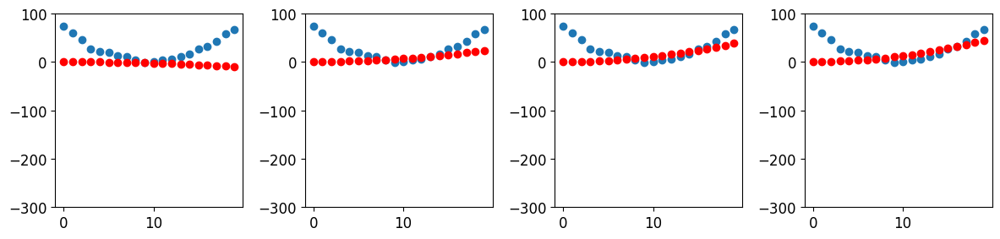

In [86]:
_,axs = plt.subplots(1,4,figsize=(12,3))
for ax in axs: show_preds(apply_step(params, False), ax)
plt.tight_layout()

#### Step 7: stop

We just decided to stop after 10 epochs arbitrarily. In practice, we would watch the training and validation losses and our metrics to decide when to stop, as we've discussed.

### Summarizing Gradient Descent

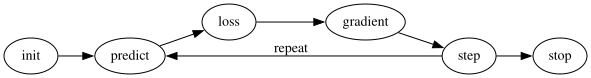

In [87]:
#hide_input
#id gradient_descent
#caption The gradient descent process
#alt Graph showing the steps for Gradient Descent
gv('''
init->predict->loss->gradient->step->stop
step->predict[label=repeat]
''')

To summarize, at the beginning, the weights of our model can be random (training *from scratch*) or come from a pretrained model (*transfer learning*). In the first case, the output we will get from our inputs won't have anything to do with what we want, and even in the second case, it's very likely the pretrained model won't be very good at the specific task we are targeting. So the model will need to *learn* better weights.

We begin by comparing the outputs the model gives us with our targets (we have labeled data, so we know what result the model should give) using a *loss function*, which returns a number that we want to make as low as possible by improving our weights. To do this, we take a few data items (such as images) from the training set and feed them to our model. We compare the corresponding targets using our loss function, and the score we get tells us how wrong our predictions were. We then change the weights a little bit to make it slightly better.

To find how to change the weights to make the loss a bit better, we use calculus to calculate the *gradients*. (Actually, we let PyTorch do it for us!) Let's consider an analogy. Imagine you are lost in the mountains with your car parked at the lowest point. To find your way back to it, you might wander in a random direction, but that probably wouldn't help much. Since you know your vehicle is at the lowest point, you would be better off going downhill. By always taking a step in the direction of the steepest downward slope, you should eventually arrive at your destination. We use the magnitude of the gradient (i.e., the steepness of the slope) to tell us how big a step to take; specifically, we multiply the gradient by a number we choose called the *learning rate* to decide on the step size. We then *iterate* until we have reached the lowest point, which will be our parking lot, then we can *stop*.

All of that we just saw can be transposed directly to the MNIST dataset, except for the loss function. Let's now see how we can define a good training objective. 

## The MNIST Loss Function

We already have our independent variables `x`—these are the images themselves. We'll concatenate them all into a single tensor, and also change them from a list of matrices (a rank-3 tensor) to a list of vectors (a rank-2 tensor). We can do this using `view`, which is a PyTorch method that changes the shape of a tensor without changing its contents. `-1` is a special parameter to `view` that means "make this axis as big as necessary to fit all the data":

In [88]:
train_x = torch.cat([stacked_threes, stacked_sevens]).view(-1, 28*28)
train_x.shape

torch.Size([12396, 784])

We need a label for each image. We'll use `1` for 3s and `0` for 7s:

In [89]:
# On fait un tableau train_y de dimension 1 rempli de 1 aux index des 3, et de 0 aux index des 7. [[1],[1],...[0],[0]]
train_y = tensor([1]*len(threes) + [0]*len(sevens)).unsqueeze(1)
train_y2 = tensor([[1]]*len(threes) + [[0]]*len(sevens)) #We could do this way
train_x.shape,train_y.shape, train_y2.shape

(torch.Size([12396, 784]), torch.Size([12396, 1]), torch.Size([12396, 1]))

A `Dataset` in PyTorch is required to return a tuple of `(x,y)` when indexed. Python provides a `zip` function which, when combined with `list`, provides a simple way to get this functionality:

In [90]:
dset = list(zip(train_x,train_y))
x,y = dset[0]
x.shape,y

(torch.Size([784]), tensor([1]))

In [91]:
# Same data preparation for validation
valid_x = torch.cat([valid_3_tens, valid_7_tens]).view(-1, 28*28)
valid_y = tensor([1]*len(valid_3_tens) + [0]*len(valid_7_tens)).unsqueeze(1)
valid_dset = list(zip(valid_x,valid_y))

Now we need an (initially random) weight for every pixel (this is the *initialize* step in our seven-step process):

In [94]:
def init_params(size, std=1.0): return (torch.randn(size)*std).requires_grad_()

In [93]:
weights = init_params((28*28,1))
weights.shape

torch.Size([784, 1])

The function `weights*pixels` won't be flexible enough—it is always equal to 0 when the pixels are equal to 0 (i.e., its *intercept* is 0). You might remember from high school math that the formula for a line is `y=w*x+b`; we still need the `b`. We'll initialize it to a random number too:

In [94]:
bias = init_params(1)
bias

tensor([0.3251], requires_grad=True)

In neural networks, the `w` in the equation `y=w*x+b` is called the *weights*, and the `b` is called the *bias*. Together, the weights and bias make up the *parameters*.

> jargon: Parameters: The _weights_ and _biases_ of a model. The weights are the `w` in the equation `w*x+b`, and the biases are the `b` in that equation.

We can now calculate a prediction for one image:

In [95]:
(train_x[0]*weights.T).sum() + bias

tensor([1.5501], grad_fn=<AddBackward0>)

In [96]:
train_x[0]@weights

tensor([1.2250], grad_fn=<SqueezeBackward3>)

While we could use a Python `for` loop to calculate the prediction for each image, that would be very slow. Because Python loops don't run on the GPU, and because Python is a slow language for loops in general, we need to represent as much of the computation in a model as possible using higher-level functions.

In this case, there's an extremely convenient mathematical operation that calculates `w*x` for every row of a matrix—it's called *matrix multiplication*. <<matmul>> shows what matrix multiplication looks like.

<img alt="Matrix multiplication" width="400" caption="Matrix multiplication" src="images/matmul2.svg" id="matmul"/>

This image shows two matrices, `A` and `B`, being multiplied together. Each item of the result, which we'll call `AB`, contains each item of its corresponding row of `A` multiplied by each item of its corresponding column of `B`, added together. For instance, row 1, column 2 (the yellow dot with a red border) is calculated as $a_{1,1} * b_{1,2} + a_{1,2} * b_{2,2}$. If you need a refresher on matrix multiplication, we suggest you take a look at the [Intro to Matrix Multiplication](https://youtu.be/kT4Mp9EdVqs) on *Khan Academy*, since this is the most important mathematical operation in deep learning.

In Python, matrix multiplication is represented with the `@` operator. Let's try it:

In [97]:
def linear1(xb): return xb@weights + bias
preds = linear1(train_x)
preds, preds.shape

(tensor([[ 1.5501],
         [-5.0415],
         [ 0.0129],
         ...,
         [ 0.8026],
         [ 8.5934],
         [-6.9015]], grad_fn=<AddBackward0>),
 torch.Size([12396, 1]))

The first element is the same as we calculated before, as we'd expect. This equation, `batch@weights + bias`, is one of the two fundamental equations of any neural network (the other one is the *activation function*, which we'll see in a moment).

Let's check our accuracy. To decide if an output represents a 3 or a 7, we can just check whether it's greater than 0.0, so our accuracy for each item can be calculated (using broadcasting, so no loops!) with:

In [98]:
(preds>0.0)

tensor([[ True],
        [False],
        [ True],
        ...,
        [ True],
        [ True],
        [False]])

In [99]:
corrects = (preds>0.0).float() == train_y
corrects

tensor([[ True],
        [False],
        [ True],
        ...,
        [False],
        [False],
        [ True]])

In [100]:
corrects.float().mean().item()

0.36156824231147766

Now let's see what the change in accuracy is for a small change in one of the weights (note that we have to ask PyTorch not to calculate gradients as we do this, which is what `with torch.no_grad()` is doing here):

In [101]:
with torch.no_grad(): weights[0] *= 1.0001

In [102]:
preds = linear1(train_x)
((preds>0.0).float() == train_y).float().mean().item()

0.36156824231147766

As we've seen, we need gradients in order to improve our model using SGD, and in order to calculate gradients we need some *loss function* that represents how good our model is. That is because the gradients are a measure of how that loss function changes with small tweaks to the weights.

So, we need to choose a loss function. The obvious approach would be to use accuracy, which is our metric, as our loss function as well. In this case, we would calculate our prediction for each image, collect these values to calculate an overall accuracy, and then calculate the gradients of each weight with respect to that overall accuracy.

Unfortunately, we have a significant technical problem here. The gradient of a function is its *slope*, or its steepness, which can be defined as *rise over run*—that is, how much the value of the function goes up or down, divided by how much we changed the input. We can write this in mathematically as: `(y_new - y_old) / (x_new - x_old)`. This gives us a good approximation of the gradient when `x_new` is very similar to `x_old`, meaning that their difference is very small. But accuracy only changes at all when a prediction changes from a 3 to a 7, or vice versa. The problem is that a small change in weights from `x_old` to `x_new` isn't likely to cause any prediction to change, so `(y_new - y_old)` will almost always be 0. In other words, the gradient is 0 almost everywhere.

A very small change in the value of a weight will often not actually change the accuracy at all. This means it is not useful to use accuracy as a loss function—if we do, most of the time our gradients will actually be 0, and the model will not be able to learn from that number.

> S: In mathematical terms, accuracy is a function that is constant almost everywhere (except at the threshold, 0.5), so its derivative is nil almost everywhere (and infinity at the threshold). This then gives gradients that are 0 or infinite, which are useless for updating the model.

Instead, we need a loss function which, when our weights result in slightly better predictions, gives us a slightly better loss. So what does a "slightly better prediction" look like, exactly? Well, in this case, it means that if the correct answer is a 3 the score is a little higher, or if the correct answer is a 7 the score is a little lower.

Let's write such a function now. What form does it take?

The loss function receives not the images themselves, but the predictions from the model. Let's make one argument, `prds`, of values between 0 and 1, where each value is the prediction that an image is a 3. It is a vector (i.e., a rank-1 tensor), indexed over the images.

The purpose of the loss function is to measure the difference between predicted values and the true values — that is, the targets (aka labels). Let's make another argument, `trgts`, with values of 0 or 1 which tells whether an image actually is a 3 or not. It is also a vector (i.e., another rank-1 tensor), indexed over the images.

So, for instance, suppose we had three images which we knew were a 3, a 7, and a 3. And suppose our model predicted with high confidence (`0.9`) that the first was a 3, with slight confidence (`0.4`) that the second was a 7, and with fair confidence (`0.2`), but incorrectly, that the last was a 7. This would mean our loss function would receive these values as its inputs:

In [103]:
trgts  = tensor([1,0,1])
prds   = tensor([0.9, 0.4, 0.2])

Here's a first try at a loss function that measures the distance between `predictions` and `targets`:

In [104]:
def mnist_loss(predictions, targets):
    return torch.where(targets==1, 1-predictions, predictions).mean()

We're using a new function, `torch.where(a,b,c)`. This is the same as running the list comprehension `[b[i] if a[i] else c[i] for i in range(len(a))]`, except it works on tensors, at C/CUDA speed. In plain English, this function will measure how distant each prediction is from 1 if it should be 1, and how distant it is from 0 if it should be 0, and then it will take the mean of all those distances.

> note: Read the Docs: It's important to learn about PyTorch functions like this, because looping over tensors in Python performs at Python speed, not C/CUDA speed! Try running `help(torch.where)` now to read the docs for this function, or, better still, look it up on the PyTorch documentation site.

Let's try it on our `prds` and `trgts`:

In [105]:
torch.where(trgts==1, 1-prds, prds)

tensor([0.1000, 0.4000, 0.8000])

You can see that this function returns a lower number when predictions are more accurate, when accurate predictions are more confident (higher absolute values), and when inaccurate predictions are less confident. In PyTorch, we always assume that a lower value of a loss function is better. Since we need a scalar for the final loss, `mnist_loss` takes the mean of the previous tensor:

In [106]:
mnist_loss(prds,trgts)

tensor(0.4333)

For instance, if we change our prediction for the one "false" target from `0.2` to `0.8` the loss will go down, indicating that this is a better prediction:

In [107]:
mnist_loss(tensor([0.9, 0.4, 0.8]),trgts)

tensor(0.2333)

One problem with `mnist_loss` as currently defined is that it assumes that predictions are always between 0 and 1. We need to ensure, then, that this is actually the case! As it happens, there is a function that does exactly that—let's take a look.

### Sigmoid

The `sigmoid` function always outputs a number between 0 and 1. It's defined as follows:

In [108]:
def sigmoid(x): return 1/(1+torch.exp(-x))

Pytorch defines an accelerated version for us, so we don’t really need our own. This is an important function in deep learning, since we often want to ensure values are between 0 and 1. This is what it looks like:

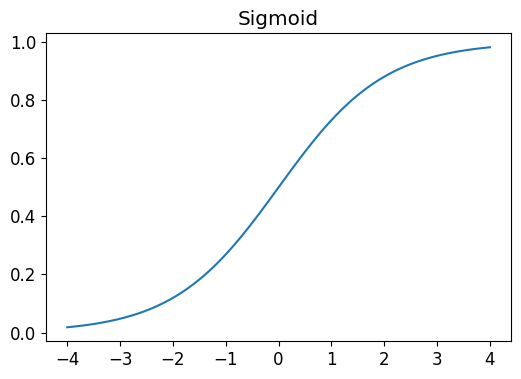

In [109]:
plot_function(torch.sigmoid, title='Sigmoid', min=-4, max=4)

As you can see, it takes any input value, positive or negative, and smooshes it onto an output value between 0 and 1. It's also a smooth curve that only goes up, which makes it easier for SGD to find meaningful gradients. 

Let's update `mnist_loss` to first apply `sigmoid` to the inputs:

In [110]:
def mnist_loss(predictions, targets):
    predictions = predictions.sigmoid()
    return torch.where(targets==1, 1-predictions, predictions).mean()

Now we can be confident our loss function will work, even if the predictions are not between 0 and 1. All that is required is that a higher prediction corresponds to higher confidence an image is a 3.

Having defined a loss function, now is a good moment to recapitulate why we did this. After all, we already had a metric, which was overall accuracy. So why did we define a loss?

The key difference is that the metric is to drive human understanding and the loss is to drive automated learning. To drive automated learning, the loss must be a function that has a meaningful derivative. It can't have big flat sections and large jumps, but instead must be reasonably smooth. This is why we designed a loss function that would respond to small changes in confidence level. This requirement means that sometimes it does not really reflect exactly what we are trying to achieve, but is rather a compromise between our real goal and a function that can be optimized using its gradient. The loss function is calculated for each item in our dataset, and then at the end of an epoch the loss values are all averaged and the overall mean is reported for the epoch.

Metrics, on the other hand, are the numbers that we really care about. These are the values that are printed at the end of each epoch that tell us how our model is really doing. It is important that we learn to focus on these metrics, rather than the loss, when judging the performance of a model.

### SGD and Mini-Batches

Now that we have a loss function that is suitable for driving SGD, we can consider some of the details involved in the next phase of the learning process, which is to change or update the weights based on the gradients. This is called an *optimization step*.

In order to take an optimization step we need to calculate the loss over one or more data items. How many should we use? We could calculate it for the whole dataset, and take the average, or we could calculate it for a single data item. But neither of these is ideal. Calculating it for the whole dataset would take a very long time. Calculating it for a single item would not use much information, so it would result in a very imprecise and unstable gradient. That is, you'd be going to the trouble of updating the weights, but taking into account only how that would improve the model's performance on that single item.

So instead we take a compromise between the two: we calculate the average loss for a few data items at a time. This is called a *mini-batch*. The number of data items in the mini-batch is called the *batch size*. A larger batch size means that you will get a more accurate and stable estimate of your dataset's gradients from the loss function, but it will take longer, and you will process fewer mini-batches per epoch. Choosing a good batch size is one of the decisions you need to make as a deep learning practitioner to train your model quickly and accurately. We will talk about how to make this choice throughout this book.

Another good reason for using mini-batches rather than calculating the gradient on individual data items is that, in practice, we nearly always do our training on an accelerator such as a GPU. These accelerators only perform well if they have lots of work to do at a time, so it's helpful if we can give them lots of data items to work on. Using mini-batches is one of the best ways to do this. However, if you give them too much data to work on at once, they run out of memory—making GPUs happy is also tricky!

As we saw in our discussion of data augmentation in <<chapter_production>>, we get better generalization if we can vary things during training. One simple and effective thing we can vary is what data items we put in each mini-batch. Rather than simply enumerating our dataset in order for every epoch, instead what we normally do is randomly shuffle it on every epoch, before we create mini-batches. PyTorch and fastai provide a class that will do the shuffling and mini-batch collation for you, called `DataLoader`.

A `DataLoader` can take any Python collection and turn it into an iterator over mini-batches, like so:

In [111]:
coll = range(15)
dl = DataLoader(coll, batch_size=5, shuffle=True)
list(dl)

[tensor([ 3, 12,  8, 10,  2]),
 tensor([ 9,  4,  7, 14,  5]),
 tensor([ 1, 13,  0,  6, 11])]

For training a model, we don't just want any Python collection, but a collection containing independent and dependent variables (that is, the inputs and targets of the model). A collection that contains tuples of independent and dependent variables is known in PyTorch as a `Dataset`. Here's an example of an extremely simple `Dataset`:

In [112]:
ds = L(enumerate(string.ascii_lowercase))
ds

(#26) [(0, 'a'),(1, 'b'),(2, 'c'),(3, 'd'),(4, 'e'),(5, 'f'),(6, 'g'),(7, 'h'),(8, 'i'),(9, 'j')...]

When we pass a `Dataset` to a `DataLoader` we will get back mini-batches which are themselves tuples of tensors representing batches of independent and dependent variables:

In [113]:
dl = DataLoader(ds, batch_size=6, shuffle=True)
list(dl)

[(tensor([17, 18, 10, 22,  8, 14]), ('r', 's', 'k', 'w', 'i', 'o')),
 (tensor([20, 15,  9, 13, 21, 12]), ('u', 'p', 'j', 'n', 'v', 'm')),
 (tensor([ 7, 25,  6,  5, 11, 23]), ('h', 'z', 'g', 'f', 'l', 'x')),
 (tensor([ 1,  3,  0, 24, 19, 16]), ('b', 'd', 'a', 'y', 't', 'q')),
 (tensor([2, 4]), ('c', 'e'))]

We are now ready to write our first training loop for a model using SGD!

## Putting It All Together

It's time to implement the process we saw in <<gradient_descent>>. In code, our process will be implemented something like this for each epoch:

```python
for x,y in dl:
    pred = model(x)
    loss = loss_func(pred, y)
    loss.backward()
    parameters -= parameters.grad * lr
```

First, let's re-initialize our parameters:

In [114]:
weights = init_params((28*28,1))
bias = init_params(1)

A `DataLoader` can be created from a `Dataset`:

In [77]:
dl = DataLoader(dset, batch_size=256)
xb,yb = first(dl)
xb.shape,yb.shape

(torch.Size([256, 784]), torch.Size([256, 1]))

We'll do the same for the validation set:

In [78]:
valid_dl = DataLoader(valid_dset, batch_size=256)

Let's create a mini-batch of size 4 for testing:

In [79]:
batch = train_x[:4]
batch.shape

torch.Size([4, 784])

In [80]:
preds = linear1(batch)
preds

tensor([[16.9896],
        [10.4734],
        [ 7.3673],
        [11.7050]], grad_fn=<AddBackward0>)

In [81]:
loss = mnist_loss(preds, train_y[:4])
loss

tensor(0.0002, grad_fn=<MeanBackward0>)

Now we can calculate the gradients:

In [82]:
loss.backward()
weights.grad.shape,weights.grad.mean(),bias.grad

(torch.Size([784, 1]), tensor(-2.3986e-05), tensor([-0.0002]))

Let's put that all in a function:

In [83]:
def calc_grad(xb, yb, model):
    preds = model(xb)
    loss = mnist_loss(preds, yb)
    loss.backward()

and test it:

In [84]:
calc_grad(batch, train_y[:4], linear1)
weights.grad.mean(),bias.grad

(tensor(-4.7971e-05), tensor([-0.0003]))

But look what happens if we call it twice:

In [85]:
calc_grad(batch, train_y[:4], linear1)
weights.grad.mean(),bias.grad

(tensor(-7.1957e-05), tensor([-0.0005]))

The gradients have changed! The reason for this is that `loss.backward` actually *adds* the gradients of `loss` to any gradients that are currently stored. So, we have to set the current gradients to 0 first:

In [86]:
weights.grad.zero_()
bias.grad.zero_();

> note: Inplace Operations: Methods in PyTorch whose names end in an underscore modify their objects _in place_. For instance, `bias.zero_()` sets all elements of the tensor `bias` to 0.

Our only remaining step is to update the weights and biases based on the gradient and learning rate. When we do so, we have to tell PyTorch not to take the gradient of this step too—otherwise things will get very confusing when we try to compute the derivative at the next batch! If we assign to the `data` attribute of a tensor then PyTorch will not take the gradient of that step. Here's our basic training loop for an epoch:

In [90]:
def train_epoch(model, lr, params):
    for xb,yb in dl:
        calc_grad(xb, yb, model)
        for p in params:
            p.data -= p.grad*lr
            p.grad.zero_()

We also want to check how we're doing, by looking at the accuracy of the validation set. To decide if an output represents a 3 or a 7, we can just check whether it's greater than 0. So our accuracy for each item can be calculated (using broadcasting, so no loops!) with:

In [88]:
(preds>0.0).float() == train_y[:4]

tensor([[True],
        [True],
        [True],
        [True]])

That gives us this function to calculate our validation accuracy:

In [89]:
def batch_accuracy(xb, yb):
    preds = xb.sigmoid()
    correct = (preds>0.5) == yb
    return correct.float().mean()

We can check it works:

In [90]:
batch_accuracy(linear1(batch), train_y[:4])

tensor(1.)

and then put the batches together:

In [91]:
def validate_epoch(model):
    accs = [batch_accuracy(model(xb), yb) for xb,yb in valid_dl]
    return round(torch.stack(accs).mean().item(), 4)

In [92]:
validate_epoch(linear1)

0.727

That's our starting point. Let's train for one epoch, and see if the accuracy improves:

In [93]:
lr = 1.
params = weights,bias
train_epoch(linear1, lr, params)
validate_epoch(linear1)

0.7016

Then do a few more:

In [94]:
for i in range(20):
    train_epoch(linear1, lr, params)
    print(validate_epoch(linear1), end=' ')

0.8646 0.9178 0.9398 0.9481 0.9535 0.9574 0.9593 0.9622 0.9642 0.9661 0.9686 0.9691 0.9701 0.9701 0.972 0.973 0.973 0.9735 0.974 0.9745 

Looking good! We're already about at the same accuracy as our "pixel similarity" approach, and we've created a general-purpose foundation we can build on. Our next step will be to create an object that will handle the SGD step for us. In PyTorch, it's called an *optimizer*.

### Creating an Optimizer

Because this is such a general foundation, PyTorch provides some useful classes to make it easier to implement. The first thing we can do is replace our `linear1` function with PyTorch's `nn.Linear` module. A *module* is an object of a class that inherits from the PyTorch `nn.Module` class. Objects of this class behave identically to standard Python functions, in that you can call them using parentheses and they will return the activations of a model.

`nn.Linear` does the same thing as our `init_params` and `linear` together. It contains both the *weights* and *biases* in a single class. Here's how we replicate our model from the previous section:

In [95]:
linear_model = nn.Linear(28*28,1)

Every PyTorch module knows what parameters it has that can be trained; they are available through the `parameters` method:

In [91]:
w,b = linear_model.parameters()
w.shape,b.shape

NameError: name 'linear_model' is not defined

We can use this information to create an optimizer:

In [97]:
class BasicOptim:
    def __init__(self,params,lr): self.params,self.lr = list(params),lr

    def step(self, *args, **kwargs):
        for p in self.params: p.data -= p.grad.data * self.lr

    def zero_grad(self, *args, **kwargs):
        for p in self.params: p.grad = None

We can create our optimizer by passing in the model's parameters:

In [98]:
opt = BasicOptim(linear_model.parameters(), lr)

Our training loop can now be simplified to:

In [99]:
def train_epoch(model):
    for xb,yb in dl:
        calc_grad(xb, yb, model)
        opt.step()
        opt.zero_grad()

Our validation function doesn't need to change at all:

In [100]:
validate_epoch(linear_model)

0.3255

Let's put our little training loop in a function, to make things simpler:

In [101]:
def train_model(model, epochs):
    for i in range(epochs):
        train_epoch(model)
        print(validate_epoch(model), end=' ')

The results are the same as in the previous section:

In [102]:
train_model(linear_model, 20)

0.4932 0.7964 0.8471 0.9145 0.9341 0.9472 0.9555 0.9629 0.9658 0.9673 0.9687 0.9707 0.9731 0.9746 0.9761 0.9765 0.9775 0.9775 0.9785 0.9785 

fastai provides the `SGD` class which, by default, does the same thing as our `BasicOptim`:

In [103]:
linear_model = nn.Linear(28*28,1)
opt = SGD(linear_model.parameters(), lr)
train_model(linear_model, 20)

0.4932 0.8037 0.8501 0.9165 0.9341 0.9477 0.9555 0.9638 0.9658 0.9668 0.9702 0.9721 0.9736 0.9751 0.9761 0.9765 0.9775 0.978 0.978 0.978 

fastai also provides `Learner.fit`, which we can use instead of `train_model`. To create a `Learner` we first need to create a `DataLoaders`, by passing in our training and validation `DataLoader`s:

In [104]:
dls = DataLoaders(dl, valid_dl)

To create a `Learner` without using an application (such as `vision_learner`) we need to pass in all the elements that we've created in this chapter: the `DataLoaders`, the model, the optimization function (which will be passed the parameters), the loss function, and optionally any metrics to print:

In [105]:
learn = Learner(dls, nn.Linear(28*28,1), opt_func=SGD,
                loss_func=mnist_loss, metrics=batch_accuracy)

Now we can call `fit`:

In [106]:
learn.fit(10, lr=lr)

epoch,train_loss,valid_loss,batch_accuracy,time
0,0.637135,0.502547,0.495584,00:00
1,0.353152,0.294732,0.708047,00:00
2,0.136493,0.152057,0.862610,00:00
3,0.063803,0.097404,0.918548,00:00
4,0.036711,0.073357,0.935231,00:00
5,0.025895,0.059701,0.949460,00:00
6,0.021306,0.051026,0.957311,00:00
7,0.019165,0.045182,0.962709,00:00
8,0.018008,0.041031,0.965653,00:00
9,0.017268,0.037945,0.967615,00:00


As you can see, there's nothing magic about the PyTorch and fastai classes. They are just convenient pre-packaged pieces that make your life a bit easier! (They also provide a lot of extra functionality we'll be using in future chapters.)

With these classes, we can now replace our linear model with a neural network.

## Adding a Nonlinearity

So far we have a general procedure for optimizing the parameters of a function, and we have tried it out on a very boring function: a simple linear classifier. A linear classifier is very constrained in terms of what it can do. To make it a bit more complex (and able to handle more tasks), we need to add something nonlinear between two linear classifiers—this is what gives us a neural network.

Here is the entire definition of a basic neural network:

In [92]:
def simple_net(xb): 
    res = xb@w1 + b1
    res = res.max(tensor(0.0))
    res = res@w2 + b2
    return res

That's it! All we have in `simple_net` is two linear classifiers with a `max` function between them.

Here, `w1` and `w2` are weight tensors, and `b1` and `b2` are bias tensors; that is, parameters that are initially randomly initialized, just like we did in the previous section:

In [95]:
w1 = init_params((28*28,30))
b1 = init_params(30)
w2 = init_params((30,1))
b2 = init_params(1)

The key point about this is that `w1` has 30 output activations (which means that `w2` must have 30 input activations, so they match). That means that the first layer can construct 30 different features, each representing some different mix of pixels. You can change that `30` to anything you like, to make the model more or less complex.

That little function `res.max(tensor(0.0))` is called a *rectified linear unit*, also known as *ReLU*. We think we can all agree that *rectified linear unit* sounds pretty fancy and complicated... But actually, there's nothing more to it than `res.max(tensor(0.0))`—in other words, replace every negative number with a zero. This tiny function is also available in PyTorch as `F.relu`:

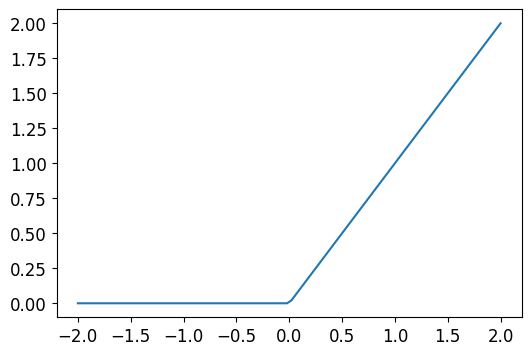

In [96]:
plot_function(F.relu)

> J: There is an enormous amount of jargon in deep learning, including terms like _rectified linear unit_. The vast vast majority of this jargon is no more complicated than can be implemented in a short line of code, as we saw in this example. The reality is that for academics to get their papers published they need to make them sound as impressive and sophisticated as possible. One of the ways that they do that is to introduce jargon. Unfortunately, this has the result that the field ends up becoming far more intimidating and difficult to get into than it should be. You do have to learn the jargon, because otherwise papers and tutorials are not going to mean much to you. But that doesn't mean you have to find the jargon intimidating. Just remember, when you come across a word or phrase that you haven't seen before, it will almost certainly turn out to be referring to a very simple concept.

The basic idea is that by using more linear layers, we can have our model do more computation, and therefore model more complex functions. But there's no point just putting one linear layer directly after another one, because when we multiply things together and then add them up multiple times, that could be replaced by multiplying different things together and adding them up just once! That is to say, a series of any number of linear layers in a row can be replaced with a single linear layer with a different set of parameters.

But if we put a nonlinear function between them, such as `max`, then this is no longer true. Now each linear layer is actually somewhat decoupled from the other ones, and can do its own useful work. The `max` function is particularly interesting, because it operates as a simple `if` statement.

> S: Mathematically, we say the composition of two linear functions is another linear function. So, we can stack as many linear classifiers as we want on top of each other, and without nonlinear functions between them, it will just be the same as one linear classifier.

Amazingly enough, it can be mathematically proven that this little function can solve any computable problem to an arbitrarily high level of accuracy, if you can find the right parameters for `w1` and `w2` and if you make these matrices big enough. For any arbitrarily wiggly function, we can approximate it as a bunch of lines joined together; to make it closer to the wiggly function, we just have to use shorter lines. This is known as the *universal approximation theorem*. The three lines of code that we have here are known as *layers*. The first and third are known as *linear layers*, and the second line of code is known variously as a *nonlinearity*, or *activation function*.

Just like in the previous section, we can replace this code with something a bit simpler, by taking advantage of PyTorch:

In [ ]:
simple_net = nn.Sequential(
    nn.Linear(28*28,30),
    nn.ReLU(),
    nn.Linear(30,1)
)

`nn.Sequential` creates a module that will call each of the listed layers or functions in turn.

`nn.ReLU` is a PyTorch module that does exactly the same thing as the `F.relu` function. Most functions that can appear in a model also have identical forms that are modules. Generally, it's just a case of replacing `F` with `nn` and changing the capitalization. When using `nn.Sequential`, PyTorch requires us to use the module version. Since modules are classes, we have to instantiate them, which is why you see `nn.ReLU()` in this example. 

Because `nn.Sequential` is a module, we can get its parameters, which will return a list of all the parameters of all the modules it contains. Let's try it out! As this is a deeper model, we'll use a lower learning rate and a few more epochs.

In [ ]:
learn = Learner(dls, simple_net, opt_func=SGD,
                loss_func=mnist_loss, metrics=batch_accuracy)

In [ ]:
#hide_output
learn.fit(40, 0.1)

epoch,train_loss,valid_loss,batch_accuracy,time
0,0.305828,0.399663,0.508341,00:00
1,0.142960,0.225702,0.807655,00:00
2,0.079516,0.113519,0.919529,00:00
3,0.052391,0.076792,0.943081,00:00
4,0.039796,0.060083,0.956330,00:00
5,0.033368,0.050713,0.963690,00:00
6,0.029680,0.044797,0.965653,00:00
7,0.027290,0.040729,0.968106,00:00
8,0.025568,0.037771,0.968597,00:00
9,0.024233,0.035508,0.970559,00:00


We're not showing the 40 lines of output here to save room; the training process is recorded in `learn.recorder`, with the table of output stored in the `values` attribute, so we can plot the accuracy over training as:

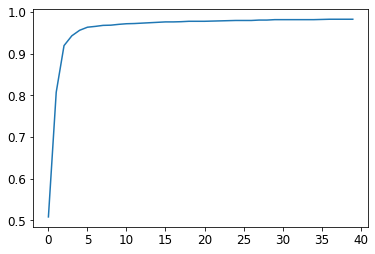

In [ ]:
plt.plot(L(learn.recorder.values).itemgot(2));

And we can view the final accuracy:

In [ ]:
learn.recorder.values[-1][2]

0.982826292514801

At this point we have something that is rather magical:

1. A function that can solve any problem to any level of accuracy (the neural network) given the correct set of parameters
1. A way to find the best set of parameters for any function (stochastic gradient descent)

This is why deep learning can do things which seem rather magical, such fantastic things. Believing that this combination of simple techniques can really solve any problem is one of the biggest steps that we find many students have to take. It seems too good to be true—surely things should be more difficult and complicated than this? Our recommendation: try it out! We just tried it on the MNIST dataset and you have seen the results. And since we are doing everything from scratch ourselves (except for calculating the gradients) you know that there is no special magic hiding behind the scenes.

### Going Deeper

There is no need to stop at just two linear layers. We can add as many as we want, as long as we add a nonlinearity between each pair of linear layers. As you will learn, however, the deeper the model gets, the harder it is to optimize the parameters in practice. Later in this book you will learn about some simple but brilliantly effective techniques for training deeper models.

We already know that a single nonlinearity with two linear layers is enough to approximate any function. So why would we use deeper models? The reason is performance. With a deeper model (that is, one with more layers) we do not need to use as many parameters; it turns out that we can use smaller matrices with more layers, and get better results than we would get with larger matrices, and few layers.

That means that we can train the model more quickly, and it will take up less memory. In the 1990s researchers were so focused on the universal approximation theorem that very few were experimenting with more than one nonlinearity. This theoretical but not practical foundation held back the field for years. Some researchers, however, did experiment with deep models, and eventually were able to show that these models could perform much better in practice. Eventually, theoretical results were developed which showed why this happens. Today, it is extremely unusual to find anybody using a neural network with just one nonlinearity.

Here is what happens when we train an 18-layer model using the same approach we saw in <<chapter_intro>>:

In [ ]:
dls = ImageDataLoaders.from_folder(path)
learn = vision_learner(dls, resnet18, pretrained=False,
                    loss_func=F.cross_entropy, metrics=accuracy)
learn.fit_one_cycle(1, 0.1)

epoch,train_loss,valid_loss,accuracy,time
0,0.082089,0.009578,0.997056,00:11


Nearly 100% accuracy! That's a big difference compared to our simple neural net. But as you'll learn in the remainder of this book, there are just a few little tricks you need to use to get such great results from scratch yourself. You already know the key foundational pieces. (Of course, even once you know all the tricks, you'll nearly always want to work with the pre-built classes provided by PyTorch and fastai, because they save you having to think about all the little details yourself.)

## Jargon Recap

Congratulations: you now know how to create and train a deep neural network from scratch! We've gone through quite a few steps to get to this point, but you might be surprised at how simple it really is.

Now that we are at this point, it is a good opportunity to define, and review, some jargon and key concepts.

A neural network contains a lot of numbers, but they are only of two types: numbers that are calculated, and the parameters that these numbers are calculated from. This gives us the two most important pieces of jargon to learn:

- Activations:: Numbers that are calculated (both by linear and nonlinear layers)
- Parameters:: Numbers that are randomly initialized, and optimized (that is, the numbers that define the model)

We will often talk in this book about activations and parameters. Remember that they have very specific meanings. They are numbers. They are not abstract concepts, but they are actual specific numbers that are in your model. Part of becoming a good deep learning practitioner is getting used to the idea of actually looking at your activations and parameters, and plotting them and testing whether they are behaving correctly.

Our activations and parameters are all contained in *tensors*. These are simply regularly shaped arrays—for example, a matrix. Matrices have rows and columns; we call these the *axes* or *dimensions*. The number of dimensions of a tensor is its *rank*. There are some special tensors:

- Rank zero: scalar
- Rank one: vector
- Rank two: matrix

A neural network contains a number of layers. Each layer is either *linear* or *nonlinear*. We generally alternate between these two kinds of layers in a neural network. Sometimes people refer to both a linear layer and its subsequent nonlinearity together as a single layer. Yes, this is confusing. Sometimes a nonlinearity is referred to as an *activation function*.

<<dljargon1>> summarizes the key concepts related to SGD.

```asciidoc
[[dljargon1]]
.Deep learning vocabulary
[options="header"]
|=====
| Term | Meaning
|ReLU | Function that returns 0 for negative numbers and doesn't change positive numbers.
|Mini-batch | A small group of inputs and labels gathered together in two arrays. A gradient descent step is updated on this batch (rather than a whole epoch).
|Forward pass | Applying the model to some input and computing the predictions.
|Loss | A value that represents how well (or badly) our model is doing.
|Gradient | The derivative of the loss with respect to some parameter of the model.
|Backward pass | Computing the gradients of the loss with respect to all model parameters.
|Gradient descent | Taking a step in the directions opposite to the gradients to make the model parameters a little bit better.
|Learning rate | The size of the step we take when applying SGD to update the parameters of the model.
|=====
```

> note: _Choose Your Own Adventure_ Reminder: Did you choose to skip over chapters 2 & 3, in your excitement to peek under the hood? Well, here's your reminder to head back to chapter 2 now, because you'll be needing to know that stuff very soon!

## Questionnaire

1. How is a grayscale image represented on a computer? How about a color image?
1. How are the files and folders in the `MNIST_SAMPLE` dataset structured? Why?
1. Explain how the "pixel similarity" approach to classifying digits works.
1. What is a list comprehension? Create one now that selects odd numbers from a list and doubles them.
1. What is a "rank-3 tensor"?
1. What is the difference between tensor rank and shape? How do you get the rank from the shape?
1. What are RMSE and L1 norm?
1. How can you apply a calculation on thousands of numbers at once, many thousands of times faster than a Python loop?
1. Create a 3×3 tensor or array containing the numbers from 1 to 9. Double it. Select the bottom-right four numbers.
1. What is broadcasting?
1. Are metrics generally calculated using the training set, or the validation set? Why?
1. What is SGD?
1. Why does SGD use mini-batches?
1. What are the seven steps in SGD for machine learning?
1. How do we initialize the weights in a model?
1. What is "loss"?
1. Why can't we always use a high learning rate?
1. What is a "gradient"?
1. Do you need to know how to calculate gradients yourself?
1. Why can't we use accuracy as a loss function?
1. Draw the sigmoid function. What is special about its shape?
1. What is the difference between a loss function and a metric?
1. What is the function to calculate new weights using a learning rate?
1. What does the `DataLoader` class do?
1. Write pseudocode showing the basic steps taken in each epoch for SGD.
1. Create a function that, if passed two arguments `[1,2,3,4]` and `'abcd'`, returns `[(1, 'a'), (2, 'b'), (3, 'c'), (4, 'd')]`. What is special about that output data structure?
1. What does `view` do in PyTorch?
1. What are the "bias" parameters in a neural network? Why do we need them?
1. What does the `@` operator do in Python?
1. What does the `backward` method do?
1. Why do we have to zero the gradients?
1. What information do we have to pass to `Learner`?
1. Show Python or pseudocode for the basic steps of a training loop.
1. What is "ReLU"? Draw a plot of it for values from `-2` to `+2`.
1. What is an "activation function"?
1. What's the difference between `F.relu` and `nn.ReLU`?
1. The universal approximation theorem shows that any function can be approximated as closely as needed using just one nonlinearity. So why do we normally use more?

### Further Research

1. Create your own implementation of `Learner` from scratch, based on the training loop shown in this chapter.
1. Complete all the steps in this chapter using the full MNIST datasets (that is, for all digits, not just 3s and 7s). This is a significant project and will take you quite a bit of time to complete! You'll need to do some of your own research to figure out how to overcome some obstacles you'll meet on the way.